In [19]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import seaborn as sns 
import matplotlib as mpl
import pickle
from sklearn.model_selection import train_test_split,GridSearchCV, LeavePGroupsOut
from hypopt import GridSearch
from xgboost import XGBRegressor
from merf.merf import MERF
from sklearn.metrics import r2_score
import pickle
import shap
import matplotlib.animation as animation
from matplotlib.animation import  PillowWriter 

from IPython.display import Image


shap.initjs()

%matplotlib inline

In [20]:
df = pd.read_excel('Thompson_reuters_trim.xlsx')
for col in df.columns[7:]:
    df[col] = pd.to_numeric(df[col], errors = 'coerce')
for col in df.columns[:7]:
    df[col] = df[col].astype(str)  
df['NAICS National Industry Code'].replace('nan', np.nan, inplace = True)
df.info();

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 57475 entries, 0 to 57474
Data columns (total 97 columns):
 #   Column                                    Non-Null Count  Dtype  
---  ------                                    --------------  -----  
 0   Identifier                                57475 non-null  object 
 1   Company Common Name                       57475 non-null  object 
 2   Fiscal Year                               57475 non-null  object 
 3   Country of Headquarters                   57475 non-null  object 
 4   SEDOL Code                                57475 non-null  object 
 5   Business Description                      57475 non-null  object 
 6   NAICS National Industry Code              57095 non-null  object 
 7   Total revenue                             36165 non-null  float64
 8   Cost of Revenue, Total                    33728 non-null  float64
 9   Gross Profit                              33629 non-null  float64
 10  Selling/General/Admin. Expense, To

In [21]:
df.head(2)

,Identifier,Company Common Name,Fiscal Year,Country of Headquarters,SEDOL Code,Business Description,NAICS National Industry Code,Total revenue,"Cost of Revenue, Total",Gross Profit,...,Cash from Financing Activities,Foreign Exchange Effects,Net Change in Cash,Net Cash - Beginning Balance,Net Cash - Ending Balance,Cash Interest Paid.1,Cash Taxes Paid.1,Advertising Expense,Working capital,Price close
0,AGR.BA,Agrometal SAI,FQ12018,Argentina,2010159,"Agrometal SAI, (Agrometal), is an Argentina-ba...",333111.0,4126.479861,4397.314769,-270.834908,...,2632.489309,NaN,-2821.467429,4923.906017,2102.438588,NaN,NaN,206.983093,7056.084038,0.000137
1,AGR.BA,Agrometal SAI,FQ22018,Argentina,2010159,"Agrometal SAI, (Agrometal), is an Argentina-ba...",333111.0,6871.156816,4717.218240,2153.938576,...,2605.358540,NaN,-992.628718,2076.685018,1084.056646,NaN,NaN,89.451196,5853.017209,0.000137


In [22]:
df['period'] = df.apply(lambda row: pd.Period(year = int(row['Fiscal Year'][-4:]), 
                                              quarter = int(row['Fiscal Year'][2]),freq = 'Q'), axis = 1)


df.set_index('period',inplace = True)
df.drop('Fiscal Year', axis =1, inplace = True)
df.sort_index(inplace = True)

In [23]:
df.index

PeriodIndex(['2000Q1', '2000Q1', '2000Q1', '2000Q1', '2000Q1', '2000Q1',
             '2000Q1', '2000Q1', '2000Q1', '2000Q1',
             ...
             '2018Q4', '2018Q4', '2018Q4', '2018Q4', '2018Q4', '2018Q4',
             '2018Q4', '2018Q4', '2018Q4', '2018Q4'],
            dtype='period[Q-DEC]', name='period', length=57475, freq='Q-DEC')

In [24]:
aux = 1-df.isnull().sum()/df.shape[0]
aux.sort_values(ascending = False, inplace = True)
nn_ordered_cols = aux.index

aux = pd.DataFrame({'':aux})
plt.figure(figsize = (23,2),dpi =1000)
sns.heatmap(aux.T, cmap = 'viridis', vmax =1,vmin = 0)
plt.title('Non-null % per column', fontdict=dict(size=20))


Text(0.5, 1.0, 'Non-null % per column')

In [25]:
null_matrix = df.isnull()
plt.figure(figsize = (23,10),dpi = 1000)
sns.heatmap(1-df.isnull()[nn_ordered_cols],cmap = 'viridis',vmax =1,vmin = 0)
plt.title('Null Values',fontdict=dict(size=20))
plt.ylabel(None)
#plt.savefig('dataset.png',dpi = 1500)
# plt.show()

Text(2587.222222222222, 0.5, '')

In [26]:
#Can try plotting the same but averaging a grid/ moving average.

In [27]:
df_aux = df.copy()
df_aux.index = df_aux.index.to_timestamp()
df_aux.head()

,Identifier,Company Common Name,Country of Headquarters,SEDOL Code,Business Description,NAICS National Industry Code,Total revenue,"Cost of Revenue, Total",Gross Profit,"Selling/General/Admin. Expense, Total",...,Cash from Financing Activities,Foreign Exchange Effects,Net Change in Cash,Net Cash - Beginning Balance,Net Cash - Ending Balance,Cash Interest Paid.1,Cash Taxes Paid.1,Advertising Expense,Working capital,Price close
period,,,,,,,,,,,,,,,,,,,,,
2000-01-01,GGBR4.SA,Gerdau SA,Brazil,2645517,Gerdau S.A. (Gerdau) is a producer of long rol...,331111.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.003234
2000-01-01,LAN.SN,Latam Airlines Group SA,Chile,2518932,LATAM Airlines Group S.A. (LATAM) is a Chile-b...,481111.0,371122.0,213152.0,157970.0,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,35155.0,0.011510
2000-01-01,KEPL3.SA,Kepler Weber SA,Brazil,2490245,"Kepler Weber SA, formerly Kepler Weber SA Indu...",332420.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.005358
2000-01-01,BMKS3.SA,Bicicletas Monark SA,Brazil,2095479,"Bicicletas Monark SA, formerly Monark Industri...",336991.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.063270
2000-01-01,CHO.SN,Forestal Cholguan SA,Chile,2349831,Forestal Cholguan SA is a Chile-based company ...,113310.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [28]:
#What's happening in closing price column. To examine that we'll plot
#the time series of closing price for some firms.

#plt.style.use('seaborn-white')

years = mpl.dates.YearLocator()   # every year
months = mpl.dates.MonthLocator(interval=3) #every quarter start. IT matches with the transformation
                                            #used to change PeriodIndex to DateTimeIndex. I.E, Q1 = Jan-01.
years_fmt = mpl.dates.DateFormatter('%Y')

fig, ax = plt.subplots(figsize = (15,6), dpi = 1000)
for firm in df_aux['SEDOL Code'].unique():
    ax.plot(df_aux[df_aux['SEDOL Code']== firm]['Price close'])

ax.xaxis.set_major_locator(years)
ax.xaxis.set_minor_locator(months)
ax.xaxis.set_major_formatter(years_fmt)

ax.set(ylim=(df['Price close'].describe()['25%'], df['Price close'].describe()['75%']))
ax.set_title('Closing Quartile Price per Firm', pad = 20)

plt.grid(which='both',axis = 'x')
plt.xticks(rotation=45);


ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)


print('Because the closing price values are static and there are almost no records for Q3 and Q4, it can be concluded that this information is likely to be incorrect. Possibly there was error in the data collection step.')
print('In an ideal situation, the time series in the graph should be continuous and should vary across time.')
print('The y-axis is fixed to show 75% of the distribution of all closing prices, removing the first and last quartiles.')

Because the closing price values are static and there are almost no records for Q3 and Q4, it can be concluded that this information is likely to be incorrect. Possibly there was error in the data collection step.
In an ideal situation, the time series in the graph should be continuous and should vary across time.
The y-axis is fixed to show 75% of the distribution of all closing prices, removing the first and last quartiles.


In [29]:
country_pct = df.groupby('Country of Headquarters').count()['SEDOL Code']/ df.shape[0]*100
country_pct.sort_values(ascending = False,inplace = True)
country_pct.name = 'Sample country composition'
country_pct
acum = country_pct[-6:].sum()
country_pct_aux = country_pct[:-6]
country_pct_aux = country_pct_aux.append(pd.Series(acum, index = ['Others']))
print(country_pct_aux)


n_firms_per_country = df.groupby('Country of Headquarters')['SEDOL Code'].nunique()
firms_pct_per_country = n_firms_per_country/n_firms_per_country.sum()*100
firms_pct_per_country.sort_values(ascending = False, inplace = True)
firms_pct_per_country_aux = firms_pct_per_country[:-6]
acum = firms_pct_per_country[-6:].sum()
firms_pct_per_country_aux = firms_pct_per_country_aux.append(pd.Series(acum, index = ['Others']))
print(firms_pct_per_country_aux)


n_industries_per_country = df.groupby('Country of Headquarters')['NAICS National Industry Code'].nunique()
industries_pct_per_country = n_industries_per_country/n_industries_per_country.sum()*100
industries_pct_per_country.sort_values(ascending = False, inplace = True)
industries_pct_per_country_aux = industries_pct_per_country[:-6]
acum = industries_pct_per_country[-6:].sum()
industries_pct_per_country_aux = industries_pct_per_country_aux.append(pd.Series(acum, index = ['Others']))
print(industries_pct_per_country_aux.sum)

Brazil       30.413223
Chile        18.247934
Mexico       15.074380
Peru         14.314050
Argentina     8.462810
Colombia      6.479339
Others        7.008264
dtype: float64
Brazil       30.303030
Chile        18.313570
Mexico       15.019763
Peru         14.361001
Argentina     8.432148
Colombia      6.587615
Others        6.982872
dtype: float64
<bound method Series.sum of Brazil       28.247423
Chile        15.670103
Mexico       13.814433
Peru         13.195876
Argentina    11.546392
Colombia      7.216495
Others       10.309278
dtype: float64>


There are a total of 57475 samples, a total of 759 firms according to the SEDOL Code and a total of 485 indistries according to the NAICS National Industry Code


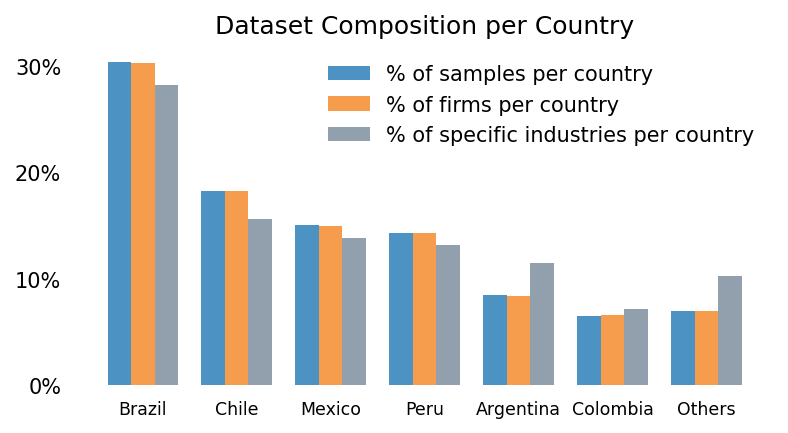

In [30]:
#plt.style.use('seaborn-whitegrid')

plt.figure(figsize=(6,3),dpi = 150)
plt.bar([2*i-0.5 for i in range(7)], country_pct_aux, width = 0.5, label = '% of samples per country',
       color = '#1F77B4', alpha = 0.8)
plt.bar([2*i for i in range(7)], firms_pct_per_country_aux[country_pct_aux.index], 
        width = 0.5, label = '% of firms per country', alpha = 0.8, color = '#f3851f')
plt.bar([2*i+0.5 for i in range(7)], industries_pct_per_country_aux[country_pct_aux.index], 
        width = 0.5, label = '% of specific industries per country', color='lightslategrey', alpha = 0.8)
plt.xticks([2*i for i in range(7)], country_pct_aux.index)
#plt.gca().yaxis.grid()
plt.legend(frameon = False)


for spine in plt.gca().spines.values():
    spine.set_visible(False)

plt.gca().yaxis.set_major_formatter(mpl.ticker.PercentFormatter(decimals=0))
plt.gca().yaxis.set_major_locator(plt.MultipleLocator(10))
plt.title('Dataset Composition per Country')
#plt.xticks(rotation = 10)
plt.xticks(**dict(fontsize= 'smaller'))
plt.tick_params(bottom = False, left = False)
#plt.grid(axis = 'y')


print('There are a total of {} samples, a total of {} firms according to the SEDOL Code and a total of {} indistries according to the NAICS National Industry Code'.
     format(df.shape[0], n_firms_per_country.sum(), n_industries_per_country.sum()))


Distribution of firms per specific-industy because it considers the six digit NAICS Code.
Consider the sparcity of this feature when implementing a model.


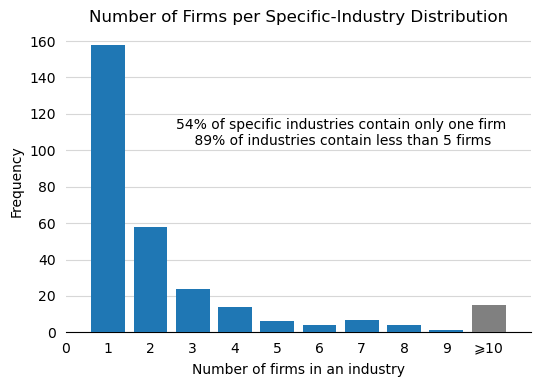

In [31]:
#Firms per industry and more relevant industries
#industry_map = {}
plt.figure(dpi = 100)
aux = df.groupby('NAICS National Industry Code')['SEDOL Code'].nunique().value_counts().sort_index(ascending = True)

more_equal_than_10 = aux.iloc[9:].sum()
aux = aux[:9]


plt.bar(aux.index, aux, zorder = 3)
plt.bar([10], more_equal_than_10, zorder = 3, color = 'gray')

plt.xlabel('Number of firms in an industry')
plt.ylabel('Frequency')
plt.title('Number of Firms per Specific-Industry Distribution')
for spine in plt.gca().spines.values():
    spine.set_visible(False)
plt.gca().spines['bottom'].set_visible(True)  
plt.grid(axis = 'y', zorder = 0, alpha = 0.5)
plt.tick_params(left = False, bottom = False)
plt.text(6.5,103, '{:.0f}% of specific industries contain only one firm\n {:.0f}% of industries contain less than 5 firms'.
         format(aux[1]/(aux.sum()+more_equal_than_10)*100, aux.iloc[:5].sum()/(aux.sum()+more_equal_than_10)*100), 
         ha = 'center')

tick_labels = [n for n in range(10)]
tick_labels.append(r"$\geqslant10$")
plt.xticks(range(12), tick_labels)


print('Distribution of firms per specific-industy because it considers the six digit NAICS Code.')
print('Consider the sparcity of this feature when implementing a model.')

In [32]:
NAICS = pd.read_html('https://www.naics.com/search/')[0]
for col in NAICS.columns:
    NAICS[col].astype(str)
NAICS.drop('Number of Business Establishments',axis = 1, inplace = True)
NAICS.dropna(inplace = True) #Because if NAN, it prevent the string type casting.
print(NAICS)
NAICS['Code'] = NAICS['Code'].apply(lambda code:code[:2])
df['Industry'] = df['NAICS National Industry Code'].apply(lambda code: np.nan if code is np.nan else code[:2])
map_exceptions = {'32': '31', '33':'31', '45':'44','49':'48'}
df['Industry'] = df['Industry'].apply(lambda code: map_exceptions[code] if (code in map_exceptions.keys()) else code)
df[['NAICS National Industry Code','Industry']].head(5)
df = pd.merge(df.reset_index(),NAICS, left_on='Industry', right_on='Code', how = 'left')
df.drop(['Industry', 'Code'], axis = 1, inplace = True)
df.set_index('period', inplace = True)

print('\nFirms {} have Null values in the industry field'.format(df[df['NAICS National Industry Code'].isnull()]['SEDOL Code'].unique()))

     Code                                     Industry Title
0      11         Agriculture, Forestry, Fishing and Hunting
1      21                                             Mining
2      22                                          Utilities
3      23                                       Construction
4   31-33                                      Manufacturing
5      42                                    Wholesale Trade
6   44-45                                       Retail Trade
7   48-49                     Transportation and Warehousing
8      51                                        Information
9      52                              Finance and Insurance
10     53                     Real Estate Rental and Leasing
11     54   Professional, Scientific, and Technical Services
12     55            Management of Companies and Enterprises
13     56  Administrative and Support and Waste Managemen...
14     61                               Educational Services
15     62               

Distribution of firms per general-industy because it considers first two digits of NAICS Code.
Consider the sparcity of this feature when implementing a model.


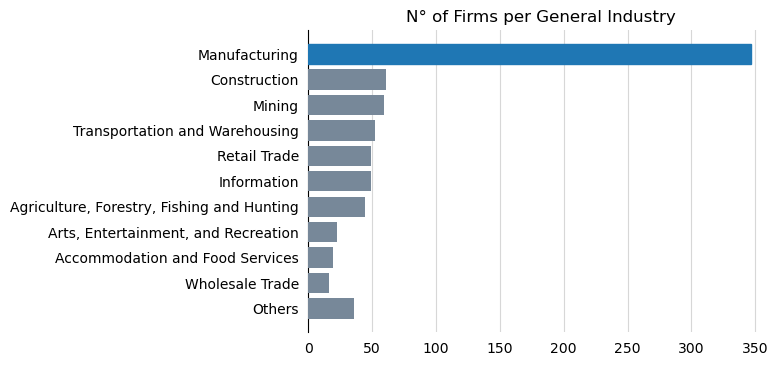

In [33]:
aux = df.groupby('Industry Title')['SEDOL Code'].nunique().sort_values(ascending = True)
others = aux.iloc[:5]
aux_mod = aux.iloc[5:]

plt.figure(dpi = 100)
bars1 = plt.barh(['Others'], others.sum(), color='lightslategrey', zorder = 3)
bars2 = plt.barh(aux_mod.index, aux_mod,color='lightslategrey', zorder = 3)
bars2[9].set_color('#1F77B4')

plt.tick_params(left = False, bottom = False)
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)

plt.grid(axis = 'x', zorder = 0, alpha = 0.5)

plt.title('N° of Firms per General Industry')

print('Distribution of firms per general-industy because it considers first two digits of NAICS Code.')
print('Consider the sparcity of this feature when implementing a model.')

Aqui se hace la eliminación de países y de columnas innecesarias para el cálculo de
los indicadores financieros: df → df_01

In [34]:
#Manipulation for easily deleting countries not contained in the list.
keep_c = ['Brazil', 'Chile', 'Mexico',  'Peru']
df['keep_country'] = df['Country of Headquarters'].apply(lambda c: True if c in keep_c else False)

df_01 = df.drop(['Identifier', 'Company Common Name','Business Description'], axis = 1)
#Columns needed for computing financial indicators
keep_cols =['Country of Headquarters', 'SEDOL Code','Industry Title','Total Assets',
                    'Total Liabilities', 'Total Equity', 'Total Debt', 'Property/Plant/Equipment, Total - Net',
                   'Net Income', 'Total Current Assets', 'Total Current Liabilities','keep_country']

#Null evaluation progress
df_null_ev = pd.DataFrame(1-df[keep_cols].isnull().sum()/df.shape[0], columns = ['it_0']).drop('keep_country')
df_01 = df_01[keep_cols]
df_01 = df_01[df_01['keep_country'] == True].drop('keep_country', axis =1)
df_null_ev['it_01'] = 1-df_01.isnull().sum()/df_01.shape[0]
df_01.head()

,Country of Headquarters,SEDOL Code,Industry Title,Total Assets,Total Liabilities,Total Equity,Total Debt,"Property/Plant/Equipment, Total - Net",Net Income,Total Current Assets,Total Current Liabilities
period,,,,,,,,,,,
2000Q1,Brazil,2645517,Manufacturing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000Q1,Chile,2518932,Transportation and Warehousing,986755.0,700124.0,286631.0,392555.0,603803.0,25358.0,264624.0,229469.0
2000Q1,Brazil,2490245,Manufacturing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000Q1,Brazil,2095479,Manufacturing,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2000Q1,Chile,2349831,"Agriculture, Forestry, Fishing and Hunting",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [36]:
#Individual firm plotting across time.

# for code in df_01['SEDOL Code'].unique():
#     plt.close()
#     fig, ax = plt.subplots(figsize = (12,6))
#     df_01[df_01['SEDOL Code']==code].iloc[:,3:].plot(ax = ax);
#     plt.savefig('Dataset Images\pre-processed_features_per_firm\{}.png'.format(code), dpi = 100)

#No es razonable hacer un reemplazo de valores faltantes por promedio debido a que las observaciones
#Estan correlacionadas en el tiempo.

In [37]:
aux = 1-df_01.isnull().sum()/df_01.shape[0]
aux.sort_values(ascending = False, inplace = True)
nn_ordered_cols = aux.index

null_matrix = df_01.isnull()
plt.figure(figsize = (23,10),dpi = 1000)
sns.heatmap(1-df_01.isnull()[nn_ordered_cols],cmap = 'viridis',vmax =1,vmin = 0)
plt.title('Null Values',fontdict=dict(size=20))
plt.ylabel(None)
#plt.savefig('dataset.png',dpi = 1500)
# plt.show()

Text(2587.222222222222, 0.5, '')

In [38]:
#Ejecutar en la noche - recordar cambiar la config. para que el pc no se duerma.

# aux_1 = pd.DataFrame()
# #aux_2 = pd.DataFrame()
# for col, i in zip(df.isnull().columns, range(1,df.shape[1]+1)):
#     aux_1[col] = df.isnull()[col].apply(lambda v: v*i)

# aux_2 = df.isnull().values*np.arange(1,df.shape[0]+1).reshape(-1,1)
# a = aux_1.values.reshape(-1,)
# b = aux_2.reshape(-1,)
# sns.jointplot(a,b, kind ='kde')

In [39]:
pct_change = (df_01.shape[0]-df_01.dropna().shape[0])/df_01.shape[0]*100
print('At this point, droping all samples with one or more Null values would result in a decrease of {:.1f}% in size.'.
      format(pct_change))
    
#Se podrían interpolar valores de acuerdo a la temporalidad.
#Se podrían rellenar utilizando el promedio de la empresa.

#graficar media movil y desv estandar por empresa (Serie de tpo)

At this point, droping all samples with one or more Null values would result in a decrease of 38.9% in size.


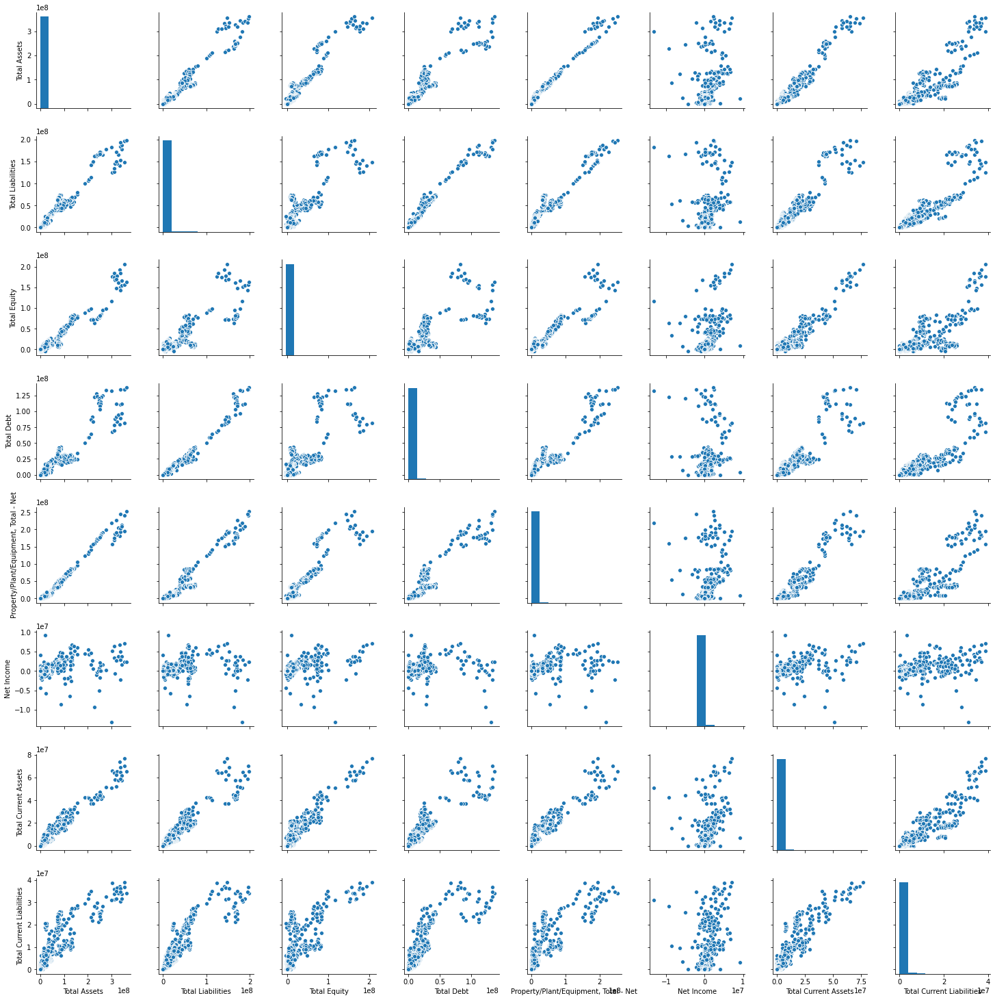

In [40]:
sns.pairplot(df_01)

In [41]:
#Evaluar la opción de filtrar outliers.

#ANOMALY DETECTION ALGORITHM??


df_01 = df_01.reset_index().set_index(['SEDOL Code', 'period'])
df_01.sort_index(inplace = True)
df_01.head(5)

Country of Headquarters Industry Title  Total Assets  \
SEDOL Code period                                                        
2000859    2000Q1                    Peru  Manufacturing           NaN   
           2000Q2                    Peru  Manufacturing           NaN   
           2000Q3                    Peru  Manufacturing           NaN   
           2000Q4                    Peru  Manufacturing           NaN   
           2001Q1                    Peru  Manufacturing           NaN   

                   Total Liabilities  Total Equity  Total Debt  \
SEDOL Code period                                                
2000859    2000Q1                NaN           NaN         NaN   
           2000Q2                NaN           NaN         NaN   
           2000Q3                NaN           NaN         NaN   
           2000Q4                NaN           NaN         NaN   
           2001Q1                NaN           NaN         NaN   

                   Property/Plant/Equipment, Total - Net  Net Income  \
SEDOL Code period                                                      
2000859    2000Q1                                    NaN         NaN   
           2000Q2                                    NaN         NaN   
           2000Q3                                    NaN         NaN   
           2000Q4                                    NaN         NaN   
           2001Q1                                    NaN         NaN   

                   Total Current Assets  Total Current Liabilities  
SEDOL Code period                                                   
2000859    2000Q1                   NaN                        NaN  
           2000Q2                   NaN                        NaN  
           2000Q3                   NaN                        NaN  
           2000Q4                   NaN                        NaN  
           2001Q1                   NaN                        NaN

In [42]:
#verification of continuity of time series for each firm to guarantee a correct implementation of 
#lagged columns / variables.
firms = list(set(df_01.index.get_level_values(0)))
firms.sort()
i=0
uncomplete =[]
for firm in firms:
#     print(' {} '.center(80,'*').format(firm))

#     print(df_01.loc[(firm)].index)
#     print(df_01.loc[(firm)].index[0])
#     print(df_01.loc[(firm)].index[-1])
#     print(pd.period_range(df_01.loc[(firm)].index[0],end = df_01.loc[(firm)].index[-1], freq = 'Q' ))

    curr_index = df_01.loc[(firm)].index
    aux_index = pd.period_range(df_01.loc[(firm)].index[0],end = df_01.loc[(firm)].index[-1],freq = 'Q')

    try:
        index_check = sum(curr_index==aux_index)
        if index_check == len(curr_index): i=i+1
    except: uncomplete.append(firm)
print('Firms with uncontinuous quarterly time series:{}.'.format(uncomplete))
print('{:.1f}% of firms have continuous time series.'.format(i/len(firms)*100))

Firms with uncontinuous quarterly time series:['2186986', '2390572', '2448200', '2821867', '2829850', 'B3PRBK3'].
99.0% of firms have continuous time series.


Se añaden filas para tener el registro continuo de las series por empresa: df_01 → df_02

In [43]:
#To reindex firms with missing quarterly periods:
error_to_reindex = []
df_02 = df_01.copy()
for firm in uncomplete:
    try: aux_df = df_02.loc[(firm)].reindex(pd.period_range(df_02.loc[(firm)].index[0],
                                                          end = df_02.loc[(firm)].index[-1], freq = 'Q'))
    except Exception as e: 
        error_to_reindex.append((firm,e))
        continue

    aux_df.index = pd.MultiIndex.from_product([[firm],aux_df.index]) #Set correct index for posterior concatenation
    drop_index = pd.MultiIndex.from_product([[firm],df_02.loc[(firm)].index])
    
    df_02.drop(drop_index, inplace = True) #Deletes all entries of incomplete firm
    df_02 = pd.concat([df_02, aux_df]) #Adds complete serie of the previous uncompleted firm

#Removal of firm '2448200':
index = pd.MultiIndex.from_product([['2448200'],df_02.loc[('2448200')].index])
df_02.drop(index, inplace = True)

    
print(error_to_reindex)
print('Firm \'2448200\' has repeated quarters and all numerical fields filled with NA values, therefore it has been removed frome the dataset.')

#Because of a firm removal, the firm list needs to be updated:
firms.remove('2448200')

[('2448200', ValueError('cannot reindex from a duplicate axis'))]
Firm '2448200' has repeated quarters and all numerical fields filled with NA values, therefore it has been removed frome the dataset.


In [44]:
def create_lag(var,shift,df):
    '''This function is only usable  in a dataframe with multiindex ['SEDOL CODE','period'].
    It add a new column to the input df  with shift periods (quarters)'''
    

    aux_series = pd.Series(dtype=np.float)
    verbose = False
    for firm in firms:
        aux = df.loc[(firm),var].sort_index().shift(shift) #level 0 index is lost when loc indexing.

#         if verbose is True:
#             print(' {} , {} '.format(firm,i).center(80, '*'))
#             print('aux:\n\n{}'.format(aux))
#             print('\nindex to insert:\n\n{}'.format(df.index[i:i+aux.shape[0]]))

        aux.index = pd.MultiIndex.from_product([[firm], aux.index])
        aux_series = pd.concat([aux_series,aux]) #When concatenating, the MultiIndex casts to a tuple index.
    aux_series.name = '{} - lag{}'.format(var,shift)
    aux_series.index = pd.MultiIndex.from_tuples(aux_series.index) #Casting back to a MultiIndex
    aux_series.rename_axis(['SEDOL Code', 'period'], inplace = True)
    df = pd.merge(df, aux_series, left_index=True,right_index=True)
    return df

In [45]:
max_lag = 9 #All columns lagged upto 8 cuarters. I.e. 2 years
for var in df_02.columns[2:]:
    for lag in range(1,max_lag):
        df_02 = create_lag(var,lag,df_02)

Cálculo de los indicadores financieros en df_02

In [46]:
df_02['Growth'] = (df_02['Total Assets']-df_02['Total Assets - lag1'])/df_02['Total Assets - lag1']
for lag in range(1,max_lag):
    if lag < max_lag-1:
        df_02['Growth - lag{}'.format(lag)] = (df_02['Total Assets - lag{}'.format(lag)]-df_02['Total Assets - lag{}'.format(lag+1)])/df_02['Total Assets - lag{}'.format(lag+1)]

df_02['Tangibility'] = df_02['Property/Plant/Equipment, Total - Net']/df_02['Total Assets']
for lag in range(1,max_lag):
    df_02['Tangibility - lag{}'.format(lag)] = df_02['Property/Plant/Equipment, Total - Net - lag{}'.format(lag)]/df_02['Total Assets - lag{}'.format(lag)]
    

df_02['Liquidity'] = df_02['Total Current Assets']/ df_02['Total Current Liabilities']
for lag in range(1,max_lag):
    df_02['Liquidity - lag{}'.format(lag)] = df_02['Total Current Assets - lag{}'.format(lag)]/ df_02['Total Current Liabilities - lag{}'.format(lag)]


df_02['Profitability'] = df_02['Net Income']/df_02['Total Assets']
for lag in range(1,max_lag):
    df_02['Profitability - lag{}'.format(lag)] = df_02['Net Income - lag{}'.format(lag)]/df_02['Total Assets - lag{}'.format(lag)]

    
df_02['Firm size'] = df_02['Total Assets'].apply(np.log)
for lag in range(1,max_lag):
    df_02['Firm size - lag{}'.format(lag)] = df_02['Total Assets - lag{}'.format(lag)].apply(np.log)

    
df_02['Total leverage'] = df_02['Total Liabilities']/df_02['Total Assets']
for lag in range(1,max_lag):
     df_02['Total leverage - lag{}'.format(lag)] = df_02['Total Liabilities - lag{}'.format(lag)]/df_02['Total Assets - lag{}'.format(lag)]
    
    
df_02['Financial leverage'] = df_02['Total Debt']/df_02['Total Equity']
for lag in range(1,max_lag):
    df_02['Financial leverage - lag{}'.format(lag)] = df_02['Total Debt - lag{}'.format(lag)]/df_02['Total Equity - lag{}'.format(lag)]   

In [471]:
plt.figure(figsize = (23,10),dpi = 1000)
sns.heatmap(1-df_02.reset_index().set_index('period').sort_index().isnull(), cmap = 'viridis')
plt.title('Null values - upto 2 years lagged variables')

Text(0.5, 1.0, 'Null values - upto 2 years lagged variables')

In [48]:
drop_pct = (df_02.shape[0]-df_02.dropna().shape[0])/df_02.shape[0]*100
drop_net = df_02.shape[0]-df_02.dropna().shape[0]

print('Dropping all samples with at least one NA value at this point, considering {} lagged periods will result in a decrease of {:.1f}% in the dataset size.'.
     format(max_lag-1,drop_pct))
print('Dataset size pre-drop: {}\nDataset size post-drop: {}'.format(df_02.shape[0],df_02.dropna().shape[0]))

Dropping all samples with at least one NA value at this point, considering 8 lagged periods will result in a decrease of 56.1% in the dataset size.
Dataset size pre-drop: 44769
Dataset size post-drop: 19640


The plot corresponds to the dataset resulting size by removing all samples with one or more Null entries.


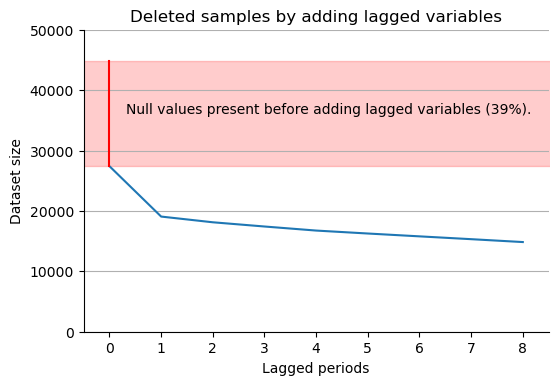

In [49]:
#Values will be stored and then will be used for plotting. The computing of these values was done
#by executing the previous code manually for different max_lag values.
dataset_size = [27403, 19065, 18119, 17420, 16748, 16260, 15789, 15322, 14845]
dataset_size_with_nulls = 44769
lagged_periods = np.arange(9)

plt.figure(dpi = 100)
plt.plot(lagged_periods, dataset_size)
plt.plot([0,0],[dataset_size_with_nulls,dataset_size[0] ],'r')
plt.xlabel('Lagged periods')
plt.ylabel('Dataset size')
plt.title('Deleted samples by adding lagged variables')
plt.grid(axis = 'y')
plt.fill_between([-1,9], [dataset_size_with_nulls,dataset_size_with_nulls], 
                 [dataset_size[0], dataset_size[0]], color = 'r', alpha = 0.2)
plt.xlim((-0.5,8.5))
plt.ylim((0,50000))
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.text(4.25,(dataset_size_with_nulls+dataset_size[0])/2,'Null values present before adding lagged variables ({:.0f}%).'.
         format((dataset_size_with_nulls-dataset_size[0])/dataset_size_with_nulls*100),ha ='center')

#plt.gca().yaxis.set_minor_locator(plt.MultipleLocator(5000))
print('The plot corresponds to the dataset resulting size by removing all samples with one or more Null entries.')

In [50]:
#Financial indicators per firm plot.

# for firm in firms:
#     plt.close()
#     fig, ax = plt.subplots(figsize = (12,6), dpi = 500)
#     df_02.loc[(firm),df_02.columns[11:]].plot(ax = ax)
#     plt.savefig('Dataset Images\processed_features_per_firm\{}.png'.format(firm), dpi = 100)

With so few samples per firm, is impossible to fit an individual model per firm.


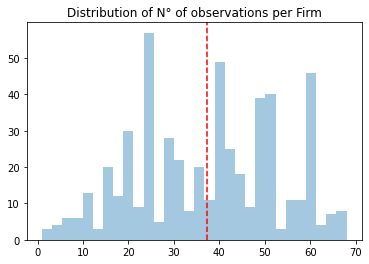

In [51]:
aux = df_02.reset_index().dropna()['SEDOL Code'].value_counts()
sns.distplot(aux,kde = False, bins = 30)
plt.title('Distribution of N° of observations per Firm')
plt.xlabel(None)
# plt.gca().spines['right'].set_visible(False)
# plt.gca().spines['top'].set_visible(False)
plt.axvline(aux.mean(), ls = '--', color = 'r')
#plt.text(aux.mean(), -0.0035, r'$\mu$', ha = 'center')
print('With so few samples per firm, is impossible to fit an individual model per firm.')

In [52]:
df_03 = df_02.copy()
df_03 = pd.get_dummies(df_03, columns = ['Country of Headquarters'])
for col in df_03.columns:
    print(col)

Industry Title
Total Assets
Total Liabilities
Total Equity
Total Debt
Property/Plant/Equipment, Total - Net
Net Income
Total Current Assets
Total Current Liabilities
Total Assets - lag1
Total Assets - lag2
Total Assets - lag3
Total Assets - lag4
Total Assets - lag5
Total Assets - lag6
Total Assets - lag7
Total Assets - lag8
Total Liabilities - lag1
Total Liabilities - lag2
Total Liabilities - lag3
Total Liabilities - lag4
Total Liabilities - lag5
Total Liabilities - lag6
Total Liabilities - lag7
Total Liabilities - lag8
Total Equity - lag1
Total Equity - lag2
Total Equity - lag3
Total Equity - lag4
Total Equity - lag5
Total Equity - lag6
Total Equity - lag7
Total Equity - lag8
Total Debt - lag1
Total Debt - lag2
Total Debt - lag3
Total Debt - lag4
Total Debt - lag5
Total Debt - lag6
Total Debt - lag7
Total Debt - lag8
Property/Plant/Equipment, Total - Net - lag1
Property/Plant/Equipment, Total - Net - lag2
Property/Plant/Equipment, Total - Net - lag3
Property/Plant/Equipment, Total - N

In [53]:
df_03['Incompatible'] = df_03.apply(lambda row: 
                                    True if ((row['Total leverage']>1) |
                                             (row['Tangibility']>1)|
                                             (row['Growth']>100)|
                                             (row['Growth - lag1']>100)|
                                             (row['Growth - lag2']>100)|
                                             (row['Growth - lag3']>100)|
                                             (row['Growth - lag4']>100)|
                                             (row['Growth - lag5']>100)|
                                             (row['Growth - lag6']>100)|
                                             (row['Growth - lag7']>100)) else 0, axis = 1)


print('{} samples have inconsistent values for tangibility or total leverage.'.format(df_03['Incompatible'].sum()))
df_03.drop(df_03[df_03['Incompatible']==True].index, inplace = True)
df_03.drop('Incompatible', axis = 1, inplace = True)

2187 samples have inconsistent values for tangibility or total leverage.


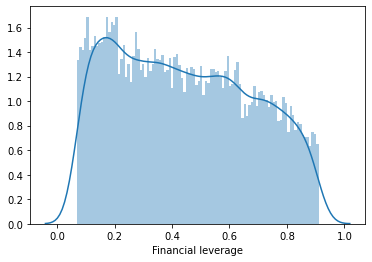

In [54]:
sns.distplot(df_03[(df_03['Financial leverage']>0.068072) & (df_03['Financial leverage']<0.91)]['Financial leverage'], bins = 100)

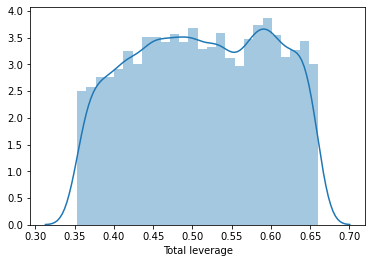

In [55]:
aux_series = df_03['Total leverage'].replace([-np.inf,np.inf],np.nan)
q1 = aux_series.describe().iloc[4]
q4 = aux_series.describe().iloc[6]

sns.distplot(aux_series[(aux_series>q1)&(aux_series<q4)] )

Text(0.5, 1.0, 'Samples per Quarter distribution')

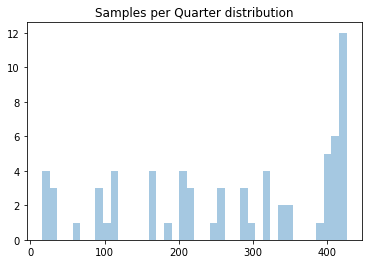

In [56]:
sns.distplot(df_03.dropna().groupby(level = 1)['Industry Title'].count(), bins = 40, kde = False)
plt.xlabel(None)
plt.title('Samples per Quarter distribution')

In [472]:
#Construct dataset for period and lagged variables.

financial_indicators = ['Growth',
                        'Tangibility',
                        'Liquidity',
                        'Profitability',
                        'Firm size',
                        'Total leverage',
                        'Financial leverage']

#Without data leakage columns. I.e Total Liabilities & Total Current Liabilities.
pre_processed_info = ['Total Assets',
                      'Total Liabilities',
                      'Total Current Liabilities',
                      'Total Equity',
                      'Total Debt',
                      'Property/Plant/Equipment, Total - Net',
                      'Net Income',
                      'Total Current Assets',]



lag_removal_cols = {}
max_lag = [0,4,8] #years included as lagged variables. I.e 1(year): 4 quarters, 2(years):8 quarters.

for lag_iter in max_lag:
    lag_removal_cols[lag_iter] = []
    for col in financial_indicators+pre_processed_info:
        for lag in range(lag_iter+1,9):
            lag_removal_cols[lag_iter].append('{} - lag{}'.format(col,lag))   
    if lag_iter<8:
        lag_removal_cols[lag_iter].remove('Growth - lag8') #Its not computed originaly because it would need Total Assets - lag9

        
# Recesion in the US. Fourth quarter of 2007 until the third quarter of 2009
sub_sets = [((('2007Q4','2009Q3')),'crisis'),
            ((('2000Q1','2007Q4')), 'pre-crisis'),
            ((('2009Q3','2018Q4')), 'post-crisis'),
           ((('2000Q1','2018Q4')), 'complete')]


data = {} #data is a dict that contains, first the period, and then the lag structure.
df_03.sort_index(inplace = True)
for period, period_name in sub_sets:
    data[period_name]={}
    for lag in max_lag:
        data[period_name][lag] = df_03.loc[(slice(None),slice(period[0],period[1])),:].copy()
        data[period_name][lag].drop(lag_removal_cols[lag], axis = 1, inplace = True)
        data[period_name][lag].replace([np.inf, -np.inf], np.nan, inplace = True)
        data[period_name][lag].dropna(inplace = True)
    print('Dataset size {}: {}'.format(period_name, data[period_name][8].shape[0]))
print('\ndata level 0 keys: {}'.format(data.keys()))
print('data level 1 keys: {}'.format(data['crisis'].keys()))

pickle.dump(data, open('data.pkl', 'wb'))
#Data dict contains ready-to-use datasets

Dataset size crisis: 1768
Dataset size pre-crisis: 2556
Dataset size post-crisis: 14226
Dataset size complete: 18108

data level 0 keys: dict_keys(['crisis', 'pre-crisis', 'post-crisis', 'complete'])
data level 1 keys: dict_keys([0, 4, 8])


In [476]:
data = pickle.load(open('data.pkl', 'rb'))

In [40]:
#Finally this time series split its not appropiate to validate the models performance because
#it only shifts the dataset to obtain the train test split.

# from sklearn.model_selection import TimeSeriesSplit
# from xgboost import XGBRegressor
# from sklearn.metrics import r2_score
# #2500

# xgb_params_dict = {'n_estimators':1000,
#              'max_depth':3,
#               'n_jobs':-1,
#               'learning_rate': 0.001}

# xgb_params = {}
# xgb_params['pre-crisis'] = xgb_params_dict
# xgb_params['crisis'] = xgb_params_dict         
# xgb_params['post-crisis'] = xgb_params_dict
# xgb_params['complete'] = xgb_params_dict
                   
                   
# fold_list = []
# lag_list = []
# period_list = []
# r2_train_list = []
# r2_test_list = []


# for period in ['pre-crisis', 'crisis', 'post-crisis', 'complete']:

#     for lag in max_lag:
#         X = data[period][lag].drop(['Financial leverage', 'Industry Title','Total leverage'], axis = 1)
#         #X = pd.get_dummies(X.reset_index(), columns = ['SEDOL Code']).drop('period',axis = 1)
#         y = data[period][lag]['Total leverage']


#         tscv = TimeSeriesSplit(max_train_size=None, n_splits=3)
#         fold = 1
#         for train_index, test_index in tscv.split(X):
#             print('Fitting model to {} dataset with {} lagged variables - Fold {}'.format(period, lag,fold))
#             X_train, X_test = X.iloc[train_index], X.iloc[test_index]
#             y_train, y_test = y.iloc[train_index], y.iloc[test_index]
#             xgb = XGBRegressor(**xgb_params[period]).fit(X_train,y_train)
#             preds_train= xgb.predict(X_train)
#             preds_test = xgb.predict(X_test)

#             fold_list.append(fold)
#             lag_list.append(lag)
#             period_list.append(period)
#             r2_train_list.append(r2_score(y_train,preds_train))
#             r2_test_list.append(r2_score(y_test,preds_test))
            
#             fold = fold+1

# results_df = pd.DataFrame({'R2 train': r2_train_list, 'R2 test': r2_test_list,
#                           'period':period_list,'lag':lag_list, 'Fold': fold_list})

# results_df.set_index(['period', 'lag', 'Fold'], inplace = True)
# results_df.unstack()



# X_train_merf, Z_train, clusters_train, y_train_merf = transform(X_train, y_train)
# X_test_merf, Z_test, clusters_test, y_test_merf = transform(X_test, y_test)

In [41]:
# xgb_params_dict = {'n_estimators':2500,
#              'max_depth':3,
#               'n_jobs':-1,
#               'learning_rate': 0.01}
# xgb = XGBRegressor(**xgb_params_dict)



# remove_cols =['Industry Title',
#               'Growth', 'Total Equity',
#                         'Tangibility',
#                         'Liquidity',
#                         'Profitability',
#                         'Firm size',
#                         'Total leverage',
#                         'Financial leverage',
#                         'Total Assets',
#                         'Total Liabilities',
#                         'Total Current Liabilities',
#                         'Total Debt',
#                         'Property/Plant/Equipment, Total - Net',
#                         'Net Income',
#                         'Total Current Assets',]







# #leak cols are every col that includes information about total liabilities
# leak_cols = ['']

# X_train = data['complete'][4].loc[(slice(None),slice('2011Q1', '2012Q4')),:].drop(remove_cols, axis = 1)

# y_train = data['complete'][4].loc[(slice(None),slice('2011Q1', '2012Q4')),'Total leverage']

# X_test = data['complete'][4].loc[(slice(None),'2013Q1'),:].drop(remove_cols, axis = 1)
# y_test = data['complete'][4].loc[(slice(None),'2013Q1'),'Total leverage']

# print('Fitting model with {} samples'.format(X_train.shape[0]))
# xgb.fit(X_train,y_train)
# preds_train = xgb.predict(X_train)
# preds_test = xgb.predict(X_test)
# print(r2_score(y_train,preds_train), r2_score(y_test,preds_test))

# plt.figure(figsize=(12,6))
# plt.bar(X_train.columns,xgb.feature_importances_)
# plt.xticks(rotation = 90);


In [42]:
# xgb_params_dict = {'n_estimators':2500,
#              'max_depth':3,
#               'n_jobs':-1,
#               'learning_rate': 0.01}
# xgb = XGBRegressor(**xgb_params_dict)



# remove_cols =['Industry Title',
#               'Growth', 'Total Equity',
#                         'Tangibility',
#                         'Liquidity',
#                         'Profitability',
#                         'Firm size',
#                         'Total leverage',
#                         'Financial leverage',
#                         'Total Assets',
#                         'Total Liabilities',
#                         'Total Current Liabilities',
#                         'Total Debt',
#                         'Property/Plant/Equipment, Total - Net',
#                         'Net Income',
#                         'Total Current Assets',]

# pre_processed_info = ['Total Assets',
#                       'Total Liabilities',
#                       'Total Current Liabilities',
#                       'Total Equity',
#                       'Total Debt',
#                       'Property/Plant/Equipment, Total - Net',
#                       'Net Income',
#                       'Total Current Assets',]

# remove_cols_2 = []
# for col in pre_processed_info:
#     for lag in range(1,5):
#         remove_cols_2.append('{} - lag{}'.format(col,lag))



# #leak cols are every col that includes information about total liabilities
# leak_cols = ['']

# X_train = data['complete'][4].loc[(slice(None),slice('2011Q1', '2012Q4')),:].drop(remove_cols+remove_cols_2, axis = 1)

# y_train = data['complete'][4].loc[(slice(None),slice('2011Q1', '2012Q4')),'Total leverage']

# X_test = data['complete'][4].loc[(slice(None),'2013Q1'),:].drop(remove_cols+remove_cols_2, axis = 1)
# y_test = data['complete'][4].loc[(slice(None),'2013Q1'),'Total leverage']

# print('Fitting model with {} samples'.format(X_train.shape[0]))
# xgb.fit(X_train,y_train)
# preds_train = xgb.predict(X_train)
# preds_test = xgb.predict(X_test)
# print(r2_score(y_train,preds_train), r2_score(y_test,preds_test))

# plt.figure(figsize=(12,6))
# plt.bar(X_train.columns,xgb.feature_importances_)
# plt.xticks(rotation = 90);
# print('We can see that the model gets better fitting metrics including raw- pre.processed features')

In [43]:
#replicate of previous cell with MERF model. Results improve with MERF.

# from merf.merf import MERF
# def transform(X,y):
#     clusters = X.reset_index()['SEDOL Code']
#     Z = np.ones((X.shape[0], 1))
#     return X.reset_index().iloc[:,2:], Z, clusters, y.reset_index().iloc[:,-1]

# xgb_params_dict = {'n_estimators':2500,
#              'max_depth':3,
#               'n_jobs':-1,
#               'learning_rate': 0.01}





# remove_cols =['Industry Title',
#               'Growth', 'Total Equity',
#                         'Tangibility',
#                         'Liquidity',
#                         'Profitability',
#                         'Firm size',
#                         'Total leverage',
#                         'Financial leverage',
#                         'Total Assets',
#                         'Total Liabilities',
#                         'Total Current Liabilities',
#                         'Total Debt',
#                         'Property/Plant/Equipment, Total - Net',
#                         'Net Income',
#                         'Total Current Assets',]





# merf = MERF(fixed_effects_model=XGBRegressor(**xgb_params_dict), max_iterations=20)

# #leak cols are every col that includes information about total liabilities
# leak_cols = ['']

# X_train = data['complete'][4].loc[(slice(None),slice('2011Q1', '2012Q4')),:].drop(remove_cols, axis = 1)

# y_train = data['complete'][4].loc[(slice(None),slice('2011Q1', '2012Q4')),'Total leverage']

# X_test = data['complete'][4].loc[(slice(None),'2013Q1'),:].drop(remove_cols, axis = 1)
# y_test = data['complete'][4].loc[(slice(None),'2013Q1'),'Total leverage']

# X_train, Z_train, clusters_train, y_train = transform(X_train,y_train)
# X_test, Z_test, clusters_test, y_test = transform(X_test,y_test)

# print('Fitting model with {} samples'.format(X_train.shape[0]))
# merf.fit(X_train,Z_train,clusters_train,y_train)
# preds_train = merf.predict(X_train,Z_train,clusters_train)
# preds_test = merf.predict(X_test,Z_test,clusters_test)
# print(r2_score(y_train,preds_train), r2_score(y_test,preds_test))

# plt.figure(figsize=(12,6))
# plt.bar(X_train.columns,merf.fe_model.feature_importances_)
# plt.xticks(rotation = 90);

In [44]:
# xgb_params_dict = {'n_estimators':2500, 
#              'max_depth':3,
#               'n_jobs':-1,
#               'learning_rate': 0.01}

# remove_cols =['Industry Title',
#               'Growth', 'Total Equity',
#                         'Tangibility',
#                         'Liquidity',
#                         'Profitability',
#                         'Firm size',
#                         'Total leverage',
#                         'Financial leverage',
#                         'Total Assets',
#                         'Total Liabilities',
#                         'Total Current Liabilities',
#                         'Total Debt',
#                         'Property/Plant/Equipment, Total - Net',
#                         'Net Income',
#                         'Total Current Assets',]


# r2_train = []
# r2_test = []
# period_train = []
# period_test = []
# n_samples_train = []
# n_samples_test = []

# training_periods = 7
# end_period = pd.Period('2018Q4', freq = 'Q')-training_periods-1
# for period, it in zip(pd.period_range('2000Q1', end = end_period, freq = 'Q'), range (1,18*4+1)):
#     xgb = XGBRegressor(**xgb_params_dict)
#     X_train = data['complete'][4].loc[(slice(None),slice(period, period+training_periods)),:].drop(remove_cols, axis = 1)
#     y_train = data['complete'][4].loc[(slice(None),slice(period, period+training_periods)),'Total leverage']

#     X_test = data['complete'][4].loc[(slice(None),period+training_periods+1),:].drop(remove_cols, axis = 1)
#     y_test = data['complete'][4].loc[(slice(None),period+training_periods+1),'Total leverage']

#     print('Fitting model with {} samples - period {} - {}'.format(X_train.shape[0], period, period+training_periods))
#     xgb.fit(X_train,y_train)
#     preds_train = xgb.predict(X_train)
#     preds_test = xgb.predict(X_test)
#     print('Testing model with {} samples - period {}'.format(X_test.shape[0],  period+training_periods+1))
#     print('R2 train: {:.2f}\nR2 test: {:.2f}\n'.format(r2_score(y_train,preds_train), r2_score(y_test,preds_test)))
    
#     r2_train.append(r2_score(y_train,preds_train))
#     r2_test.append(r2_score(y_test,preds_test))
#     period_train.append((period,period+training_periods))
#     period_test.append(period+training_periods+1)
#     n_samples_train.append(X_train.shape[0])
#     n_samples_test.append(X_test.shape[0])
    
# results_df = pd.DataFrame({'R2 train': r2_train,
#              'R2 test': r2_test,
#               'Training period': period_train,
#               'Testing period': period_test,
#               'N° training samples': n_samples_train,
#               'N° testing samples': n_samples_test})
# results_df_2y = results_df

In [45]:
# sns.lmplot(x = 'N° training samples',y = 'R2 test',data = results_df_2y)
# plt.ylim(0,1)

In [46]:
# sns.distplot(results_df_2y['R2 test'])
# plt.xlim(-4,1)
# plt.axvline(results_df_2y['R2 test'].mean(),color = 'r')
# plt.text(results_df_2y['R2 test'].mean(), 0.2, 'mean = {:.2f}'.format(results_df_2y['R2 test'].mean()))

In [47]:
#Comparisson xgb without tunning 1y.

# xgb_params_dict = {'n_estimators':2500, 
#              'max_depth':3,
#               'n_jobs':-1,
#               'learning_rate': 0.01}

# remove_cols =['Industry Title',
#               'Growth', 'Total Equity',
#                         'Tangibility',
#                         'Liquidity',
#                         'Profitability',
#                         'Firm size',
#                         'Total leverage',
#                         'Financial leverage',
#                         'Total Assets',
#                         'Total Liabilities',
#                         'Total Current Liabilities',
#                         'Total Debt',
#                         'Property/Plant/Equipment, Total - Net',
#                         'Net Income',
#                         'Total Current Assets',]


# r2_train = []
# r2_test = []
# period_train = []
# period_test = []
# n_samples_train = []
# n_samples_test = []

# training_periods = 3
# end_period = pd.Period('2018Q4', freq = 'Q')-training_periods-1
# for period, it in zip(pd.period_range('2000Q1', end = end_period, freq = 'Q'), range (1,18*4+1)):
#     xgb = XGBRegressor(**xgb_params_dict)
#     X_train = data['complete'][4].loc[(slice(None),slice(period, period+training_periods)),:].drop(remove_cols, axis = 1)
#     y_train = data['complete'][4].loc[(slice(None),slice(period, period+training_periods)),'Total leverage']

#     X_test = data['complete'][4].loc[(slice(None),period+training_periods+1),:].drop(remove_cols, axis = 1)
#     y_test = data['complete'][4].loc[(slice(None),period+training_periods+1),'Total leverage']

#     print('Fitting model with {} samples - period {} - {}'.format(X_train.shape[0], period, period+training_periods))
#     xgb.fit(X_train,y_train)
#     preds_train = xgb.predict(X_train)
#     preds_test = xgb.predict(X_test)
#     print('Testing model with {} samples - period {}'.format(X_test.shape[0],  period+training_periods+1))
#     print('R2 train: {:.2f}\nR2 test: {:.2f}\n'.format(r2_score(y_train,preds_train), r2_score(y_test,preds_test)))
    
#     r2_train.append(r2_score(y_train,preds_train))
#     r2_test.append(r2_score(y_test,preds_test))
#     period_train.append((period,period+training_periods))
#     period_test.append(period+training_periods+1)
#     n_samples_train.append(X_train.shape[0])
#     n_samples_test.append(X_test.shape[0])
    
# results_df = pd.DataFrame({'R2 train': r2_train,
#              'R2 test': r2_test,
#               'Training period': period_train,
#               'Testing period': period_test,
#               'N° training samples': n_samples_train,
#               'N° testing samples': n_samples_test})
# results_df_1y = results_df

In [48]:
# sns.lmplot(x = 'N° training samples',y = 'R2 test',data = results_df_1y)
# plt.ylim(0,1)

In [49]:
# sns.distplot(results_df_1y['R2 test'])
# plt.xlim(-4,1)
# plt.axvline(results_df_1y['R2 test'].mean(),color = 'r')
# plt.text(results_df_1y['R2 test'].mean(), 0.2, 'mean = {:.2f}'.format(results_df_1y['R2 test'].mean()))

Grid Search - Do not delete cell below.

In [133]:
#Grid Search implementation.

def transform(X,y):
    clusters = X.reset_index()['SEDOL Code']
    Z = np.ones((X.shape[0], 1))
    return X.reset_index().iloc[:,2:], Z, clusters, y.reset_index().iloc[:,-1]


def fit_temporal_sequence_models(training_periods = 7, lagged_periods = 4, leverage = 'Total leverage', 
                                 use_non_financial_indicators = True, autoregressive = True):
    '''7 training periods = 2 years
    3 training periods = 1 year
    lagged periods: [0,4,8]'''


    grid = {'n_estimators':[2,5,10,20,30,40,50,100,200,300,500,1000,1250,1500,1750,2000,2250,2500], 
                 'max_depth':[3],
                  'n_jobs':[-1],
                  'learning_rate': np.logspace(0,-4,5)}



    t0_cols =['Industry Title',
                  'Growth', 'Total Equity',
                            'Tangibility',
                            'Liquidity',
                            'Profitability',
                            'Firm size',
                            'Total leverage',
                            'Financial leverage',
                            'Total Assets',
                            'Total Liabilities',
                            'Total Current Liabilities',
                            'Total Debt',
                            'Property/Plant/Equipment, Total - Net',
                            'Net Income',
                            'Total Current Assets',] #These corresponds to all info in t0.
    

    
    
    if leverage == 'Total leverage':
        other_lev_col = ['Financial leverage']
    else: other_lev_col = ['Total leverage']
        
    if autoregressive == False:
        current_lev_col = [leverage]
    else: current_lev_col = []
        
        
    if use_non_financial_indicators == False:
        nfi_cols = pre_processed_info
    else: nfi_cols = []
        
#     if use_non_financial_indicators == True:
#         if leverage == 'Financial leverage': data_leak = ['Total Equity', 'Total Debt']
#         else: data_leak = ['Total Assets', 'Total Liabilities']
#     else: data_leak = [] #Because this cols wil be removed because of the preprocessed info column remove.
        
        
    
    lagged_cols = [] 

    for col in  nfi_cols+other_lev_col+current_lev_col:#+ data_leak: 
        for lag in range(1,lagged_periods+1):
            lagged_cols.append('{} - lag{}'.format(col,lag))
            
    remove_cols = t0_cols+lagged_cols

    
    r2_train = []
    r2_test = []
    r2_cv = []
    period_train_start = []
    period_train_end = []
    period_test = []
    n_samples_train = []
    n_samples_cv = []
    n_samples_test = []
    xgb_best_params = []
    opt_2y = []
    merf_2y = []
    # opt_2y = {}
    # merf_2y = {}

    training_periods = 7
    end_period = pd.Period('2018Q4', freq = 'Q')-training_periods-1
    for period in pd.period_range('2000Q1', end = end_period, freq = 'Q'):
        X_train = data['complete'][lagged_periods].loc[(slice(None),slice(period, period+training_periods)),:].drop(remove_cols, axis = 1)
        y_train = data['complete'][lagged_periods].loc[(slice(None),slice(period, period+training_periods)),leverage]

        X_cv, X_test, y_cv, y_test = train_test_split(data['complete'][lagged_periods].loc[(slice(None),period+training_periods+1),:].drop(remove_cols, axis = 1), 
                                                      data['complete'][lagged_periods].loc[(slice(None),period+training_periods+1),leverage], test_size=0.5, random_state=42)

        print('Optimizing model - period {} - {}'.format(period, period+training_periods))
        opt = GridSearch(model = XGBRegressor(),param_grid = grid,parallelize = False)

        opt.fit(X_train, y_train, X_cv, y_cv)
        print('Validation R2 Score for Optimized Parameters: {:.2f}'.format(opt.score(X_cv, y_cv)))
        print('Best params: {}'.format(opt.best_params))


        X_train, Z_train, clusters_train, y_train = transform(X_train, y_train)
        X_test, Z_test, clusters_test, y_test = transform(X_test,y_test)

        merf = MERF(fixed_effects_model = XGBRegressor(**opt.best_params), max_iterations = 20,
                   gll_early_stop_threshold = 0.001)

        print('Training model with {} samples - period {}'.format(X_train.shape[0],  period+training_periods+1))
        merf.fit(X_train, Z_train, clusters_train, y_train)

        preds_train = merf.predict(X_train, Z_train,clusters_train)
        preds_test = merf.predict(X_test, Z_test, clusters_test)
        print('Testing model with {} samples - period {}'.format(X_test.shape[0],  period+training_periods+1))
        print('R2 train: {:.2f}\nR2 test: {:.2f}\n'.format(r2_score(y_train,preds_train), r2_score(y_test,preds_test)))


        r2_cv .append(opt.best_score)
        r2_train.append(r2_score(y_train,preds_train))
        r2_test.append(r2_score(y_test,preds_test))
        period_train_start.append(period)
        period_train_end.append(period+training_periods)
        period_test.append(period+training_periods+1)
        n_samples_train.append(X_train.shape[0])
        n_samples_cv.append(X_cv.shape[0])
        n_samples_test.append(X_test.shape[0])
        opt_2y.append(opt)
        merf_2y.append(merf)


    results_df = pd.DataFrame({'R2 train': r2_train,
                               'R2 cv': r2_cv,
                               'R2 test': r2_test,
                               'Training period start': period_train_start,
                               'Training period end': period_train_end,
                               'Testing period': period_test,
                               'N° training samples': n_samples_train,
                               'N° testing samples': n_samples_test})
    
    if use_non_financial_indicators==True: a = 'use'
    else: a = 'dis'
        
    if autoregressive ==True: b = '_AR'
    else: b = ''
    

    #Saving dataframe
    results_df.to_csv('grid_search_results-{}_{}tp_lag{}_{}NFI{}.csv'.format(leverage,
                                                                              training_periods,
                                                                              lagged_periods,a,b))

    #Saving merf models
    pickle.dump(merf_2y, open('merf_models-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                              training_periods,
                                                                              lagged_periods,a,b), 'wb'))

    #Saving grid search objects 
    pickle.dump(opt_2y, open('grid_search_objects-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                                     training_periods,
                                                                                     lagged_periods,a,b), 'wb'))



In [6]:
args_1 = {'leverage': 'Financial leverage',
         'use_non_financial_indicators': True,
         'autoregressive': True}

args_2 = {'leverage': 'Total leverage',
         'use_non_financial_indicators': True,
         'autoregressive': True}

args_3 = {'leverage': 'Financial leverage',
         'use_non_financial_indicators': False,
         'autoregressive': False}

args_4 = {'leverage': 'Total leverage',
         'use_non_financial_indicators': False,
         'autoregressive': False}

In [51]:
fit_temporal_sequence_models(**args_1)
fit_temporal_sequence_models(**args_2)


#Models for better interpretation according to the motivation of this work.
fit_temporal_sequence_models(**args_3)
fit_temporal_sequence_models(**args_4)


Optimizing model - period 2000Q1 - 2001Q4
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 64 samples - period 2002Q1


INFO     [merf.py:307] Training GLL is -95.88450355173204 at iteration 1.
INFO     [merf.py:307] Training GLL is -161.6895415451234 at iteration 2.
INFO     [merf.py:307] Training GLL is -185.1026124266883 at iteration 3.
INFO     [merf.py:307] Training GLL is -169.70738563225953 at iteration 4.
INFO     [merf.py:307] Training GLL is -191.48436059714723 at iteration 5.
INFO     [merf.py:307] Training GLL is -177.64292345103271 at iteration 6.
INFO     [merf.py:307] Training GLL is -173.01880319490147 at iteration 7.
INFO     [merf.py:307] Training GLL is -168.73487462336766 at iteration 8.
INFO     [merf.py:307] Training GLL is -164.7143546122193 at iteration 9.
INFO     [merf.py:307] Training GLL is -160.8813726071374 at iteration 10.
INFO     [merf.py:307] Training GLL is -157.22462543640805 at iteration 11.
INFO     [merf.py:307] Training GLL is -153.75020034980489 at iteration 12.
INFO     [merf.py:307] Training GLL is -156.3046390823802 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 16 samples - period 2002Q1
R2 train: 1.00
R2 test: 0.69

Optimizing model - period 2000Q2 - 2002Q1
Validation R2 Score for Optimized Parameters: 0.05
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 95 samples - period 2002Q2


INFO     [merf.py:307] Training GLL is -169.35201843537845 at iteration 1.
INFO     [merf.py:307] Training GLL is -323.6856972717944 at iteration 2.
INFO     [merf.py:307] Training GLL is -451.1809411767358 at iteration 3.
INFO     [merf.py:307] Training GLL is -540.3196002870867 at iteration 4.
INFO     [merf.py:307] Training GLL is -571.0667415337363 at iteration 5.
INFO     [merf.py:307] Training GLL is -548.5014089342169 at iteration 6.
INFO     [merf.py:307] Training GLL is -582.6620828749499 at iteration 7.
INFO     [merf.py:307] Training GLL is -607.8518806916 at iteration 8.
INFO     [merf.py:307] Training GLL is -611.4117562567443 at iteration 9.
INFO     [merf.py:307] Training GLL is -611.6118370803755 at iteration 10.
INFO     [merf.py:321] Gll -611.6118370803755 less than threshold 0.0003272439916042092, stopping early ...


Testing model with 20 samples - period 2002Q2
R2 train: 1.00
R2 test: 0.61

Optimizing model - period 2000Q3 - 2002Q2
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 135 samples - period 2002Q3


INFO     [merf.py:307] Training GLL is -223.5353134617724 at iteration 1.
INFO     [merf.py:307] Training GLL is -367.75755335871344 at iteration 2.
INFO     [merf.py:307] Training GLL is -413.1814155685202 at iteration 3.
INFO     [merf.py:307] Training GLL is -426.3454417685429 at iteration 4.
INFO     [merf.py:307] Training GLL is -421.40468238171036 at iteration 5.
INFO     [merf.py:307] Training GLL is -407.39858100988914 at iteration 6.
INFO     [merf.py:307] Training GLL is -401.79926908500926 at iteration 7.
INFO     [merf.py:307] Training GLL is -388.339490368548 at iteration 8.
INFO     [merf.py:307] Training GLL is -346.7096957247243 at iteration 9.
INFO     [merf.py:307] Training GLL is -340.31872248176495 at iteration 10.
INFO     [merf.py:307] Training GLL is -341.8559161755987 at iteration 11.
INFO     [merf.py:307] Training GLL is -341.0853497892331 at iteration 12.
INFO     [merf.py:307] Training GLL is -340.4622044210007 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 19 samples - period 2002Q3
R2 train: 0.99
R2 test: 0.86

Optimizing model - period 2000Q4 - 2002Q3
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 172 samples - period 2002Q4


INFO     [merf.py:307] Training GLL is -218.12375759713066 at iteration 1.
INFO     [merf.py:307] Training GLL is -393.8771997886841 at iteration 2.
INFO     [merf.py:307] Training GLL is -434.11761740022 at iteration 3.
INFO     [merf.py:307] Training GLL is -424.16277563287315 at iteration 4.
INFO     [merf.py:307] Training GLL is -422.8989362556669 at iteration 5.
INFO     [merf.py:307] Training GLL is -422.6962573545554 at iteration 6.
INFO     [merf.py:321] Gll -422.6962573545554 less than threshold 0.0004792608439879162, stopping early ...


Testing model with 20 samples - period 2002Q4
R2 train: 0.98
R2 test: 0.17

Optimizing model - period 2001Q1 - 2002Q4
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 212 samples - period 2003Q1


INFO     [merf.py:307] Training GLL is 158.21554733574575 at iteration 1.
INFO     [merf.py:307] Training GLL is 116.92340672251417 at iteration 2.
INFO     [merf.py:307] Training GLL is -27.62194248919538 at iteration 3.
INFO     [merf.py:307] Training GLL is -82.18472264758564 at iteration 4.
INFO     [merf.py:307] Training GLL is -103.80590851310323 at iteration 5.
INFO     [merf.py:307] Training GLL is -144.4854325231375 at iteration 6.
INFO     [merf.py:307] Training GLL is -192.18766436908714 at iteration 7.
INFO     [merf.py:307] Training GLL is -218.69744569774082 at iteration 8.
INFO     [merf.py:307] Training GLL is -211.4134404109668 at iteration 9.
INFO     [merf.py:307] Training GLL is -204.2004243456721 at iteration 10.
INFO     [merf.py:307] Training GLL is -184.98145576107987 at iteration 11.
INFO     [merf.py:307] Training GLL is -170.30187959727866 at iteration 12.
INFO     [merf.py:307] Training GLL is -145.55652313557036 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 43 samples - period 2003Q1
R2 train: 1.00
R2 test: -0.04

Optimizing model - period 2001Q2 - 2003Q1
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 298 samples - period 2003Q2


INFO     [merf.py:307] Training GLL is -537.9788760707817 at iteration 1.
INFO     [merf.py:307] Training GLL is -1009.6704326400503 at iteration 2.
INFO     [merf.py:307] Training GLL is -1295.8328910058776 at iteration 3.
INFO     [merf.py:307] Training GLL is -1387.1300231874666 at iteration 4.
INFO     [merf.py:307] Training GLL is -1382.577803145687 at iteration 5.
INFO     [merf.py:307] Training GLL is -1405.1088786328155 at iteration 6.
INFO     [merf.py:307] Training GLL is -1394.866117699542 at iteration 7.
INFO     [merf.py:307] Training GLL is -1405.6282415826454 at iteration 8.
INFO     [merf.py:307] Training GLL is -1405.3513060005514 at iteration 9.
INFO     [merf.py:321] Gll -1405.3513060005514 less than threshold 0.00019701907937063947, stopping early ...


Testing model with 51 samples - period 2003Q2
R2 train: 1.00
R2 test: 0.01

Optimizing model - period 2001Q3 - 2003Q2
Validation R2 Score for Optimized Parameters: 0.01
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 382 samples - period 2003Q3


INFO     [merf.py:307] Training GLL is 1394.2188790399607 at iteration 1.
INFO     [merf.py:307] Training GLL is 1696.7355811228251 at iteration 2.
INFO     [merf.py:307] Training GLL is 1667.5984847485258 at iteration 3.
INFO     [merf.py:307] Training GLL is 1572.0150665271076 at iteration 4.
INFO     [merf.py:307] Training GLL is 1504.5646396243044 at iteration 5.
INFO     [merf.py:307] Training GLL is 1379.0924518092972 at iteration 6.
INFO     [merf.py:307] Training GLL is 1202.4083238434941 at iteration 7.
INFO     [merf.py:307] Training GLL is 1213.493243975167 at iteration 8.
INFO     [merf.py:307] Training GLL is 1358.578506154109 at iteration 9.
INFO     [merf.py:307] Training GLL is 1599.5605852559456 at iteration 10.
INFO     [merf.py:307] Training GLL is 1516.057853696442 at iteration 11.
INFO     [merf.py:307] Training GLL is 1528.9299250882648 at iteration 12.
INFO     [merf.py:307] Training GLL is 1512.7013947274909 at iteration 13.
INFO     [merf.py:307] Training GLL i

Testing model with 51 samples - period 2003Q3
R2 train: 0.99
R2 test: 0.22

Optimizing model - period 2001Q4 - 2003Q3
Validation R2 Score for Optimized Parameters: 0.79
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 461 samples - period 2003Q4


INFO     [merf.py:307] Training GLL is 3059.8625022760534 at iteration 1.
INFO     [merf.py:307] Training GLL is 3191.165103335195 at iteration 2.
INFO     [merf.py:307] Training GLL is 3195.2796886178867 at iteration 3.
INFO     [merf.py:307] Training GLL is 3216.56577212131 at iteration 4.
INFO     [merf.py:307] Training GLL is 3222.381141997758 at iteration 5.
INFO     [merf.py:307] Training GLL is 3229.3898994102597 at iteration 6.
INFO     [merf.py:307] Training GLL is 3234.219010813204 at iteration 7.
INFO     [merf.py:307] Training GLL is 3236.873985380768 at iteration 8.
INFO     [merf.py:321] Gll 3236.873985380768 less than threshold 0.0008209012929202591, stopping early ...


Testing model with 49 samples - period 2003Q4
R2 train: 0.89
R2 test: -1.67

Optimizing model - period 2002Q1 - 2003Q4
Validation R2 Score for Optimized Parameters: 0.81
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 534 samples - period 2004Q1


INFO     [merf.py:307] Training GLL is 3418.8758872752787 at iteration 1.
INFO     [merf.py:307] Training GLL is 3591.16640020322 at iteration 2.
INFO     [merf.py:307] Training GLL is 3662.2069074025053 at iteration 3.
INFO     [merf.py:307] Training GLL is 3649.5731937264222 at iteration 4.
INFO     [merf.py:307] Training GLL is 3640.161459711165 at iteration 5.
INFO     [merf.py:307] Training GLL is 3638.7961517509884 at iteration 6.
INFO     [merf.py:321] Gll 3638.7961517509884 less than threshold 0.0003750679675305148, stopping early ...


Testing model with 56 samples - period 2004Q1
R2 train: 0.88
R2 test: 0.08

Optimizing model - period 2002Q2 - 2004Q1
Validation R2 Score for Optimized Parameters: 0.43
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 615 samples - period 2004Q2


INFO     [merf.py:307] Training GLL is 4311.959985062042 at iteration 1.
INFO     [merf.py:307] Training GLL is 4457.237399233667 at iteration 2.
INFO     [merf.py:307] Training GLL is 4468.386548208028 at iteration 3.
INFO     [merf.py:307] Training GLL is 4474.27574356809 at iteration 4.
INFO     [merf.py:307] Training GLL is 4477.594061389417 at iteration 5.
INFO     [merf.py:321] Gll 4477.594061389417 less than threshold 0.0007416435668046985, stopping early ...


Testing model with 61 samples - period 2004Q2
R2 train: 0.73
R2 test: 0.04

Optimizing model - period 2002Q3 - 2004Q2
Validation R2 Score for Optimized Parameters: 0.21
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 697 samples - period 2004Q3


INFO     [merf.py:307] Training GLL is 2910.705742804559 at iteration 1.
INFO     [merf.py:307] Training GLL is 3267.0794298511237 at iteration 2.
INFO     [merf.py:307] Training GLL is 3499.917520760011 at iteration 3.
INFO     [merf.py:307] Training GLL is 3486.915923921962 at iteration 4.
INFO     [merf.py:307] Training GLL is 3470.191097796363 at iteration 5.
INFO     [merf.py:307] Training GLL is 3457.9348379026846 at iteration 6.
INFO     [merf.py:307] Training GLL is 3447.4889893546147 at iteration 7.
INFO     [merf.py:307] Training GLL is 3437.810941735514 at iteration 8.
INFO     [merf.py:307] Training GLL is 3428.6550340844037 at iteration 9.
INFO     [merf.py:307] Training GLL is 2928.0253304990697 at iteration 10.
INFO     [merf.py:307] Training GLL is 3226.0275133920663 at iteration 11.
INFO     [merf.py:307] Training GLL is 3454.5056275205343 at iteration 12.
INFO     [merf.py:307] Training GLL is 3447.630020486135 at iteration 13.
INFO     [merf.py:307] Training GLL is 3

Testing model with 63 samples - period 2004Q3
R2 train: 0.94
R2 test: -2.91

Optimizing model - period 2002Q4 - 2004Q3
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 785 samples - period 2004Q4


INFO     [merf.py:307] Training GLL is -1734.610902405286 at iteration 1.
INFO     [merf.py:307] Training GLL is -3466.4545008329205 at iteration 2.
INFO     [merf.py:307] Training GLL is -5197.741641354544 at iteration 3.
INFO     [merf.py:307] Training GLL is -6925.421459625019 at iteration 4.
INFO     [merf.py:307] Training GLL is -8629.764880162185 at iteration 5.
INFO     [merf.py:307] Training GLL is -10173.802268737147 at iteration 6.
INFO     [merf.py:307] Training GLL is -11166.275477149878 at iteration 7.
INFO     [merf.py:307] Training GLL is -11484.569376840627 at iteration 8.
INFO     [merf.py:307] Training GLL is -11477.48438195005 at iteration 9.
INFO     [merf.py:321] Gll -11477.48438195005 less than threshold 0.0006169142836879277, stopping early ...


Testing model with 58 samples - period 2004Q4
R2 train: 1.00
R2 test: 0.13

Optimizing model - period 2003Q1 - 2004Q4
Validation R2 Score for Optimized Parameters: 0.04
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 860 samples - period 2005Q1


INFO     [merf.py:307] Training GLL is 6697.906597529663 at iteration 1.
INFO     [merf.py:307] Training GLL is 6718.6125035038995 at iteration 2.
INFO     [merf.py:307] Training GLL is 6719.021347601299 at iteration 3.
INFO     [merf.py:321] Gll 6719.021347601299 less than threshold 6.085245981755542e-05, stopping early ...


Testing model with 78 samples - period 2005Q1
R2 train: 0.43
R2 test: -3.80

Optimizing model - period 2003Q2 - 2005Q1
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 929 samples - period 2005Q2


INFO     [merf.py:307] Training GLL is 7175.91486221281 at iteration 1.
INFO     [merf.py:307] Training GLL is 7214.92423396626 at iteration 2.
INFO     [merf.py:307] Training GLL is 7211.695073127735 at iteration 3.
INFO     [merf.py:321] Gll 7211.695073127735 less than threshold 0.0004475668397628772, stopping early ...


Testing model with 84 samples - period 2005Q2
R2 train: 0.43
R2 test: -14.15

Optimizing model - period 2003Q3 - 2005Q2
Validation R2 Score for Optimized Parameters: -3.69
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 994 samples - period 2005Q3


INFO     [merf.py:307] Training GLL is -2112.3547143275687 at iteration 1.
INFO     [merf.py:307] Training GLL is -3885.407081374596 at iteration 2.
INFO     [merf.py:307] Training GLL is -4612.541959708634 at iteration 3.
INFO     [merf.py:307] Training GLL is -4883.013742217617 at iteration 4.
INFO     [merf.py:307] Training GLL is -4700.475525257905 at iteration 5.
INFO     [merf.py:307] Training GLL is -4870.798994483489 at iteration 6.
INFO     [merf.py:307] Training GLL is -4754.807675599137 at iteration 7.
INFO     [merf.py:307] Training GLL is -4852.746868681791 at iteration 8.
INFO     [merf.py:307] Training GLL is -4944.942334434126 at iteration 9.
INFO     [merf.py:307] Training GLL is -4847.702940142597 at iteration 10.
INFO     [merf.py:307] Training GLL is -4918.192069135988 at iteration 11.
INFO     [merf.py:307] Training GLL is -4784.83492033512 at iteration 12.
INFO     [merf.py:307] Training GLL is -4766.265136177124 at iteration 13.
INFO     [merf.py:307] Training GL

Testing model with 85 samples - period 2005Q3
R2 train: 1.00
R2 test: -986.34

Optimizing model - period 2003Q4 - 2005Q3
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1062 samples - period 2005Q4


INFO     [merf.py:307] Training GLL is 6792.566285729812 at iteration 1.
INFO     [merf.py:307] Training GLL is 6881.567855591185 at iteration 2.
INFO     [merf.py:307] Training GLL is 6881.153255589222 at iteration 3.
INFO     [merf.py:321] Gll 6881.153255589222 less than threshold 6.024789854056382e-05, stopping early ...


Testing model with 83 samples - period 2005Q4
R2 train: 0.57
R2 test: -1.23

Optimizing model - period 2004Q1 - 2005Q4
Validation R2 Score for Optimized Parameters: 0.05
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 1130 samples - period 2006Q1


INFO     [merf.py:307] Training GLL is -1230.8037259791997 at iteration 1.
INFO     [merf.py:307] Training GLL is -1608.7843720730066 at iteration 2.
INFO     [merf.py:307] Training GLL is -1384.696901970757 at iteration 3.
INFO     [merf.py:307] Training GLL is -1286.9659367303502 at iteration 4.
INFO     [merf.py:307] Training GLL is -1341.6464071696537 at iteration 5.
INFO     [merf.py:307] Training GLL is -1303.2775289213805 at iteration 6.
INFO     [merf.py:307] Training GLL is -1220.34629552803 at iteration 7.
INFO     [merf.py:307] Training GLL is -1140.6536251087987 at iteration 8.
INFO     [merf.py:307] Training GLL is -1246.6145238759602 at iteration 9.
INFO     [merf.py:307] Training GLL is -1172.3794428934175 at iteration 10.
INFO     [merf.py:307] Training GLL is -1236.9818448240821 at iteration 11.
INFO     [merf.py:307] Training GLL is -1117.3177375994376 at iteration 12.
INFO     [merf.py:307] Training GLL is -1128.5655777562874 at iteration 13.
INFO     [merf.py:307] T

Testing model with 110 samples - period 2006Q1
R2 train: 1.00
R2 test: 0.27

Optimizing model - period 2004Q2 - 2006Q1
Validation R2 Score for Optimized Parameters: 0.20
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1238 samples - period 2006Q2


INFO     [merf.py:307] Training GLL is -2558.3584036618313 at iteration 1.
INFO     [merf.py:307] Training GLL is -4485.533910881794 at iteration 2.
INFO     [merf.py:307] Training GLL is -5191.89795514246 at iteration 3.
INFO     [merf.py:307] Training GLL is -5256.807621311543 at iteration 4.
INFO     [merf.py:307] Training GLL is -5572.170403550482 at iteration 5.
INFO     [merf.py:307] Training GLL is -5373.945998486583 at iteration 6.
INFO     [merf.py:307] Training GLL is -5656.06593201274 at iteration 7.
INFO     [merf.py:307] Training GLL is -5578.878951838581 at iteration 8.
INFO     [merf.py:307] Training GLL is -5794.797051272992 at iteration 9.
INFO     [merf.py:307] Training GLL is -5507.1813524331865 at iteration 10.
INFO     [merf.py:307] Training GLL is -5764.676255612803 at iteration 11.
INFO     [merf.py:307] Training GLL is -5334.317194892627 at iteration 12.
INFO     [merf.py:307] Training GLL is -5427.110400655227 at iteration 13.
INFO     [merf.py:307] Training GL

Testing model with 114 samples - period 2006Q2
R2 train: 1.00
R2 test: 0.87

Optimizing model - period 2004Q3 - 2006Q2
Validation R2 Score for Optimized Parameters: 0.01
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 1344 samples - period 2006Q3


INFO     [merf.py:307] Training GLL is -232.99472336389766 at iteration 1.
INFO     [merf.py:307] Training GLL is 33.43202902549589 at iteration 2.
INFO     [merf.py:307] Training GLL is -473.6973589267168 at iteration 3.
INFO     [merf.py:307] Training GLL is 276.63285411250234 at iteration 4.
INFO     [merf.py:307] Training GLL is -145.90789183536523 at iteration 5.
INFO     [merf.py:307] Training GLL is -451.9471084041786 at iteration 6.
INFO     [merf.py:307] Training GLL is -455.02722782629536 at iteration 7.
INFO     [merf.py:307] Training GLL is -435.84266183953997 at iteration 8.
INFO     [merf.py:307] Training GLL is -286.38688075524885 at iteration 9.
INFO     [merf.py:307] Training GLL is -424.22186364744476 at iteration 10.
INFO     [merf.py:307] Training GLL is -292.6521150372428 at iteration 11.
INFO     [merf.py:307] Training GLL is -371.5726352904227 at iteration 12.
INFO     [merf.py:307] Training GLL is -170.8933333937567 at iteration 13.
INFO     [merf.py:307] Traini

Testing model with 116 samples - period 2006Q3
R2 train: 1.00
R2 test: 0.10

Optimizing model - period 2004Q4 - 2006Q3
Validation R2 Score for Optimized Parameters: 0.43
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 1450 samples - period 2006Q4


INFO     [merf.py:307] Training GLL is 8448.97589546238 at iteration 1.
INFO     [merf.py:307] Training GLL is 8542.363200408809 at iteration 2.
INFO     [merf.py:307] Training GLL is 8491.741278930742 at iteration 3.
INFO     [merf.py:307] Training GLL is 8472.471046696073 at iteration 4.
INFO     [merf.py:307] Training GLL is 8462.334079058277 at iteration 5.
INFO     [merf.py:307] Training GLL is 8453.788905801584 at iteration 6.
INFO     [merf.py:307] Training GLL is 8445.558737117168 at iteration 7.
INFO     [merf.py:321] Gll 8445.558737117168 less than threshold 0.0009735479293513609, stopping early ...


Testing model with 110 samples - period 2006Q4
R2 train: 0.66
R2 test: 0.78

Optimizing model - period 2005Q1 - 2006Q4
Validation R2 Score for Optimized Parameters: 0.24
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 1555 samples - period 2007Q1


INFO     [merf.py:307] Training GLL is 521.5761137548199 at iteration 1.
INFO     [merf.py:307] Training GLL is 94.4068399100357 at iteration 2.
INFO     [merf.py:307] Training GLL is -91.61295281081036 at iteration 3.
INFO     [merf.py:307] Training GLL is 495.5639114655153 at iteration 4.
INFO     [merf.py:307] Training GLL is 501.24745867130974 at iteration 5.
INFO     [merf.py:307] Training GLL is 391.8624026280115 at iteration 6.
INFO     [merf.py:307] Training GLL is 540.2140022353958 at iteration 7.
INFO     [merf.py:307] Training GLL is 529.5157968717436 at iteration 8.
INFO     [merf.py:307] Training GLL is 255.549763385885 at iteration 9.
INFO     [merf.py:307] Training GLL is 292.0840716561781 at iteration 10.
INFO     [merf.py:307] Training GLL is 222.99718023056002 at iteration 11.
INFO     [merf.py:307] Training GLL is 642.8869984639293 at iteration 12.
INFO     [merf.py:307] Training GLL is 280.0962651553229 at iteration 13.
INFO     [merf.py:307] Training GLL is 448.656

Testing model with 121 samples - period 2007Q1
R2 train: 0.99
R2 test: 0.18

Optimizing model - period 2005Q2 - 2007Q1
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1642 samples - period 2007Q2


INFO     [merf.py:307] Training GLL is 3521.453518634276 at iteration 1.
INFO     [merf.py:307] Training GLL is 4029.095720582653 at iteration 2.
INFO     [merf.py:307] Training GLL is 4203.586490899365 at iteration 3.
INFO     [merf.py:307] Training GLL is 4230.500457588285 at iteration 4.
INFO     [merf.py:307] Training GLL is 4270.4601574894195 at iteration 5.
INFO     [merf.py:307] Training GLL is 4287.516126546244 at iteration 6.
INFO     [merf.py:307] Training GLL is 4292.738279242001 at iteration 7.
INFO     [merf.py:307] Training GLL is 4270.803841977111 at iteration 8.
INFO     [merf.py:307] Training GLL is 4293.488779488243 at iteration 9.
INFO     [merf.py:307] Training GLL is 4340.499974747236 at iteration 10.
INFO     [merf.py:307] Training GLL is 4419.106663925651 at iteration 11.
INFO     [merf.py:307] Training GLL is 4510.155011116233 at iteration 12.
INFO     [merf.py:307] Training GLL is 4586.770555821292 at iteration 13.
INFO     [merf.py:307] Training GLL is 4622.69

Testing model with 123 samples - period 2007Q2
R2 train: 0.98
R2 test: -4.79

Optimizing model - period 2005Q3 - 2007Q2
Validation R2 Score for Optimized Parameters: -0.22
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 1720 samples - period 2007Q3


INFO     [merf.py:307] Training GLL is 6034.039411827381 at iteration 1.
INFO     [merf.py:307] Training GLL is 6286.00637273 at iteration 2.
INFO     [merf.py:307] Training GLL is 6412.031436738856 at iteration 3.
INFO     [merf.py:307] Training GLL is 6553.827561137213 at iteration 4.
INFO     [merf.py:307] Training GLL is 6634.5974957585495 at iteration 5.
INFO     [merf.py:307] Training GLL is 6749.668957962431 at iteration 6.
INFO     [merf.py:307] Training GLL is 6862.081693152102 at iteration 7.
INFO     [merf.py:307] Training GLL is 6892.701340427831 at iteration 8.
INFO     [merf.py:307] Training GLL is 6936.293368834708 at iteration 9.
INFO     [merf.py:307] Training GLL is 6956.259714786636 at iteration 10.
INFO     [merf.py:307] Training GLL is 7015.822428266138 at iteration 11.
INFO     [merf.py:307] Training GLL is 7117.431007531129 at iteration 12.
INFO     [merf.py:307] Training GLL is 7247.287177696938 at iteration 13.
INFO     [merf.py:307] Training GLL is 7388.583440

Testing model with 124 samples - period 2007Q3
R2 train: 0.93
R2 test: -11.69

Optimizing model - period 2005Q4 - 2007Q3
Validation R2 Score for Optimized Parameters: 0.45
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 1798 samples - period 2007Q4


INFO     [merf.py:307] Training GLL is 11149.541509778375 at iteration 1.
INFO     [merf.py:307] Training GLL is 11298.769361547893 at iteration 2.
INFO     [merf.py:307] Training GLL is 11408.410371087222 at iteration 3.
INFO     [merf.py:307] Training GLL is 11411.630701751334 at iteration 4.
INFO     [merf.py:321] Gll 11411.630701751334 less than threshold 0.0002822768956727508, stopping early ...


Testing model with 106 samples - period 2007Q4
R2 train: 0.62
R2 test: 0.81

Optimizing model - period 2006Q1 - 2007Q4
Validation R2 Score for Optimized Parameters: 0.46
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 1844 samples - period 2008Q1


INFO     [merf.py:307] Training GLL is -2840.5608779250833 at iteration 1.
INFO     [merf.py:307] Training GLL is -4414.954897596719 at iteration 2.
INFO     [merf.py:307] Training GLL is -3800.2947252089334 at iteration 3.
INFO     [merf.py:307] Training GLL is -4181.71912836411 at iteration 4.
INFO     [merf.py:307] Training GLL is -4016.8456927721018 at iteration 5.
INFO     [merf.py:307] Training GLL is -3656.370330752443 at iteration 6.
INFO     [merf.py:307] Training GLL is -3836.374442901803 at iteration 7.
INFO     [merf.py:307] Training GLL is -4218.372548894431 at iteration 8.
INFO     [merf.py:307] Training GLL is -4938.947688780794 at iteration 9.
INFO     [merf.py:307] Training GLL is -4689.664937576025 at iteration 10.
INFO     [merf.py:307] Training GLL is -3955.9484608091725 at iteration 11.
INFO     [merf.py:307] Training GLL is -4662.07874745686 at iteration 12.
INFO     [merf.py:307] Training GLL is -4409.092807194085 at iteration 13.
INFO     [merf.py:307] Training 

Testing model with 119 samples - period 2008Q1
R2 train: 1.00
R2 test: -2.28

Optimizing model - period 2006Q2 - 2008Q1
Validation R2 Score for Optimized Parameters: 0.18
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 1862 samples - period 2008Q2


INFO     [merf.py:307] Training GLL is 10020.319168531661 at iteration 1.
INFO     [merf.py:307] Training GLL is 10575.505630332736 at iteration 2.
INFO     [merf.py:307] Training GLL is 10413.707908301854 at iteration 3.
INFO     [merf.py:307] Training GLL is 10339.844858671011 at iteration 4.
INFO     [merf.py:307] Training GLL is 10243.547115958243 at iteration 5.
INFO     [merf.py:307] Training GLL is 10208.024150083122 at iteration 6.
INFO     [merf.py:307] Training GLL is 10195.344379005024 at iteration 7.
INFO     [merf.py:307] Training GLL is 10190.843175616536 at iteration 8.
INFO     [merf.py:321] Gll 10190.843175616536 less than threshold 0.0004414959633691084, stopping early ...


Testing model with 129 samples - period 2008Q2
R2 train: 0.86
R2 test: 0.60

Optimizing model - period 2006Q3 - 2008Q2
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 1891 samples - period 2008Q3


INFO     [merf.py:307] Training GLL is -3562.405558054212 at iteration 1.
INFO     [merf.py:307] Training GLL is -5384.648492045264 at iteration 2.
INFO     [merf.py:307] Training GLL is -5695.144117897875 at iteration 3.
INFO     [merf.py:307] Training GLL is -5711.648591504769 at iteration 4.
INFO     [merf.py:307] Training GLL is -5798.880637280872 at iteration 5.
INFO     [merf.py:307] Training GLL is -5865.816885018216 at iteration 6.
INFO     [merf.py:307] Training GLL is -5957.562598239616 at iteration 7.
INFO     [merf.py:307] Training GLL is -5884.578668746856 at iteration 8.
INFO     [merf.py:307] Training GLL is -5954.546654896295 at iteration 9.
INFO     [merf.py:307] Training GLL is -6062.199115734224 at iteration 10.
INFO     [merf.py:307] Training GLL is -6037.237572252541 at iteration 11.
INFO     [merf.py:307] Training GLL is -6009.509230096522 at iteration 12.
INFO     [merf.py:307] Training GLL is -6161.15759783907 at iteration 13.
INFO     [merf.py:307] Training GLL

Testing model with 132 samples - period 2008Q3
R2 train: 1.00
R2 test: 0.59

Optimizing model - period 2006Q4 - 2008Q3
Validation R2 Score for Optimized Parameters: 0.03
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1923 samples - period 2008Q4


INFO     [merf.py:307] Training GLL is -4001.078131586212 at iteration 1.
INFO     [merf.py:307] Training GLL is -6686.737364920032 at iteration 2.
INFO     [merf.py:307] Training GLL is -7180.826369740933 at iteration 3.
INFO     [merf.py:307] Training GLL is -7542.218739496805 at iteration 4.
INFO     [merf.py:307] Training GLL is -7628.799416174311 at iteration 5.
INFO     [merf.py:307] Training GLL is -7604.034435327709 at iteration 6.
INFO     [merf.py:307] Training GLL is -7540.381429497775 at iteration 7.
INFO     [merf.py:307] Training GLL is -7666.411076801469 at iteration 8.
INFO     [merf.py:307] Training GLL is -7747.009436343538 at iteration 9.
INFO     [merf.py:307] Training GLL is -7782.079369723329 at iteration 10.
INFO     [merf.py:307] Training GLL is -7754.281423465879 at iteration 11.
INFO     [merf.py:307] Training GLL is -8011.60629345316 at iteration 12.
INFO     [merf.py:307] Training GLL is -7866.323752322523 at iteration 13.
INFO     [merf.py:307] Training GLL

Testing model with 131 samples - period 2008Q4
R2 train: 1.00
R2 test: 0.59

Optimizing model - period 2007Q1 - 2008Q4
Validation R2 Score for Optimized Parameters: 0.05
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 1965 samples - period 2009Q1


INFO     [merf.py:307] Training GLL is -3826.7818322056874 at iteration 1.
INFO     [merf.py:307] Training GLL is -5714.247612899494 at iteration 2.
INFO     [merf.py:307] Training GLL is -6067.400375455957 at iteration 3.
INFO     [merf.py:307] Training GLL is -6146.605810998874 at iteration 4.
INFO     [merf.py:307] Training GLL is -6334.304391137918 at iteration 5.
INFO     [merf.py:307] Training GLL is -6229.926980617609 at iteration 6.
INFO     [merf.py:307] Training GLL is -6551.0923153312415 at iteration 7.
INFO     [merf.py:307] Training GLL is -6369.587522634568 at iteration 8.
INFO     [merf.py:307] Training GLL is -6552.719797810259 at iteration 9.
INFO     [merf.py:307] Training GLL is -6481.17963276675 at iteration 10.
INFO     [merf.py:307] Training GLL is -6260.446366050359 at iteration 11.
INFO     [merf.py:307] Training GLL is -6787.64452743044 at iteration 12.
INFO     [merf.py:307] Training GLL is -6613.327299286164 at iteration 13.
INFO     [merf.py:307] Training GL

Testing model with 146 samples - period 2009Q1
R2 train: 1.00
R2 test: 0.76

Optimizing model - period 2007Q2 - 2009Q1
Validation R2 Score for Optimized Parameters: 0.05
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 2015 samples - period 2009Q2


INFO     [merf.py:307] Training GLL is 7667.70901905415 at iteration 1.
INFO     [merf.py:307] Training GLL is 7891.279929535877 at iteration 2.
INFO     [merf.py:307] Training GLL is 7900.906591227693 at iteration 3.
INFO     [merf.py:307] Training GLL is 7911.7927197725385 at iteration 4.
INFO     [merf.py:307] Training GLL is 7923.075808191048 at iteration 5.
INFO     [merf.py:307] Training GLL is 7932.039329582681 at iteration 6.
INFO     [merf.py:307] Training GLL is 7938.94524911553 at iteration 7.
INFO     [merf.py:321] Gll 7938.94524911553 less than threshold 0.0008706360679646863, stopping early ...


Testing model with 148 samples - period 2009Q2
R2 train: 0.71
R2 test: 0.39

Optimizing model - period 2007Q3 - 2009Q2
Validation R2 Score for Optimized Parameters: 0.43
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 2066 samples - period 2009Q3


INFO     [merf.py:307] Training GLL is -1877.0659815066463 at iteration 1.
INFO     [merf.py:307] Training GLL is -2173.230704109192 at iteration 2.
INFO     [merf.py:307] Training GLL is -2244.37875822493 at iteration 3.
INFO     [merf.py:307] Training GLL is -2154.9281400770888 at iteration 4.
INFO     [merf.py:307] Training GLL is -2242.363280438197 at iteration 5.
INFO     [merf.py:307] Training GLL is -2186.0471693325617 at iteration 6.
INFO     [merf.py:307] Training GLL is -2269.4257158581668 at iteration 7.
INFO     [merf.py:307] Training GLL is -2239.5567208457587 at iteration 8.
INFO     [merf.py:307] Training GLL is -2213.6279167335792 at iteration 9.
INFO     [merf.py:307] Training GLL is -2232.0084668396303 at iteration 10.
INFO     [merf.py:307] Training GLL is -2249.85627426736 at iteration 11.
INFO     [merf.py:307] Training GLL is -2399.443171426967 at iteration 12.
INFO     [merf.py:307] Training GLL is -2210.4066094348254 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 149 samples - period 2009Q3
R2 train: 1.00
R2 test: 0.80

Optimizing model - period 2007Q4 - 2009Q3
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 2116 samples - period 2009Q4


INFO     [merf.py:307] Training GLL is -3706.9832967248317 at iteration 1.
INFO     [merf.py:307] Training GLL is -5260.293039942895 at iteration 2.
INFO     [merf.py:307] Training GLL is -5430.511323510123 at iteration 3.
INFO     [merf.py:307] Training GLL is -5391.75000523472 at iteration 4.
INFO     [merf.py:307] Training GLL is -5426.226327317882 at iteration 5.
INFO     [merf.py:307] Training GLL is -5430.103517795092 at iteration 6.
INFO     [merf.py:321] Gll -5430.103517795092 less than threshold 0.0007145279690399026, stopping early ...


Testing model with 150 samples - period 2009Q4
R2 train: 1.00
R2 test: -0.10

Optimizing model - period 2008Q1 - 2009Q4
Validation R2 Score for Optimized Parameters: 0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 2205 samples - period 2010Q1


INFO     [merf.py:307] Training GLL is 3247.65613699311 at iteration 1.
INFO     [merf.py:307] Training GLL is 3580.954626843389 at iteration 2.
INFO     [merf.py:307] Training GLL is 3567.2554606603653 at iteration 3.
INFO     [merf.py:307] Training GLL is 3646.7265192118875 at iteration 4.
INFO     [merf.py:307] Training GLL is 3691.9828850040603 at iteration 5.
INFO     [merf.py:307] Training GLL is 3770.5204372597914 at iteration 6.
INFO     [merf.py:307] Training GLL is 3780.211511490213 at iteration 7.
INFO     [merf.py:307] Training GLL is 3829.9055154734815 at iteration 8.
INFO     [merf.py:307] Training GLL is 3849.463569443207 at iteration 9.
INFO     [merf.py:307] Training GLL is 3862.542885194462 at iteration 10.
INFO     [merf.py:307] Training GLL is 3850.3248575798575 at iteration 11.
INFO     [merf.py:307] Training GLL is 3866.0312879689864 at iteration 12.
INFO     [merf.py:307] Training GLL is 3891.1609428889956 at iteration 13.
INFO     [merf.py:307] Training GLL is 3

Testing model with 162 samples - period 2010Q1
R2 train: 0.96
R2 test: -0.07

Optimizing model - period 2008Q2 - 2010Q1
Validation R2 Score for Optimized Parameters: 0.16
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 2291 samples - period 2010Q2


INFO     [merf.py:307] Training GLL is -1984.3330451077263 at iteration 1.
INFO     [merf.py:307] Training GLL is -2523.157525363794 at iteration 2.
INFO     [merf.py:307] Training GLL is -2306.7757974304586 at iteration 3.
INFO     [merf.py:307] Training GLL is -2176.438185924035 at iteration 4.
INFO     [merf.py:307] Training GLL is -2324.438280003311 at iteration 5.
INFO     [merf.py:307] Training GLL is -2113.4427571593387 at iteration 6.
INFO     [merf.py:307] Training GLL is -2118.703565112689 at iteration 7.
INFO     [merf.py:307] Training GLL is -2161.7648768360036 at iteration 8.
INFO     [merf.py:307] Training GLL is -2129.3081758263106 at iteration 9.
INFO     [merf.py:307] Training GLL is -2048.336287761087 at iteration 10.
INFO     [merf.py:307] Training GLL is -2112.6360508945068 at iteration 11.
INFO     [merf.py:307] Training GLL is -2048.622443186084 at iteration 12.
INFO     [merf.py:307] Training GLL is -2044.1560787085016 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 161 samples - period 2010Q2
R2 train: 1.00
R2 test: 0.59

Optimizing model - period 2008Q3 - 2010Q2
Validation R2 Score for Optimized Parameters: 0.30
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 2355 samples - period 2010Q3


INFO     [merf.py:307] Training GLL is 21376.958227225237 at iteration 1.
INFO     [merf.py:307] Training GLL is 21238.717822641887 at iteration 2.
INFO     [merf.py:307] Training GLL is 21207.597263620442 at iteration 3.
INFO     [merf.py:307] Training GLL is 21185.82026912528 at iteration 4.
INFO     [merf.py:307] Training GLL is 21168.214081785496 at iteration 5.
INFO     [merf.py:321] Gll 21168.214081785496 less than threshold 0.0008310363779231539, stopping early ...


Testing model with 164 samples - period 2010Q3
R2 train: 0.14
R2 test: 0.29

Optimizing model - period 2008Q4 - 2010Q3
Validation R2 Score for Optimized Parameters: 0.32
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 2419 samples - period 2010Q4


INFO     [merf.py:307] Training GLL is 21821.72373501376 at iteration 1.
INFO     [merf.py:307] Training GLL is 21710.374485620883 at iteration 2.
INFO     [merf.py:307] Training GLL is 21679.258745452502 at iteration 3.
INFO     [merf.py:307] Training GLL is 21658.319700700697 at iteration 4.
INFO     [merf.py:321] Gll 21658.319700700697 less than threshold 0.0009658561207125022, stopping early ...


Testing model with 164 samples - period 2010Q4
R2 train: 0.18
R2 test: 0.31

Optimizing model - period 2009Q1 - 2010Q4
Validation R2 Score for Optimized Parameters: 0.33
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 200, 'n_jobs': -1}
Training model with 2484 samples - period 2011Q1


INFO     [merf.py:307] Training GLL is 16816.425257682706 at iteration 1.
INFO     [merf.py:307] Training GLL is 17195.68856308827 at iteration 2.
INFO     [merf.py:307] Training GLL is 17208.31478254751 at iteration 3.
INFO     [merf.py:321] Gll 17208.31478254751 less than threshold 0.0007342665815861105, stopping early ...


Testing model with 172 samples - period 2011Q1
R2 train: 0.88
R2 test: 0.62

Optimizing model - period 2009Q2 - 2011Q1
Validation R2 Score for Optimized Parameters: 0.08
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 2536 samples - period 2011Q2


INFO     [merf.py:307] Training GLL is 1829.9934625097928 at iteration 1.
INFO     [merf.py:307] Training GLL is 1822.322226596835 at iteration 2.
INFO     [merf.py:307] Training GLL is 2487.6345206592896 at iteration 3.
INFO     [merf.py:307] Training GLL is 2241.304343752301 at iteration 4.
INFO     [merf.py:307] Training GLL is 2152.87405857948 at iteration 5.
INFO     [merf.py:307] Training GLL is 1030.320215248566 at iteration 6.
INFO     [merf.py:307] Training GLL is 1662.6503753255074 at iteration 7.
INFO     [merf.py:307] Training GLL is 712.8816522185823 at iteration 8.
INFO     [merf.py:307] Training GLL is 1907.9097986227628 at iteration 9.
INFO     [merf.py:307] Training GLL is 1155.3030474484544 at iteration 10.
INFO     [merf.py:307] Training GLL is 2136.106836004042 at iteration 11.
INFO     [merf.py:307] Training GLL is 1657.9471719343653 at iteration 12.
INFO     [merf.py:307] Training GLL is 1866.4342081961074 at iteration 13.
INFO     [merf.py:307] Training GLL is 18

Testing model with 179 samples - period 2011Q2
R2 train: 1.00
R2 test: -0.80

Optimizing model - period 2009Q3 - 2011Q2
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 2598 samples - period 2011Q3


INFO     [merf.py:307] Training GLL is -1198.7956166802348 at iteration 1.
INFO     [merf.py:307] Training GLL is -1107.0159041516197 at iteration 2.
INFO     [merf.py:307] Training GLL is -891.0869970347966 at iteration 3.
INFO     [merf.py:307] Training GLL is -881.3845756465619 at iteration 4.
INFO     [merf.py:307] Training GLL is -744.0047160052721 at iteration 5.
INFO     [merf.py:307] Training GLL is -774.6420404498283 at iteration 6.
INFO     [merf.py:307] Training GLL is -763.9218009237985 at iteration 7.
INFO     [merf.py:307] Training GLL is -776.2028750561366 at iteration 8.
INFO     [merf.py:307] Training GLL is -684.6140419241407 at iteration 9.
INFO     [merf.py:307] Training GLL is -466.92025104442814 at iteration 10.
INFO     [merf.py:307] Training GLL is -517.1284322628817 at iteration 11.
INFO     [merf.py:307] Training GLL is -529.1818155784218 at iteration 12.
INFO     [merf.py:307] Training GLL is -359.70006551257126 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 180 samples - period 2011Q3
R2 train: 1.00
R2 test: -0.00

Optimizing model - period 2009Q4 - 2011Q3
Validation R2 Score for Optimized Parameters: 0.31
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 2661 samples - period 2011Q4


INFO     [merf.py:307] Training GLL is 9162.313484586326 at iteration 1.
INFO     [merf.py:307] Training GLL is 9648.470388259924 at iteration 2.
INFO     [merf.py:307] Training GLL is 9723.88773366221 at iteration 3.
INFO     [merf.py:307] Training GLL is 9883.620133221668 at iteration 4.
INFO     [merf.py:307] Training GLL is 10217.994531745098 at iteration 5.
INFO     [merf.py:307] Training GLL is 10393.029288983093 at iteration 6.
INFO     [merf.py:307] Training GLL is 10574.994607527224 at iteration 7.
INFO     [merf.py:307] Training GLL is 10603.901664153676 at iteration 8.
INFO     [merf.py:307] Training GLL is 10763.035313713981 at iteration 9.
INFO     [merf.py:307] Training GLL is 10830.286892555981 at iteration 10.
INFO     [merf.py:307] Training GLL is 10761.941286821148 at iteration 11.
INFO     [merf.py:307] Training GLL is 10926.571082371209 at iteration 12.
INFO     [merf.py:307] Training GLL is 11153.63143687835 at iteration 13.
INFO     [merf.py:307] Training GLL is 1

Testing model with 177 samples - period 2011Q4
R2 train: 1.00
R2 test: -0.44

Optimizing model - period 2010Q1 - 2011Q4
Validation R2 Score for Optimized Parameters: 0.16
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2715 samples - period 2012Q1


INFO     [merf.py:307] Training GLL is -6369.24797038564 at iteration 1.
INFO     [merf.py:307] Training GLL is -12150.724829260556 at iteration 2.
INFO     [merf.py:307] Training GLL is -15250.26298916676 at iteration 3.
INFO     [merf.py:307] Training GLL is -15692.061147125842 at iteration 4.
INFO     [merf.py:307] Training GLL is -15756.546479821658 at iteration 5.
INFO     [merf.py:307] Training GLL is -15814.498989137906 at iteration 6.
INFO     [merf.py:307] Training GLL is -15694.423617473934 at iteration 7.
INFO     [merf.py:307] Training GLL is -16074.256120201435 at iteration 8.
INFO     [merf.py:307] Training GLL is -16079.670624268862 at iteration 9.
INFO     [merf.py:321] Gll -16079.670624268862 less than threshold 0.0003368432123351506, stopping early ...


Testing model with 202 samples - period 2012Q1
R2 train: 1.00
R2 test: 0.69

Optimizing model - period 2010Q2 - 2012Q1
Validation R2 Score for Optimized Parameters: -2.33
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 2795 samples - period 2012Q2


INFO     [merf.py:307] Training GLL is 789.3739866937722 at iteration 1.
INFO     [merf.py:307] Training GLL is 706.4588534268116 at iteration 2.
INFO     [merf.py:307] Training GLL is 829.7600284111217 at iteration 3.
INFO     [merf.py:307] Training GLL is 789.9584895485957 at iteration 4.
INFO     [merf.py:307] Training GLL is 813.147162644776 at iteration 5.
INFO     [merf.py:307] Training GLL is 879.0111208888763 at iteration 6.
INFO     [merf.py:307] Training GLL is 764.6062577002543 at iteration 7.
INFO     [merf.py:307] Training GLL is 978.754433335793 at iteration 8.
INFO     [merf.py:307] Training GLL is 1032.0790167602277 at iteration 9.
INFO     [merf.py:307] Training GLL is 1048.1368245058413 at iteration 10.
INFO     [merf.py:307] Training GLL is 1052.2268061357934 at iteration 11.
INFO     [merf.py:307] Training GLL is 923.6269085530976 at iteration 12.
INFO     [merf.py:307] Training GLL is 660.8970091449447 at iteration 13.
INFO     [merf.py:307] Training GLL is 918.901

Testing model with 206 samples - period 2012Q2
R2 train: 1.00
R2 test: -163.93

Optimizing model - period 2010Q3 - 2012Q2
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 2886 samples - period 2012Q3


INFO     [merf.py:307] Training GLL is 33570.8504344093 at iteration 1.
INFO     [merf.py:307] Training GLL is 33940.09913868137 at iteration 2.
INFO     [merf.py:307] Training GLL is 33978.72035784405 at iteration 3.
INFO     [merf.py:307] Training GLL is 34017.455108671325 at iteration 4.
INFO     [merf.py:307] Training GLL is 34052.54061375746 at iteration 5.
INFO     [merf.py:307] Training GLL is 34079.84160306248 at iteration 6.
INFO     [merf.py:321] Gll 34079.84160306248 less than threshold 0.000801731348467687, stopping early ...


Testing model with 208 samples - period 2012Q3
R2 train: 0.91
R2 test: -625.08

Optimizing model - period 2010Q4 - 2012Q3
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 2974 samples - period 2012Q4


INFO     [merf.py:307] Training GLL is -6925.106244347995 at iteration 1.
INFO     [merf.py:307] Training GLL is -13453.132803009745 at iteration 2.
INFO     [merf.py:307] Training GLL is -17954.887151158164 at iteration 3.
INFO     [merf.py:307] Training GLL is -19226.1159016973 at iteration 4.
INFO     [merf.py:307] Training GLL is -18898.823152084537 at iteration 5.
INFO     [merf.py:307] Training GLL is -19128.480981512737 at iteration 6.
INFO     [merf.py:307] Training GLL is -19050.83744311323 at iteration 7.
INFO     [merf.py:307] Training GLL is -18982.049244390822 at iteration 8.
INFO     [merf.py:307] Training GLL is -18947.73125949141 at iteration 9.
INFO     [merf.py:307] Training GLL is -19072.177448522787 at iteration 10.
INFO     [merf.py:307] Training GLL is -19050.969556588145 at iteration 11.
INFO     [merf.py:307] Training GLL is -18935.247719690276 at iteration 12.
INFO     [merf.py:307] Training GLL is -18828.41240953731 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 205 samples - period 2012Q4
R2 train: 1.00
R2 test: 0.07

Optimizing model - period 2011Q1 - 2012Q4
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 3056 samples - period 2013Q1


INFO     [merf.py:307] Training GLL is 32638.9468357277 at iteration 1.
INFO     [merf.py:307] Training GLL is 33055.798520931334 at iteration 2.
INFO     [merf.py:307] Training GLL is 33019.19269687379 at iteration 3.
INFO     [merf.py:307] Training GLL is 33024.91436480182 at iteration 4.
INFO     [merf.py:321] Gll 33024.91436480182 less than threshold 0.00017328309570008172, stopping early ...


Testing model with 213 samples - period 2013Q1
R2 train: 0.94
R2 test: -0.00

Optimizing model - period 2011Q2 - 2013Q1
Validation R2 Score for Optimized Parameters: 0.04
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3138 samples - period 2013Q2


INFO     [merf.py:307] Training GLL is 19149.448985050243 at iteration 1.
INFO     [merf.py:307] Training GLL is 19564.13618415665 at iteration 2.
INFO     [merf.py:307] Training GLL is 19387.853122790697 at iteration 3.
INFO     [merf.py:307] Training GLL is 19259.72871323565 at iteration 4.
INFO     [merf.py:307] Training GLL is 19181.449847080537 at iteration 5.
INFO     [merf.py:307] Training GLL is 19121.804376111893 at iteration 6.
INFO     [merf.py:307] Training GLL is 19062.621250069755 at iteration 7.
INFO     [merf.py:307] Training GLL is 18996.64990421844 at iteration 8.
INFO     [merf.py:307] Training GLL is 18948.726635098945 at iteration 9.
INFO     [merf.py:307] Training GLL is 18907.299349234163 at iteration 10.
INFO     [merf.py:307] Training GLL is 18868.856270729757 at iteration 11.
INFO     [merf.py:307] Training GLL is 18834.35045427201 at iteration 12.
INFO     [merf.py:307] Training GLL is 18802.88806855753 at iteration 13.
INFO     [merf.py:307] Training GLL is 

Testing model with 218 samples - period 2013Q2
R2 train: 1.00
R2 test: 0.21

Optimizing model - period 2011Q3 - 2013Q2
Validation R2 Score for Optimized Parameters: -92.58
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3215 samples - period 2013Q3


INFO     [merf.py:307] Training GLL is 44118.28485499101 at iteration 1.
INFO     [merf.py:307] Training GLL is 43875.58064518469 at iteration 2.
INFO     [merf.py:307] Training GLL is 43818.812062608646 at iteration 3.
INFO     [merf.py:307] Training GLL is 43777.15390124215 at iteration 4.
INFO     [merf.py:321] Gll 43777.15390124215 less than threshold 0.0009506912534957623, stopping early ...


Testing model with 219 samples - period 2013Q3
R2 train: 0.12
R2 test: -565.45

Optimizing model - period 2011Q4 - 2013Q3
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 3293 samples - period 2013Q4


INFO     [merf.py:307] Training GLL is 30639.094189620777 at iteration 1.
INFO     [merf.py:307] Training GLL is 30438.841291478548 at iteration 2.
INFO     [merf.py:307] Training GLL is 30363.00853492082 at iteration 3.
INFO     [merf.py:307] Training GLL is 30318.302855753027 at iteration 4.
INFO     [merf.py:307] Training GLL is 30282.194622779993 at iteration 5.
INFO     [merf.py:307] Training GLL is 30251.38478216223 at iteration 6.
INFO     [merf.py:307] Training GLL is 30224.542024713202 at iteration 7.
INFO     [merf.py:321] Gll 30224.542024713202 less than threshold 0.0008873232627967116, stopping early ...


Testing model with 216 samples - period 2013Q4
R2 train: 0.16
R2 test: 0.17

Optimizing model - period 2012Q1 - 2013Q4
Validation R2 Score for Optimized Parameters: 0.05
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 3370 samples - period 2014Q1


INFO     [merf.py:307] Training GLL is 808.8933842605038 at iteration 1.
INFO     [merf.py:307] Training GLL is 637.4295561389735 at iteration 2.
INFO     [merf.py:307] Training GLL is 497.54746882857165 at iteration 3.
INFO     [merf.py:307] Training GLL is 431.78620628744926 at iteration 4.
INFO     [merf.py:307] Training GLL is 572.7337201939082 at iteration 5.
INFO     [merf.py:307] Training GLL is 347.2855723879885 at iteration 6.
INFO     [merf.py:307] Training GLL is 595.2357790206404 at iteration 7.
INFO     [merf.py:307] Training GLL is 243.80156820130634 at iteration 8.
INFO     [merf.py:307] Training GLL is 211.17825315247273 at iteration 9.
INFO     [merf.py:307] Training GLL is 576.9938893851023 at iteration 10.
INFO     [merf.py:307] Training GLL is 329.497160909362 at iteration 11.
INFO     [merf.py:307] Training GLL is 233.07346735136102 at iteration 12.
INFO     [merf.py:307] Training GLL is 259.29610252144494 at iteration 13.
INFO     [merf.py:307] Training GLL is 549

Testing model with 217 samples - period 2014Q1
R2 train: 1.00
R2 test: -0.07

Optimizing model - period 2012Q2 - 2014Q1
Validation R2 Score for Optimized Parameters: 0.20
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 3400 samples - period 2014Q2


INFO     [merf.py:307] Training GLL is 30807.047135697565 at iteration 1.
INFO     [merf.py:307] Training GLL is 30698.88360602566 at iteration 2.
INFO     [merf.py:307] Training GLL is 30618.640926479748 at iteration 3.
INFO     [merf.py:307] Training GLL is 30573.847674825716 at iteration 4.
INFO     [merf.py:307] Training GLL is 30539.769984194754 at iteration 5.
INFO     [merf.py:307] Training GLL is 30511.163048600603 at iteration 6.
INFO     [merf.py:321] Gll 30511.163048600603 less than threshold 0.0009367109054506894, stopping early ...


Testing model with 223 samples - period 2014Q2
R2 train: 0.31
R2 test: 0.48

Optimizing model - period 2012Q3 - 2014Q2
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 3433 samples - period 2014Q3


INFO     [merf.py:307] Training GLL is 31763.655230095887 at iteration 1.
INFO     [merf.py:307] Training GLL is 31583.694662859147 at iteration 2.
INFO     [merf.py:307] Training GLL is 31522.83126982839 at iteration 3.
INFO     [merf.py:307] Training GLL is 31484.27234385992 at iteration 4.
INFO     [merf.py:307] Training GLL is 31453.20283349583 at iteration 5.
INFO     [merf.py:321] Gll 31453.20283349583 less than threshold 0.00098682637555539, stopping early ...


Testing model with 221 samples - period 2014Q3
R2 train: 0.19
R2 test: 0.20

Optimizing model - period 2012Q4 - 2014Q3
Validation R2 Score for Optimized Parameters: 0.07
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 3460 samples - period 2014Q4


INFO     [merf.py:307] Training GLL is 24750.794170475092 at iteration 1.
INFO     [merf.py:307] Training GLL is 25023.605104640308 at iteration 2.
INFO     [merf.py:307] Training GLL is 24923.294249434184 at iteration 3.
INFO     [merf.py:307] Training GLL is 24872.316406088026 at iteration 4.
INFO     [merf.py:307] Training GLL is 24837.465180527113 at iteration 5.
INFO     [merf.py:307] Training GLL is 24800.911384944506 at iteration 6.
INFO     [merf.py:307] Training GLL is 24771.404021222126 at iteration 7.
INFO     [merf.py:307] Training GLL is 24740.63308313227 at iteration 8.
INFO     [merf.py:307] Training GLL is 24710.25030435634 at iteration 9.
INFO     [merf.py:307] Training GLL is 24681.533646641143 at iteration 10.
INFO     [merf.py:307] Training GLL is 24650.11851580993 at iteration 11.
INFO     [merf.py:307] Training GLL is 24620.727917194065 at iteration 12.
INFO     [merf.py:307] Training GLL is 24587.977252310167 at iteration 13.
INFO     [merf.py:307] Training GLL i

Testing model with 219 samples - period 2014Q4
R2 train: 0.86
R2 test: -0.90

Optimizing model - period 2013Q1 - 2014Q4
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 3488 samples - period 2015Q1


INFO     [merf.py:307] Training GLL is 28715.827104930013 at iteration 1.
INFO     [merf.py:307] Training GLL is 28790.583111566448 at iteration 2.
INFO     [merf.py:307] Training GLL is 28724.120314562773 at iteration 3.
INFO     [merf.py:307] Training GLL is 28689.658847091832 at iteration 4.
INFO     [merf.py:307] Training GLL is 28664.773479112144 at iteration 5.
INFO     [merf.py:321] Gll 28664.773479112144 less than threshold 0.0008673985324231555, stopping early ...


Testing model with 220 samples - period 2015Q1
R2 train: 0.66
R2 test: -0.10

Optimizing model - period 2013Q2 - 2015Q1
Validation R2 Score for Optimized Parameters: -0.37
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3502 samples - period 2015Q2


INFO     [merf.py:307] Training GLL is 22308.05770939242 at iteration 1.
INFO     [merf.py:307] Training GLL is 22400.81024663658 at iteration 2.
INFO     [merf.py:307] Training GLL is 22421.22987542964 at iteration 3.
INFO     [merf.py:321] Gll 22421.22987542964 less than threshold 0.0009115575985079892, stopping early ...


Testing model with 220 samples - period 2015Q2
R2 train: 0.46
R2 test: -1.33

Optimizing model - period 2013Q3 - 2015Q2
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 3507 samples - period 2015Q3


INFO     [merf.py:307] Training GLL is 19506.476465623204 at iteration 1.
INFO     [merf.py:307] Training GLL is 19835.887212406604 at iteration 2.
INFO     [merf.py:307] Training GLL is 19909.8621112852 at iteration 3.
INFO     [merf.py:307] Training GLL is 19950.867108594222 at iteration 4.
INFO     [merf.py:307] Training GLL is 19952.935376728074 at iteration 5.
INFO     [merf.py:321] Gll 19952.935376728074 less than threshold 0.0001036680823241155, stopping early ...


Testing model with 219 samples - period 2015Q3
R2 train: 0.62
R2 test: 0.05

Optimizing model - period 2013Q4 - 2015Q3
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 3506 samples - period 2015Q4


INFO     [merf.py:307] Training GLL is 3085.5483604284063 at iteration 1.
INFO     [merf.py:307] Training GLL is 2484.602244240472 at iteration 2.
INFO     [merf.py:307] Training GLL is 2753.614490386569 at iteration 3.
INFO     [merf.py:307] Training GLL is 1978.0471080289183 at iteration 4.
INFO     [merf.py:307] Training GLL is 3075.217890556587 at iteration 5.
INFO     [merf.py:307] Training GLL is 3770.3226959224085 at iteration 6.
INFO     [merf.py:307] Training GLL is 2327.0515472160473 at iteration 7.
INFO     [merf.py:307] Training GLL is 520.1519407652069 at iteration 8.
INFO     [merf.py:307] Training GLL is 1555.8578976977496 at iteration 9.
INFO     [merf.py:307] Training GLL is 1539.2408137475293 at iteration 10.
INFO     [merf.py:307] Training GLL is 890.7225324474774 at iteration 11.
INFO     [merf.py:307] Training GLL is 1558.2783386020087 at iteration 12.
INFO     [merf.py:307] Training GLL is 1588.3090577765222 at iteration 13.
INFO     [merf.py:307] Training GLL is 

Testing model with 217 samples - period 2015Q4
R2 train: 0.99
R2 test: 0.30

Optimizing model - period 2014Q1 - 2015Q4
Validation R2 Score for Optimized Parameters: 0.23
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3509 samples - period 2016Q1


INFO     [merf.py:307] Training GLL is 19636.776871783448 at iteration 1.
INFO     [merf.py:307] Training GLL is 20061.729721956617 at iteration 2.
INFO     [merf.py:307] Training GLL is 20072.567402637753 at iteration 3.
INFO     [merf.py:321] Gll 20072.567402637753 less than threshold 0.0005402166628371206, stopping early ...


Testing model with 220 samples - period 2016Q1
R2 train: 0.57
R2 test: 0.44

Optimizing model - period 2014Q2 - 2016Q1
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3515 samples - period 2016Q2


INFO     [merf.py:307] Training GLL is 9442.014129339985 at iteration 1.
INFO     [merf.py:307] Training GLL is 10046.356730955826 at iteration 2.
INFO     [merf.py:307] Training GLL is 10037.085351877127 at iteration 3.
INFO     [merf.py:321] Gll 10037.085351877127 less than threshold 0.0009228598313785221, stopping early ...


Testing model with 221 samples - period 2016Q2
R2 train: 0.94
R2 test: 0.16

Optimizing model - period 2014Q3 - 2016Q2
Validation R2 Score for Optimized Parameters: 0.06
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3511 samples - period 2016Q3


INFO     [merf.py:307] Training GLL is 22171.317006887002 at iteration 1.
INFO     [merf.py:307] Training GLL is 22287.943488525314 at iteration 2.
INFO     [merf.py:307] Training GLL is 22292.80909997608 at iteration 3.
INFO     [merf.py:321] Gll 22292.80909997608 less than threshold 0.0002183068820714593, stopping early ...


Testing model with 217 samples - period 2016Q3
R2 train: 0.40
R2 test: 0.57

Optimizing model - period 2014Q4 - 2016Q3
Validation R2 Score for Optimized Parameters: -2.05
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3503 samples - period 2016Q4


INFO     [merf.py:307] Training GLL is 5714.451621874907 at iteration 1.
INFO     [merf.py:307] Training GLL is 5550.023125910616 at iteration 2.
INFO     [merf.py:307] Training GLL is 5616.935896148046 at iteration 3.
INFO     [merf.py:307] Training GLL is 5763.82189212056 at iteration 4.
INFO     [merf.py:307] Training GLL is 5911.441454275028 at iteration 5.
INFO     [merf.py:307] Training GLL is 6707.798752988396 at iteration 6.
INFO     [merf.py:307] Training GLL is 6531.899386117139 at iteration 7.
INFO     [merf.py:307] Training GLL is 6813.454866744124 at iteration 8.
INFO     [merf.py:307] Training GLL is 6723.380323072172 at iteration 9.
INFO     [merf.py:307] Training GLL is 6881.993806188599 at iteration 10.
INFO     [merf.py:307] Training GLL is 6864.979777641099 at iteration 11.
INFO     [merf.py:307] Training GLL is 6935.102950154419 at iteration 12.
INFO     [merf.py:307] Training GLL is 6970.40621631519 at iteration 13.
INFO     [merf.py:307] Training GLL is 7231.24746

Testing model with 214 samples - period 2016Q4
R2 train: 0.99
R2 test: -79.92

Optimizing model - period 2015Q1 - 2016Q4
Validation R2 Score for Optimized Parameters: 0.04
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 3493 samples - period 2017Q1


INFO     [merf.py:307] Training GLL is 5454.65074150124 at iteration 1.
INFO     [merf.py:307] Training GLL is 6041.084446423712 at iteration 2.
INFO     [merf.py:307] Training GLL is 5803.582011279895 at iteration 3.
INFO     [merf.py:307] Training GLL is 5995.181554839846 at iteration 4.
INFO     [merf.py:307] Training GLL is 5862.419505626025 at iteration 5.
INFO     [merf.py:307] Training GLL is 6105.141345387841 at iteration 6.
INFO     [merf.py:307] Training GLL is 5657.206340055824 at iteration 7.
INFO     [merf.py:307] Training GLL is 6578.325118260582 at iteration 8.
INFO     [merf.py:307] Training GLL is 6122.572552333611 at iteration 9.
INFO     [merf.py:307] Training GLL is 6134.341817426311 at iteration 10.
INFO     [merf.py:307] Training GLL is 6287.881045110624 at iteration 11.
INFO     [merf.py:307] Training GLL is 6178.186591770489 at iteration 12.
INFO     [merf.py:307] Training GLL is 6465.942105680991 at iteration 13.
INFO     [merf.py:307] Training GLL is 6211.7251

Testing model with 214 samples - period 2017Q1
R2 train: 0.99
R2 test: 0.15

Optimizing model - period 2015Q2 - 2017Q1
Validation R2 Score for Optimized Parameters: 0.08
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 3481 samples - period 2017Q2


INFO     [merf.py:307] Training GLL is -8206.975439666727 at iteration 1.
INFO     [merf.py:307] Training GLL is -15395.113154027045 at iteration 2.
INFO     [merf.py:307] Training GLL is -18731.43294408338 at iteration 3.
INFO     [merf.py:307] Training GLL is -19370.219694240746 at iteration 4.
INFO     [merf.py:307] Training GLL is -19624.053951407248 at iteration 5.
INFO     [merf.py:307] Training GLL is -19526.382479250293 at iteration 6.
INFO     [merf.py:307] Training GLL is -19598.814757296608 at iteration 7.
INFO     [merf.py:307] Training GLL is -19601.4485510805 at iteration 8.
INFO     [merf.py:321] Gll -19601.4485510805 less than threshold 0.0001343853603652316, stopping early ...


Testing model with 213 samples - period 2017Q2
R2 train: 1.00
R2 test: 0.63

Optimizing model - period 2015Q3 - 2017Q2
Validation R2 Score for Optimized Parameters: 0.43
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 3467 samples - period 2017Q3


INFO     [merf.py:307] Training GLL is 13038.609677139533 at iteration 1.
INFO     [merf.py:307] Training GLL is 13900.292692269026 at iteration 2.
INFO     [merf.py:307] Training GLL is 13939.339698090245 at iteration 3.
INFO     [merf.py:307] Training GLL is 13892.632322174044 at iteration 4.
INFO     [merf.py:307] Training GLL is 13752.130412155888 at iteration 5.
INFO     [merf.py:307] Training GLL is 13682.672982837381 at iteration 6.
INFO     [merf.py:307] Training GLL is 13645.337775382459 at iteration 7.
INFO     [merf.py:307] Training GLL is 13629.571967487766 at iteration 8.
INFO     [merf.py:307] Training GLL is 13624.662527433384 at iteration 9.
INFO     [merf.py:321] Gll 13624.662527433384 less than threshold 0.0003602050061508054, stopping early ...


Testing model with 213 samples - period 2017Q3
R2 train: 0.92
R2 test: -15.01

Optimizing model - period 2015Q4 - 2017Q3
Validation R2 Score for Optimized Parameters: -0.04
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3455 samples - period 2017Q4


INFO     [merf.py:307] Training GLL is 5706.340917759523 at iteration 1.
INFO     [merf.py:307] Training GLL is 6420.723657578588 at iteration 2.
INFO     [merf.py:307] Training GLL is 6462.932839715531 at iteration 3.
INFO     [merf.py:307] Training GLL is 4992.3552775069475 at iteration 4.
INFO     [merf.py:307] Training GLL is 6008.623543051378 at iteration 5.
INFO     [merf.py:307] Training GLL is 5876.331200112669 at iteration 6.
INFO     [merf.py:307] Training GLL is 5828.485318264694 at iteration 7.
INFO     [merf.py:307] Training GLL is 5820.811808835713 at iteration 8.
INFO     [merf.py:307] Training GLL is 4464.470222213449 at iteration 9.
INFO     [merf.py:307] Training GLL is 5348.994290415989 at iteration 10.
INFO     [merf.py:307] Training GLL is 4189.5738804406565 at iteration 11.
INFO     [merf.py:307] Training GLL is 5253.050145308654 at iteration 12.
INFO     [merf.py:307] Training GLL is 4896.697719359192 at iteration 13.
INFO     [merf.py:307] Training GLL is 6603.3

Testing model with 207 samples - period 2017Q4
R2 train: 0.99
R2 test: -30.21

Optimizing model - period 2016Q1 - 2017Q4
Validation R2 Score for Optimized Parameters: 0.08
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 3434 samples - period 2018Q1


INFO     [merf.py:307] Training GLL is 19657.845286732132 at iteration 1.
INFO     [merf.py:307] Training GLL is 19658.901824051944 at iteration 2.
INFO     [merf.py:321] Gll 19658.901824051944 less than threshold 5.374634424071736e-05, stopping early ...


Testing model with 210 samples - period 2018Q1
R2 train: 0.31
R2 test: -0.64

Optimizing model - period 2016Q2 - 2018Q1
Validation R2 Score for Optimized Parameters: 0.09
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3413 samples - period 2018Q2


INFO     [merf.py:307] Training GLL is 8896.29318433033 at iteration 1.
INFO     [merf.py:307] Training GLL is 9355.576875552242 at iteration 2.
INFO     [merf.py:307] Training GLL is 9427.07628305717 at iteration 3.
INFO     [merf.py:307] Training GLL is 9454.530247175211 at iteration 4.
INFO     [merf.py:307] Training GLL is 9497.223959252613 at iteration 5.
INFO     [merf.py:307] Training GLL is 9550.843310716049 at iteration 6.
INFO     [merf.py:307] Training GLL is 9599.944962120679 at iteration 7.
INFO     [merf.py:307] Training GLL is 9647.268955825177 at iteration 8.
INFO     [merf.py:307] Training GLL is 9695.543486166254 at iteration 9.
INFO     [merf.py:307] Training GLL is 9732.40221965765 at iteration 10.
INFO     [merf.py:307] Training GLL is 9770.290011418463 at iteration 11.
INFO     [merf.py:307] Training GLL is 9804.072946620738 at iteration 12.
INFO     [merf.py:307] Training GLL is 9839.06066888413 at iteration 13.
INFO     [merf.py:307] Training GLL is 9870.7900525

Testing model with 209 samples - period 2018Q2
R2 train: 0.94
R2 test: 0.40

Optimizing model - period 2016Q3 - 2018Q2
Validation R2 Score for Optimized Parameters: 0.23
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 3390 samples - period 2018Q3


INFO     [merf.py:307] Training GLL is -3604.4451993614616 at iteration 1.
INFO     [merf.py:307] Training GLL is -4014.152341628549 at iteration 2.
INFO     [merf.py:307] Training GLL is -4103.021946108931 at iteration 3.
INFO     [merf.py:307] Training GLL is -4032.64523085612 at iteration 4.
INFO     [merf.py:307] Training GLL is -3865.359160034779 at iteration 5.
INFO     [merf.py:307] Training GLL is -4051.4972203518755 at iteration 6.
INFO     [merf.py:307] Training GLL is -3769.1894620081057 at iteration 7.
INFO     [merf.py:307] Training GLL is -4092.284585241907 at iteration 8.
INFO     [merf.py:307] Training GLL is -3866.608445051949 at iteration 9.
INFO     [merf.py:307] Training GLL is -3926.765547025952 at iteration 10.
INFO     [merf.py:307] Training GLL is -4192.324643363333 at iteration 11.
INFO     [merf.py:307] Training GLL is -3959.766923111869 at iteration 12.
INFO     [merf.py:307] Training GLL is -4109.720644594073 at iteration 13.
INFO     [merf.py:307] Training 

Testing model with 207 samples - period 2018Q3
R2 train: 0.98
R2 test: 0.84

Optimizing model - period 2016Q4 - 2018Q3
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 3369 samples - period 2018Q4


INFO     [merf.py:307] Training GLL is 3737.291579249142 at iteration 1.
INFO     [merf.py:307] Training GLL is 4130.958965281464 at iteration 2.
INFO     [merf.py:307] Training GLL is 4255.572178571526 at iteration 3.
INFO     [merf.py:307] Training GLL is 4335.198553503747 at iteration 4.
INFO     [merf.py:307] Training GLL is 4409.356048465034 at iteration 5.
INFO     [merf.py:307] Training GLL is 4527.971867025043 at iteration 6.
INFO     [merf.py:307] Training GLL is 4592.97032291994 at iteration 7.
INFO     [merf.py:307] Training GLL is 4670.403383299026 at iteration 8.
INFO     [merf.py:307] Training GLL is 4694.700570072811 at iteration 9.
INFO     [merf.py:307] Training GLL is 4772.602907302429 at iteration 10.
INFO     [merf.py:307] Training GLL is 4807.046774833773 at iteration 11.
INFO     [merf.py:307] Training GLL is 4836.523038789994 at iteration 12.
INFO     [merf.py:307] Training GLL is 4859.116476829092 at iteration 13.
INFO     [merf.py:307] Training GLL is 4875.1487

Testing model with 203 samples - period 2018Q4
R2 train: 0.91
R2 test: -0.50

Optimizing model - period 2000Q1 - 2001Q4
Validation R2 Score for Optimized Parameters: 0.19
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 64 samples - period 2002Q1


INFO     [merf.py:307] Training GLL is -111.8295532578851 at iteration 1.
INFO     [merf.py:307] Training GLL is -223.58313319046374 at iteration 2.
INFO     [merf.py:307] Training GLL is -335.3346636259905 at iteration 3.
INFO     [merf.py:307] Training GLL is -447.07916540575906 at iteration 4.
INFO     [merf.py:307] Training GLL is -558.7962083761438 at iteration 5.
INFO     [merf.py:307] Training GLL is -670.4158531429163 at iteration 6.
INFO     [merf.py:307] Training GLL is -781.6760576420469 at iteration 7.
INFO     [merf.py:307] Training GLL is -891.9042460139578 at iteration 8.
INFO     [merf.py:307] Training GLL is -998.0268183590905 at iteration 9.
INFO     [merf.py:307] Training GLL is -1094.431030615102 at iteration 10.
INFO     [merf.py:307] Training GLL is -1157.6002478649302 at iteration 11.
INFO     [merf.py:307] Training GLL is -1192.6131647646127 at iteration 12.
INFO     [merf.py:307] Training GLL is -1199.5650728014637 at iteration 13.
INFO     [merf.py:307] Traini

Testing model with 16 samples - period 2002Q1
R2 train: 1.00
R2 test: 0.91

Optimizing model - period 2000Q2 - 2002Q1
Validation R2 Score for Optimized Parameters: 0.28
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 95 samples - period 2002Q2


INFO     [merf.py:307] Training GLL is -173.48288811376437 at iteration 1.
INFO     [merf.py:307] Training GLL is -345.56278536259896 at iteration 2.
INFO     [merf.py:307] Training GLL is -513.5029872981094 at iteration 3.
INFO     [merf.py:307] Training GLL is -667.0349692463876 at iteration 4.
INFO     [merf.py:307] Training GLL is -781.1993620325599 at iteration 5.
INFO     [merf.py:307] Training GLL is -835.0864149224273 at iteration 6.
INFO     [merf.py:307] Training GLL is -849.939178748632 at iteration 7.
INFO     [merf.py:307] Training GLL is -853.2351496841574 at iteration 8.
INFO     [merf.py:307] Training GLL is -854.0687575284502 at iteration 9.
INFO     [merf.py:321] Gll -854.0687575284502 less than threshold 0.0009769966047477128, stopping early ...


Testing model with 20 samples - period 2002Q2
R2 train: 0.99
R2 test: 0.95

Optimizing model - period 2000Q3 - 2002Q2
Validation R2 Score for Optimized Parameters: 0.24
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 135 samples - period 2002Q3


INFO     [merf.py:307] Training GLL is -252.22508671740283 at iteration 1.
INFO     [merf.py:307] Training GLL is -502.6885095532893 at iteration 2.
INFO     [merf.py:307] Training GLL is -750.727523749818 at iteration 3.
INFO     [merf.py:307] Training GLL is -988.4926353573296 at iteration 4.
INFO     [merf.py:307] Training GLL is -1189.680539358284 at iteration 5.
INFO     [merf.py:307] Training GLL is -1308.6108058033738 at iteration 6.
INFO     [merf.py:307] Training GLL is -1347.5088133553572 at iteration 7.
INFO     [merf.py:307] Training GLL is -1347.7381680932178 at iteration 8.
INFO     [merf.py:321] Gll -1347.7381680932178 less than threshold 0.0001702064844307029, stopping early ...


Testing model with 19 samples - period 2002Q3
R2 train: 1.00
R2 test: 0.91

Optimizing model - period 2000Q4 - 2002Q3
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 172 samples - period 2002Q4


INFO     [merf.py:307] Training GLL is -341.7256820442308 at iteration 1.
INFO     [merf.py:307] Training GLL is -681.8930000406716 at iteration 2.
INFO     [merf.py:307] Training GLL is -1017.4588819624526 at iteration 3.
INFO     [merf.py:307] Training GLL is -1331.0547774210838 at iteration 4.
INFO     [merf.py:307] Training GLL is -1568.4997189383466 at iteration 5.
INFO     [merf.py:307] Training GLL is -1664.1131114676798 at iteration 6.
INFO     [merf.py:307] Training GLL is -1681.1005575868342 at iteration 7.
INFO     [merf.py:307] Training GLL is -1681.2376147950336 at iteration 8.
INFO     [merf.py:321] Gll -1681.2376147950336 less than threshold 8.152826288757847e-05, stopping early ...


Testing model with 20 samples - period 2002Q4
R2 train: 1.00
R2 test: 0.88

Optimizing model - period 2001Q1 - 2002Q4
Validation R2 Score for Optimized Parameters: 0.26
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 212 samples - period 2003Q1


INFO     [merf.py:307] Training GLL is -432.81575243218117 at iteration 1.
INFO     [merf.py:307] Training GLL is -863.5712392752488 at iteration 2.
INFO     [merf.py:307] Training GLL is -1291.6528329863045 at iteration 3.
INFO     [merf.py:307] Training GLL is -1706.0541944979336 at iteration 4.
INFO     [merf.py:307] Training GLL is -2066.570720552682 at iteration 5.
INFO     [merf.py:307] Training GLL is -2265.348455055705 at iteration 6.
INFO     [merf.py:307] Training GLL is -2319.352039151958 at iteration 7.
INFO     [merf.py:307] Training GLL is -2332.206415552579 at iteration 8.
INFO     [merf.py:307] Training GLL is -2328.3952475529118 at iteration 9.
INFO     [merf.py:307] Training GLL is -2323.187044814053 at iteration 10.
INFO     [merf.py:307] Training GLL is -2327.7901529534047 at iteration 11.
INFO     [merf.py:307] Training GLL is -2319.184428364574 at iteration 12.
INFO     [merf.py:307] Training GLL is -2314.771467522003 at iteration 13.
INFO     [merf.py:307] Traini

Testing model with 43 samples - period 2003Q1
R2 train: 1.00
R2 test: 0.95

Optimizing model - period 2001Q2 - 2003Q1
Validation R2 Score for Optimized Parameters: 0.27
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 298 samples - period 2003Q2


INFO     [merf.py:307] Training GLL is -566.1777379425816 at iteration 1.
INFO     [merf.py:307] Training GLL is -1123.521895225996 at iteration 2.
INFO     [merf.py:307] Training GLL is -1678.3401645612337 at iteration 3.
INFO     [merf.py:307] Training GLL is -2223.480424173153 at iteration 4.
INFO     [merf.py:307] Training GLL is -2732.1256788273513 at iteration 5.
INFO     [merf.py:307] Training GLL is -3128.6103247877854 at iteration 6.
INFO     [merf.py:307] Training GLL is -3325.3269097253624 at iteration 7.
INFO     [merf.py:307] Training GLL is -3377.8709337526693 at iteration 8.
INFO     [merf.py:307] Training GLL is -3378.7042988228422 at iteration 9.
INFO     [merf.py:321] Gll -3378.7042988228422 less than threshold 0.0002467131179719464, stopping early ...


Testing model with 51 samples - period 2003Q2
R2 train: 1.00
R2 test: 0.97

Optimizing model - period 2001Q3 - 2003Q2
Validation R2 Score for Optimized Parameters: 0.28
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 382 samples - period 2003Q3


INFO     [merf.py:307] Training GLL is -726.3708571832417 at iteration 1.
INFO     [merf.py:307] Training GLL is -1438.8625848561144 at iteration 2.
INFO     [merf.py:307] Training GLL is -2112.317240279948 at iteration 3.
INFO     [merf.py:307] Training GLL is -2646.2781521304996 at iteration 4.
INFO     [merf.py:307] Training GLL is -2907.4631677293605 at iteration 5.
INFO     [merf.py:307] Training GLL is -2966.8663178411134 at iteration 6.
INFO     [merf.py:307] Training GLL is -2968.08586815788 at iteration 7.
INFO     [merf.py:321] Gll -2968.08586815788 less than threshold 0.00041105671308244994, stopping early ...


Testing model with 51 samples - period 2003Q3
R2 train: 0.99
R2 test: 0.94

Optimizing model - period 2001Q4 - 2003Q3
Validation R2 Score for Optimized Parameters: 0.19
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 461 samples - period 2003Q4


INFO     [merf.py:307] Training GLL is -917.1065747280243 at iteration 1.
INFO     [merf.py:307] Training GLL is -1826.7104775362493 at iteration 2.
INFO     [merf.py:307] Training GLL is -2709.9749862138237 at iteration 3.
INFO     [merf.py:307] Training GLL is -3482.801770128865 at iteration 4.
INFO     [merf.py:307] Training GLL is -3955.003412376151 at iteration 5.
INFO     [merf.py:307] Training GLL is -4104.952130852079 at iteration 6.
INFO     [merf.py:307] Training GLL is -4125.905716525814 at iteration 7.
INFO     [merf.py:307] Training GLL is -4132.457150211654 at iteration 8.
INFO     [merf.py:307] Training GLL is -4142.651456638822 at iteration 9.
INFO     [merf.py:307] Training GLL is -4143.375278992242 at iteration 10.
INFO     [merf.py:321] Gll -4143.375278992242 less than threshold 0.00017472441526781107, stopping early ...


Testing model with 49 samples - period 2003Q4
R2 train: 0.99
R2 test: 0.95

Optimizing model - period 2002Q1 - 2003Q4
Validation R2 Score for Optimized Parameters: 0.27
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 534 samples - period 2004Q1


INFO     [merf.py:307] Training GLL is -1095.6842474115529 at iteration 1.
INFO     [merf.py:307] Training GLL is -2179.8397420817287 at iteration 2.
INFO     [merf.py:307] Training GLL is -3219.303035771502 at iteration 3.
INFO     [merf.py:307] Training GLL is -4067.1567931537716 at iteration 4.
INFO     [merf.py:307] Training GLL is -4484.594301568009 at iteration 5.
INFO     [merf.py:307] Training GLL is -4575.771308251175 at iteration 6.
INFO     [merf.py:307] Training GLL is -4590.4523601289875 at iteration 7.
INFO     [merf.py:307] Training GLL is -4593.90038906212 at iteration 8.
INFO     [merf.py:321] Gll -4593.90038906212 less than threshold 0.0007511305341235209, stopping early ...


Testing model with 56 samples - period 2004Q1
R2 train: 0.99
R2 test: 0.96

Optimizing model - period 2002Q2 - 2004Q1
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 615 samples - period 2004Q2


INFO     [merf.py:307] Training GLL is -1280.0318950073374 at iteration 1.
INFO     [merf.py:307] Training GLL is -2537.692076941516 at iteration 2.
INFO     [merf.py:307] Training GLL is -3702.4372144933463 at iteration 3.
INFO     [merf.py:307] Training GLL is -4524.704963375492 at iteration 4.
INFO     [merf.py:307] Training GLL is -4817.332497410817 at iteration 5.
INFO     [merf.py:307] Training GLL is -4861.340216262966 at iteration 6.
INFO     [merf.py:307] Training GLL is -4847.22411859312 at iteration 7.
INFO     [merf.py:307] Training GLL is -4859.810645349919 at iteration 8.
INFO     [merf.py:307] Training GLL is -4841.664867741693 at iteration 9.
INFO     [merf.py:307] Training GLL is -4850.023710922399 at iteration 10.
INFO     [merf.py:307] Training GLL is -4829.761897287732 at iteration 11.
INFO     [merf.py:307] Training GLL is -4835.396589160414 at iteration 12.
INFO     [merf.py:307] Training GLL is -4842.902302796894 at iteration 13.
INFO     [merf.py:307] Training G

Testing model with 61 samples - period 2004Q2
R2 train: 0.99
R2 test: 0.96

Optimizing model - period 2002Q3 - 2004Q2
Validation R2 Score for Optimized Parameters: 0.32
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 697 samples - period 2004Q3


INFO     [merf.py:307] Training GLL is -1476.3822240756683 at iteration 1.
INFO     [merf.py:307] Training GLL is -2920.0526902227843 at iteration 2.
INFO     [merf.py:307] Training GLL is -4217.952424358789 at iteration 3.
INFO     [merf.py:307] Training GLL is -5023.94967615943 at iteration 4.
INFO     [merf.py:307] Training GLL is -5237.0387614223755 at iteration 5.
INFO     [merf.py:307] Training GLL is -5247.810203459393 at iteration 6.
INFO     [merf.py:307] Training GLL is -5247.419623489492 at iteration 7.
INFO     [merf.py:321] Gll -5247.419623489492 less than threshold 7.44272286455666e-05, stopping early ...


Testing model with 63 samples - period 2004Q3
R2 train: 0.99
R2 test: 0.94

Optimizing model - period 2002Q4 - 2004Q3
Validation R2 Score for Optimized Parameters: 0.31
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 785 samples - period 2004Q4


INFO     [merf.py:307] Training GLL is -1725.0053522185785 at iteration 1.
INFO     [merf.py:307] Training GLL is -3402.6430219833505 at iteration 2.
INFO     [merf.py:307] Training GLL is -4832.577658982133 at iteration 3.
INFO     [merf.py:307] Training GLL is -5540.89643451311 at iteration 4.
INFO     [merf.py:307] Training GLL is -5655.403543972167 at iteration 5.
INFO     [merf.py:307] Training GLL is -5658.702506102056 at iteration 6.
INFO     [merf.py:321] Gll -5658.702506102056 less than threshold 0.0005833292185496885, stopping early ...


Testing model with 58 samples - period 2004Q4
R2 train: 0.98
R2 test: 0.95

Optimizing model - period 2003Q1 - 2004Q4
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 860 samples - period 2005Q1


INFO     [merf.py:307] Training GLL is -1945.673951367512 at iteration 1.
INFO     [merf.py:307] Training GLL is -3849.701340922598 at iteration 2.
INFO     [merf.py:307] Training GLL is -5521.287056591079 at iteration 3.
INFO     [merf.py:307] Training GLL is -6420.06779309998 at iteration 4.
INFO     [merf.py:307] Training GLL is -6590.769675719049 at iteration 5.
INFO     [merf.py:307] Training GLL is -6607.7449568837255 at iteration 6.
INFO     [merf.py:307] Training GLL is -6617.682823882505 at iteration 7.
INFO     [merf.py:307] Training GLL is -6621.523063455935 at iteration 8.
INFO     [merf.py:321] Gll -6621.523063455935 less than threshold 0.000580299732645261, stopping early ...


Testing model with 78 samples - period 2005Q1
R2 train: 0.99
R2 test: 0.95

Optimizing model - period 2003Q2 - 2005Q1
Validation R2 Score for Optimized Parameters: 0.32
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 929 samples - period 2005Q2


INFO     [merf.py:307] Training GLL is -2041.9235270566119 at iteration 1.
INFO     [merf.py:307] Training GLL is -4043.9332634404695 at iteration 2.
INFO     [merf.py:307] Training GLL is -5904.520800284971 at iteration 3.
INFO     [merf.py:307] Training GLL is -7169.200656091413 at iteration 4.
INFO     [merf.py:307] Training GLL is -7535.567693581692 at iteration 5.
INFO     [merf.py:307] Training GLL is -7572.922458720822 at iteration 6.
INFO     [merf.py:307] Training GLL is -7585.448324489264 at iteration 7.
INFO     [merf.py:307] Training GLL is -7618.0416921294445 at iteration 8.
INFO     [merf.py:307] Training GLL is -7624.797512345122 at iteration 9.
INFO     [merf.py:321] Gll -7624.797512345122 less than threshold 0.0008868184880974911, stopping early ...


Testing model with 84 samples - period 2005Q2
R2 train: 0.99
R2 test: 0.96

Optimizing model - period 2003Q3 - 2005Q2
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 994 samples - period 2005Q3


INFO     [merf.py:307] Training GLL is -2182.649927626497 at iteration 1.
INFO     [merf.py:307] Training GLL is -4298.937321230522 at iteration 2.
INFO     [merf.py:307] Training GLL is -6117.903893773813 at iteration 3.
INFO     [merf.py:307] Training GLL is -7061.308947089037 at iteration 4.
INFO     [merf.py:307] Training GLL is -7242.221257784155 at iteration 5.
INFO     [merf.py:307] Training GLL is -7256.066361362732 at iteration 6.
INFO     [merf.py:307] Training GLL is -7244.567111259876 at iteration 7.
INFO     [merf.py:307] Training GLL is -7217.576159670979 at iteration 8.
INFO     [merf.py:307] Training GLL is -7232.955508298064 at iteration 9.
INFO     [merf.py:307] Training GLL is -7237.508011530567 at iteration 10.
INFO     [merf.py:321] Gll -7237.508011530567 less than threshold 0.0006294112036608298, stopping early ...


Testing model with 85 samples - period 2005Q3
R2 train: 0.98
R2 test: 0.95

Optimizing model - period 2003Q4 - 2005Q3
Validation R2 Score for Optimized Parameters: 0.32
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 1062 samples - period 2005Q4


INFO     [merf.py:307] Training GLL is -2397.853303068985 at iteration 1.
INFO     [merf.py:307] Training GLL is -4764.815472709304 at iteration 2.
INFO     [merf.py:307] Training GLL is -6950.377212185888 at iteration 3.
INFO     [merf.py:307] Training GLL is -8405.43516117056 at iteration 4.
INFO     [merf.py:307] Training GLL is -8713.12936755744 at iteration 5.
INFO     [merf.py:307] Training GLL is -8753.919124894888 at iteration 6.
INFO     [merf.py:307] Training GLL is -8768.146667906676 at iteration 7.
INFO     [merf.py:307] Training GLL is -8766.387034947094 at iteration 8.
INFO     [merf.py:321] Gll -8766.387034947094 less than threshold 0.00020068470866510042, stopping early ...


Testing model with 83 samples - period 2005Q4
R2 train: 0.99
R2 test: 0.95

Optimizing model - period 2004Q1 - 2005Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 1130 samples - period 2006Q1


INFO     [merf.py:307] Training GLL is -2578.634025358454 at iteration 1.
INFO     [merf.py:307] Training GLL is -5032.395270275231 at iteration 2.
INFO     [merf.py:307] Training GLL is -6820.726519839014 at iteration 3.
INFO     [merf.py:307] Training GLL is -7337.27281673095 at iteration 4.
INFO     [merf.py:307] Training GLL is -7348.512864697333 at iteration 5.
INFO     [merf.py:307] Training GLL is -7325.529621318683 at iteration 6.
INFO     [merf.py:307] Training GLL is -7289.55709420545 at iteration 7.
INFO     [merf.py:307] Training GLL is -7284.7615473646565 at iteration 8.
INFO     [merf.py:321] Gll -7284.7615473646565 less than threshold 0.0006578653241642912, stopping early ...


Testing model with 110 samples - period 2006Q1
R2 train: 0.98
R2 test: 0.92

Optimizing model - period 2004Q2 - 2006Q1
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1238 samples - period 2006Q2


INFO     [merf.py:307] Training GLL is -2714.752038335766 at iteration 1.
INFO     [merf.py:307] Training GLL is -5311.648963043071 at iteration 2.
INFO     [merf.py:307] Training GLL is -7403.9965390811885 at iteration 3.
INFO     [merf.py:307] Training GLL is -8293.208382934237 at iteration 4.
INFO     [merf.py:307] Training GLL is -8428.53070790329 at iteration 5.
INFO     [merf.py:307] Training GLL is -8440.000631335024 at iteration 6.
INFO     [merf.py:307] Training GLL is -8439.91952101111 at iteration 7.
INFO     [merf.py:321] Gll -8439.91952101111 less than threshold 9.610227233011509e-06, stopping early ...


Testing model with 114 samples - period 2006Q2
R2 train: 0.98
R2 test: 0.95

Optimizing model - period 2004Q3 - 2006Q2
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1344 samples - period 2006Q3


INFO     [merf.py:307] Training GLL is -2977.5890722017343 at iteration 1.
INFO     [merf.py:307] Training GLL is -5861.920307158178 at iteration 2.
INFO     [merf.py:307] Training GLL is -8282.791512327674 at iteration 3.
INFO     [merf.py:307] Training GLL is -9439.737858203083 at iteration 4.
INFO     [merf.py:307] Training GLL is -9632.324681280874 at iteration 5.
INFO     [merf.py:307] Training GLL is -9653.317948242464 at iteration 6.
INFO     [merf.py:307] Training GLL is -9655.204581520675 at iteration 7.
INFO     [merf.py:321] Gll -9655.204581520675 less than threshold 0.0001954388416838955, stopping early ...


Testing model with 116 samples - period 2006Q3
R2 train: 0.98
R2 test: 0.93

Optimizing model - period 2004Q4 - 2006Q3
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 1450 samples - period 2006Q4


INFO     [merf.py:307] Training GLL is -3297.7219596579193 at iteration 1.
INFO     [merf.py:307] Training GLL is -6544.4915502209615 at iteration 2.
INFO     [merf.py:307] Training GLL is -9472.419939397778 at iteration 3.
INFO     [merf.py:307] Training GLL is -11283.808451900368 at iteration 4.
INFO     [merf.py:307] Training GLL is -11562.863767082497 at iteration 5.
INFO     [merf.py:307] Training GLL is -11671.018354729793 at iteration 6.
INFO     [merf.py:307] Training GLL is -11731.448582181432 at iteration 7.
INFO     [merf.py:307] Training GLL is -11711.24141211175 at iteration 8.
INFO     [merf.py:307] Training GLL is -11587.529811931852 at iteration 9.
INFO     [merf.py:307] Training GLL is -11707.961187417666 at iteration 10.
INFO     [merf.py:307] Training GLL is -11718.28835687615 at iteration 11.
INFO     [merf.py:321] Gll -11718.28835687615 less than threshold 0.0008820638617748509, stopping early ...


Testing model with 110 samples - period 2006Q4
R2 train: 0.99
R2 test: 0.86

Optimizing model - period 2005Q1 - 2006Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 1555 samples - period 2007Q1


INFO     [merf.py:307] Training GLL is -3565.8950040462046 at iteration 1.
INFO     [merf.py:307] Training GLL is -6922.695885974173 at iteration 2.
INFO     [merf.py:307] Training GLL is -9276.743129237113 at iteration 3.
INFO     [merf.py:307] Training GLL is -9947.932879936716 at iteration 4.
INFO     [merf.py:307] Training GLL is -10020.86682092514 at iteration 5.
INFO     [merf.py:307] Training GLL is -10013.730943180753 at iteration 6.
INFO     [merf.py:321] Gll -10013.730943180753 less than threshold 0.0007121018442720765, stopping early ...


Testing model with 121 samples - period 2007Q1
R2 train: 0.97
R2 test: 0.94

Optimizing model - period 2005Q2 - 2007Q1
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1642 samples - period 2007Q2


INFO     [merf.py:307] Training GLL is -3732.0552866060493 at iteration 1.
INFO     [merf.py:307] Training GLL is -7251.874778644773 at iteration 2.
INFO     [merf.py:307] Training GLL is -9772.861964569864 at iteration 3.
INFO     [merf.py:307] Training GLL is -10542.60326546418 at iteration 4.
INFO     [merf.py:307] Training GLL is -10627.415601112263 at iteration 5.
INFO     [merf.py:307] Training GLL is -10635.01238539561 at iteration 6.
INFO     [merf.py:321] Gll -10635.01238539561 less than threshold 0.0007148289451060828, stopping early ...


Testing model with 123 samples - period 2007Q2
R2 train: 0.97
R2 test: 0.83

Optimizing model - period 2005Q3 - 2007Q2
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1720 samples - period 2007Q3


INFO     [merf.py:307] Training GLL is -3947.958165269324 at iteration 1.
INFO     [merf.py:307] Training GLL is -7690.521164248292 at iteration 2.
INFO     [merf.py:307] Training GLL is -10420.20381724659 at iteration 3.
INFO     [merf.py:307] Training GLL is -11274.24862613333 at iteration 4.
INFO     [merf.py:307] Training GLL is -11372.032744264347 at iteration 5.
INFO     [merf.py:307] Training GLL is -11386.72143968312 at iteration 6.
INFO     [merf.py:307] Training GLL is -11411.577373470236 at iteration 7.
INFO     [merf.py:307] Training GLL is -11424.877631221256 at iteration 8.
INFO     [merf.py:307] Training GLL is -11448.749221075042 at iteration 9.
INFO     [merf.py:307] Training GLL is -11465.310938935176 at iteration 10.
INFO     [merf.py:307] Training GLL is -11472.457708424516 at iteration 11.
INFO     [merf.py:321] Gll -11472.457708424516 less than threshold 0.0006233384796456011, stopping early ...


Testing model with 124 samples - period 2007Q3
R2 train: 0.97
R2 test: 0.93

Optimizing model - period 2005Q4 - 2007Q3
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1798 samples - period 2007Q4


INFO     [merf.py:307] Training GLL is -4173.6715173775865 at iteration 1.
INFO     [merf.py:307] Training GLL is -8125.283720470065 at iteration 2.
INFO     [merf.py:307] Training GLL is -10952.182125406263 at iteration 3.
INFO     [merf.py:307] Training GLL is -11773.640263267778 at iteration 4.
INFO     [merf.py:307] Training GLL is -11869.87376654735 at iteration 5.
INFO     [merf.py:307] Training GLL is -11885.277949132596 at iteration 6.
INFO     [merf.py:307] Training GLL is -11907.252739607657 at iteration 7.
INFO     [merf.py:307] Training GLL is -11922.714461622078 at iteration 8.
INFO     [merf.py:307] Training GLL is -11934.762511532404 at iteration 9.
INFO     [merf.py:307] Training GLL is -11934.858471509086 at iteration 10.
INFO     [merf.py:321] Gll -11934.858471509086 less than threshold 8.040375884177868e-06, stopping early ...


Testing model with 106 samples - period 2007Q4
R2 train: 0.97
R2 test: 0.89

Optimizing model - period 2006Q1 - 2007Q4
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1844 samples - period 2008Q1


INFO     [merf.py:307] Training GLL is -4284.450139377216 at iteration 1.
INFO     [merf.py:307] Training GLL is -8241.669557568743 at iteration 2.
INFO     [merf.py:307] Training GLL is -10724.789958496098 at iteration 3.
INFO     [merf.py:307] Training GLL is -11254.965668366922 at iteration 4.
INFO     [merf.py:307] Training GLL is -11306.699030435271 at iteration 5.
INFO     [merf.py:307] Training GLL is -11305.050160336086 at iteration 6.
INFO     [merf.py:321] Gll -11305.050160336086 less than threshold 0.00014583125408631811, stopping early ...


Testing model with 119 samples - period 2008Q1
R2 train: 0.96
R2 test: 0.94

Optimizing model - period 2006Q2 - 2008Q1
Validation R2 Score for Optimized Parameters: 0.32
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 1862 samples - period 2008Q2


INFO     [merf.py:307] Training GLL is -4283.557124933066 at iteration 1.
INFO     [merf.py:307] Training GLL is -8340.932715084677 at iteration 2.
INFO     [merf.py:307] Training GLL is -11273.390286349435 at iteration 3.
INFO     [merf.py:307] Training GLL is -12173.607476386842 at iteration 4.
INFO     [merf.py:307] Training GLL is -12304.66433288992 at iteration 5.
INFO     [merf.py:307] Training GLL is -12289.219231277271 at iteration 6.
INFO     [merf.py:307] Training GLL is -12329.712224715424 at iteration 7.
INFO     [merf.py:307] Training GLL is -12375.168586713718 at iteration 8.
INFO     [merf.py:307] Training GLL is -12376.808273695484 at iteration 9.
INFO     [merf.py:321] Gll -12376.808273695484 less than threshold 0.00013249815307775408, stopping early ...


Testing model with 129 samples - period 2008Q2
R2 train: 0.97
R2 test: 0.90

Optimizing model - period 2006Q3 - 2008Q2
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1891 samples - period 2008Q3


INFO     [merf.py:307] Training GLL is -4290.837326191652 at iteration 1.
INFO     [merf.py:307] Training GLL is -8304.419616852278 at iteration 2.
INFO     [merf.py:307] Training GLL is -11061.747771333236 at iteration 3.
INFO     [merf.py:307] Training GLL is -11840.947530963746 at iteration 4.
INFO     [merf.py:307] Training GLL is -11922.040790188737 at iteration 5.
INFO     [merf.py:307] Training GLL is -11930.585651422141 at iteration 6.
INFO     [merf.py:321] Gll -11930.585651422141 less than threshold 0.0007167280655872225, stopping early ...


Testing model with 132 samples - period 2008Q3
R2 train: 0.96
R2 test: 0.93

Optimizing model - period 2006Q4 - 2008Q3
Validation R2 Score for Optimized Parameters: 0.33
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 1923 samples - period 2008Q4


INFO     [merf.py:307] Training GLL is -4371.683241541003 at iteration 1.
INFO     [merf.py:307] Training GLL is -8521.84919019736 at iteration 2.
INFO     [merf.py:307] Training GLL is -11595.35633398861 at iteration 3.
INFO     [merf.py:307] Training GLL is -12603.967729216563 at iteration 4.
INFO     [merf.py:307] Training GLL is -12724.76358882896 at iteration 5.
INFO     [merf.py:307] Training GLL is -12781.41153358303 at iteration 6.
INFO     [merf.py:307] Training GLL is -12779.485882539117 at iteration 7.
INFO     [merf.py:321] Gll -12779.485882539117 less than threshold 0.0001506602802713906, stopping early ...


Testing model with 131 samples - period 2008Q4
R2 train: 0.97
R2 test: 0.89

Optimizing model - period 2007Q1 - 2008Q4
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1965 samples - period 2009Q1


INFO     [merf.py:307] Training GLL is -4478.219277855458 at iteration 1.
INFO     [merf.py:307] Training GLL is -8662.065975411055 at iteration 2.
INFO     [merf.py:307] Training GLL is -11495.909495931073 at iteration 3.
INFO     [merf.py:307] Training GLL is -12265.01297950429 at iteration 4.
INFO     [merf.py:307] Training GLL is -12347.051293292787 at iteration 5.
INFO     [merf.py:307] Training GLL is -12356.872997606877 at iteration 6.
INFO     [merf.py:321] Gll -12356.872997606877 less than threshold 0.0007954696292082059, stopping early ...


Testing model with 146 samples - period 2009Q1
R2 train: 0.96
R2 test: 0.95

Optimizing model - period 2007Q2 - 2009Q1
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 2015 samples - period 2009Q2


INFO     [merf.py:307] Training GLL is -4593.552967852666 at iteration 1.
INFO     [merf.py:307] Training GLL is -8841.366700452829 at iteration 2.
INFO     [merf.py:307] Training GLL is -11546.161534791065 at iteration 3.
INFO     [merf.py:307] Training GLL is -12111.903228775824 at iteration 4.
INFO     [merf.py:307] Training GLL is -12115.393653747715 at iteration 5.
INFO     [merf.py:321] Gll -12115.393653747715 less than threshold 0.00028818137876122224, stopping early ...


Testing model with 148 samples - period 2009Q2
R2 train: 0.95
R2 test: 0.94

Optimizing model - period 2007Q3 - 2009Q2
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 2066 samples - period 2009Q3


INFO     [merf.py:307] Training GLL is -4750.784340884244 at iteration 1.
INFO     [merf.py:307] Training GLL is -9230.654872263278 at iteration 2.
INFO     [merf.py:307] Training GLL is -12432.5018486119 at iteration 3.
INFO     [merf.py:307] Training GLL is -13365.531032706385 at iteration 4.
INFO     [merf.py:307] Training GLL is -13538.155670357633 at iteration 5.
INFO     [merf.py:307] Training GLL is -13532.148028263857 at iteration 6.
INFO     [merf.py:321] Gll -13532.148028263857 less than threshold 0.00044375631659566853, stopping early ...


Testing model with 149 samples - period 2009Q3
R2 train: 0.97
R2 test: 0.92

Optimizing model - period 2007Q4 - 2009Q3
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 2116 samples - period 2009Q4


INFO     [merf.py:307] Training GLL is -4943.893938192018 at iteration 1.
INFO     [merf.py:307] Training GLL is -9695.472226547507 at iteration 2.
INFO     [merf.py:307] Training GLL is -13355.071881794645 at iteration 3.
INFO     [merf.py:307] Training GLL is -14646.348780402715 at iteration 4.
INFO     [merf.py:307] Training GLL is -14790.162864702374 at iteration 5.
INFO     [merf.py:307] Training GLL is -14817.782709138824 at iteration 6.
INFO     [merf.py:307] Training GLL is -14841.650245710063 at iteration 7.
INFO     [merf.py:307] Training GLL is -14849.07146036927 at iteration 8.
INFO     [merf.py:321] Gll -14849.07146036927 less than threshold 0.0005000262461616936, stopping early ...


Testing model with 150 samples - period 2009Q4
R2 train: 0.98
R2 test: 0.94

Optimizing model - period 2008Q1 - 2009Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 2205 samples - period 2010Q1


INFO     [merf.py:307] Training GLL is -5139.400672233546 at iteration 1.
INFO     [merf.py:307] Training GLL is -9936.71671519218 at iteration 2.
INFO     [merf.py:307] Training GLL is -13113.824793954429 at iteration 3.
INFO     [merf.py:307] Training GLL is -13899.960103414476 at iteration 4.
INFO     [merf.py:307] Training GLL is -13970.251780241682 at iteration 5.
INFO     [merf.py:307] Training GLL is -13976.144227606314 at iteration 6.
INFO     [merf.py:321] Gll -13976.144227606314 less than threshold 0.0004217853376819537, stopping early ...


Testing model with 162 samples - period 2010Q1
R2 train: 0.96
R2 test: 0.95

Optimizing model - period 2008Q2 - 2010Q1
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 2291 samples - period 2010Q2


INFO     [merf.py:307] Training GLL is -5277.81694744586 at iteration 1.
INFO     [merf.py:307] Training GLL is -10212.87407104335 at iteration 2.
INFO     [merf.py:307] Training GLL is -13571.776972162615 at iteration 3.
INFO     [merf.py:307] Training GLL is -14450.038191672445 at iteration 4.
INFO     [merf.py:307] Training GLL is -14516.575871191537 at iteration 5.
INFO     [merf.py:307] Training GLL is -14487.477024244827 at iteration 6.
INFO     [merf.py:307] Training GLL is -14489.602076159661 at iteration 7.
INFO     [merf.py:321] Gll -14489.602076159661 less than threshold 0.00014668198688274367, stopping early ...


Testing model with 161 samples - period 2010Q2
R2 train: 0.96
R2 test: 0.90

Optimizing model - period 2008Q3 - 2010Q2
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 2355 samples - period 2010Q3


INFO     [merf.py:307] Training GLL is -5464.474220627721 at iteration 1.
INFO     [merf.py:307] Training GLL is -10600.031380420776 at iteration 2.
INFO     [merf.py:307] Training GLL is -14135.14989026579 at iteration 3.
INFO     [merf.py:307] Training GLL is -15100.259634978469 at iteration 4.
INFO     [merf.py:307] Training GLL is -15194.105461250876 at iteration 5.
INFO     [merf.py:307] Training GLL is -15173.262411599648 at iteration 6.
INFO     [merf.py:307] Training GLL is -15167.76257186041 at iteration 7.
INFO     [merf.py:321] Gll -15167.76257186041 less than threshold 0.00036246916385185854, stopping early ...


Testing model with 164 samples - period 2010Q3
R2 train: 0.97
R2 test: 0.92

Optimizing model - period 2008Q4 - 2010Q3
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 2419 samples - period 2010Q4


INFO     [merf.py:307] Training GLL is -5655.590958372716 at iteration 1.
INFO     [merf.py:307] Training GLL is -10966.084461997616 at iteration 2.
INFO     [merf.py:307] Training GLL is -14577.086902392168 at iteration 3.
INFO     [merf.py:307] Training GLL is -15474.820022043044 at iteration 4.
INFO     [merf.py:307] Training GLL is -15547.176478320254 at iteration 5.
INFO     [merf.py:307] Training GLL is -15548.969395221653 at iteration 6.
INFO     [merf.py:321] Gll -15548.969395221653 less than threshold 0.00011532106192393476, stopping early ...


Testing model with 164 samples - period 2010Q4
R2 train: 0.97
R2 test: 0.88

Optimizing model - period 2009Q1 - 2010Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 2484 samples - period 2011Q1


INFO     [merf.py:307] Training GLL is -5849.10554237488 at iteration 1.
INFO     [merf.py:307] Training GLL is -11317.349705120554 at iteration 2.
INFO     [merf.py:307] Training GLL is -14931.37492838316 at iteration 3.
INFO     [merf.py:307] Training GLL is -15799.834995887068 at iteration 4.
INFO     [merf.py:307] Training GLL is -15839.030410588472 at iteration 5.
INFO     [merf.py:307] Training GLL is -15860.612176216206 at iteration 6.
INFO     [merf.py:307] Training GLL is -15867.838340547143 at iteration 7.
INFO     [merf.py:321] Gll -15867.838340547143 less than threshold 0.0004556043770979746, stopping early ...


Testing model with 172 samples - period 2011Q1
R2 train: 0.97
R2 test: 0.96

Optimizing model - period 2009Q2 - 2011Q1
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 2536 samples - period 2011Q2


INFO     [merf.py:307] Training GLL is -5942.70299369988 at iteration 1.
INFO     [merf.py:307] Training GLL is -11478.548583907696 at iteration 2.
INFO     [merf.py:307] Training GLL is -15082.283332767545 at iteration 3.
INFO     [merf.py:307] Training GLL is -15892.553320719891 at iteration 4.
INFO     [merf.py:307] Training GLL is -15953.175488346855 at iteration 5.
INFO     [merf.py:307] Training GLL is -15918.94901110674 at iteration 6.
INFO     [merf.py:307] Training GLL is -15919.69588136446 at iteration 7.
INFO     [merf.py:321] Gll -15919.69588136446 less than threshold 4.691705823027732e-05, stopping early ...


Testing model with 179 samples - period 2011Q2
R2 train: 0.97
R2 test: 0.84

Optimizing model - period 2009Q3 - 2011Q2
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 2598 samples - period 2011Q3


INFO     [merf.py:307] Training GLL is -6081.35805676403 at iteration 1.
INFO     [merf.py:307] Training GLL is -11814.317564257151 at iteration 2.
INFO     [merf.py:307] Training GLL is -15784.945986527906 at iteration 3.
INFO     [merf.py:307] Training GLL is -16832.499599958588 at iteration 4.
INFO     [merf.py:307] Training GLL is -16955.577091050527 at iteration 5.
INFO     [merf.py:307] Training GLL is -16995.175730179977 at iteration 6.
INFO     [merf.py:307] Training GLL is -17032.486827580542 at iteration 7.
INFO     [merf.py:307] Training GLL is -17050.524781828946 at iteration 8.
INFO     [merf.py:307] Training GLL is -17065.39337559294 at iteration 9.
INFO     [merf.py:321] Gll -17065.39337559294 less than threshold 0.0008720314450285252, stopping early ...


Testing model with 180 samples - period 2011Q3
R2 train: 0.97
R2 test: 0.95

Optimizing model - period 2009Q4 - 2011Q3
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 2661 samples - period 2011Q4


INFO     [merf.py:307] Training GLL is -6235.202744977512 at iteration 1.
INFO     [merf.py:307] Training GLL is -11978.15094814502 at iteration 2.
INFO     [merf.py:307] Training GLL is -15444.012011609051 at iteration 3.
INFO     [merf.py:307] Training GLL is -16057.851505991615 at iteration 4.
INFO     [merf.py:307] Training GLL is -16052.600106036578 at iteration 5.
INFO     [merf.py:321] Gll -16052.600106036578 less than threshold 0.0003270300483895978, stopping early ...


Testing model with 177 samples - period 2011Q4
R2 train: 0.96
R2 test: 0.93

Optimizing model - period 2010Q1 - 2011Q4
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 2715 samples - period 2012Q1


INFO     [merf.py:307] Training GLL is -6405.107734332285 at iteration 1.
INFO     [merf.py:307] Training GLL is -12386.067161416844 at iteration 2.
INFO     [merf.py:307] Training GLL is -16299.229964241991 at iteration 3.
INFO     [merf.py:307] Training GLL is -17289.333182563743 at iteration 4.
INFO     [merf.py:307] Training GLL is -17394.10468277456 at iteration 5.
INFO     [merf.py:307] Training GLL is -17444.385923320016 at iteration 6.
INFO     [merf.py:307] Training GLL is -17443.91955051257 at iteration 7.
INFO     [merf.py:321] Gll -17443.91955051257 less than threshold 2.6734836611316694e-05, stopping early ...


Testing model with 202 samples - period 2012Q1
R2 train: 0.97
R2 test: 0.91

Optimizing model - period 2010Q2 - 2012Q1
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 2795 samples - period 2012Q2


INFO     [merf.py:307] Training GLL is -6449.304271773082 at iteration 1.
INFO     [merf.py:307] Training GLL is -12517.081669555351 at iteration 2.
INFO     [merf.py:307] Training GLL is -16804.449200673393 at iteration 3.
INFO     [merf.py:307] Training GLL is -18070.939254815745 at iteration 4.
INFO     [merf.py:307] Training GLL is -18227.206129175724 at iteration 5.
INFO     [merf.py:307] Training GLL is -18274.820810710044 at iteration 6.
INFO     [merf.py:307] Training GLL is -18307.811871638856 at iteration 7.
INFO     [merf.py:307] Training GLL is -18362.99066131068 at iteration 8.
INFO     [merf.py:307] Training GLL is -18400.971594254013 at iteration 9.
INFO     [merf.py:307] Training GLL is -18444.388506262454 at iteration 10.
INFO     [merf.py:307] Training GLL is -18454.030484137802 at iteration 11.
INFO     [merf.py:321] Gll -18454.030484137802 less than threshold 0.0005227594220363657, stopping early ...


Testing model with 206 samples - period 2012Q2
R2 train: 0.97
R2 test: 0.92

Optimizing model - period 2010Q3 - 2012Q2
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 2886 samples - period 2012Q3


INFO     [merf.py:307] Training GLL is -6651.248542146096 at iteration 1.
INFO     [merf.py:307] Training GLL is -12820.838004660123 at iteration 2.
INFO     [merf.py:307] Training GLL is -16823.082013805586 at iteration 3.
INFO     [merf.py:307] Training GLL is -17832.969063090943 at iteration 4.
INFO     [merf.py:307] Training GLL is -17930.104286490645 at iteration 5.
INFO     [merf.py:307] Training GLL is -17933.576256379103 at iteration 6.
INFO     [merf.py:321] Gll -17933.576256379103 less than threshold 0.0001936391352209926, stopping early ...


Testing model with 208 samples - period 2012Q3
R2 train: 0.96
R2 test: 0.94

Optimizing model - period 2010Q4 - 2012Q3
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 2974 samples - period 2012Q4


INFO     [merf.py:307] Training GLL is -6901.7770135098535 at iteration 1.
INFO     [merf.py:307] Training GLL is -13314.508836774043 at iteration 2.
INFO     [merf.py:307] Training GLL is -17433.877718893862 at iteration 3.
INFO     [merf.py:307] Training GLL is -18404.457788439468 at iteration 4.
INFO     [merf.py:307] Training GLL is -18526.924566960686 at iteration 5.
INFO     [merf.py:307] Training GLL is -18511.32163393927 at iteration 6.
INFO     [merf.py:321] Gll -18511.32163393927 less than threshold 0.0008421760970107259, stopping early ...


Testing model with 205 samples - period 2012Q4
R2 train: 0.96
R2 test: 0.87

Optimizing model - period 2011Q1 - 2012Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 3056 samples - period 2013Q1


INFO     [merf.py:307] Training GLL is -7131.054650370249 at iteration 1.
INFO     [merf.py:307] Training GLL is -13663.6497764692 at iteration 2.
INFO     [merf.py:307] Training GLL is -17565.446105213763 at iteration 3.
INFO     [merf.py:307] Training GLL is -18265.052666306834 at iteration 4.
INFO     [merf.py:307] Training GLL is -18245.84904585649 at iteration 5.
INFO     [merf.py:307] Training GLL is -18209.826829765057 at iteration 6.
INFO     [merf.py:307] Training GLL is -18135.289794566266 at iteration 7.
INFO     [merf.py:307] Training GLL is -18111.555755897927 at iteration 8.
INFO     [merf.py:307] Training GLL is -18087.681327925733 at iteration 9.
INFO     [merf.py:307] Training GLL is -18036.641835951727 at iteration 10.
INFO     [merf.py:307] Training GLL is -18009.859875600396 at iteration 11.
INFO     [merf.py:307] Training GLL is -17972.620773510174 at iteration 12.
INFO     [merf.py:307] Training GLL is -17914.123227189582 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 213 samples - period 2013Q1
R2 train: 0.96
R2 test: 0.94

Optimizing model - period 2011Q2 - 2013Q1
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 3138 samples - period 2013Q2


INFO     [merf.py:307] Training GLL is -7390.132063852622 at iteration 1.
INFO     [merf.py:307] Training GLL is -14466.279954792619 at iteration 2.
INFO     [merf.py:307] Training GLL is -19777.4177430317 at iteration 3.
INFO     [merf.py:307] Training GLL is -21474.724922597165 at iteration 4.
INFO     [merf.py:307] Training GLL is -21680.555770055988 at iteration 5.
INFO     [merf.py:307] Training GLL is -21644.282327913712 at iteration 6.
INFO     [merf.py:307] Training GLL is -21701.476073282993 at iteration 7.
INFO     [merf.py:307] Training GLL is -21736.583823451012 at iteration 8.
INFO     [merf.py:307] Training GLL is -21768.096428542434 at iteration 9.
INFO     [merf.py:307] Training GLL is -21789.136285108576 at iteration 10.
INFO     [merf.py:321] Gll -21789.136285108576 less than threshold 0.000966545542243837, stopping early ...


Testing model with 218 samples - period 2013Q2
R2 train: 0.98
R2 test: 0.96

Optimizing model - period 2011Q3 - 2013Q2
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 3215 samples - period 2013Q3


INFO     [merf.py:307] Training GLL is -7570.295675114186 at iteration 1.
INFO     [merf.py:307] Training GLL is -14738.608597443228 at iteration 2.
INFO     [merf.py:307] Training GLL is -19806.718132554797 at iteration 3.
INFO     [merf.py:307] Training GLL is -21221.117367263098 at iteration 4.
INFO     [merf.py:307] Training GLL is -21375.144647852772 at iteration 5.
INFO     [merf.py:307] Training GLL is -21419.103524275524 at iteration 6.
INFO     [merf.py:307] Training GLL is -21431.879338911967 at iteration 7.
INFO     [merf.py:321] Gll -21431.879338911967 less than threshold 0.0005964682238901139, stopping early ...


Testing model with 219 samples - period 2013Q3
R2 train: 0.97
R2 test: 0.97

Optimizing model - period 2011Q4 - 2013Q3
Validation R2 Score for Optimized Parameters: 0.33
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3293 samples - period 2013Q4


INFO     [merf.py:307] Training GLL is -7819.777609355493 at iteration 1.
INFO     [merf.py:307] Training GLL is -15390.301200406302 at iteration 2.
INFO     [merf.py:307] Training GLL is -21399.36347212671 at iteration 3.
INFO     [merf.py:307] Training GLL is -23606.56474134286 at iteration 4.
INFO     [merf.py:307] Training GLL is -23876.87592054951 at iteration 5.
INFO     [merf.py:307] Training GLL is -23856.105807381457 at iteration 6.
INFO     [merf.py:321] Gll -23856.105807381457 less than threshold 0.00086988403496202, stopping early ...


Testing model with 216 samples - period 2013Q4
R2 train: 0.98
R2 test: 0.89

Optimizing model - period 2012Q1 - 2013Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3370 samples - period 2014Q1


INFO     [merf.py:307] Training GLL is -8058.838674768134 at iteration 1.
INFO     [merf.py:307] Training GLL is -15946.878942309757 at iteration 2.
INFO     [merf.py:307] Training GLL is -22667.8296921671 at iteration 3.
INFO     [merf.py:307] Training GLL is -25726.921354763315 at iteration 4.
INFO     [merf.py:307] Training GLL is -26152.812672978776 at iteration 5.
INFO     [merf.py:307] Training GLL is -26218.310409141322 at iteration 6.
INFO     [merf.py:307] Training GLL is -26271.884434311363 at iteration 7.
INFO     [merf.py:307] Training GLL is -26253.618186723786 at iteration 8.
INFO     [merf.py:321] Gll -26253.618186723786 less than threshold 0.0006952774032349535, stopping early ...


Testing model with 217 samples - period 2014Q1
R2 train: 0.99
R2 test: 0.96

Optimizing model - period 2012Q2 - 2014Q1
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3400 samples - period 2014Q2


INFO     [merf.py:307] Training GLL is -8100.3799772268785 at iteration 1.
INFO     [merf.py:307] Training GLL is -15757.483018748333 at iteration 2.
INFO     [merf.py:307] Training GLL is -21052.972402645562 at iteration 3.
INFO     [merf.py:307] Training GLL is -22375.319829615048 at iteration 4.
INFO     [merf.py:307] Training GLL is -22474.61164607618 at iteration 5.
INFO     [merf.py:307] Training GLL is -22482.05705519207 at iteration 6.
INFO     [merf.py:321] Gll -22482.05705519207 less than threshold 0.0003312808796492654, stopping early ...


Testing model with 223 samples - period 2014Q2
R2 train: 0.97
R2 test: 0.98

Optimizing model - period 2012Q3 - 2014Q2
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3433 samples - period 2014Q3


INFO     [merf.py:307] Training GLL is -8215.876826915932 at iteration 1.
INFO     [merf.py:307] Training GLL is -16368.104508427903 at iteration 2.
INFO     [merf.py:307] Training GLL is -24034.195824450202 at iteration 3.
INFO     [merf.py:307] Training GLL is -29246.477292790965 at iteration 4.
INFO     [merf.py:307] Training GLL is -30460.498989652086 at iteration 5.
INFO     [merf.py:307] Training GLL is -30495.15358504551 at iteration 6.
INFO     [merf.py:307] Training GLL is -30523.691074858576 at iteration 7.
INFO     [merf.py:321] Gll -30523.691074858576 less than threshold 0.0009358041019035683, stopping early ...


Testing model with 221 samples - period 2014Q3
R2 train: 1.00
R2 test: 0.97

Optimizing model - period 2012Q4 - 2014Q3
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3460 samples - period 2014Q4


INFO     [merf.py:307] Training GLL is -8279.058872682932 at iteration 1.
INFO     [merf.py:307] Training GLL is -16397.17734239776 at iteration 2.
INFO     [merf.py:307] Training GLL is -23420.843447310697 at iteration 3.
INFO     [merf.py:307] Training GLL is -26689.724981039446 at iteration 4.
INFO     [merf.py:307] Training GLL is -27232.845918819505 at iteration 5.
INFO     [merf.py:307] Training GLL is -27280.919283776762 at iteration 6.
INFO     [merf.py:307] Training GLL is -27255.437856191606 at iteration 7.
INFO     [merf.py:321] Gll -27255.437856191606 less than threshold 0.0009340384508343862, stopping early ...


Testing model with 219 samples - period 2014Q4
R2 train: 0.99
R2 test: 0.92

Optimizing model - period 2013Q1 - 2014Q4
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 3488 samples - period 2015Q1


INFO     [merf.py:307] Training GLL is -8381.562674997376 at iteration 1.
INFO     [merf.py:307] Training GLL is -16745.380428908913 at iteration 2.
INFO     [merf.py:307] Training GLL is -24984.920658430736 at iteration 3.
INFO     [merf.py:307] Training GLL is -32336.902645882885 at iteration 4.
INFO     [merf.py:307] Training GLL is -36134.291046463964 at iteration 5.
INFO     [merf.py:307] Training GLL is -36745.91082854075 at iteration 6.
INFO     [merf.py:307] Training GLL is -36713.59012593144 at iteration 7.
INFO     [merf.py:321] Gll -36713.59012593144 less than threshold 0.0008795727709708615, stopping early ...


Testing model with 220 samples - period 2015Q1
R2 train: 1.00
R2 test: 0.93

Optimizing model - period 2013Q2 - 2015Q1
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 3502 samples - period 2015Q2


INFO     [merf.py:307] Training GLL is -8387.499370765418 at iteration 1.
INFO     [merf.py:307] Training GLL is -16386.300534542668 at iteration 2.
INFO     [merf.py:307] Training GLL is -22207.243728504265 at iteration 3.
INFO     [merf.py:307] Training GLL is -23858.271641503376 at iteration 4.
INFO     [merf.py:307] Training GLL is -24106.723151811722 at iteration 5.
INFO     [merf.py:307] Training GLL is -24091.87532381064 at iteration 6.
INFO     [merf.py:321] Gll -24091.87532381064 less than threshold 0.0006159206254445394, stopping early ...


Testing model with 220 samples - period 2015Q2
R2 train: 0.98
R2 test: 0.96

Optimizing model - period 2013Q3 - 2015Q2
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 3507 samples - period 2015Q3


INFO     [merf.py:307] Training GLL is -8423.911916788613 at iteration 1.
INFO     [merf.py:307] Training GLL is -16587.54842648415 at iteration 2.
INFO     [merf.py:307] Training GLL is -23066.460804184542 at iteration 3.
INFO     [merf.py:307] Training GLL is -25395.97470362502 at iteration 4.
INFO     [merf.py:307] Training GLL is -25625.743238361312 at iteration 5.
INFO     [merf.py:307] Training GLL is -25672.076465896822 at iteration 6.
INFO     [merf.py:307] Training GLL is -25711.326279605888 at iteration 7.
INFO     [merf.py:307] Training GLL is -25702.366526023423 at iteration 8.
INFO     [merf.py:321] Gll -25702.366526023423 less than threshold 0.0003484749672198704, stopping early ...


Testing model with 219 samples - period 2015Q3
R2 train: 0.98
R2 test: 0.96

Optimizing model - period 2013Q4 - 2015Q3
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3506 samples - period 2015Q4


INFO     [merf.py:307] Training GLL is -8394.684918014553 at iteration 1.
INFO     [merf.py:307] Training GLL is -16309.303033830325 at iteration 2.
INFO     [merf.py:307] Training GLL is -21673.696202743446 at iteration 3.
INFO     [merf.py:307] Training GLL is -22939.807353530032 at iteration 4.
INFO     [merf.py:307] Training GLL is -23010.714466192298 at iteration 5.
INFO     [merf.py:307] Training GLL is -23004.13876281818 at iteration 6.
INFO     [merf.py:321] Gll -23004.13876281818 less than threshold 0.00028576702317429406, stopping early ...


Testing model with 217 samples - period 2015Q4
R2 train: 0.97
R2 test: 0.95

Optimizing model - period 2014Q1 - 2015Q4
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 3509 samples - period 2016Q1


INFO     [merf.py:307] Training GLL is -8407.90007831089 at iteration 1.
INFO     [merf.py:307] Training GLL is -16358.516733619479 at iteration 2.
INFO     [merf.py:307] Training GLL is -21870.94559637452 at iteration 3.
INFO     [merf.py:307] Training GLL is -23193.7585684569 at iteration 4.
INFO     [merf.py:307] Training GLL is -23305.714870872376 at iteration 5.
INFO     [merf.py:307] Training GLL is -23333.939681480453 at iteration 6.
INFO     [merf.py:307] Training GLL is -23298.90216381233 at iteration 7.
INFO     [merf.py:307] Training GLL is -23292.62959941482 at iteration 8.
INFO     [merf.py:321] Gll -23292.62959941482 less than threshold 0.000269221457449291, stopping early ...


Testing model with 220 samples - period 2016Q1
R2 train: 0.97
R2 test: 0.97

Optimizing model - period 2014Q2 - 2016Q1
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 3515 samples - period 2016Q2


INFO     [merf.py:307] Training GLL is -8446.891363921859 at iteration 1.
INFO     [merf.py:307] Training GLL is -16548.890380318076 at iteration 2.
INFO     [merf.py:307] Training GLL is -22480.2256538272 at iteration 3.
INFO     [merf.py:307] Training GLL is -24252.63153513162 at iteration 4.
INFO     [merf.py:307] Training GLL is -24609.872215874522 at iteration 5.
INFO     [merf.py:307] Training GLL is -24805.938552405703 at iteration 6.
INFO     [merf.py:307] Training GLL is -24602.412476487894 at iteration 7.
INFO     [merf.py:307] Training GLL is -24682.404381815486 at iteration 8.
INFO     [merf.py:307] Training GLL is -25011.282226875774 at iteration 9.
INFO     [merf.py:307] Training GLL is -24626.88587705217 at iteration 10.
INFO     [merf.py:307] Training GLL is -24600.51866382233 at iteration 11.
INFO     [merf.py:307] Training GLL is -24851.68714282084 at iteration 12.
INFO     [merf.py:307] Training GLL is -24913.974588066627 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 221 samples - period 2016Q2
R2 train: 0.98
R2 test: 0.97

Optimizing model - period 2014Q3 - 2016Q2
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3511 samples - period 2016Q3


INFO     [merf.py:307] Training GLL is -8426.29767392328 at iteration 1.
INFO     [merf.py:307] Training GLL is -16619.88673682441 at iteration 2.
INFO     [merf.py:307] Training GLL is -23290.6676465688 at iteration 3.
INFO     [merf.py:307] Training GLL is -25869.565759493176 at iteration 4.
INFO     [merf.py:307] Training GLL is -26260.53415484706 at iteration 5.
INFO     [merf.py:307] Training GLL is -26230.444045724656 at iteration 6.
INFO     [merf.py:307] Training GLL is -26252.765245547045 at iteration 7.
INFO     [merf.py:321] Gll -26252.765245547045 less than threshold 0.000850965381427727, stopping early ...


Testing model with 217 samples - period 2016Q3
R2 train: 0.99
R2 test: 0.98

Optimizing model - period 2014Q4 - 2016Q3
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3503 samples - period 2016Q4


INFO     [merf.py:307] Training GLL is -8415.447271646903 at iteration 1.
INFO     [merf.py:307] Training GLL is -16682.08100892402 at iteration 2.
INFO     [merf.py:307] Training GLL is -23963.420313231134 at iteration 3.
INFO     [merf.py:307] Training GLL is -27533.52935416464 at iteration 4.
INFO     [merf.py:307] Training GLL is -28088.62471365818 at iteration 5.
INFO     [merf.py:307] Training GLL is -28210.04116791914 at iteration 6.
INFO     [merf.py:307] Training GLL is -28143.162744261903 at iteration 7.
INFO     [merf.py:307] Training GLL is -28303.684256387252 at iteration 8.
INFO     [merf.py:307] Training GLL is -28223.841905200923 at iteration 9.
INFO     [merf.py:307] Training GLL is -28291.75431249314 at iteration 10.
INFO     [merf.py:307] Training GLL is -28238.739881162204 at iteration 11.
INFO     [merf.py:307] Training GLL is -28337.94016843866 at iteration 12.
INFO     [merf.py:307] Training GLL is -28324.337222770373 at iteration 13.
INFO     [merf.py:321] Gll -

Testing model with 214 samples - period 2016Q4
R2 train: 0.99
R2 test: 0.94

Optimizing model - period 2015Q1 - 2016Q4
Validation R2 Score for Optimized Parameters: 0.36
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 3493 samples - period 2017Q1


INFO     [merf.py:307] Training GLL is -8417.158240440875 at iteration 1.
INFO     [merf.py:307] Training GLL is -16810.82388881852 at iteration 2.
INFO     [merf.py:307] Training GLL is -25032.07221826784 at iteration 3.
INFO     [merf.py:307] Training GLL is -32034.6647952139 at iteration 4.
INFO     [merf.py:307] Training GLL is -35093.30596290862 at iteration 5.
INFO     [merf.py:307] Training GLL is -35467.333298458936 at iteration 6.
INFO     [merf.py:307] Training GLL is -35580.620438084385 at iteration 7.
INFO     [merf.py:307] Training GLL is -35550.085684700374 at iteration 8.
INFO     [merf.py:321] Gll -35550.085684700374 less than threshold 0.0008581849615901288, stopping early ...


Testing model with 214 samples - period 2017Q1
R2 train: 1.00
R2 test: 0.95

Optimizing model - period 2015Q2 - 2017Q1
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 3481 samples - period 2017Q2


INFO     [merf.py:307] Training GLL is -8323.963473972377 at iteration 1.
INFO     [merf.py:307] Training GLL is -16182.771715271232 at iteration 2.
INFO     [merf.py:307] Training GLL is -21523.119166029348 at iteration 3.
INFO     [merf.py:307] Training GLL is -22725.388606799766 at iteration 4.
INFO     [merf.py:307] Training GLL is -22764.958894022147 at iteration 5.
INFO     [merf.py:307] Training GLL is -22736.38620162879 at iteration 6.
INFO     [merf.py:307] Training GLL is -22748.761458152192 at iteration 7.
INFO     [merf.py:321] Gll -22748.761458152192 less than threshold 0.0005442930294048269, stopping early ...


Testing model with 213 samples - period 2017Q2
R2 train: 0.97
R2 test: 0.99

Optimizing model - period 2015Q3 - 2017Q2
Validation R2 Score for Optimized Parameters: 0.38
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 3467 samples - period 2017Q3


INFO     [merf.py:307] Training GLL is -8299.924813705125 at iteration 1.
INFO     [merf.py:307] Training GLL is -16159.979322194526 at iteration 2.
INFO     [merf.py:307] Training GLL is -21571.566617759167 at iteration 3.
INFO     [merf.py:307] Training GLL is -22882.4948337012 at iteration 4.
INFO     [merf.py:307] Training GLL is -22955.047529849744 at iteration 5.
INFO     [merf.py:307] Training GLL is -22933.286869458498 at iteration 6.
INFO     [merf.py:321] Gll -22933.286869458498 less than threshold 0.0009479684310367788, stopping early ...


Testing model with 213 samples - period 2017Q3
R2 train: 0.98
R2 test: 0.98

Optimizing model - period 2015Q4 - 2017Q3
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3455 samples - period 2017Q4


INFO     [merf.py:307] Training GLL is -8270.112607461679 at iteration 1.
INFO     [merf.py:307] Training GLL is -16093.767361142838 at iteration 2.
INFO     [merf.py:307] Training GLL is -21404.579649761254 at iteration 3.
INFO     [merf.py:307] Training GLL is -22557.82507511956 at iteration 4.
INFO     [merf.py:307] Training GLL is -22556.566655499202 at iteration 5.
INFO     [merf.py:321] Gll -22556.566655499202 less than threshold 5.578638969698401e-05, stopping early ...


Testing model with 207 samples - period 2017Q4
R2 train: 0.98
R2 test: 0.94

Optimizing model - period 2016Q1 - 2017Q4
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3434 samples - period 2018Q1


INFO     [merf.py:307] Training GLL is -8230.113931810421 at iteration 1.
INFO     [merf.py:307] Training GLL is -16092.672332545048 at iteration 2.
INFO     [merf.py:307] Training GLL is -21846.91132627055 at iteration 3.
INFO     [merf.py:307] Training GLL is -23616.516372604994 at iteration 4.
INFO     [merf.py:307] Training GLL is -23808.763255414862 at iteration 5.
INFO     [merf.py:307] Training GLL is -23837.44590410091 at iteration 6.
INFO     [merf.py:307] Training GLL is -23861.554175674348 at iteration 7.
INFO     [merf.py:307] Training GLL is -23887.257640974425 at iteration 8.
INFO     [merf.py:307] Training GLL is -23941.110077635338 at iteration 9.
INFO     [merf.py:307] Training GLL is -23958.099318282886 at iteration 10.
INFO     [merf.py:321] Gll -23958.099318282886 less than threshold 0.0007096262701460463, stopping early ...


Testing model with 210 samples - period 2018Q1
R2 train: 0.98
R2 test: 0.97

Optimizing model - period 2016Q2 - 2018Q1
Validation R2 Score for Optimized Parameters: 0.35
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3413 samples - period 2018Q2


INFO     [merf.py:307] Training GLL is -8176.625433918059 at iteration 1.
INFO     [merf.py:307] Training GLL is -15934.455895199435 at iteration 2.
INFO     [merf.py:307] Training GLL is -21382.530881492516 at iteration 3.
INFO     [merf.py:307] Training GLL is -22799.564994789893 at iteration 4.
INFO     [merf.py:307] Training GLL is -22899.62621854531 at iteration 5.
INFO     [merf.py:307] Training GLL is -22902.849059024225 at iteration 6.
INFO     [merf.py:321] Gll -22902.849059024225 less than threshold 0.0001407376892600369, stopping early ...


Testing model with 209 samples - period 2018Q2
R2 train: 0.98
R2 test: 0.97

Optimizing model - period 2016Q3 - 2018Q2
Validation R2 Score for Optimized Parameters: 0.37
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 3390 samples - period 2018Q3


INFO     [merf.py:307] Training GLL is -8121.752503603818 at iteration 1.
INFO     [merf.py:307] Training GLL is -15784.389452849371 at iteration 2.
INFO     [merf.py:307] Training GLL is -21014.52825449867 at iteration 3.
INFO     [merf.py:307] Training GLL is -22198.57130064634 at iteration 4.
INFO     [merf.py:307] Training GLL is -22423.47860818665 at iteration 5.
INFO     [merf.py:307] Training GLL is -22375.874688473396 at iteration 6.
INFO     [merf.py:307] Training GLL is -22383.78440010584 at iteration 7.
INFO     [merf.py:321] Gll -22383.78440010584 less than threshold 0.0003534928463162712, stopping early ...


Testing model with 207 samples - period 2018Q3
R2 train: 0.97
R2 test: 0.97

Optimizing model - period 2016Q4 - 2018Q3
Validation R2 Score for Optimized Parameters: 0.34
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 3369 samples - period 2018Q4


INFO     [merf.py:307] Training GLL is -8098.310445052034 at iteration 1.
INFO     [merf.py:307] Training GLL is -15700.405914258761 at iteration 2.
INFO     [merf.py:307] Training GLL is -20723.61774831735 at iteration 3.
INFO     [merf.py:307] Training GLL is -21821.99681440357 at iteration 4.
INFO     [merf.py:307] Training GLL is -21870.66738824551 at iteration 5.
INFO     [merf.py:307] Training GLL is -21857.49301814518 at iteration 6.
INFO     [merf.py:321] Gll -21857.49301814518 less than threshold 0.0006023762268641641, stopping early ...


Testing model with 203 samples - period 2018Q4
R2 train: 0.97
R2 test: 0.96

Optimizing model - period 2000Q1 - 2001Q4
Validation R2 Score for Optimized Parameters: -0.17
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 64 samples - period 2002Q1


INFO     [merf.py:307] Training GLL is -84.22400944659286 at iteration 1.
INFO     [merf.py:307] Training GLL is -119.80944797866835 at iteration 2.
INFO     [merf.py:307] Training GLL is -127.46472362954549 at iteration 3.
INFO     [merf.py:307] Training GLL is -132.97126799024386 at iteration 4.
INFO     [merf.py:307] Training GLL is -135.18376969999647 at iteration 5.
INFO     [merf.py:307] Training GLL is -140.28991294846324 at iteration 6.
INFO     [merf.py:307] Training GLL is -144.30294627589728 at iteration 7.
INFO     [merf.py:307] Training GLL is -144.1382730740021 at iteration 8.
INFO     [merf.py:307] Training GLL is -149.63900679162361 at iteration 9.
INFO     [merf.py:307] Training GLL is -161.67015204097873 at iteration 10.
INFO     [merf.py:307] Training GLL is -168.11981706817846 at iteration 11.
INFO     [merf.py:307] Training GLL is -172.26880044003414 at iteration 12.
INFO     [merf.py:307] Training GLL is -168.65684497844387 at iteration 13.
INFO     [merf.py:307] 

Testing model with 16 samples - period 2002Q1
R2 train: 1.00
R2 test: 0.95

Optimizing model - period 2000Q2 - 2002Q1
Validation R2 Score for Optimized Parameters: -0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 95 samples - period 2002Q2


INFO     [merf.py:307] Training GLL is -173.9772740246556 at iteration 1.
INFO     [merf.py:307] Training GLL is -347.4840402165594 at iteration 2.
INFO     [merf.py:307] Training GLL is -520.981362882774 at iteration 3.
INFO     [merf.py:307] Training GLL is -694.4438254553194 at iteration 4.
INFO     [merf.py:307] Training GLL is -867.7926292782704 at iteration 5.
INFO     [merf.py:307] Training GLL is -1040.6435130205336 at iteration 6.
INFO     [merf.py:307] Training GLL is -1211.2607170904428 at iteration 7.
INFO     [merf.py:307] Training GLL is -1374.786363768917 at iteration 8.
INFO     [merf.py:307] Training GLL is -1510.0582759108552 at iteration 9.
INFO     [merf.py:307] Training GLL is -1597.724459042055 at iteration 10.
INFO     [merf.py:307] Training GLL is -1613.855441540422 at iteration 11.
INFO     [merf.py:307] Training GLL is -1633.8158194023033 at iteration 12.
INFO     [merf.py:307] Training GLL is -1625.6272772077123 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 20 samples - period 2002Q2
R2 train: 1.00
R2 test: 0.19

Optimizing model - period 2000Q3 - 2002Q2
Validation R2 Score for Optimized Parameters: -0.18
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 135 samples - period 2002Q3


INFO     [merf.py:307] Training GLL is -211.71060150649737 at iteration 1.
INFO     [merf.py:307] Training GLL is -358.77253014615707 at iteration 2.
INFO     [merf.py:307] Training GLL is -406.653204025483 at iteration 3.
INFO     [merf.py:307] Training GLL is -426.78746939839624 at iteration 4.
INFO     [merf.py:307] Training GLL is -441.4093904471059 at iteration 5.
INFO     [merf.py:307] Training GLL is -451.45539432527033 at iteration 6.
INFO     [merf.py:307] Training GLL is -460.79588526537935 at iteration 7.
INFO     [merf.py:307] Training GLL is -466.29103990199735 at iteration 8.
INFO     [merf.py:307] Training GLL is -469.32896041183346 at iteration 9.
INFO     [merf.py:307] Training GLL is -474.85994828740513 at iteration 10.
INFO     [merf.py:307] Training GLL is -489.79173719208103 at iteration 11.
INFO     [merf.py:307] Training GLL is -495.61207920723336 at iteration 12.
INFO     [merf.py:307] Training GLL is -499.1083920018756 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 19 samples - period 2002Q3
R2 train: 1.00
R2 test: 0.84

Optimizing model - period 2000Q4 - 2002Q3
Validation R2 Score for Optimized Parameters: -0.07
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 172 samples - period 2002Q4


INFO     [merf.py:307] Training GLL is -146.88284813326777 at iteration 1.
INFO     [merf.py:307] Training GLL is -184.69414063177638 at iteration 2.
INFO     [merf.py:307] Training GLL is -194.95201380569802 at iteration 3.
INFO     [merf.py:307] Training GLL is -189.1939307727924 at iteration 4.
INFO     [merf.py:307] Training GLL is -181.6667825415155 at iteration 5.
INFO     [merf.py:307] Training GLL is -174.5411069361317 at iteration 6.
INFO     [merf.py:307] Training GLL is -187.1775825099041 at iteration 7.
INFO     [merf.py:307] Training GLL is -239.9118954190161 at iteration 8.
INFO     [merf.py:307] Training GLL is -253.71725835862316 at iteration 9.
INFO     [merf.py:307] Training GLL is -249.47490063223898 at iteration 10.
INFO     [merf.py:307] Training GLL is -201.54055960142352 at iteration 11.
INFO     [merf.py:307] Training GLL is -230.13895969538285 at iteration 12.
INFO     [merf.py:307] Training GLL is -245.07036921727052 at iteration 13.
INFO     [merf.py:307] Tra

Testing model with 20 samples - period 2002Q4
R2 train: 0.98
R2 test: 0.05

Optimizing model - period 2001Q1 - 2002Q4
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 212 samples - period 2003Q1


INFO     [merf.py:307] Training GLL is -403.43558114860025 at iteration 1.
INFO     [merf.py:307] Training GLL is -691.6263133651173 at iteration 2.
INFO     [merf.py:307] Training GLL is -846.2523620602303 at iteration 3.
INFO     [merf.py:307] Training GLL is -905.5424373306728 at iteration 4.
INFO     [merf.py:307] Training GLL is -834.9077306273159 at iteration 5.
INFO     [merf.py:307] Training GLL is -760.1247534601496 at iteration 6.
INFO     [merf.py:307] Training GLL is -925.1020743750042 at iteration 7.
INFO     [merf.py:307] Training GLL is -852.3550853367257 at iteration 8.
INFO     [merf.py:307] Training GLL is -861.0856083903751 at iteration 9.
INFO     [merf.py:307] Training GLL is -849.6360364313048 at iteration 10.
INFO     [merf.py:307] Training GLL is -862.843243621956 at iteration 11.
INFO     [merf.py:307] Training GLL is -721.324781019426 at iteration 12.
INFO     [merf.py:307] Training GLL is -828.1647909740482 at iteration 13.
INFO     [merf.py:307] Training GLL

Testing model with 43 samples - period 2003Q1
R2 train: 1.00
R2 test: 0.07

Optimizing model - period 2001Q2 - 2003Q1
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 298 samples - period 2003Q2


INFO     [merf.py:307] Training GLL is -566.3370931283912 at iteration 1.
INFO     [merf.py:307] Training GLL is -1124.2881560643766 at iteration 2.
INFO     [merf.py:307] Training GLL is -1681.38260992621 at iteration 3.
INFO     [merf.py:307] Training GLL is -2234.5176612871123 at iteration 4.
INFO     [merf.py:307] Training GLL is -2779.3400185905075 at iteration 5.
INFO     [merf.py:307] Training GLL is -3254.251996965616 at iteration 6.
INFO     [merf.py:307] Training GLL is -3585.745211804722 at iteration 7.
INFO     [merf.py:307] Training GLL is -3676.709467285035 at iteration 8.
INFO     [merf.py:307] Training GLL is -3724.3039244965794 at iteration 9.
INFO     [merf.py:307] Training GLL is -3744.205562301613 at iteration 10.
INFO     [merf.py:307] Training GLL is -3719.002713362179 at iteration 11.
INFO     [merf.py:307] Training GLL is -3618.474149658191 at iteration 12.
INFO     [merf.py:307] Training GLL is -3637.5727575025635 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 51 samples - period 2003Q2
R2 train: 1.00
R2 test: 0.07

Optimizing model - period 2001Q3 - 2003Q2
Validation R2 Score for Optimized Parameters: -0.04
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 382 samples - period 2003Q3


INFO     [merf.py:307] Training GLL is 1553.1933462736556 at iteration 1.
INFO     [merf.py:307] Training GLL is 1587.4294157402107 at iteration 2.
INFO     [merf.py:307] Training GLL is 1581.0167364540907 at iteration 3.
INFO     [merf.py:307] Training GLL is 1593.5961808124657 at iteration 4.
INFO     [merf.py:307] Training GLL is 1607.578792816312 at iteration 5.
INFO     [merf.py:307] Training GLL is 1439.439788258191 at iteration 6.
INFO     [merf.py:307] Training GLL is 1403.606612929162 at iteration 7.
INFO     [merf.py:307] Training GLL is 1457.3435236937937 at iteration 8.
INFO     [merf.py:307] Training GLL is 1429.0516326547074 at iteration 9.
INFO     [merf.py:307] Training GLL is 1388.5848161852102 at iteration 10.
INFO     [merf.py:307] Training GLL is 1398.3003016046355 at iteration 11.
INFO     [merf.py:307] Training GLL is 1410.3464154308679 at iteration 12.
INFO     [merf.py:307] Training GLL is 1426.19257531313 at iteration 13.
INFO     [merf.py:307] Training GLL is 

Testing model with 51 samples - period 2003Q3
R2 train: 0.99
R2 test: 0.14

Optimizing model - period 2001Q4 - 2003Q3
Validation R2 Score for Optimized Parameters: 0.46
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 461 samples - period 2003Q4


INFO     [merf.py:307] Training GLL is 3097.421746747474 at iteration 1.
INFO     [merf.py:307] Training GLL is 3158.6864114959103 at iteration 2.
INFO     [merf.py:307] Training GLL is 3209.810182064054 at iteration 3.
INFO     [merf.py:307] Training GLL is 3166.4876500572414 at iteration 4.
INFO     [merf.py:307] Training GLL is 3152.729832306338 at iteration 5.
INFO     [merf.py:307] Training GLL is 3127.165856734019 at iteration 6.
INFO     [merf.py:307] Training GLL is 3134.2861581530965 at iteration 7.
INFO     [merf.py:307] Training GLL is 3037.5038144208092 at iteration 8.
INFO     [merf.py:307] Training GLL is 3074.2987312718274 at iteration 9.
INFO     [merf.py:307] Training GLL is 3072.6975473032903 at iteration 10.
INFO     [merf.py:321] Gll 3072.6975473032903 less than threshold 0.0005208290112635342, stopping early ...


Testing model with 49 samples - period 2003Q4
R2 train: 0.92
R2 test: 0.98

Optimizing model - period 2002Q1 - 2003Q4
Validation R2 Score for Optimized Parameters: -0.16
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 534 samples - period 2004Q1


INFO     [merf.py:307] Training GLL is 4222.48635993609 at iteration 1.
INFO     [merf.py:307] Training GLL is 4233.008910447428 at iteration 2.
INFO     [merf.py:307] Training GLL is 4233.859580586465 at iteration 3.
INFO     [merf.py:321] Gll 4233.859580586465 less than threshold 0.0002009611028546304, stopping early ...


Testing model with 56 samples - period 2004Q1
R2 train: 0.62
R2 test: -0.11

Optimizing model - period 2002Q2 - 2004Q1
Validation R2 Score for Optimized Parameters: -0.18
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 615 samples - period 2004Q2


INFO     [merf.py:307] Training GLL is 4724.227008892377 at iteration 1.
INFO     [merf.py:307] Training GLL is 4758.175590981691 at iteration 2.
INFO     [merf.py:307] Training GLL is 4762.7150908368485 at iteration 3.
INFO     [merf.py:321] Gll 4762.7150908368485 less than threshold 0.0009540421046590252, stopping early ...


Testing model with 61 samples - period 2004Q2
R2 train: 0.55
R2 test: -0.04

Optimizing model - period 2002Q3 - 2004Q2
Validation R2 Score for Optimized Parameters: 0.21
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 697 samples - period 2004Q3


INFO     [merf.py:307] Training GLL is 5058.532093498989 at iteration 1.
INFO     [merf.py:307] Training GLL is 5146.446025509822 at iteration 2.
INFO     [merf.py:307] Training GLL is 5152.071012302083 at iteration 3.
INFO     [merf.py:307] Training GLL is 5163.114996691597 at iteration 4.
INFO     [merf.py:307] Training GLL is 5165.335445943668 at iteration 5.
INFO     [merf.py:321] Gll 5165.335445943668 less than threshold 0.0004300600032138114, stopping early ...


Testing model with 63 samples - period 2004Q3
R2 train: 0.58
R2 test: 0.52

Optimizing model - period 2002Q4 - 2004Q3
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 785 samples - period 2004Q4


INFO     [merf.py:307] Training GLL is 5808.392647128325 at iteration 1.
INFO     [merf.py:307] Training GLL is 5825.414949274186 at iteration 2.
INFO     [merf.py:307] Training GLL is 5828.1962709436 at iteration 3.
INFO     [merf.py:321] Gll 5828.1962709436 less than threshold 0.00047744610360511615, stopping early ...


Testing model with 58 samples - period 2004Q4
R2 train: 0.47
R2 test: 0.05

Optimizing model - period 2003Q1 - 2004Q4
Validation R2 Score for Optimized Parameters: -14.56
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 860 samples - period 2005Q1


INFO     [merf.py:307] Training GLL is 6499.432654147644 at iteration 1.
INFO     [merf.py:307] Training GLL is 6679.560824032928 at iteration 2.
INFO     [merf.py:307] Training GLL is 6667.437641400106 at iteration 3.
INFO     [merf.py:307] Training GLL is 6666.802055680191 at iteration 4.
INFO     [merf.py:321] Gll 6666.802055680191 less than threshold 9.532683380021876e-05, stopping early ...


Testing model with 78 samples - period 2005Q1
R2 train: 0.47
R2 test: -3.84

Optimizing model - period 2003Q2 - 2005Q1
Validation R2 Score for Optimized Parameters: -0.02
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 929 samples - period 2005Q2


INFO     [merf.py:307] Training GLL is 7425.120659365988 at iteration 1.
INFO     [merf.py:307] Training GLL is 7414.427403152647 at iteration 2.
INFO     [merf.py:307] Training GLL is 7414.321278189022 at iteration 3.
INFO     [merf.py:321] Gll 7414.321278189022 less than threshold 1.4313305377967893e-05, stopping early ...


Testing model with 84 samples - period 2005Q2
R2 train: 0.31
R2 test: -17.33

Optimizing model - period 2003Q3 - 2005Q2
Validation R2 Score for Optimized Parameters: 0.01
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 994 samples - period 2005Q3


INFO     [merf.py:307] Training GLL is 7354.9993517092835 at iteration 1.
INFO     [merf.py:307] Training GLL is 7402.309515188459 at iteration 2.
INFO     [merf.py:307] Training GLL is 7404.401185705494 at iteration 3.
INFO     [merf.py:321] Gll 7404.401185705494 less than threshold 0.0002825699888315933, stopping early ...


Testing model with 85 samples - period 2005Q3
R2 train: 0.48
R2 test: -64.84

Optimizing model - period 2003Q4 - 2005Q3
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 1062 samples - period 2005Q4


INFO     [merf.py:307] Training GLL is 7191.188340448127 at iteration 1.
INFO     [merf.py:307] Training GLL is 7224.612828860925 at iteration 2.
INFO     [merf.py:307] Training GLL is 7217.267638674211 at iteration 3.
INFO     [merf.py:307] Training GLL is 7213.937966513929 at iteration 4.
INFO     [merf.py:321] Gll 7213.937966513929 less than threshold 0.0004613480235152365, stopping early ...


Testing model with 83 samples - period 2005Q4
R2 train: 0.42
R2 test: -1.74

Optimizing model - period 2004Q1 - 2005Q4
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1130 samples - period 2006Q1


INFO     [merf.py:307] Training GLL is 7183.587182063583 at iteration 1.
INFO     [merf.py:307] Training GLL is 7262.327228265522 at iteration 2.
INFO     [merf.py:307] Training GLL is 7260.826261751288 at iteration 3.
INFO     [merf.py:321] Gll 7260.826261751288 less than threshold 0.00020667844715003956, stopping early ...


Testing model with 110 samples - period 2006Q1
R2 train: 0.51
R2 test: -1.73

Optimizing model - period 2004Q2 - 2006Q1
Validation R2 Score for Optimized Parameters: -0.02
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1238 samples - period 2006Q2


INFO     [merf.py:307] Training GLL is -105.12767480281245 at iteration 1.
INFO     [merf.py:307] Training GLL is -508.3427119822343 at iteration 2.
INFO     [merf.py:307] Training GLL is -748.405880612322 at iteration 3.
INFO     [merf.py:307] Training GLL is -823.534014071031 at iteration 4.
INFO     [merf.py:307] Training GLL is -1003.2214545040766 at iteration 5.
INFO     [merf.py:307] Training GLL is -1255.3221648376875 at iteration 6.
INFO     [merf.py:307] Training GLL is -1426.1269915499938 at iteration 7.
INFO     [merf.py:307] Training GLL is -907.095982053876 at iteration 8.
INFO     [merf.py:307] Training GLL is -1230.3151688152932 at iteration 9.
INFO     [merf.py:307] Training GLL is -660.2821915607577 at iteration 10.
INFO     [merf.py:307] Training GLL is -872.9660609695181 at iteration 11.
INFO     [merf.py:307] Training GLL is -664.6932817162196 at iteration 12.
INFO     [merf.py:307] Training GLL is -871.7800150738707 at iteration 13.
INFO     [merf.py:307] Training 

Testing model with 114 samples - period 2006Q2
R2 train: 1.00
R2 test: 0.18

Optimizing model - period 2004Q3 - 2006Q2
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 1344 samples - period 2006Q3


INFO     [merf.py:307] Training GLL is 9371.769805758302 at iteration 1.
INFO     [merf.py:307] Training GLL is 9312.325217307274 at iteration 2.
INFO     [merf.py:307] Training GLL is 9278.762759372938 at iteration 3.
INFO     [merf.py:307] Training GLL is 9259.681145633718 at iteration 4.
INFO     [merf.py:307] Training GLL is 9245.471360036807 at iteration 5.
INFO     [merf.py:307] Training GLL is 9233.87840282895 at iteration 6.
INFO     [merf.py:307] Training GLL is 9224.162452960049 at iteration 7.
INFO     [merf.py:307] Training GLL is 9215.886861326893 at iteration 8.
INFO     [merf.py:321] Gll 9215.886861326893 less than threshold 0.0008971645583388031, stopping early ...


Testing model with 116 samples - period 2006Q3
R2 train: 0.25
R2 test: -0.06

Optimizing model - period 2004Q4 - 2006Q3
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 1450 samples - period 2006Q4


INFO     [merf.py:307] Training GLL is 10106.74421045552 at iteration 1.
INFO     [merf.py:307] Training GLL is 10013.675560510494 at iteration 2.
INFO     [merf.py:307] Training GLL is 9996.702219790363 at iteration 3.
INFO     [merf.py:307] Training GLL is 9984.11453837835 at iteration 4.
INFO     [merf.py:307] Training GLL is 9973.968822006816 at iteration 5.
INFO     [merf.py:307] Training GLL is 9965.590143876183 at iteration 6.
INFO     [merf.py:321] Gll 9965.590143876183 less than threshold 0.0008400545740775289, stopping early ...


Testing model with 110 samples - period 2006Q4
R2 train: 0.13
R2 test: 0.13

Optimizing model - period 2005Q1 - 2006Q4
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 1555 samples - period 2007Q1


INFO     [merf.py:307] Training GLL is 5564.022585632557 at iteration 1.
INFO     [merf.py:307] Training GLL is 5685.69566025324 at iteration 2.
INFO     [merf.py:307] Training GLL is 5693.223871081973 at iteration 3.
INFO     [merf.py:307] Training GLL is 5683.308723059517 at iteration 4.
INFO     [merf.py:307] Training GLL is 5676.96917793457 at iteration 5.
INFO     [merf.py:307] Training GLL is 5673.23748438292 at iteration 6.
INFO     [merf.py:321] Gll 5673.23748438292 less than threshold 0.0006573390544649361, stopping early ...


Testing model with 121 samples - period 2007Q1
R2 train: 0.88
R2 test: 0.53

Optimizing model - period 2005Q2 - 2007Q1
Validation R2 Score for Optimized Parameters: -11.21
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 1642 samples - period 2007Q2


INFO     [merf.py:307] Training GLL is 10895.002932042202 at iteration 1.
INFO     [merf.py:307] Training GLL is 10910.544010841575 at iteration 2.
INFO     [merf.py:307] Training GLL is 10914.76238925834 at iteration 3.
INFO     [merf.py:321] Gll 10914.76238925834 less than threshold 0.0003866331882785034, stopping early ...


Testing model with 123 samples - period 2007Q2
R2 train: 0.41
R2 test: 0.85

Optimizing model - period 2005Q3 - 2007Q2
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 1720 samples - period 2007Q3


INFO     [merf.py:307] Training GLL is 11184.545510446946 at iteration 1.
INFO     [merf.py:307] Training GLL is 11221.938413758691 at iteration 2.
INFO     [merf.py:307] Training GLL is 11225.84841001184 at iteration 3.
INFO     [merf.py:321] Gll 11225.84841001184 less than threshold 0.00034842431930968466, stopping early ...


Testing model with 124 samples - period 2007Q3
R2 train: 0.44
R2 test: 0.74

Optimizing model - period 2005Q4 - 2007Q3
Validation R2 Score for Optimized Parameters: -0.05
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 1798 samples - period 2007Q4


INFO     [merf.py:307] Training GLL is 11565.583614582181 at iteration 1.
INFO     [merf.py:307] Training GLL is 11564.098182541371 at iteration 2.
INFO     [merf.py:321] Gll 11564.098182541371 less than threshold 0.00012843554552123657, stopping early ...


Testing model with 106 samples - period 2007Q4
R2 train: 0.59
R2 test: 0.74

Optimizing model - period 2006Q1 - 2007Q4
Validation R2 Score for Optimized Parameters: -0.32
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1844 samples - period 2008Q1


INFO     [merf.py:307] Training GLL is 11614.554002921413 at iteration 1.
INFO     [merf.py:307] Training GLL is 11597.30880196818 at iteration 2.
INFO     [merf.py:307] Training GLL is 11596.138708045706 at iteration 3.
INFO     [merf.py:321] Gll 11596.138708045706 less than threshold 0.00010089357302232464, stopping early ...


Testing model with 119 samples - period 2008Q1
R2 train: 0.64
R2 test: 0.30

Optimizing model - period 2006Q2 - 2008Q1
Validation R2 Score for Optimized Parameters: -2.37
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 1862 samples - period 2008Q2


INFO     [merf.py:307] Training GLL is 11469.740864993752 at iteration 1.
INFO     [merf.py:307] Training GLL is 11438.18869379234 at iteration 2.
INFO     [merf.py:307] Training GLL is 11425.391894458946 at iteration 3.
INFO     [merf.py:307] Training GLL is 11425.655500382756 at iteration 4.
INFO     [merf.py:321] Gll 11425.655500382756 less than threshold 2.307193715937998e-05, stopping early ...


Testing model with 129 samples - period 2008Q2
R2 train: 0.71
R2 test: 0.16

Optimizing model - period 2006Q3 - 2008Q2
Validation R2 Score for Optimized Parameters: -0.02
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 1891 samples - period 2008Q3


INFO     [merf.py:307] Training GLL is 10823.195833714839 at iteration 1.
INFO     [merf.py:307] Training GLL is 10916.11366347358 at iteration 2.
INFO     [merf.py:307] Training GLL is 10905.035888691904 at iteration 3.
INFO     [merf.py:307] Training GLL is 10895.706507314777 at iteration 4.
INFO     [merf.py:321] Gll 10895.706507314777 less than threshold 0.0008555112951807153, stopping early ...


Testing model with 132 samples - period 2008Q3
R2 train: 0.68
R2 test: -18.39

Optimizing model - period 2006Q4 - 2008Q3
Validation R2 Score for Optimized Parameters: -0.05
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 1923 samples - period 2008Q4


INFO     [merf.py:307] Training GLL is 11538.111442867501 at iteration 1.
INFO     [merf.py:307] Training GLL is 11738.227736125355 at iteration 2.
INFO     [merf.py:307] Training GLL is 11744.438419435759 at iteration 3.
INFO     [merf.py:321] Gll 11744.438419435759 less than threshold 0.0005290988938040906, stopping early ...


Testing model with 131 samples - period 2008Q4
R2 train: 0.46
R2 test: -8.88

Optimizing model - period 2007Q1 - 2008Q4
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 1965 samples - period 2009Q1


INFO     [merf.py:307] Training GLL is 8423.529277959973 at iteration 1.
INFO     [merf.py:307] Training GLL is 8916.707108980117 at iteration 2.
INFO     [merf.py:307] Training GLL is 8814.74604249764 at iteration 3.
INFO     [merf.py:307] Training GLL is 8821.414410660249 at iteration 4.
INFO     [merf.py:321] Gll 8821.414410660249 less than threshold 0.000756501450008836, stopping early ...


Testing model with 146 samples - period 2009Q1
R2 train: 0.87
R2 test: -1.75

Optimizing model - period 2007Q2 - 2009Q1
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 2015 samples - period 2009Q2


INFO     [merf.py:307] Training GLL is 4902.3690934289025 at iteration 1.
INFO     [merf.py:307] Training GLL is 4853.905241750503 at iteration 2.
INFO     [merf.py:307] Training GLL is 4818.193104122513 at iteration 3.
INFO     [merf.py:307] Training GLL is 4807.056115546665 at iteration 4.
INFO     [merf.py:307] Training GLL is 4651.822354966869 at iteration 5.
INFO     [merf.py:307] Training GLL is 4756.195994123627 at iteration 6.
INFO     [merf.py:307] Training GLL is 4795.218174184645 at iteration 7.
INFO     [merf.py:307] Training GLL is 4803.574623473382 at iteration 8.
INFO     [merf.py:307] Training GLL is 4830.108578896353 at iteration 9.
INFO     [merf.py:307] Training GLL is 4715.179872840635 at iteration 10.
INFO     [merf.py:307] Training GLL is 4784.252236440366 at iteration 11.
INFO     [merf.py:307] Training GLL is 4835.615405990398 at iteration 12.
INFO     [merf.py:307] Training GLL is 4827.405950341704 at iteration 13.
INFO     [merf.py:307] Training GLL is 4793.61

Testing model with 148 samples - period 2009Q2
R2 train: 0.93
R2 test: 0.24

Optimizing model - period 2007Q3 - 2009Q2
Validation R2 Score for Optimized Parameters: 0.01
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 2066 samples - period 2009Q3


INFO     [merf.py:307] Training GLL is 7240.240229489997 at iteration 1.
INFO     [merf.py:307] Training GLL is 5528.219597520173 at iteration 2.
INFO     [merf.py:307] Training GLL is 5467.30104434868 at iteration 3.
INFO     [merf.py:307] Training GLL is 4718.755271951464 at iteration 4.
INFO     [merf.py:307] Training GLL is 4910.010180688159 at iteration 5.
INFO     [merf.py:307] Training GLL is 4553.771508527576 at iteration 6.
INFO     [merf.py:307] Training GLL is 4599.627792346685 at iteration 7.
INFO     [merf.py:307] Training GLL is 4516.25438483253 at iteration 8.
INFO     [merf.py:307] Training GLL is 4611.634464423662 at iteration 9.
INFO     [merf.py:307] Training GLL is 4408.277116101454 at iteration 10.
INFO     [merf.py:307] Training GLL is 4616.4098294856285 at iteration 11.
INFO     [merf.py:307] Training GLL is 4416.246250371388 at iteration 12.
INFO     [merf.py:307] Training GLL is 4536.01548092793 at iteration 13.
INFO     [merf.py:307] Training GLL is 4491.97283

Testing model with 149 samples - period 2009Q3
R2 train: 0.95
R2 test: 0.41

Optimizing model - period 2007Q4 - 2009Q3
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 2116 samples - period 2009Q4


INFO     [merf.py:307] Training GLL is -4847.282907331788 at iteration 1.
INFO     [merf.py:307] Training GLL is -8934.257801926204 at iteration 2.
INFO     [merf.py:307] Training GLL is -10768.413572861582 at iteration 3.
INFO     [merf.py:307] Training GLL is -10684.28273960978 at iteration 4.
INFO     [merf.py:307] Training GLL is -10851.773729166629 at iteration 5.
INFO     [merf.py:307] Training GLL is -10974.089382327855 at iteration 6.
INFO     [merf.py:307] Training GLL is -11017.500112360925 at iteration 7.
INFO     [merf.py:307] Training GLL is -10709.241948048391 at iteration 8.
INFO     [merf.py:307] Training GLL is -10812.586586980431 at iteration 9.
INFO     [merf.py:307] Training GLL is -10821.378122238868 at iteration 10.
INFO     [merf.py:321] Gll -10821.378122238868 less than threshold 0.0008130834548897715, stopping early ...


Testing model with 150 samples - period 2009Q4
R2 train: 1.00
R2 test: -0.11

Optimizing model - period 2008Q1 - 2009Q4
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 2205 samples - period 2010Q1


INFO     [merf.py:307] Training GLL is 5585.395341740846 at iteration 1.
INFO     [merf.py:307] Training GLL is 5711.615930367225 at iteration 2.
INFO     [merf.py:307] Training GLL is 6286.18313810924 at iteration 3.
INFO     [merf.py:307] Training GLL is 5373.157531035982 at iteration 4.
INFO     [merf.py:307] Training GLL is 5602.027673292909 at iteration 5.
INFO     [merf.py:307] Training GLL is 5616.209409529882 at iteration 6.
INFO     [merf.py:307] Training GLL is 5288.434025685663 at iteration 7.
INFO     [merf.py:307] Training GLL is 5457.916207686101 at iteration 8.
INFO     [merf.py:307] Training GLL is 5883.917198611302 at iteration 9.
INFO     [merf.py:307] Training GLL is 5655.321251619682 at iteration 10.
INFO     [merf.py:307] Training GLL is 5277.071838439345 at iteration 11.
INFO     [merf.py:307] Training GLL is 5519.886930520612 at iteration 12.
INFO     [merf.py:307] Training GLL is 5465.627183808833 at iteration 13.
INFO     [merf.py:307] Training GLL is 5463.8800

Testing model with 162 samples - period 2010Q1
R2 train: 0.93
R2 test: -0.03

Optimizing model - period 2008Q2 - 2010Q1
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 2291 samples - period 2010Q2


INFO     [merf.py:307] Training GLL is 1223.6232786800558 at iteration 1.
INFO     [merf.py:307] Training GLL is 1553.990010861668 at iteration 2.
INFO     [merf.py:307] Training GLL is 2062.6105333782257 at iteration 3.
INFO     [merf.py:307] Training GLL is 1549.206024574595 at iteration 4.
INFO     [merf.py:307] Training GLL is 903.4591598215318 at iteration 5.
INFO     [merf.py:307] Training GLL is 834.8743678192383 at iteration 6.
INFO     [merf.py:307] Training GLL is 635.2429986413662 at iteration 7.
INFO     [merf.py:307] Training GLL is 861.3894511119747 at iteration 8.
INFO     [merf.py:307] Training GLL is 645.3904004869413 at iteration 9.
INFO     [merf.py:307] Training GLL is 992.3025385521835 at iteration 10.
INFO     [merf.py:307] Training GLL is 945.0928117095345 at iteration 11.
INFO     [merf.py:307] Training GLL is 980.8545010481128 at iteration 12.
INFO     [merf.py:307] Training GLL is 1242.60713613562 at iteration 13.
INFO     [merf.py:307] Training GLL is 1511.10

Testing model with 161 samples - period 2010Q2
R2 train: 1.00
R2 test: -2.88

Optimizing model - period 2008Q3 - 2010Q2
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 2355 samples - period 2010Q3


INFO     [merf.py:307] Training GLL is 15088.398054877202 at iteration 1.
INFO     [merf.py:307] Training GLL is 15067.401257910118 at iteration 2.
INFO     [merf.py:307] Training GLL is 15045.210086983983 at iteration 3.
INFO     [merf.py:307] Training GLL is 15031.307728247028 at iteration 4.
INFO     [merf.py:321] Gll 15031.307728247028 less than threshold 0.0009240388573226341, stopping early ...


Testing model with 164 samples - period 2010Q3
R2 train: 0.93
R2 test: 0.50

Optimizing model - period 2008Q4 - 2010Q3
Validation R2 Score for Optimized Parameters: -0.04
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2419 samples - period 2010Q4


INFO     [merf.py:307] Training GLL is 21567.953243011634 at iteration 1.
INFO     [merf.py:307] Training GLL is 21492.127269418106 at iteration 2.
INFO     [merf.py:307] Training GLL is 21454.979549313986 at iteration 3.
INFO     [merf.py:307] Training GLL is 21432.036728543862 at iteration 4.
INFO     [merf.py:307] Training GLL is 21416.45830215179 at iteration 5.
INFO     [merf.py:321] Gll 21416.45830215179 less than threshold 0.0007268756856563449, stopping early ...


Testing model with 164 samples - period 2010Q4
R2 train: 0.24
R2 test: -3.66

Optimizing model - period 2009Q1 - 2010Q4
Validation R2 Score for Optimized Parameters: -0.07
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 2484 samples - period 2011Q1


INFO     [merf.py:307] Training GLL is 16155.865195894321 at iteration 1.
INFO     [merf.py:307] Training GLL is 16772.464558365882 at iteration 2.
INFO     [merf.py:307] Training GLL is 16850.27290957254 at iteration 3.
INFO     [merf.py:307] Training GLL is 16833.678402876718 at iteration 4.
INFO     [merf.py:321] Gll 16833.678402876718 less than threshold 0.0009848212420580848, stopping early ...


Testing model with 172 samples - period 2011Q1
R2 train: 0.90
R2 test: -3.49

Optimizing model - period 2009Q2 - 2011Q1
Validation R2 Score for Optimized Parameters: -6.21
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 2536 samples - period 2011Q2


INFO     [merf.py:307] Training GLL is 8823.114219615925 at iteration 1.
INFO     [merf.py:307] Training GLL is 8331.677354102327 at iteration 2.
INFO     [merf.py:307] Training GLL is 8056.061422385008 at iteration 3.
INFO     [merf.py:307] Training GLL is 8329.812423362377 at iteration 4.
INFO     [merf.py:307] Training GLL is 8225.071913669148 at iteration 5.
INFO     [merf.py:307] Training GLL is 8387.302229710462 at iteration 6.
INFO     [merf.py:307] Training GLL is 8550.674296412752 at iteration 7.
INFO     [merf.py:307] Training GLL is 8585.5137631724 at iteration 8.
INFO     [merf.py:307] Training GLL is 8614.471803948518 at iteration 9.
INFO     [merf.py:307] Training GLL is 8693.435892744306 at iteration 10.
INFO     [merf.py:307] Training GLL is 8571.231931265687 at iteration 11.
INFO     [merf.py:307] Training GLL is 8786.95373844406 at iteration 12.
INFO     [merf.py:307] Training GLL is 8723.54915042879 at iteration 13.
INFO     [merf.py:307] Training GLL is 8790.0456393

Testing model with 179 samples - period 2011Q2
R2 train: 1.00
R2 test: 0.25

Optimizing model - period 2009Q3 - 2011Q2
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 2598 samples - period 2011Q3


INFO     [merf.py:307] Training GLL is 22636.002198605638 at iteration 1.
INFO     [merf.py:307] Training GLL is 22694.248909017115 at iteration 2.
INFO     [merf.py:307] Training GLL is 22683.448418032858 at iteration 3.
INFO     [merf.py:321] Gll 22683.448418032858 less than threshold 0.0004759131279275451, stopping early ...


Testing model with 180 samples - period 2011Q3
R2 train: 0.40
R2 test: 0.02

Optimizing model - period 2009Q4 - 2011Q3
Validation R2 Score for Optimized Parameters: -0.04
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 2661 samples - period 2011Q4


INFO     [merf.py:307] Training GLL is 37166.810686033976 at iteration 1.
INFO     [merf.py:307] Training GLL is 37134.749195700024 at iteration 2.
INFO     [merf.py:321] Gll 37134.749195700024 less than threshold 0.0008626376528454612, stopping early ...


Testing model with 177 samples - period 2011Q4
R2 train: 0.27
R2 test: 0.78

Optimizing model - period 2010Q1 - 2011Q4
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 2715 samples - period 2012Q1


INFO     [merf.py:307] Training GLL is 36223.70860440439 at iteration 1.
INFO     [merf.py:307] Training GLL is 36321.357418999374 at iteration 2.
INFO     [merf.py:307] Training GLL is 36328.25833034315 at iteration 3.
INFO     [merf.py:321] Gll 36328.25833034315 less than threshold 0.00018999596474797255, stopping early ...


Testing model with 202 samples - period 2012Q1
R2 train: 0.57
R2 test: -3646.12

Optimizing model - period 2010Q2 - 2012Q1
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 2795 samples - period 2012Q2


INFO     [merf.py:307] Training GLL is 37576.87916976006 at iteration 1.
INFO     [merf.py:307] Training GLL is 37712.918489417454 at iteration 2.
INFO     [merf.py:307] Training GLL is 37722.08582932677 at iteration 3.
INFO     [merf.py:321] Gll 37722.08582932677 less than threshold 0.00024308221894534258, stopping early ...


Testing model with 206 samples - period 2012Q2
R2 train: 0.55
R2 test: -434.19

Optimizing model - period 2010Q3 - 2012Q2
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 2886 samples - period 2012Q3


INFO     [merf.py:307] Training GLL is 36980.34885985338 at iteration 1.
INFO     [merf.py:307] Training GLL is 37225.851480994985 at iteration 2.
INFO     [merf.py:307] Training GLL is 37224.10601081389 at iteration 3.
INFO     [merf.py:321] Gll 37224.10601081389 less than threshold 4.688865698569954e-05, stopping early ...


Testing model with 208 samples - period 2012Q3
R2 train: 0.71
R2 test: -337.61

Optimizing model - period 2010Q4 - 2012Q3
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2974 samples - period 2012Q4


INFO     [merf.py:307] Training GLL is -4844.996874816017 at iteration 1.
INFO     [merf.py:307] Training GLL is -6276.797251075995 at iteration 2.
INFO     [merf.py:307] Training GLL is -6391.708775067983 at iteration 3.
INFO     [merf.py:307] Training GLL is -6207.5094221145555 at iteration 4.
INFO     [merf.py:307] Training GLL is -6428.295332768344 at iteration 5.
INFO     [merf.py:307] Training GLL is -6150.738152540934 at iteration 6.
INFO     [merf.py:307] Training GLL is -6342.635091885218 at iteration 7.
INFO     [merf.py:307] Training GLL is -6401.5602083230315 at iteration 8.
INFO     [merf.py:307] Training GLL is -6288.589513794007 at iteration 9.
INFO     [merf.py:307] Training GLL is -6196.259436050519 at iteration 10.
INFO     [merf.py:307] Training GLL is -6237.065652895573 at iteration 11.
INFO     [merf.py:307] Training GLL is -6146.884324212353 at iteration 12.
INFO     [merf.py:307] Training GLL is -6522.0559697583985 at iteration 13.
INFO     [merf.py:307] Training

Testing model with 205 samples - period 2012Q4
R2 train: 1.00
R2 test: 0.03

Optimizing model - period 2011Q1 - 2012Q4
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.0001, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 3056 samples - period 2013Q1


INFO     [merf.py:307] Training GLL is 42332.70607673642 at iteration 1.
INFO     [merf.py:307] Training GLL is 42130.974391422504 at iteration 2.
INFO     [merf.py:307] Training GLL is 42077.641522189755 at iteration 3.
INFO     [merf.py:307] Training GLL is 42036.46464491351 at iteration 4.
INFO     [merf.py:321] Gll 42036.46464491351 less than threshold 0.0009785928057429172, stopping early ...


Testing model with 213 samples - period 2013Q1
R2 train: 0.10
R2 test: -0.00

Optimizing model - period 2011Q2 - 2013Q1
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 3138 samples - period 2013Q2


INFO     [merf.py:307] Training GLL is -5882.976653573886 at iteration 1.
INFO     [merf.py:307] Training GLL is -8304.642788319397 at iteration 2.
INFO     [merf.py:307] Training GLL is -8401.575652905953 at iteration 3.
INFO     [merf.py:307] Training GLL is -8744.230487080415 at iteration 4.
INFO     [merf.py:307] Training GLL is -8599.397069580105 at iteration 5.
INFO     [merf.py:307] Training GLL is -8605.760698206754 at iteration 6.
INFO     [merf.py:321] Gll -8605.760698206754 less than threshold 0.0007400086977212932, stopping early ...


Testing model with 218 samples - period 2013Q2
R2 train: 1.00
R2 test: 0.01

Optimizing model - period 2011Q3 - 2013Q2
Validation R2 Score for Optimized Parameters: -0.04
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 3215 samples - period 2013Q3


INFO     [merf.py:307] Training GLL is -6666.621667806166 at iteration 1.
INFO     [merf.py:307] Training GLL is -9952.818935061452 at iteration 2.
INFO     [merf.py:307] Training GLL is -10423.519047982172 at iteration 3.
INFO     [merf.py:307] Training GLL is -10577.44400870325 at iteration 4.
INFO     [merf.py:307] Training GLL is -10649.280778053393 at iteration 5.
INFO     [merf.py:307] Training GLL is -10582.29345558403 at iteration 6.
INFO     [merf.py:307] Training GLL is -10652.317853581737 at iteration 7.
INFO     [merf.py:307] Training GLL is -10728.31945824962 at iteration 8.
INFO     [merf.py:307] Training GLL is -10271.351052355829 at iteration 9.
INFO     [merf.py:307] Training GLL is -10916.06336922463 at iteration 10.
INFO     [merf.py:307] Training GLL is -10801.977850205056 at iteration 11.
INFO     [merf.py:307] Training GLL is -10462.931163647198 at iteration 12.
INFO     [merf.py:307] Training GLL is -10864.081775039926 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 219 samples - period 2013Q3
R2 train: 1.00
R2 test: 0.20

Optimizing model - period 2011Q4 - 2013Q3
Validation R2 Score for Optimized Parameters: -3.40
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3293 samples - period 2013Q4


INFO     [merf.py:307] Training GLL is 29916.520746623897 at iteration 1.
INFO     [merf.py:307] Training GLL is 29790.53982987438 at iteration 2.
INFO     [merf.py:307] Training GLL is 29708.62627229779 at iteration 3.
INFO     [merf.py:307] Training GLL is 29648.099776379582 at iteration 4.
INFO     [merf.py:307] Training GLL is 29606.59763980428 at iteration 5.
INFO     [merf.py:307] Training GLL is 29572.60634129931 at iteration 6.
INFO     [merf.py:307] Training GLL is 29543.350944968002 at iteration 7.
INFO     [merf.py:321] Gll 29543.350944968002 less than threshold 0.0009892735186634953, stopping early ...


Testing model with 216 samples - period 2013Q4
R2 train: 0.30
R2 test: -4.25

Optimizing model - period 2012Q1 - 2013Q4
Validation R2 Score for Optimized Parameters: -0.05
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 3370 samples - period 2014Q1


INFO     [merf.py:307] Training GLL is -6633.268819234531 at iteration 1.
INFO     [merf.py:307] Training GLL is -9653.943095345703 at iteration 2.
INFO     [merf.py:307] Training GLL is -9792.709387448393 at iteration 3.
INFO     [merf.py:307] Training GLL is -10067.903850095223 at iteration 4.
INFO     [merf.py:307] Training GLL is -9852.805721180986 at iteration 5.
INFO     [merf.py:307] Training GLL is -10060.330643434176 at iteration 6.
INFO     [merf.py:307] Training GLL is -10176.904047286285 at iteration 7.
INFO     [merf.py:307] Training GLL is -10258.692415535312 at iteration 8.
INFO     [merf.py:307] Training GLL is -10094.435922400897 at iteration 9.
INFO     [merf.py:307] Training GLL is -9736.085364122751 at iteration 10.
INFO     [merf.py:307] Training GLL is -10098.04704718227 at iteration 11.
INFO     [merf.py:307] Training GLL is -9727.320991772787 at iteration 12.
INFO     [merf.py:307] Training GLL is -10207.202681059509 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 217 samples - period 2014Q1
R2 train: 1.00
R2 test: -1.05

Optimizing model - period 2012Q2 - 2014Q1
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 3400 samples - period 2014Q2


INFO     [merf.py:307] Training GLL is 25890.63895766477 at iteration 1.
INFO     [merf.py:307] Training GLL is 26065.83067681603 at iteration 2.
INFO     [merf.py:307] Training GLL is 25996.747476206547 at iteration 3.
INFO     [merf.py:307] Training GLL is 25949.65599095162 at iteration 4.
INFO     [merf.py:307] Training GLL is 25918.917652523596 at iteration 5.
INFO     [merf.py:307] Training GLL is 25898.300702830224 at iteration 6.
INFO     [merf.py:321] Gll 25898.300702830224 less than threshold 0.0007954402251579058, stopping early ...


Testing model with 223 samples - period 2014Q2
R2 train: 0.81
R2 test: 0.56

Optimizing model - period 2012Q3 - 2014Q2
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3433 samples - period 2014Q3


INFO     [merf.py:307] Training GLL is 30367.496617875844 at iteration 1.
INFO     [merf.py:307] Training GLL is 30351.300789276967 at iteration 2.
INFO     [merf.py:321] Gll 30351.300789276967 less than threshold 0.0005333277485027529, stopping early ...


Testing model with 221 samples - period 2014Q3
R2 train: 0.43
R2 test: 0.10

Optimizing model - period 2012Q4 - 2014Q3
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 3460 samples - period 2014Q4


INFO     [merf.py:307] Training GLL is 31359.81746769106 at iteration 1.
INFO     [merf.py:307] Training GLL is 31256.38891440409 at iteration 2.
INFO     [merf.py:307] Training GLL is 31161.340118816704 at iteration 3.
INFO     [merf.py:307] Training GLL is 31107.075270452966 at iteration 4.
INFO     [merf.py:307] Training GLL is 31065.845518638223 at iteration 5.
INFO     [merf.py:307] Training GLL is 31035.019276713872 at iteration 6.
INFO     [merf.py:321] Gll 31035.019276713872 less than threshold 0.0009922872340898169, stopping early ...


Testing model with 219 samples - period 2014Q4
R2 train: 0.31
R2 test: -1.97

Optimizing model - period 2013Q1 - 2014Q4
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3488 samples - period 2015Q1


INFO     [merf.py:307] Training GLL is 30777.15368681637 at iteration 1.
INFO     [merf.py:307] Training GLL is 30763.511842713953 at iteration 2.
INFO     [merf.py:321] Gll 30763.511842713953 less than threshold 0.0004432457998304616, stopping early ...


Testing model with 220 samples - period 2015Q1
R2 train: 0.43
R2 test: -0.07

Optimizing model - period 2013Q2 - 2015Q1
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 3502 samples - period 2015Q2


INFO     [merf.py:307] Training GLL is 22554.94000995226 at iteration 1.
INFO     [merf.py:307] Training GLL is 22550.464396794752 at iteration 2.
INFO     [merf.py:321] Gll 22550.464396794752 less than threshold 0.0001984316143396431, stopping early ...


Testing model with 220 samples - period 2015Q2
R2 train: 0.43
R2 test: -1.34

Optimizing model - period 2013Q3 - 2015Q2
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}
Training model with 3507 samples - period 2015Q3


INFO     [merf.py:307] Training GLL is 21853.08011693591 at iteration 1.
INFO     [merf.py:307] Training GLL is 21847.908975998915 at iteration 2.
INFO     [merf.py:321] Gll 21847.908975998915 less than threshold 0.0002366321319157568, stopping early ...


Testing model with 219 samples - period 2015Q3
R2 train: 0.35
R2 test: 0.04

Optimizing model - period 2013Q4 - 2015Q3
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2, 'n_jobs': -1}
Training model with 3506 samples - period 2015Q4


INFO     [merf.py:307] Training GLL is 21822.107900542196 at iteration 1.
INFO     [merf.py:307] Training GLL is 21786.27602255747 at iteration 2.
INFO     [merf.py:307] Training GLL is 21781.44382309331 at iteration 3.
INFO     [merf.py:321] Gll 21781.44382309331 less than threshold 0.00022180015800587444, stopping early ...


Testing model with 217 samples - period 2015Q4
R2 train: 0.29
R2 test: 0.40

Optimizing model - period 2014Q1 - 2015Q4
Validation R2 Score for Optimized Parameters: -0.29
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 3509 samples - period 2016Q1


INFO     [merf.py:307] Training GLL is 18118.453604864964 at iteration 1.
INFO     [merf.py:307] Training GLL is 17688.886567837493 at iteration 2.
INFO     [merf.py:307] Training GLL is 17910.171874454205 at iteration 3.
INFO     [merf.py:307] Training GLL is 15799.663124689067 at iteration 4.
INFO     [merf.py:307] Training GLL is 17850.5951148334 at iteration 5.
INFO     [merf.py:307] Training GLL is 16818.84212761886 at iteration 6.
INFO     [merf.py:307] Training GLL is 16102.343954784712 at iteration 7.
INFO     [merf.py:307] Training GLL is 16320.454947443377 at iteration 8.
INFO     [merf.py:307] Training GLL is 16393.44826998316 at iteration 9.
INFO     [merf.py:307] Training GLL is 16380.559949822888 at iteration 10.
INFO     [merf.py:321] Gll 16380.559949822888 less than threshold 0.0007861872589595353, stopping early ...


Testing model with 220 samples - period 2016Q1
R2 train: 0.84
R2 test: -0.99

Optimizing model - period 2014Q2 - 2016Q1
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 20, 'n_jobs': -1}
Training model with 3515 samples - period 2016Q2


INFO     [merf.py:307] Training GLL is 19685.95728629538 at iteration 1.
INFO     [merf.py:307] Training GLL is 19633.47846662163 at iteration 2.
INFO     [merf.py:307] Training GLL is 19662.211818046926 at iteration 3.
INFO     [merf.py:307] Training GLL is 19674.85196163065 at iteration 4.
INFO     [merf.py:321] Gll 19674.85196163065 less than threshold 0.0006428647855437818, stopping early ...


Testing model with 221 samples - period 2016Q2
R2 train: 0.43
R2 test: 0.13

Optimizing model - period 2014Q3 - 2016Q2
Validation R2 Score for Optimized Parameters: -4.07
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3511 samples - period 2016Q3


INFO     [merf.py:307] Training GLL is 6907.026215058236 at iteration 1.
INFO     [merf.py:307] Training GLL is 7167.244535684341 at iteration 2.
INFO     [merf.py:307] Training GLL is 7064.253383822203 at iteration 3.
INFO     [merf.py:307] Training GLL is 7444.38219349097 at iteration 4.
INFO     [merf.py:307] Training GLL is 7679.498890977968 at iteration 5.
INFO     [merf.py:307] Training GLL is 7836.38215965756 at iteration 6.
INFO     [merf.py:307] Training GLL is 8220.633967158174 at iteration 7.
INFO     [merf.py:307] Training GLL is 8270.06233588753 at iteration 8.
INFO     [merf.py:307] Training GLL is 7867.402505923007 at iteration 9.
INFO     [merf.py:307] Training GLL is 8017.029466521363 at iteration 10.
INFO     [merf.py:307] Training GLL is 8469.58918494563 at iteration 11.
INFO     [merf.py:307] Training GLL is 8432.710295723255 at iteration 12.
INFO     [merf.py:307] Training GLL is 7872.9473201052915 at iteration 13.
INFO     [merf.py:307] Training GLL is 8367.469686

Testing model with 217 samples - period 2016Q3
R2 train: 0.99
R2 test: -96.67

Optimizing model - period 2014Q4 - 2016Q3
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 3503 samples - period 2016Q4


INFO     [merf.py:307] Training GLL is 20906.210979117364 at iteration 1.
INFO     [merf.py:307] Training GLL is 20400.49111663533 at iteration 2.
INFO     [merf.py:307] Training GLL is 20275.008016588356 at iteration 3.
INFO     [merf.py:307] Training GLL is 20223.34294703208 at iteration 4.
INFO     [merf.py:307] Training GLL is 20226.76731239256 at iteration 5.
INFO     [merf.py:321] Gll 20226.76731239256 less than threshold 0.0001693273643950906, stopping early ...


Testing model with 214 samples - period 2016Q4
R2 train: 0.67
R2 test: -8.90

Optimizing model - period 2015Q1 - 2016Q4
Validation R2 Score for Optimized Parameters: -0.05
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 10, 'n_jobs': -1}
Training model with 3493 samples - period 2017Q1


INFO     [merf.py:307] Training GLL is 20090.477003248652 at iteration 1.
INFO     [merf.py:307] Training GLL is 20096.0796434434 at iteration 2.
INFO     [merf.py:321] Gll 20096.0796434434 less than threshold 0.0002788704416447306, stopping early ...


Testing model with 214 samples - period 2017Q1
R2 train: 0.68
R2 test: -7.05

Optimizing model - period 2015Q2 - 2017Q1
Validation R2 Score for Optimized Parameters: -0.02
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}
Training model with 3481 samples - period 2017Q2


INFO     [merf.py:307] Training GLL is 13918.378273966164 at iteration 1.
INFO     [merf.py:307] Training GLL is 14457.132021861276 at iteration 2.
INFO     [merf.py:307] Training GLL is 14547.179789376967 at iteration 3.
INFO     [merf.py:307] Training GLL is 14605.693556783672 at iteration 4.
INFO     [merf.py:307] Training GLL is 14602.452940793995 at iteration 5.
INFO     [merf.py:321] Gll 14602.452940793995 less than threshold 0.0002218734753729825, stopping early ...


Testing model with 213 samples - period 2017Q2
R2 train: 0.89
R2 test: -1.14

Optimizing model - period 2015Q3 - 2017Q2
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}
Training model with 3467 samples - period 2017Q3


INFO     [merf.py:307] Training GLL is 12469.81481322709 at iteration 1.
INFO     [merf.py:307] Training GLL is 12873.43491448813 at iteration 2.
INFO     [merf.py:307] Training GLL is 12805.00787154145 at iteration 3.
INFO     [merf.py:307] Training GLL is 12639.778277981579 at iteration 4.
INFO     [merf.py:307] Training GLL is 12456.947091131347 at iteration 5.
INFO     [merf.py:307] Training GLL is 12514.912393835959 at iteration 6.
INFO     [merf.py:307] Training GLL is 12507.37864734984 at iteration 7.
INFO     [merf.py:321] Gll 12507.37864734984 less than threshold 0.0006019815600011116, stopping early ...


Testing model with 213 samples - period 2017Q3
R2 train: 0.94
R2 test: -1.03

Optimizing model - period 2015Q4 - 2017Q3
Validation R2 Score for Optimized Parameters: -0.02
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3455 samples - period 2017Q4


INFO     [merf.py:307] Training GLL is -8332.77405811607 at iteration 1.
INFO     [merf.py:307] Training GLL is -16636.382219307106 at iteration 2.
INFO     [merf.py:307] Training GLL is -24669.773227469326 at iteration 3.
INFO     [merf.py:307] Training GLL is -31273.707069401302 at iteration 4.
INFO     [merf.py:307] Training GLL is -33056.97215472915 at iteration 5.
INFO     [merf.py:307] Training GLL is -33389.49929257225 at iteration 6.
INFO     [merf.py:307] Training GLL is -33318.520935153225 at iteration 7.
INFO     [merf.py:307] Training GLL is -33706.11441661728 at iteration 8.
INFO     [merf.py:307] Training GLL is -33266.67021713834 at iteration 9.
INFO     [merf.py:307] Training GLL is -32912.02481519297 at iteration 10.
INFO     [merf.py:307] Training GLL is -33230.65555807176 at iteration 11.
INFO     [merf.py:307] Training GLL is -33545.30120385556 at iteration 12.
INFO     [merf.py:307] Training GLL is -33250.20612492426 at iteration 13.
INFO     [merf.py:307] Training

Testing model with 207 samples - period 2017Q4
R2 train: 1.00
R2 test: -2.62

Optimizing model - period 2016Q1 - 2017Q4
Validation R2 Score for Optimized Parameters: -0.00
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 3434 samples - period 2018Q1


INFO     [merf.py:307] Training GLL is 12615.690481237247 at iteration 1.
INFO     [merf.py:307] Training GLL is 13303.367948228699 at iteration 2.
INFO     [merf.py:307] Training GLL is 13304.725987014352 at iteration 3.
INFO     [merf.py:321] Gll 13304.725987014352 less than threshold 0.00010208232914685118, stopping early ...


Testing model with 210 samples - period 2018Q1
R2 train: 0.89
R2 test: -1.92

Optimizing model - period 2016Q2 - 2018Q1
Validation R2 Score for Optimized Parameters: -3.14
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3413 samples - period 2018Q2


INFO     [merf.py:307] Training GLL is 9158.983818567252 at iteration 1.
INFO     [merf.py:307] Training GLL is 9367.53654004478 at iteration 2.
INFO     [merf.py:307] Training GLL is 9327.786004684318 at iteration 3.
INFO     [merf.py:307] Training GLL is 9278.921392373657 at iteration 4.
INFO     [merf.py:307] Training GLL is 9179.920067604477 at iteration 5.
INFO     [merf.py:307] Training GLL is 9197.962331851888 at iteration 6.
INFO     [merf.py:307] Training GLL is 9285.306017235032 at iteration 7.
INFO     [merf.py:307] Training GLL is 9399.357244994457 at iteration 8.
INFO     [merf.py:307] Training GLL is 9357.855479371425 at iteration 9.
INFO     [merf.py:307] Training GLL is 9342.25659023317 at iteration 10.
INFO     [merf.py:307] Training GLL is 9358.655524113521 at iteration 11.
INFO     [merf.py:307] Training GLL is 9468.88826857816 at iteration 12.
INFO     [merf.py:307] Training GLL is 9920.513186429944 at iteration 13.
INFO     [merf.py:307] Training GLL is 9800.204695

Testing model with 209 samples - period 2018Q2
R2 train: 0.95
R2 test: -66.77

Optimizing model - period 2016Q3 - 2018Q2
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 3390 samples - period 2018Q3


INFO     [merf.py:307] Training GLL is -8198.030870132321 at iteration 1.
INFO     [merf.py:307] Training GLL is -16393.198460542233 at iteration 2.
INFO     [merf.py:307] Training GLL is -24585.56749722262 at iteration 3.
INFO     [merf.py:307] Training GLL is -32756.757596676605 at iteration 4.
INFO     [merf.py:307] Training GLL is -40765.10173279421 at iteration 5.
INFO     [merf.py:307] Training GLL is -47254.48418724181 at iteration 6.
INFO     [merf.py:307] Training GLL is -50655.9328940897 at iteration 7.
INFO     [merf.py:307] Training GLL is -50493.596806527945 at iteration 8.
INFO     [merf.py:307] Training GLL is -50774.737414744646 at iteration 9.
INFO     [merf.py:307] Training GLL is -50641.61467094793 at iteration 10.
INFO     [merf.py:307] Training GLL is -50835.62296855155 at iteration 11.
INFO     [merf.py:307] Training GLL is -51394.44681080702 at iteration 12.
INFO     [merf.py:307] Training GLL is -51488.14111579306 at iteration 13.
INFO     [merf.py:307] Training

Testing model with 207 samples - period 2018Q3
R2 train: 1.00
R2 test: -0.08

Optimizing model - period 2016Q4 - 2018Q3
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3369 samples - period 2018Q4


INFO     [merf.py:307] Training GLL is -4991.982412842609 at iteration 1.
INFO     [merf.py:307] Training GLL is -6437.487732007329 at iteration 2.
INFO     [merf.py:307] Training GLL is -6619.598793787513 at iteration 3.
INFO     [merf.py:307] Training GLL is -6532.021644911318 at iteration 4.
INFO     [merf.py:307] Training GLL is -6520.724374073353 at iteration 5.
INFO     [merf.py:307] Training GLL is -6819.304557537079 at iteration 6.
INFO     [merf.py:307] Training GLL is -6893.158408150385 at iteration 7.
INFO     [merf.py:307] Training GLL is -6904.449206386374 at iteration 8.
INFO     [merf.py:307] Training GLL is -7271.682371109173 at iteration 9.
INFO     [merf.py:307] Training GLL is -6813.024834856942 at iteration 10.
INFO     [merf.py:307] Training GLL is -6927.0861295533405 at iteration 11.
INFO     [merf.py:307] Training GLL is -6987.655920159857 at iteration 12.
INFO     [merf.py:307] Training GLL is -6856.752155563891 at iteration 13.
INFO     [merf.py:307] Training G

Testing model with 203 samples - period 2018Q4
R2 train: 1.00
R2 test: 0.17

Optimizing model - period 2000Q1 - 2001Q4
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200, 'n_jobs': -1}
Training model with 64 samples - period 2002Q1


INFO     [merf.py:307] Training GLL is -111.82916263909806 at iteration 1.
INFO     [merf.py:307] Training GLL is -223.58134688741845 at iteration 2.
INFO     [merf.py:307] Training GLL is -335.32987293169356 at iteration 3.
INFO     [merf.py:307] Training GLL is -447.050985553772 at iteration 4.
INFO     [merf.py:307] Training GLL is -558.7018414902606 at iteration 5.
INFO     [merf.py:307] Training GLL is -670.1303351367469 at iteration 6.
INFO     [merf.py:307] Training GLL is -780.4394589244666 at iteration 7.
INFO     [merf.py:307] Training GLL is -887.4638360624028 at iteration 8.
INFO     [merf.py:307] Training GLL is -983.9358204457956 at iteration 9.
INFO     [merf.py:307] Training GLL is -1066.640074293783 at iteration 10.
INFO     [merf.py:307] Training GLL is -1098.4013493359625 at iteration 11.
INFO     [merf.py:307] Training GLL is -1107.4902227474902 at iteration 12.
INFO     [merf.py:307] Training GLL is -1105.667738547957 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 16 samples - period 2002Q1
R2 train: 1.00
R2 test: 0.82

Optimizing model - period 2000Q2 - 2002Q1
Validation R2 Score for Optimized Parameters: 0.04
Best params: {'learning_rate': 1.0, 'max_depth': 3, 'n_estimators': 5, 'n_jobs': -1}
Training model with 95 samples - period 2002Q2


INFO     [merf.py:307] Training GLL is -173.57785762717273 at iteration 1.
INFO     [merf.py:307] Training GLL is -344.4225411178533 at iteration 2.
INFO     [merf.py:307] Training GLL is -507.58905644416467 at iteration 3.
INFO     [merf.py:307] Training GLL is -650.1755924068657 at iteration 4.
INFO     [merf.py:307] Training GLL is -746.124633982518 at iteration 5.
INFO     [merf.py:307] Training GLL is -768.6106559676849 at iteration 6.
INFO     [merf.py:307] Training GLL is -763.63373553672 at iteration 7.
INFO     [merf.py:307] Training GLL is -779.5191177324007 at iteration 8.
INFO     [merf.py:307] Training GLL is -802.6855654071968 at iteration 9.
INFO     [merf.py:307] Training GLL is -748.3346518998356 at iteration 10.
INFO     [merf.py:307] Training GLL is -801.9165150830361 at iteration 11.
INFO     [merf.py:307] Training GLL is -782.390439263666 at iteration 12.
INFO     [merf.py:307] Training GLL is -793.6239186077971 at iteration 13.
INFO     [merf.py:307] Training GLL 

Testing model with 20 samples - period 2002Q2
R2 train: 0.99
R2 test: 0.45

Optimizing model - period 2000Q3 - 2002Q2
Validation R2 Score for Optimized Parameters: 0.02
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 135 samples - period 2002Q3


INFO     [merf.py:307] Training GLL is -252.20733414527407 at iteration 1.
INFO     [merf.py:307] Training GLL is -502.3113052027641 at iteration 2.
INFO     [merf.py:307] Training GLL is -748.4848287877362 at iteration 3.
INFO     [merf.py:307] Training GLL is -977.9099532543322 at iteration 4.
INFO     [merf.py:307] Training GLL is -1160.387234394766 at iteration 5.
INFO     [merf.py:307] Training GLL is -1254.798273317914 at iteration 6.
INFO     [merf.py:307] Training GLL is -1312.2911229088215 at iteration 7.
INFO     [merf.py:307] Training GLL is -1327.0347309468787 at iteration 8.
INFO     [merf.py:307] Training GLL is -1349.5380786741266 at iteration 9.
INFO     [merf.py:307] Training GLL is -1310.5017133171386 at iteration 10.
INFO     [merf.py:307] Training GLL is -1323.4564144803935 at iteration 11.
INFO     [merf.py:307] Training GLL is -1321.2987889268115 at iteration 12.
INFO     [merf.py:307] Training GLL is -1339.249506463874 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 19 samples - period 2002Q3
R2 train: 1.00
R2 test: 0.92

Optimizing model - period 2000Q4 - 2002Q3
Validation R2 Score for Optimized Parameters: -0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 172 samples - period 2002Q4


INFO     [merf.py:307] Training GLL is -341.9946580961705 at iteration 1.
INFO     [merf.py:307] Training GLL is -683.3808440253113 at iteration 2.
INFO     [merf.py:307] Training GLL is -1024.7313882852948 at iteration 3.
INFO     [merf.py:307] Training GLL is -1365.9015740817779 at iteration 4.
INFO     [merf.py:307] Training GLL is -1706.1039072811557 at iteration 5.
INFO     [merf.py:307] Training GLL is -2041.7403650176402 at iteration 6.
INFO     [merf.py:307] Training GLL is -2355.995066576338 at iteration 7.
INFO     [merf.py:307] Training GLL is -2584.1056821648235 at iteration 8.
INFO     [merf.py:307] Training GLL is -2681.8570121218977 at iteration 9.
INFO     [merf.py:307] Training GLL is -2711.018242251411 at iteration 10.
INFO     [merf.py:307] Training GLL is -2703.8224112697258 at iteration 11.
INFO     [merf.py:307] Training GLL is -2693.1214204196845 at iteration 12.
INFO     [merf.py:307] Training GLL is -2705.7705214983057 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 20 samples - period 2002Q4
R2 train: 1.00
R2 test: 0.23

Optimizing model - period 2001Q1 - 2002Q4
Validation R2 Score for Optimized Parameters: 0.07
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 212 samples - period 2003Q1


INFO     [merf.py:307] Training GLL is -431.167788146682 at iteration 1.
INFO     [merf.py:307] Training GLL is -853.5412018670308 at iteration 2.
INFO     [merf.py:307] Training GLL is -1237.3283369386727 at iteration 3.
INFO     [merf.py:307] Training GLL is -1503.535837633744 at iteration 4.
INFO     [merf.py:307] Training GLL is -1612.6445467100634 at iteration 5.
INFO     [merf.py:307] Training GLL is -1659.1376353516898 at iteration 6.
INFO     [merf.py:307] Training GLL is -1684.4682437224076 at iteration 7.
INFO     [merf.py:307] Training GLL is -1692.104370729181 at iteration 8.
INFO     [merf.py:307] Training GLL is -1691.2224280611006 at iteration 9.
INFO     [merf.py:321] Gll -1691.2224280611006 less than threshold 0.000521210560847614, stopping early ...


Testing model with 43 samples - period 2003Q1
R2 train: 0.99
R2 test: 0.69

Optimizing model - period 2001Q2 - 2003Q1
Validation R2 Score for Optimized Parameters: 0.07
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 298 samples - period 2003Q2


INFO     [merf.py:307] Training GLL is -565.6490572955977 at iteration 1.
INFO     [merf.py:307] Training GLL is -1120.97159172353 at iteration 2.
INFO     [merf.py:307] Training GLL is -1665.4754450845796 at iteration 3.
INFO     [merf.py:307] Training GLL is -2170.7961248510765 at iteration 4.
INFO     [merf.py:307] Training GLL is -2546.538165871946 at iteration 5.
INFO     [merf.py:307] Training GLL is -2710.012953043296 at iteration 6.
INFO     [merf.py:307] Training GLL is -2795.247529117789 at iteration 7.
INFO     [merf.py:307] Training GLL is -2789.6792008431116 at iteration 8.
INFO     [merf.py:307] Training GLL is -2803.353095310178 at iteration 9.
INFO     [merf.py:307] Training GLL is -2778.4190019173143 at iteration 10.
INFO     [merf.py:307] Training GLL is -2827.4525437224224 at iteration 11.
INFO     [merf.py:307] Training GLL is -2819.8337086501892 at iteration 12.
INFO     [merf.py:307] Training GLL is -2830.1765868795565 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 51 samples - period 2003Q2
R2 train: 1.00
R2 test: 0.83

Optimizing model - period 2001Q3 - 2003Q2
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200, 'n_jobs': -1}
Training model with 382 samples - period 2003Q3


INFO     [merf.py:307] Training GLL is -727.0665215615736 at iteration 1.
INFO     [merf.py:307] Training GLL is -1441.296776393423 at iteration 2.
INFO     [merf.py:307] Training GLL is -2120.6232924436713 at iteration 3.
INFO     [merf.py:307] Training GLL is -2674.712673027041 at iteration 4.
INFO     [merf.py:307] Training GLL is -3025.9107401048464 at iteration 5.
INFO     [merf.py:307] Training GLL is -3169.0577295298917 at iteration 6.
INFO     [merf.py:307] Training GLL is -3260.07519935088 at iteration 7.
INFO     [merf.py:307] Training GLL is -3258.163146888673 at iteration 8.
INFO     [merf.py:321] Gll -3258.163146888673 less than threshold 0.0005865056310933777, stopping early ...


Testing model with 51 samples - period 2003Q3
R2 train: 0.99
R2 test: 0.92

Optimizing model - period 2001Q4 - 2003Q3
Validation R2 Score for Optimized Parameters: -0.03
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 461 samples - period 2003Q4


INFO     [merf.py:307] Training GLL is -917.3490179338467 at iteration 1.
INFO     [merf.py:307] Training GLL is -1824.536500768457 at iteration 2.
INFO     [merf.py:307] Training GLL is -2696.9007913850864 at iteration 3.
INFO     [merf.py:307] Training GLL is -3418.6277107593273 at iteration 4.
INFO     [merf.py:307] Training GLL is -3805.459219919407 at iteration 5.
INFO     [merf.py:307] Training GLL is -3989.9309043293333 at iteration 6.
INFO     [merf.py:307] Training GLL is -4047.0286001647682 at iteration 7.
INFO     [merf.py:307] Training GLL is -4083.005130061539 at iteration 8.
INFO     [merf.py:307] Training GLL is -4103.721682954492 at iteration 9.
INFO     [merf.py:307] Training GLL is -4123.756436927029 at iteration 10.
INFO     [merf.py:307] Training GLL is -4123.737525317903 at iteration 11.
INFO     [merf.py:321] Gll -4123.737525317903 less than threshold 4.5860150606033905e-06, stopping early ...


Testing model with 49 samples - period 2003Q4
R2 train: 1.00
R2 test: 0.60

Optimizing model - period 2002Q1 - 2003Q4
Validation R2 Score for Optimized Parameters: 0.04
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 534 samples - period 2004Q1


INFO     [merf.py:307] Training GLL is -1097.4411837479245 at iteration 1.
INFO     [merf.py:307] Training GLL is -2188.8791208531684 at iteration 2.
INFO     [merf.py:307] Training GLL is -3259.9958203448455 at iteration 3.
INFO     [merf.py:307] Training GLL is -4223.81648923556 at iteration 4.
INFO     [merf.py:307] Training GLL is -4885.450464794879 at iteration 5.
INFO     [merf.py:307] Training GLL is -5198.800978989245 at iteration 6.
INFO     [merf.py:307] Training GLL is -5199.861891349016 at iteration 7.
INFO     [merf.py:321] Gll -5199.861891349016 less than threshold 0.00020406866199708374, stopping early ...


Testing model with 56 samples - period 2004Q1
R2 train: 1.00
R2 test: 0.56

Optimizing model - period 2002Q2 - 2004Q1
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 615 samples - period 2004Q2


INFO     [merf.py:307] Training GLL is -1274.3191017471356 at iteration 1.
INFO     [merf.py:307] Training GLL is -2497.2205362848194 at iteration 2.
INFO     [merf.py:307] Training GLL is -3515.939171095795 at iteration 3.
INFO     [merf.py:307] Training GLL is -4103.4713111044975 at iteration 4.
INFO     [merf.py:307] Training GLL is -4347.339926392069 at iteration 5.
INFO     [merf.py:307] Training GLL is -4393.877991978505 at iteration 6.
INFO     [merf.py:307] Training GLL is -4408.090968326702 at iteration 7.
INFO     [merf.py:307] Training GLL is -4412.376084021989 at iteration 8.
INFO     [merf.py:321] Gll -4412.376084021989 less than threshold 0.0009721023740383643, stopping early ...


Testing model with 61 samples - period 2004Q2
R2 train: 0.99
R2 test: 0.72

Optimizing model - period 2002Q3 - 2004Q2
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 697 samples - period 2004Q3


INFO     [merf.py:307] Training GLL is -1483.2592829677865 at iteration 1.
INFO     [merf.py:307] Training GLL is -2960.959638298473 at iteration 2.
INFO     [merf.py:307] Training GLL is -4435.995826676035 at iteration 3.
INFO     [merf.py:307] Training GLL is -5897.3110924435205 at iteration 4.
INFO     [merf.py:307] Training GLL is -7261.3075426347905 at iteration 5.
INFO     [merf.py:307] Training GLL is -8312.226015382985 at iteration 6.
INFO     [merf.py:307] Training GLL is -8775.669028647404 at iteration 7.
INFO     [merf.py:307] Training GLL is -8917.092779514363 at iteration 8.
INFO     [merf.py:307] Training GLL is -8860.763852087786 at iteration 9.
INFO     [merf.py:307] Training GLL is -8864.16686335111 at iteration 10.
INFO     [merf.py:321] Gll -8864.16686335111 less than threshold 0.00038405393938161354, stopping early ...


Testing model with 63 samples - period 2004Q3
R2 train: 1.00
R2 test: 0.49

Optimizing model - period 2002Q4 - 2004Q3
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 785 samples - period 2004Q4


INFO     [merf.py:307] Training GLL is -1734.6099846463649 at iteration 1.
INFO     [merf.py:307] Training GLL is -3466.4306306560243 at iteration 2.
INFO     [merf.py:307] Training GLL is -5197.539904211673 at iteration 3.
INFO     [merf.py:307] Training GLL is -6923.127536740678 at iteration 4.
INFO     [merf.py:307] Training GLL is -8611.078997818846 at iteration 5.
INFO     [merf.py:307] Training GLL is -10078.178076376647 at iteration 6.
INFO     [merf.py:307] Training GLL is -10875.569087507845 at iteration 7.
INFO     [merf.py:307] Training GLL is -11046.578659369487 at iteration 8.
INFO     [merf.py:307] Training GLL is -11103.055886427324 at iteration 9.
INFO     [merf.py:307] Training GLL is -11072.612928738332 at iteration 10.
INFO     [merf.py:307] Training GLL is -10983.218571998244 at iteration 11.
INFO     [merf.py:307] Training GLL is -10971.288229016745 at iteration 12.
INFO     [merf.py:307] Training GLL is -10930.698295551747 at iteration 13.
INFO     [merf.py:307] T

Testing model with 58 samples - period 2004Q4
R2 train: 1.00
R2 test: 0.69

Optimizing model - period 2003Q1 - 2004Q4
Validation R2 Score for Optimized Parameters: 0.21
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 860 samples - period 2005Q1


INFO     [merf.py:307] Training GLL is -1952.6546416282606 at iteration 1.
INFO     [merf.py:307] Training GLL is -3900.4019570226 at iteration 2.
INFO     [merf.py:307] Training GLL is -5836.218952970976 at iteration 3.
INFO     [merf.py:307] Training GLL is -7689.254776980862 at iteration 4.
INFO     [merf.py:307] Training GLL is -9082.95626853655 at iteration 5.
INFO     [merf.py:307] Training GLL is -9706.417507653843 at iteration 6.
INFO     [merf.py:307] Training GLL is -9815.5898142416 at iteration 7.
INFO     [merf.py:307] Training GLL is -9847.194754613287 at iteration 8.
INFO     [merf.py:307] Training GLL is -9920.056745181777 at iteration 9.
INFO     [merf.py:307] Training GLL is -9851.788152014407 at iteration 10.
INFO     [merf.py:307] Training GLL is -9934.90491060033 at iteration 11.
INFO     [merf.py:307] Training GLL is -9778.725901348931 at iteration 12.
INFO     [merf.py:307] Training GLL is -9869.854289436023 at iteration 13.
INFO     [merf.py:307] Training GLL is 

Testing model with 78 samples - period 2005Q1
R2 train: 1.00
R2 test: 0.78

Optimizing model - period 2003Q2 - 2005Q1
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 929 samples - period 2005Q2


INFO     [merf.py:307] Training GLL is -2034.2875896414216 at iteration 1.
INFO     [merf.py:307] Training GLL is -3996.143908500738 at iteration 2.
INFO     [merf.py:307] Training GLL is -5632.587756403083 at iteration 3.
INFO     [merf.py:307] Training GLL is -6488.0151664740615 at iteration 4.
INFO     [merf.py:307] Training GLL is -6749.291877370299 at iteration 5.
INFO     [merf.py:307] Training GLL is -6749.130219596325 at iteration 6.
INFO     [merf.py:321] Gll -6749.130219596325 less than threshold 2.395181256204034e-05, stopping early ...


Testing model with 84 samples - period 2005Q2
R2 train: 0.99
R2 test: 0.90

Optimizing model - period 2003Q3 - 2005Q2
Validation R2 Score for Optimized Parameters: 0.19
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 994 samples - period 2005Q3


INFO     [merf.py:307] Training GLL is -2193.798034844178 at iteration 1.
INFO     [merf.py:307] Training GLL is -4370.395730385715 at iteration 2.
INFO     [merf.py:307] Training GLL is -6509.3456828486715 at iteration 3.
INFO     [merf.py:307] Training GLL is -8407.773651952873 at iteration 4.
INFO     [merf.py:307] Training GLL is -9566.856898549351 at iteration 5.
INFO     [merf.py:307] Training GLL is -9804.131439529874 at iteration 6.
INFO     [merf.py:307] Training GLL is -10055.525630815053 at iteration 7.
INFO     [merf.py:307] Training GLL is -9883.858926159528 at iteration 8.
INFO     [merf.py:307] Training GLL is -9790.868394927102 at iteration 9.
INFO     [merf.py:307] Training GLL is -9941.839748746543 at iteration 10.
INFO     [merf.py:307] Training GLL is -9915.28590851595 at iteration 11.
INFO     [merf.py:307] Training GLL is -10043.092290981554 at iteration 12.
INFO     [merf.py:307] Training GLL is -9920.355826271336 at iteration 13.
INFO     [merf.py:307] Training 

Testing model with 85 samples - period 2005Q3
R2 train: 1.00
R2 test: 0.85

Optimizing model - period 2003Q4 - 2005Q3
Validation R2 Score for Optimized Parameters: 0.16
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 1062 samples - period 2005Q4


INFO     [merf.py:307] Training GLL is -2402.2181084436024 at iteration 1.
INFO     [merf.py:307] Training GLL is -4797.422460131139 at iteration 2.
INFO     [merf.py:307] Training GLL is -7164.333205644681 at iteration 3.
INFO     [merf.py:307] Training GLL is -9323.468114373216 at iteration 4.
INFO     [merf.py:307] Training GLL is -10713.716412954234 at iteration 5.
INFO     [merf.py:307] Training GLL is -11144.409350330625 at iteration 6.
INFO     [merf.py:307] Training GLL is -11270.391706403581 at iteration 7.
INFO     [merf.py:307] Training GLL is -11198.265776941977 at iteration 8.
INFO     [merf.py:307] Training GLL is -11321.312140792841 at iteration 9.
INFO     [merf.py:307] Training GLL is -11240.01538332854 at iteration 10.
INFO     [merf.py:307] Training GLL is -11148.239500735674 at iteration 11.
INFO     [merf.py:307] Training GLL is -11125.56895418521 at iteration 12.
INFO     [merf.py:307] Training GLL is -11125.334393408879 at iteration 13.
INFO     [merf.py:321] Gll

Testing model with 83 samples - period 2005Q4
R2 train: 1.00
R2 test: 0.80

Optimizing model - period 2004Q1 - 2005Q4
Validation R2 Score for Optimized Parameters: 0.17
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1130 samples - period 2006Q1


INFO     [merf.py:307] Training GLL is -2550.0123400906105 at iteration 1.
INFO     [merf.py:307] Training GLL is -4830.076168720711 at iteration 2.
INFO     [merf.py:307] Training GLL is -6205.888492276724 at iteration 3.
INFO     [merf.py:307] Training GLL is -6611.098920364241 at iteration 4.
INFO     [merf.py:307] Training GLL is -6691.504984047442 at iteration 5.
INFO     [merf.py:307] Training GLL is -6702.453319327857 at iteration 6.
INFO     [merf.py:307] Training GLL is -6714.254275157337 at iteration 7.
INFO     [merf.py:307] Training GLL is -6733.71606854968 at iteration 8.
INFO     [merf.py:307] Training GLL is -6740.630791100238 at iteration 9.
INFO     [merf.py:307] Training GLL is -6740.42445872064 at iteration 10.
INFO     [merf.py:321] Gll -6740.42445872064 less than threshold 3.06102479117821e-05, stopping early ...


Testing model with 110 samples - period 2006Q1
R2 train: 0.97
R2 test: 0.77

Optimizing model - period 2004Q2 - 2006Q1
Validation R2 Score for Optimized Parameters: 0.18
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1238 samples - period 2006Q2


INFO     [merf.py:307] Training GLL is -2734.877823554793 at iteration 1.
INFO     [merf.py:307] Training GLL is -5437.005454450161 at iteration 2.
INFO     [merf.py:307] Training GLL is -8044.052100746351 at iteration 3.
INFO     [merf.py:307] Training GLL is -10175.190209766197 at iteration 4.
INFO     [merf.py:307] Training GLL is -11220.284671775235 at iteration 5.
INFO     [merf.py:307] Training GLL is -11321.36269534613 at iteration 6.
INFO     [merf.py:307] Training GLL is -11501.32010146095 at iteration 7.
INFO     [merf.py:307] Training GLL is -11538.603370989078 at iteration 8.
INFO     [merf.py:307] Training GLL is -11565.373786956492 at iteration 9.
INFO     [merf.py:307] Training GLL is -11546.164438245676 at iteration 10.
INFO     [merf.py:307] Training GLL is -11502.76090288104 at iteration 11.
INFO     [merf.py:307] Training GLL is -11516.923408124374 at iteration 12.
INFO     [merf.py:307] Training GLL is -11642.229278580915 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 114 samples - period 2006Q2
R2 train: 1.00
R2 test: 0.83

Optimizing model - period 2004Q3 - 2006Q2
Validation R2 Score for Optimized Parameters: 0.18
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1344 samples - period 2006Q3


INFO     [merf.py:307] Training GLL is -2993.0755455877347 at iteration 1.
INFO     [merf.py:307] Training GLL is -5955.566357613475 at iteration 2.
INFO     [merf.py:307] Training GLL is -8786.158847822846 at iteration 3.
INFO     [merf.py:307] Training GLL is -10933.093207015943 at iteration 4.
INFO     [merf.py:307] Training GLL is -11880.349682340875 at iteration 5.
INFO     [merf.py:307] Training GLL is -12037.477045750607 at iteration 6.
INFO     [merf.py:307] Training GLL is -12105.295396004138 at iteration 7.
INFO     [merf.py:307] Training GLL is -12071.232187018542 at iteration 8.
INFO     [merf.py:307] Training GLL is -12082.789259006662 at iteration 9.
INFO     [merf.py:321] Gll -12082.789259006662 less than threshold 0.000957406154489209, stopping early ...


Testing model with 116 samples - period 2006Q3
R2 train: 1.00
R2 test: 0.81

Optimizing model - period 2004Q4 - 2006Q3
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1450 samples - period 2006Q4


INFO     [merf.py:307] Training GLL is -3302.2635526424274 at iteration 1.
INFO     [merf.py:307] Training GLL is -6574.074436068909 at iteration 2.
INFO     [merf.py:307] Training GLL is -9639.653075785283 at iteration 3.
INFO     [merf.py:307] Training GLL is -11810.513422219714 at iteration 4.
INFO     [merf.py:307] Training GLL is -12629.430489118376 at iteration 5.
INFO     [merf.py:307] Training GLL is -12731.657356821128 at iteration 6.
INFO     [merf.py:307] Training GLL is -12732.768868317702 at iteration 7.
INFO     [merf.py:321] Gll -12732.768868317702 less than threshold 8.73029697094905e-05, stopping early ...


Testing model with 110 samples - period 2006Q4
R2 train: 1.00
R2 test: 0.74

Optimizing model - period 2005Q1 - 2006Q4
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 1555 samples - period 2007Q1


INFO     [merf.py:307] Training GLL is -3604.82636316397 at iteration 1.
INFO     [merf.py:307] Training GLL is -7204.883996641573 at iteration 2.
INFO     [merf.py:307] Training GLL is -10783.41077984251 at iteration 3.
INFO     [merf.py:307] Training GLL is -14186.71477564702 at iteration 4.
INFO     [merf.py:307] Training GLL is -16781.394784367563 at iteration 5.
INFO     [merf.py:307] Training GLL is -17630.941033608942 at iteration 6.
INFO     [merf.py:307] Training GLL is -17796.162084695694 at iteration 7.
INFO     [merf.py:307] Training GLL is -17752.986532047 at iteration 8.
INFO     [merf.py:307] Training GLL is -17645.09779118398 at iteration 9.
INFO     [merf.py:307] Training GLL is -17698.026577508128 at iteration 10.
INFO     [merf.py:307] Training GLL is -17824.593241808358 at iteration 11.
INFO     [merf.py:307] Training GLL is -17643.295607807162 at iteration 12.
INFO     [merf.py:307] Training GLL is -17594.448939374935 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 121 samples - period 2007Q1
R2 train: 1.00
R2 test: 0.76

Optimizing model - period 2005Q2 - 2007Q1
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 1642 samples - period 2007Q2


INFO     [merf.py:307] Training GLL is -3771.5115408218976 at iteration 1.
INFO     [merf.py:307] Training GLL is -7531.5276942225555 at iteration 2.
INFO     [merf.py:307] Training GLL is -11263.458468051056 at iteration 3.
INFO     [merf.py:307] Training GLL is -14781.695450179659 at iteration 4.
INFO     [merf.py:307] Training GLL is -17351.972400316285 at iteration 5.
INFO     [merf.py:307] Training GLL is -18246.223667949303 at iteration 6.
INFO     [merf.py:307] Training GLL is -18374.641248178556 at iteration 7.
INFO     [merf.py:307] Training GLL is -18300.28796724249 at iteration 8.
INFO     [merf.py:307] Training GLL is -18255.548903997616 at iteration 9.
INFO     [merf.py:307] Training GLL is -18216.063702046806 at iteration 10.
INFO     [merf.py:307] Training GLL is -18251.19239426638 at iteration 11.
INFO     [merf.py:307] Training GLL is -18355.77299294023 at iteration 12.
INFO     [merf.py:307] Training GLL is -18325.34966179383 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 123 samples - period 2007Q2
R2 train: 1.00
R2 test: 0.73

Optimizing model - period 2005Q3 - 2007Q2
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 1720 samples - period 2007Q3


INFO     [merf.py:307] Training GLL is -3956.6238222297716 at iteration 1.
INFO     [merf.py:307] Training GLL is -7742.268849670869 at iteration 2.
INFO     [merf.py:307] Training GLL is -10682.904462801886 at iteration 3.
INFO     [merf.py:307] Training GLL is -11906.061751300065 at iteration 4.
INFO     [merf.py:307] Training GLL is -12170.878111496588 at iteration 5.
INFO     [merf.py:307] Training GLL is -12196.291787143125 at iteration 6.
INFO     [merf.py:307] Training GLL is -12306.019669827338 at iteration 7.
INFO     [merf.py:307] Training GLL is -12443.085856542148 at iteration 8.
INFO     [merf.py:307] Training GLL is -12412.30941674722 at iteration 9.
INFO     [merf.py:307] Training GLL is -12459.706736560527 at iteration 10.
INFO     [merf.py:307] Training GLL is -12520.86978116886 at iteration 11.
INFO     [merf.py:307] Training GLL is -12494.158272998826 at iteration 12.
INFO     [merf.py:307] Training GLL is -12579.987375649738 at iteration 13.
INFO     [merf.py:307] T

Testing model with 124 samples - period 2007Q3
R2 train: 0.99
R2 test: 0.87

Optimizing model - period 2005Q4 - 2007Q3
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 1798 samples - period 2007Q4


INFO     [merf.py:307] Training GLL is -4212.317818408865 at iteration 1.
INFO     [merf.py:307] Training GLL is -8415.549843713687 at iteration 2.
INFO     [merf.py:307] Training GLL is -12563.912831108037 at iteration 3.
INFO     [merf.py:307] Training GLL is -16352.325261369017 at iteration 4.
INFO     [merf.py:307] Training GLL is -18505.783664149207 at iteration 5.
INFO     [merf.py:307] Training GLL is -19130.622119423355 at iteration 6.
INFO     [merf.py:307] Training GLL is -19157.354788656517 at iteration 7.
INFO     [merf.py:307] Training GLL is -19248.087124505568 at iteration 8.
INFO     [merf.py:307] Training GLL is -19168.84426052791 at iteration 9.
INFO     [merf.py:307] Training GLL is -19048.350392901317 at iteration 10.
INFO     [merf.py:307] Training GLL is -19085.827972000483 at iteration 11.
INFO     [merf.py:307] Training GLL is -19005.717496016136 at iteration 12.
INFO     [merf.py:307] Training GLL is -19039.412735923794 at iteration 13.
INFO     [merf.py:307] T

Testing model with 106 samples - period 2007Q4
R2 train: 1.00
R2 test: 0.72

Optimizing model - period 2006Q1 - 2007Q4
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 300, 'n_jobs': -1}
Training model with 1844 samples - period 2008Q1


INFO     [merf.py:307] Training GLL is -4289.666843277276 at iteration 1.
INFO     [merf.py:307] Training GLL is -8261.358404158547 at iteration 2.
INFO     [merf.py:307] Training GLL is -10903.948131877176 at iteration 3.
INFO     [merf.py:307] Training GLL is -11659.242733663372 at iteration 4.
INFO     [merf.py:307] Training GLL is -11880.872731592865 at iteration 5.
INFO     [merf.py:307] Training GLL is -11922.548188469073 at iteration 6.
INFO     [merf.py:307] Training GLL is -11944.509032754657 at iteration 7.
INFO     [merf.py:307] Training GLL is -11973.795522469609 at iteration 8.
INFO     [merf.py:307] Training GLL is -12001.84936911087 at iteration 9.
INFO     [merf.py:307] Training GLL is -12023.046747496946 at iteration 10.
INFO     [merf.py:307] Training GLL is -12010.579068299741 at iteration 11.
INFO     [merf.py:307] Training GLL is -11992.409713932253 at iteration 12.
INFO     [merf.py:307] Training GLL is -12037.476387344435 at iteration 13.
INFO     [merf.py:307] T

Testing model with 119 samples - period 2008Q1
R2 train: 0.98
R2 test: 0.79

Optimizing model - period 2006Q2 - 2008Q1
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 200, 'n_jobs': -1}
Training model with 1862 samples - period 2008Q2


INFO     [merf.py:307] Training GLL is -4253.620477632518 at iteration 1.
INFO     [merf.py:307] Training GLL is -8140.8272043623665 at iteration 2.
INFO     [merf.py:307] Training GLL is -10613.410254065897 at iteration 3.
INFO     [merf.py:307] Training GLL is -11309.083427703705 at iteration 4.
INFO     [merf.py:307] Training GLL is -11483.324228440326 at iteration 5.
INFO     [merf.py:307] Training GLL is -11533.729700949074 at iteration 6.
INFO     [merf.py:307] Training GLL is -11542.051804688106 at iteration 7.
INFO     [merf.py:321] Gll -11542.051804688106 less than threshold 0.0007215448909252116, stopping early ...


Testing model with 129 samples - period 2008Q2
R2 train: 0.97
R2 test: 0.85

Optimizing model - period 2006Q3 - 2008Q2
Validation R2 Score for Optimized Parameters: 0.17
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 1891 samples - period 2008Q3


INFO     [merf.py:307] Training GLL is -4255.5554535391275 at iteration 1.
INFO     [merf.py:307] Training GLL is -8076.578949869577 at iteration 2.
INFO     [merf.py:307] Training GLL is -10397.222631170765 at iteration 3.
INFO     [merf.py:307] Training GLL is -11084.860950001193 at iteration 4.
INFO     [merf.py:307] Training GLL is -11209.176074654579 at iteration 5.
INFO     [merf.py:307] Training GLL is -11234.336504020272 at iteration 6.
INFO     [merf.py:307] Training GLL is -11262.725174460957 at iteration 7.
INFO     [merf.py:307] Training GLL is -11282.818721474721 at iteration 8.
INFO     [merf.py:307] Training GLL is -11278.674807352581 at iteration 9.
INFO     [merf.py:321] Gll -11278.674807352581 less than threshold 0.00036727649574416576, stopping early ...


Testing model with 132 samples - period 2008Q3
R2 train: 0.96
R2 test: 0.88

Optimizing model - period 2006Q4 - 2008Q3
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 1923 samples - period 2008Q4


INFO     [merf.py:307] Training GLL is -4352.581253468394 at iteration 1.
INFO     [merf.py:307] Training GLL is -8370.252021350134 at iteration 2.
INFO     [merf.py:307] Training GLL is -11048.020496401916 at iteration 3.
INFO     [merf.py:307] Training GLL is -11971.726982402919 at iteration 4.
INFO     [merf.py:307] Training GLL is -12208.484827709375 at iteration 5.
INFO     [merf.py:307] Training GLL is -12210.476735902308 at iteration 6.
INFO     [merf.py:321] Gll -12210.476735902308 less than threshold 0.00016315769082268908, stopping early ...


Testing model with 131 samples - period 2008Q4
R2 train: 0.97
R2 test: 0.81

Optimizing model - period 2007Q1 - 2008Q4
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 1965 samples - period 2009Q1


INFO     [merf.py:307] Training GLL is -4530.236698478665 at iteration 1.
INFO     [merf.py:307] Training GLL is -9029.383174868997 at iteration 2.
INFO     [merf.py:307] Training GLL is -13314.540638300075 at iteration 3.
INFO     [merf.py:307] Training GLL is -16548.861747122908 at iteration 4.
INFO     [merf.py:307] Training GLL is -17654.981848973246 at iteration 5.
INFO     [merf.py:307] Training GLL is -17907.443334905995 at iteration 6.
INFO     [merf.py:307] Training GLL is -18063.21756699464 at iteration 7.
INFO     [merf.py:307] Training GLL is -18101.833949107913 at iteration 8.
INFO     [merf.py:307] Training GLL is -18255.64022353165 at iteration 9.
INFO     [merf.py:307] Training GLL is -18303.213678866403 at iteration 10.
INFO     [merf.py:307] Training GLL is -18214.337712674955 at iteration 11.
INFO     [merf.py:307] Training GLL is -18237.48111646225 at iteration 12.
INFO     [merf.py:307] Training GLL is -18370.133910218876 at iteration 13.
INFO     [merf.py:307] Tra

Testing model with 146 samples - period 2009Q1
R2 train: 1.00
R2 test: 0.76

Optimizing model - period 2007Q2 - 2009Q1
Validation R2 Score for Optimized Parameters: 0.17
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 2015 samples - period 2009Q2


INFO     [merf.py:307] Training GLL is -4587.1952037863475 at iteration 1.
INFO     [merf.py:307] Training GLL is -8788.483460658405 at iteration 2.
INFO     [merf.py:307] Training GLL is -11490.658989831369 at iteration 3.
INFO     [merf.py:307] Training GLL is -12279.391146652488 at iteration 4.
INFO     [merf.py:307] Training GLL is -12398.908662647631 at iteration 5.
INFO     [merf.py:307] Training GLL is -12510.920006853528 at iteration 6.
INFO     [merf.py:307] Training GLL is -12595.80699118482 at iteration 7.
INFO     [merf.py:307] Training GLL is -12602.834579661856 at iteration 8.
INFO     [merf.py:321] Gll -12602.834579661856 less than threshold 0.0005579307845820853, stopping early ...


Testing model with 148 samples - period 2009Q2
R2 train: 0.97
R2 test: 0.83

Optimizing model - period 2007Q3 - 2009Q2
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 2066 samples - period 2009Q3


INFO     [merf.py:307] Training GLL is -4718.919814713953 at iteration 1.
INFO     [merf.py:307] Training GLL is -9014.571923003274 at iteration 2.
INFO     [merf.py:307] Training GLL is -11712.373354055826 at iteration 3.
INFO     [merf.py:307] Training GLL is -12540.095157653659 at iteration 4.
INFO     [merf.py:307] Training GLL is -12734.017498182287 at iteration 5.
INFO     [merf.py:307] Training GLL is -12779.129988355371 at iteration 6.
INFO     [merf.py:307] Training GLL is -12816.19732059096 at iteration 7.
INFO     [merf.py:307] Training GLL is -12826.50378789391 at iteration 8.
INFO     [merf.py:321] Gll -12826.50378789391 less than threshold 0.0008041751422155968, stopping early ...


Testing model with 149 samples - period 2009Q3
R2 train: 0.97
R2 test: 0.84

Optimizing model - period 2007Q4 - 2009Q3
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2116 samples - period 2009Q4


INFO     [merf.py:307] Training GLL is -4872.21083666384 at iteration 1.
INFO     [merf.py:307] Training GLL is -9229.946131275936 at iteration 2.
INFO     [merf.py:307] Training GLL is -11820.375139764337 at iteration 3.
INFO     [merf.py:307] Training GLL is -12509.338145472106 at iteration 4.
INFO     [merf.py:307] Training GLL is -12669.200061044137 at iteration 5.
INFO     [merf.py:307] Training GLL is -12712.078248633028 at iteration 6.
INFO     [merf.py:307] Training GLL is -12773.02334719909 at iteration 7.
INFO     [merf.py:307] Training GLL is -12785.895404089182 at iteration 8.
INFO     [merf.py:307] Training GLL is -12811.249212099183 at iteration 9.
INFO     [merf.py:307] Training GLL is -12820.031826491891 at iteration 10.
INFO     [merf.py:321] Gll -12820.031826491891 less than threshold 0.0006855392668822782, stopping early ...


Testing model with 150 samples - period 2009Q4
R2 train: 0.97
R2 test: 0.81

Optimizing model - period 2008Q1 - 2009Q4
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2205 samples - period 2010Q1


INFO     [merf.py:307] Training GLL is -5190.44548937283 at iteration 1.
INFO     [merf.py:307] Training GLL is -10304.0765075371 at iteration 2.
INFO     [merf.py:307] Training GLL is -14867.984454250944 at iteration 3.
INFO     [merf.py:307] Training GLL is -17540.8942634715 at iteration 4.
INFO     [merf.py:307] Training GLL is -18148.71136166824 at iteration 5.
INFO     [merf.py:307] Training GLL is -18513.49907624311 at iteration 6.
INFO     [merf.py:307] Training GLL is -18421.076226172558 at iteration 7.
INFO     [merf.py:307] Training GLL is -18548.60589661376 at iteration 8.
INFO     [merf.py:307] Training GLL is -18663.563373742625 at iteration 9.
INFO     [merf.py:307] Training GLL is -18557.276949250296 at iteration 10.
INFO     [merf.py:307] Training GLL is -18864.7106941885 at iteration 11.
INFO     [merf.py:307] Training GLL is -18841.923405892467 at iteration 12.
INFO     [merf.py:307] Training GLL is -18860.15664943514 at iteration 13.
INFO     [merf.py:321] Gll -18860

Testing model with 162 samples - period 2010Q1
R2 train: 1.00
R2 test: 0.72

Optimizing model - period 2008Q2 - 2010Q1
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 2291 samples - period 2010Q2


INFO     [merf.py:307] Training GLL is -5313.3482087614375 at iteration 1.
INFO     [merf.py:307] Training GLL is -10455.926276368747 at iteration 2.
INFO     [merf.py:307] Training GLL is -14627.627353020789 at iteration 3.
INFO     [merf.py:307] Training GLL is -16685.082844066812 at iteration 4.
INFO     [merf.py:307] Training GLL is -17170.911331752763 at iteration 5.
INFO     [merf.py:307] Training GLL is -17428.930229143974 at iteration 6.
INFO     [merf.py:307] Training GLL is -17401.695868969506 at iteration 7.
INFO     [merf.py:307] Training GLL is -17529.443940344212 at iteration 8.
INFO     [merf.py:307] Training GLL is -17619.039679094625 at iteration 9.
INFO     [merf.py:307] Training GLL is -17674.2631771356 at iteration 10.
INFO     [merf.py:307] Training GLL is -17738.678219210473 at iteration 11.
INFO     [merf.py:307] Training GLL is -17686.10754565724 at iteration 12.
INFO     [merf.py:307] Training GLL is -17813.34348046304 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 161 samples - period 2010Q2
R2 train: 0.99
R2 test: 0.87

Optimizing model - period 2008Q3 - 2010Q2
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 2355 samples - period 2010Q3


INFO     [merf.py:307] Training GLL is -5516.487346695361 at iteration 1.
INFO     [merf.py:307] Training GLL is -10979.669611350595 at iteration 2.
INFO     [merf.py:307] Training GLL is -16069.431966315944 at iteration 3.
INFO     [merf.py:307] Training GLL is -19455.134411682713 at iteration 4.
INFO     [merf.py:307] Training GLL is -20658.554918225138 at iteration 5.
INFO     [merf.py:307] Training GLL is -20928.427117147865 at iteration 6.
INFO     [merf.py:307] Training GLL is -21036.43273044539 at iteration 7.
INFO     [merf.py:307] Training GLL is -21141.361341839744 at iteration 8.
INFO     [merf.py:307] Training GLL is -21279.08448723389 at iteration 9.
INFO     [merf.py:307] Training GLL is -21362.533121401844 at iteration 10.
INFO     [merf.py:307] Training GLL is -21491.926503695977 at iteration 11.
INFO     [merf.py:307] Training GLL is -21535.092425978106 at iteration 12.
INFO     [merf.py:307] Training GLL is -21565.75587166725 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 164 samples - period 2010Q3
R2 train: 1.00
R2 test: 0.81

Optimizing model - period 2008Q4 - 2010Q3
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 2419 samples - period 2010Q4


INFO     [merf.py:307] Training GLL is -5712.217280490519 at iteration 1.
INFO     [merf.py:307] Training GLL is -11392.88926110872 at iteration 2.
INFO     [merf.py:307] Training GLL is -16841.392005675418 at iteration 3.
INFO     [merf.py:307] Training GLL is -20957.18449102924 at iteration 4.
INFO     [merf.py:307] Training GLL is -22517.482144047903 at iteration 5.
INFO     [merf.py:307] Training GLL is -22780.615896883595 at iteration 6.
INFO     [merf.py:307] Training GLL is -23056.635108185314 at iteration 7.
INFO     [merf.py:307] Training GLL is -23159.76537732759 at iteration 8.
INFO     [merf.py:307] Training GLL is -23290.296911256322 at iteration 9.
INFO     [merf.py:307] Training GLL is -23409.2875228387 at iteration 10.
INFO     [merf.py:307] Training GLL is -23432.980393184043 at iteration 11.
INFO     [merf.py:307] Training GLL is -23497.715174873818 at iteration 12.
INFO     [merf.py:307] Training GLL is -23519.446680383862 at iteration 13.
INFO     [merf.py:321] Gll 

Testing model with 164 samples - period 2010Q4
R2 train: 1.00
R2 test: 0.68

Optimizing model - period 2009Q1 - 2010Q4
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 2484 samples - period 2011Q1


INFO     [merf.py:307] Training GLL is -5844.199502604409 at iteration 1.
INFO     [merf.py:307] Training GLL is -11254.983252971122 at iteration 2.
INFO     [merf.py:307] Training GLL is -14885.48270479724 at iteration 3.
INFO     [merf.py:307] Training GLL is -16167.54852346725 at iteration 4.
INFO     [merf.py:307] Training GLL is -16432.13152757049 at iteration 5.
INFO     [merf.py:307] Training GLL is -16605.844348494225 at iteration 6.
INFO     [merf.py:307] Training GLL is -16778.578206757524 at iteration 7.
INFO     [merf.py:307] Training GLL is -16743.65192774047 at iteration 8.
INFO     [merf.py:307] Training GLL is -16836.315650698125 at iteration 9.
INFO     [merf.py:307] Training GLL is -16927.33910500459 at iteration 10.
INFO     [merf.py:307] Training GLL is -16974.21490691354 at iteration 11.
INFO     [merf.py:307] Training GLL is -17042.85270531779 at iteration 12.
INFO     [merf.py:307] Training GLL is -17090.584583465563 at iteration 13.
INFO     [merf.py:307] Traini

Testing model with 172 samples - period 2011Q1
R2 train: 0.99
R2 test: 0.86

Optimizing model - period 2009Q2 - 2011Q1
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2536 samples - period 2011Q2


INFO     [merf.py:307] Training GLL is -5994.651956251499 at iteration 1.
INFO     [merf.py:307] Training GLL is -11855.781184566478 at iteration 2.
INFO     [merf.py:307] Training GLL is -16852.294960744304 at iteration 3.
INFO     [merf.py:307] Training GLL is -19519.189592481034 at iteration 4.
INFO     [merf.py:307] Training GLL is -20315.350993748496 at iteration 5.
INFO     [merf.py:307] Training GLL is -20462.668052476045 at iteration 6.
INFO     [merf.py:307] Training GLL is -20696.338304420537 at iteration 7.
INFO     [merf.py:307] Training GLL is -20879.519619429957 at iteration 8.
INFO     [merf.py:307] Training GLL is -21020.03506978983 at iteration 9.
INFO     [merf.py:307] Training GLL is -21016.555386546715 at iteration 10.
INFO     [merf.py:321] Gll -21016.555386546715 less than threshold 0.00016554126725097567, stopping early ...


Testing model with 179 samples - period 2011Q2
R2 train: 1.00
R2 test: 0.76

Optimizing model - period 2009Q3 - 2011Q2
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 2598 samples - period 2011Q3


INFO     [merf.py:307] Training GLL is -6101.477025366947 at iteration 1.
INFO     [merf.py:307] Training GLL is -11938.715679938603 at iteration 2.
INFO     [merf.py:307] Training GLL is -16434.992885338335 at iteration 3.
INFO     [merf.py:307] Training GLL is -18417.430420226832 at iteration 4.
INFO     [merf.py:307] Training GLL is -18951.775226800608 at iteration 5.
INFO     [merf.py:307] Training GLL is -19167.95951378225 at iteration 6.
INFO     [merf.py:307] Training GLL is -19317.35089235337 at iteration 7.
INFO     [merf.py:307] Training GLL is -19446.105010713 at iteration 8.
INFO     [merf.py:307] Training GLL is -19515.059924321125 at iteration 9.
INFO     [merf.py:307] Training GLL is -19613.822884174577 at iteration 10.
INFO     [merf.py:307] Training GLL is -19663.495489615016 at iteration 11.
INFO     [merf.py:307] Training GLL is -19718.059272063114 at iteration 12.
INFO     [merf.py:307] Training GLL is -19687.299945014656 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 180 samples - period 2011Q3
R2 train: 0.99
R2 test: 0.89

Optimizing model - period 2009Q4 - 2011Q3
Validation R2 Score for Optimized Parameters: 0.14
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 2661 samples - period 2011Q4


INFO     [merf.py:307] Training GLL is -6274.532318278285 at iteration 1.
INFO     [merf.py:307] Training GLL is -12259.251494563901 at iteration 2.
INFO     [merf.py:307] Training GLL is -16827.831682006672 at iteration 3.
INFO     [merf.py:307] Training GLL is -18746.23005005673 at iteration 4.
INFO     [merf.py:307] Training GLL is -19212.091308199044 at iteration 5.
INFO     [merf.py:307] Training GLL is -19510.23322513845 at iteration 6.
INFO     [merf.py:307] Training GLL is -19668.488165126866 at iteration 7.
INFO     [merf.py:307] Training GLL is -19731.917482118963 at iteration 8.
INFO     [merf.py:307] Training GLL is -19849.707837785892 at iteration 9.
INFO     [merf.py:307] Training GLL is -19919.70641714472 at iteration 10.
INFO     [merf.py:307] Training GLL is -20114.96202062733 at iteration 11.
INFO     [merf.py:307] Training GLL is -20046.42644223387 at iteration 12.
INFO     [merf.py:307] Training GLL is -20115.353511006622 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 177 samples - period 2011Q4
R2 train: 0.99
R2 test: 0.84

Optimizing model - period 2010Q1 - 2011Q4
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 2715 samples - period 2012Q1


INFO     [merf.py:307] Training GLL is -6308.272971423646 at iteration 1.
INFO     [merf.py:307] Training GLL is -11793.24855078995 at iteration 2.
INFO     [merf.py:307] Training GLL is -14769.303958631192 at iteration 3.
INFO     [merf.py:307] Training GLL is -15471.794825937332 at iteration 4.
INFO     [merf.py:307] Training GLL is -15595.375124030801 at iteration 5.
INFO     [merf.py:307] Training GLL is -15623.6518352892 at iteration 6.
INFO     [merf.py:307] Training GLL is -15653.668717588498 at iteration 7.
INFO     [merf.py:307] Training GLL is -15644.647717433085 at iteration 8.
INFO     [merf.py:321] Gll -15644.647717433085 less than threshold 0.0005762866404140301, stopping early ...


Testing model with 202 samples - period 2012Q1
R2 train: 0.96
R2 test: 0.80

Optimizing model - period 2010Q2 - 2012Q1
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 2795 samples - period 2012Q2


INFO     [merf.py:307] Training GLL is -6417.125068144962 at iteration 1.
INFO     [merf.py:307] Training GLL is -12327.783779121493 at iteration 2.
INFO     [merf.py:307] Training GLL is -16204.003339016528 at iteration 3.
INFO     [merf.py:307] Training GLL is -17573.341739422023 at iteration 4.
INFO     [merf.py:307] Training GLL is -17965.62843266551 at iteration 5.
INFO     [merf.py:307] Training GLL is -18040.26012097313 at iteration 6.
INFO     [merf.py:307] Training GLL is -18197.31246726734 at iteration 7.
INFO     [merf.py:307] Training GLL is -18258.85609151766 at iteration 8.
INFO     [merf.py:307] Training GLL is -18264.856177103386 at iteration 9.
INFO     [merf.py:321] Gll -18264.856177103386 less than threshold 0.0003286123487501813, stopping early ...


Testing model with 206 samples - period 2012Q2
R2 train: 0.98
R2 test: 0.82

Optimizing model - period 2010Q3 - 2012Q2
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 2886 samples - period 2012Q3


INFO     [merf.py:307] Training GLL is -6639.3692606364475 at iteration 1.
INFO     [merf.py:307] Training GLL is -12739.220410935222 at iteration 2.
INFO     [merf.py:307] Training GLL is -16752.803152388024 at iteration 3.
INFO     [merf.py:307] Training GLL is -18142.66836337154 at iteration 4.
INFO     [merf.py:307] Training GLL is -18437.097644959158 at iteration 5.
INFO     [merf.py:307] Training GLL is -18674.13769907595 at iteration 6.
INFO     [merf.py:307] Training GLL is -18715.117586558354 at iteration 7.
INFO     [merf.py:307] Training GLL is -18824.46223951669 at iteration 8.
INFO     [merf.py:307] Training GLL is -18868.11900381048 at iteration 9.
INFO     [merf.py:307] Training GLL is -18922.65595619059 at iteration 10.
INFO     [merf.py:307] Training GLL is -18989.33730298366 at iteration 11.
INFO     [merf.py:307] Training GLL is -19007.277991596897 at iteration 12.
INFO     [merf.py:321] Gll -19007.277991596897 less than threshold 0.0009447769728340871, stopping earl

Testing model with 208 samples - period 2012Q3
R2 train: 0.98
R2 test: 0.89

Optimizing model - period 2010Q4 - 2012Q3
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 2974 samples - period 2012Q4


INFO     [merf.py:307] Training GLL is -6950.076693860799 at iteration 1.
INFO     [merf.py:307] Training GLL is -13640.666277751609 at iteration 2.
INFO     [merf.py:307] Training GLL is -18902.30986029857 at iteration 3.
INFO     [merf.py:307] Training GLL is -21228.351072127956 at iteration 4.
INFO     [merf.py:307] Training GLL is -21879.35198531582 at iteration 5.
INFO     [merf.py:307] Training GLL is -22215.094969104794 at iteration 6.
INFO     [merf.py:307] Training GLL is -22418.68045124857 at iteration 7.
INFO     [merf.py:307] Training GLL is -22447.66165413441 at iteration 8.
INFO     [merf.py:307] Training GLL is -22506.69446856969 at iteration 9.
INFO     [merf.py:307] Training GLL is -22512.211126010498 at iteration 10.
INFO     [merf.py:321] Gll -22512.211126010498 less than threshold 0.0002451118465446217, stopping early ...


Testing model with 205 samples - period 2012Q4
R2 train: 0.99
R2 test: 0.79

Optimizing model - period 2011Q1 - 2012Q4
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 100, 'n_jobs': -1}
Training model with 3056 samples - period 2013Q1


INFO     [merf.py:307] Training GLL is -7035.2598668591245 at iteration 1.
INFO     [merf.py:307] Training GLL is -13127.197223734976 at iteration 2.
INFO     [merf.py:307] Training GLL is -16426.16656378981 at iteration 3.
INFO     [merf.py:307] Training GLL is -17206.8604047792 at iteration 4.
INFO     [merf.py:307] Training GLL is -17373.970007749285 at iteration 5.
INFO     [merf.py:307] Training GLL is -17430.786228981153 at iteration 6.
INFO     [merf.py:307] Training GLL is -17432.70042871322 at iteration 7.
INFO     [merf.py:321] Gll -17432.70042871322 less than threshold 0.00010981717674232762, stopping early ...


Testing model with 213 samples - period 2013Q1
R2 train: 0.96
R2 test: 0.85

Optimizing model - period 2011Q2 - 2013Q1
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3138 samples - period 2013Q2


INFO     [merf.py:307] Training GLL is -7381.866277472574 at iteration 1.
INFO     [merf.py:307] Training GLL is -14379.22637713949 at iteration 2.
INFO     [merf.py:307] Training GLL is -19489.460954830334 at iteration 3.
INFO     [merf.py:307] Training GLL is -21738.479427620223 at iteration 4.
INFO     [merf.py:307] Training GLL is -22225.471091890373 at iteration 5.
INFO     [merf.py:307] Training GLL is -22336.433224298267 at iteration 6.
INFO     [merf.py:307] Training GLL is -22448.476947842246 at iteration 7.
INFO     [merf.py:307] Training GLL is -22533.41655564441 at iteration 8.
INFO     [merf.py:307] Training GLL is -22718.03540934481 at iteration 9.
INFO     [merf.py:307] Training GLL is -22727.110444050457 at iteration 10.
INFO     [merf.py:321] Gll -22727.110444050457 less than threshold 0.0003994638859446714, stopping early ...


Testing model with 218 samples - period 2013Q2
R2 train: 0.99
R2 test: 0.87

Optimizing model - period 2011Q3 - 2013Q2
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 3215 samples - period 2013Q3


INFO     [merf.py:307] Training GLL is -7603.327048259557 at iteration 1.
INFO     [merf.py:307] Training GLL is -14971.449436042738 at iteration 2.
INFO     [merf.py:307] Training GLL is -20932.72770576803 at iteration 3.
INFO     [merf.py:307] Training GLL is -23841.03195290899 at iteration 4.
INFO     [merf.py:307] Training GLL is -24523.34248310373 at iteration 5.
INFO     [merf.py:307] Training GLL is -24778.74482578212 at iteration 6.
INFO     [merf.py:307] Training GLL is -24873.627197418435 at iteration 7.
INFO     [merf.py:307] Training GLL is -24946.025109118717 at iteration 8.
INFO     [merf.py:307] Training GLL is -25191.62003077964 at iteration 9.
INFO     [merf.py:307] Training GLL is -25211.999661988062 at iteration 10.
INFO     [merf.py:321] Gll -25211.999661988062 less than threshold 0.0008089845426186559, stopping early ...


Testing model with 219 samples - period 2013Q3
R2 train: 0.99
R2 test: 0.83

Optimizing model - period 2011Q4 - 2013Q3
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 3293 samples - period 2013Q4


INFO     [merf.py:307] Training GLL is -7849.058761590666 at iteration 1.
INFO     [merf.py:307] Training GLL is -15602.733849346747 at iteration 2.
INFO     [merf.py:307] Training GLL is -22611.68220399595 at iteration 3.
INFO     [merf.py:307] Training GLL is -26866.19182038183 at iteration 4.
INFO     [merf.py:307] Training GLL is -28097.77881297861 at iteration 5.
INFO     [merf.py:307] Training GLL is -28588.792772837685 at iteration 6.
INFO     [merf.py:307] Training GLL is -28787.742290354716 at iteration 7.
INFO     [merf.py:307] Training GLL is -29055.539264968702 at iteration 8.
INFO     [merf.py:307] Training GLL is -29359.900025456733 at iteration 9.
INFO     [merf.py:307] Training GLL is -29548.252101718306 at iteration 10.
INFO     [merf.py:307] Training GLL is -29440.320995179438 at iteration 11.
INFO     [merf.py:307] Training GLL is -29499.826997368877 at iteration 12.
INFO     [merf.py:307] Training GLL is -29687.81985807649 at iteration 13.
INFO     [merf.py:307] Tra

Testing model with 216 samples - period 2013Q4
R2 train: 1.00
R2 test: 0.78

Optimizing model - period 2012Q1 - 2013Q4
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 3370 samples - period 2014Q1


INFO     [merf.py:307] Training GLL is -8071.7488003204535 at iteration 1.
INFO     [merf.py:307] Training GLL is -16037.514067498632 at iteration 2.
INFO     [merf.py:307] Training GLL is -23199.491214273894 at iteration 3.
INFO     [merf.py:307] Training GLL is -27582.955934993064 at iteration 4.
INFO     [merf.py:307] Training GLL is -29025.109408950808 at iteration 5.
INFO     [merf.py:307] Training GLL is -29191.057179228595 at iteration 6.
INFO     [merf.py:307] Training GLL is -29416.173683181478 at iteration 7.
INFO     [merf.py:307] Training GLL is -29645.25244920524 at iteration 8.
INFO     [merf.py:307] Training GLL is -29677.35026460866 at iteration 9.
INFO     [merf.py:307] Training GLL is -29811.105186912853 at iteration 10.
INFO     [merf.py:307] Training GLL is -29787.3827239993 at iteration 11.
INFO     [merf.py:321] Gll -29787.3827239993 less than threshold 0.0007957592569887952, stopping early ...


Testing model with 217 samples - period 2014Q1
R2 train: 1.00
R2 test: 0.84

Optimizing model - period 2012Q2 - 2014Q1
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1500, 'n_jobs': -1}
Training model with 3400 samples - period 2014Q2


INFO     [merf.py:307] Training GLL is -8135.468815767588 at iteration 1.
INFO     [merf.py:307] Training GLL is -16006.672529008421 at iteration 2.
INFO     [merf.py:307] Training GLL is -22359.520097475506 at iteration 3.
INFO     [merf.py:307] Training GLL is -25332.13279826507 at iteration 4.
INFO     [merf.py:307] Training GLL is -26035.770409940356 at iteration 5.
INFO     [merf.py:307] Training GLL is -26352.980164877485 at iteration 6.
INFO     [merf.py:307] Training GLL is -26719.527866163164 at iteration 7.
INFO     [merf.py:307] Training GLL is -26875.120546457867 at iteration 8.
INFO     [merf.py:307] Training GLL is -26871.256340161144 at iteration 9.
INFO     [merf.py:321] Gll -26871.256340161144 less than threshold 0.0001437837754082983, stopping early ...


Testing model with 223 samples - period 2014Q2
R2 train: 0.99
R2 test: 0.86

Optimizing model - period 2012Q3 - 2014Q2
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 3433 samples - period 2014Q3


INFO     [merf.py:307] Training GLL is -8206.65771272809 at iteration 1.
INFO     [merf.py:307] Training GLL is -16281.678266960995 at iteration 2.
INFO     [merf.py:307] Training GLL is -23375.58811468589 at iteration 3.
INFO     [merf.py:307] Training GLL is -27496.35804414672 at iteration 4.
INFO     [merf.py:307] Training GLL is -28609.84372683312 at iteration 5.
INFO     [merf.py:307] Training GLL is -28989.040407020064 at iteration 6.
INFO     [merf.py:307] Training GLL is -29246.62867826301 at iteration 7.
INFO     [merf.py:307] Training GLL is -29468.726463550585 at iteration 8.
INFO     [merf.py:307] Training GLL is -29706.04942337875 at iteration 9.
INFO     [merf.py:307] Training GLL is -29789.526255097004 at iteration 10.
INFO     [merf.py:307] Training GLL is -29951.08775423612 at iteration 11.
INFO     [merf.py:307] Training GLL is -30008.88328798186 at iteration 12.
INFO     [merf.py:307] Training GLL is -30126.86399559087 at iteration 13.
INFO     [merf.py:307] Training

Testing model with 221 samples - period 2014Q3
R2 train: 1.00
R2 test: 0.88

Optimizing model - period 2012Q4 - 2014Q3
Validation R2 Score for Optimized Parameters: 0.09
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 3460 samples - period 2014Q4


INFO     [merf.py:307] Training GLL is -8271.470995262795 at iteration 1.
INFO     [merf.py:307] Training GLL is -16322.918790467487 at iteration 2.
INFO     [merf.py:307] Training GLL is -22988.21382023695 at iteration 3.
INFO     [merf.py:307] Training GLL is -26377.866045908686 at iteration 4.
INFO     [merf.py:307] Training GLL is -27391.67809325009 at iteration 5.
INFO     [merf.py:307] Training GLL is -27787.068866090565 at iteration 6.
INFO     [merf.py:307] Training GLL is -28060.343927573216 at iteration 7.
INFO     [merf.py:307] Training GLL is -28023.20240278181 at iteration 8.
INFO     [merf.py:307] Training GLL is -28405.45573614569 at iteration 9.
INFO     [merf.py:307] Training GLL is -28600.76266696598 at iteration 10.
INFO     [merf.py:307] Training GLL is -28688.340403427836 at iteration 11.
INFO     [merf.py:307] Training GLL is -28677.807122156224 at iteration 12.
INFO     [merf.py:321] Gll -28677.807122156224 less than threshold 0.00036716244730395465, stopping ear

Testing model with 219 samples - period 2014Q4
R2 train: 1.00
R2 test: 0.84

Optimizing model - period 2013Q1 - 2014Q4
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1250, 'n_jobs': -1}
Training model with 3488 samples - period 2015Q1


INFO     [merf.py:307] Training GLL is -8332.160939688803 at iteration 1.
INFO     [merf.py:307] Training GLL is -16335.759129303875 at iteration 2.
INFO     [merf.py:307] Training GLL is -22532.915759800937 at iteration 3.
INFO     [merf.py:307] Training GLL is -25332.323023814646 at iteration 4.
INFO     [merf.py:307] Training GLL is -25972.362540807662 at iteration 5.
INFO     [merf.py:307] Training GLL is -26209.744015512395 at iteration 6.
INFO     [merf.py:307] Training GLL is -26309.81430594413 at iteration 7.
INFO     [merf.py:307] Training GLL is -26500.217789475206 at iteration 8.
INFO     [merf.py:307] Training GLL is -26660.28192216108 at iteration 9.
INFO     [merf.py:307] Training GLL is -26601.794577740617 at iteration 10.
INFO     [merf.py:307] Training GLL is -26885.22942250007 at iteration 11.
INFO     [merf.py:307] Training GLL is -27067.24911873186 at iteration 12.
INFO     [merf.py:307] Training GLL is -27019.19202985534 at iteration 13.
INFO     [merf.py:307] Trai

Testing model with 220 samples - period 2015Q1
R2 train: 0.99
R2 test: 0.87

Optimizing model - period 2013Q2 - 2015Q1
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 3502 samples - period 2015Q2


INFO     [merf.py:307] Training GLL is -8432.523782447075 at iteration 1.
INFO     [merf.py:307] Training GLL is -16755.348775398743 at iteration 2.
INFO     [merf.py:307] Training GLL is -24228.822582366083 at iteration 3.
INFO     [merf.py:307] Training GLL is -28580.88454961498 at iteration 4.
INFO     [merf.py:307] Training GLL is -29856.104232167076 at iteration 5.
INFO     [merf.py:307] Training GLL is -30163.706809100815 at iteration 6.
INFO     [merf.py:307] Training GLL is -30435.312427384804 at iteration 7.
INFO     [merf.py:307] Training GLL is -30809.267656000295 at iteration 8.
INFO     [merf.py:307] Training GLL is -30886.038002590307 at iteration 9.
INFO     [merf.py:307] Training GLL is -30928.570999833875 at iteration 10.
INFO     [merf.py:307] Training GLL is -30969.68846560053 at iteration 11.
INFO     [merf.py:307] Training GLL is -31003.673157790545 at iteration 12.
INFO     [merf.py:307] Training GLL is -31218.162434626767 at iteration 13.
INFO     [merf.py:307] T

Testing model with 220 samples - period 2015Q2
R2 train: 1.00
R2 test: 0.81

Optimizing model - period 2013Q3 - 2015Q2
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3507 samples - period 2015Q3


INFO     [merf.py:307] Training GLL is -8351.339174793342 at iteration 1.
INFO     [merf.py:307] Training GLL is -16017.956373218773 at iteration 2.
INFO     [merf.py:307] Training GLL is -21048.888025742108 at iteration 3.
INFO     [merf.py:307] Training GLL is -22681.98982641824 at iteration 4.
INFO     [merf.py:307] Training GLL is -23016.725137941114 at iteration 5.
INFO     [merf.py:307] Training GLL is -23189.157130799 at iteration 6.
INFO     [merf.py:307] Training GLL is -23133.564454062558 at iteration 7.
INFO     [merf.py:307] Training GLL is -23341.79981095692 at iteration 8.
INFO     [merf.py:307] Training GLL is -23409.6544027613 at iteration 9.
INFO     [merf.py:307] Training GLL is -23519.898401819235 at iteration 10.
INFO     [merf.py:307] Training GLL is -23523.843062646545 at iteration 11.
INFO     [merf.py:321] Gll -23523.843062646545 less than threshold 0.00016771589570323272, stopping early ...


Testing model with 219 samples - period 2015Q3
R2 train: 0.98
R2 test: 0.88

Optimizing model - period 2013Q4 - 2015Q3
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3506 samples - period 2015Q4


INFO     [merf.py:307] Training GLL is -8357.025560762588 at iteration 1.
INFO     [merf.py:307] Training GLL is -16031.16714129369 at iteration 2.
INFO     [merf.py:307] Training GLL is -20974.92454722469 at iteration 3.
INFO     [merf.py:307] Training GLL is -22515.250256558615 at iteration 4.
INFO     [merf.py:307] Training GLL is -22824.57231586239 at iteration 5.
INFO     [merf.py:307] Training GLL is -22931.403819956948 at iteration 6.
INFO     [merf.py:307] Training GLL is -23088.31868726889 at iteration 7.
INFO     [merf.py:307] Training GLL is -23230.97014416698 at iteration 8.
INFO     [merf.py:307] Training GLL is -23280.0539268316 at iteration 9.
INFO     [merf.py:307] Training GLL is -23447.488001310576 at iteration 10.
INFO     [merf.py:307] Training GLL is -23493.033957728443 at iteration 11.
INFO     [merf.py:307] Training GLL is -23573.60691219033 at iteration 12.
INFO     [merf.py:307] Training GLL is -23714.49389173071 at iteration 13.
INFO     [merf.py:307] Training

Testing model with 217 samples - period 2015Q4
R2 train: 0.99
R2 test: 0.87

Optimizing model - period 2014Q1 - 2015Q4
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3509 samples - period 2016Q1


INFO     [merf.py:307] Training GLL is -8414.932560140229 at iteration 1.
INFO     [merf.py:307] Training GLL is -16386.422856929174 at iteration 2.
INFO     [merf.py:307] Training GLL is -22163.57521386181 at iteration 3.
INFO     [merf.py:307] Training GLL is -24481.043207452807 at iteration 4.
INFO     [merf.py:307] Training GLL is -25024.271267117394 at iteration 5.
INFO     [merf.py:307] Training GLL is -25346.061807885122 at iteration 6.
INFO     [merf.py:307] Training GLL is -25484.99108565958 at iteration 7.
INFO     [merf.py:307] Training GLL is -25555.184530709754 at iteration 8.
INFO     [merf.py:307] Training GLL is -25612.596143741564 at iteration 9.
INFO     [merf.py:307] Training GLL is -25645.71879059668 at iteration 10.
INFO     [merf.py:307] Training GLL is -25824.910417162624 at iteration 11.
INFO     [merf.py:307] Training GLL is -25946.111304891754 at iteration 12.
INFO     [merf.py:307] Training GLL is -25964.116559978607 at iteration 13.
INFO     [merf.py:321] Gl

Testing model with 220 samples - period 2016Q1
R2 train: 0.99
R2 test: 0.85

Optimizing model - period 2014Q2 - 2016Q1
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3515 samples - period 2016Q2


INFO     [merf.py:307] Training GLL is -8386.838156872876 at iteration 1.
INFO     [merf.py:307] Training GLL is -16052.764510667588 at iteration 2.
INFO     [merf.py:307] Training GLL is -20962.235847786433 at iteration 3.
INFO     [merf.py:307] Training GLL is -22478.8005681776 at iteration 4.
INFO     [merf.py:307] Training GLL is -22803.101290455463 at iteration 5.
INFO     [merf.py:307] Training GLL is -22878.740460798486 at iteration 6.
INFO     [merf.py:307] Training GLL is -22964.495246955797 at iteration 7.
INFO     [merf.py:307] Training GLL is -23126.749455596157 at iteration 8.
INFO     [merf.py:307] Training GLL is -23147.45987519881 at iteration 9.
INFO     [merf.py:321] Gll -23147.45987519881 less than threshold 0.0008955179647021536, stopping early ...


Testing model with 221 samples - period 2016Q2
R2 train: 0.98
R2 test: 0.91

Optimizing model - period 2014Q3 - 2016Q2
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3511 samples - period 2016Q3


INFO     [merf.py:307] Training GLL is -8394.435525591902 at iteration 1.
INFO     [merf.py:307] Training GLL is -16361.223074776835 at iteration 2.
INFO     [merf.py:307] Training GLL is -22258.366231997 at iteration 3.
INFO     [merf.py:307] Training GLL is -24544.954138603174 at iteration 4.
INFO     [merf.py:307] Training GLL is -25007.6562873649 at iteration 5.
INFO     [merf.py:307] Training GLL is -25258.27499851029 at iteration 6.
INFO     [merf.py:307] Training GLL is -25448.900179900615 at iteration 7.
INFO     [merf.py:307] Training GLL is -25467.445843253052 at iteration 8.
INFO     [merf.py:321] Gll -25467.445843253052 less than threshold 0.0007287412509513676, stopping early ...


Testing model with 217 samples - period 2016Q3
R2 train: 0.99
R2 test: 0.91

Optimizing model - period 2014Q4 - 2016Q3
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1750, 'n_jobs': -1}
Training model with 3503 samples - period 2016Q4


INFO     [merf.py:307] Training GLL is -8406.297860808052 at iteration 1.
INFO     [merf.py:307] Training GLL is -16606.196216015123 at iteration 2.
INFO     [merf.py:307] Training GLL is -23378.949597242467 at iteration 3.
INFO     [merf.py:307] Training GLL is -26789.378306879575 at iteration 4.
INFO     [merf.py:307] Training GLL is -27883.18553031436 at iteration 5.
INFO     [merf.py:307] Training GLL is -28173.323894567842 at iteration 6.
INFO     [merf.py:307] Training GLL is -28275.77298559346 at iteration 7.
INFO     [merf.py:307] Training GLL is -28497.44217677435 at iteration 8.
INFO     [merf.py:307] Training GLL is -28803.844383891123 at iteration 9.
INFO     [merf.py:307] Training GLL is -28889.714248512995 at iteration 10.
INFO     [merf.py:307] Training GLL is -29005.30535332483 at iteration 11.
INFO     [merf.py:307] Training GLL is -29165.37165165011 at iteration 12.
INFO     [merf.py:307] Training GLL is -29236.64540460611 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 214 samples - period 2016Q4
R2 train: 1.00
R2 test: 0.89

Optimizing model - period 2015Q1 - 2016Q4
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 3493 samples - period 2017Q1


INFO     [merf.py:307] Training GLL is -8396.19793196448 at iteration 1.
INFO     [merf.py:307] Training GLL is -16616.64523147049 at iteration 2.
INFO     [merf.py:307] Training GLL is -23659.223561805986 at iteration 3.
INFO     [merf.py:307] Training GLL is -27243.347524582685 at iteration 4.
INFO     [merf.py:307] Training GLL is -28149.282715335496 at iteration 5.
INFO     [merf.py:307] Training GLL is -28545.38291237401 at iteration 6.
INFO     [merf.py:307] Training GLL is -28746.8379133343 at iteration 7.
INFO     [merf.py:307] Training GLL is -28849.69547609946 at iteration 8.
INFO     [merf.py:307] Training GLL is -29148.55574450908 at iteration 9.
INFO     [merf.py:307] Training GLL is -29084.520721035402 at iteration 10.
INFO     [merf.py:307] Training GLL is -29421.502736425547 at iteration 11.
INFO     [merf.py:307] Training GLL is -29461.349729164976 at iteration 12.
INFO     [merf.py:307] Training GLL is -29559.46036969919 at iteration 13.
INFO     [merf.py:307] Trainin

Testing model with 214 samples - period 2017Q1
R2 train: 1.00
R2 test: 0.86

Optimizing model - period 2015Q2 - 2017Q1
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}
Training model with 3481 samples - period 2017Q2


INFO     [merf.py:307] Training GLL is -8379.5227161283 at iteration 1.
INFO     [merf.py:307] Training GLL is -16621.010767352713 at iteration 2.
INFO     [merf.py:307] Training GLL is -23838.780838078193 at iteration 3.
INFO     [merf.py:307] Training GLL is -27738.295940227054 at iteration 4.
INFO     [merf.py:307] Training GLL is -28855.581139103524 at iteration 5.
INFO     [merf.py:307] Training GLL is -28952.959119622952 at iteration 6.
INFO     [merf.py:307] Training GLL is -29300.601531737146 at iteration 7.
INFO     [merf.py:307] Training GLL is -29458.97603895162 at iteration 8.
INFO     [merf.py:307] Training GLL is -29591.78364629561 at iteration 9.
INFO     [merf.py:307] Training GLL is -29687.120310861792 at iteration 10.
INFO     [merf.py:307] Training GLL is -29997.161138179577 at iteration 11.
INFO     [merf.py:307] Training GLL is -30148.127970771384 at iteration 12.
INFO     [merf.py:307] Training GLL is -29919.236156913317 at iteration 13.
INFO     [merf.py:307] Tra

Testing model with 213 samples - period 2017Q2
R2 train: 1.00
R2 test: 0.91

Optimizing model - period 2015Q3 - 2017Q2
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}
Training model with 3467 samples - period 2017Q3


INFO     [merf.py:307] Training GLL is -8355.459503128744 at iteration 1.
INFO     [merf.py:307] Training GLL is -16598.06160294742 at iteration 2.
INFO     [merf.py:307] Training GLL is -23970.22039925624 at iteration 3.
INFO     [merf.py:307] Training GLL is -28296.697238400928 at iteration 4.
INFO     [merf.py:307] Training GLL is -29523.129558356723 at iteration 5.
INFO     [merf.py:307] Training GLL is -29785.34203316384 at iteration 6.
INFO     [merf.py:307] Training GLL is -30100.914430336703 at iteration 7.
INFO     [merf.py:307] Training GLL is -30260.711387522017 at iteration 8.
INFO     [merf.py:307] Training GLL is -30465.584651808018 at iteration 9.
INFO     [merf.py:307] Training GLL is -30521.003281089543 at iteration 10.
INFO     [merf.py:307] Training GLL is -30764.862021954556 at iteration 11.
INFO     [merf.py:307] Training GLL is -30815.022903792746 at iteration 12.
INFO     [merf.py:307] Training GLL is -31059.275437534365 at iteration 13.
INFO     [merf.py:307] Tr

Testing model with 213 samples - period 2017Q3
R2 train: 1.00
R2 test: 0.87

Optimizing model - period 2015Q4 - 2017Q3
Validation R2 Score for Optimized Parameters: 0.15
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3455 samples - period 2017Q4


INFO     [merf.py:307] Training GLL is -8277.211056276778 at iteration 1.
INFO     [merf.py:307] Training GLL is -16140.666082994481 at iteration 2.
INFO     [merf.py:307] Training GLL is -21959.496377528998 at iteration 3.
INFO     [merf.py:307] Training GLL is -24445.287635501765 at iteration 4.
INFO     [merf.py:307] Training GLL is -24875.077020534285 at iteration 5.
INFO     [merf.py:307] Training GLL is -25066.714988608328 at iteration 6.
INFO     [merf.py:307] Training GLL is -25350.817338982855 at iteration 7.
INFO     [merf.py:307] Training GLL is -25314.70476827958 at iteration 8.
INFO     [merf.py:307] Training GLL is -25447.226984484038 at iteration 9.
INFO     [merf.py:307] Training GLL is -25620.686886668347 at iteration 10.
INFO     [merf.py:307] Training GLL is -25677.120725303103 at iteration 11.
INFO     [merf.py:307] Training GLL is -25697.976046865173 at iteration 12.
INFO     [merf.py:321] Gll -25697.976046865173 less than threshold 0.0008122141802884822, stopping 

Testing model with 207 samples - period 2017Q4
R2 train: 0.99
R2 test: 0.89

Optimizing model - period 2016Q1 - 2017Q4
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 1000, 'n_jobs': -1}
Training model with 3434 samples - period 2018Q1


INFO     [merf.py:307] Training GLL is -8226.39134421456 at iteration 1.
INFO     [merf.py:307] Training GLL is -16021.588238895969 at iteration 2.
INFO     [merf.py:307] Training GLL is -21740.931531960217 at iteration 3.
INFO     [merf.py:307] Training GLL is -24054.38882845513 at iteration 4.
INFO     [merf.py:307] Training GLL is -24510.08039239189 at iteration 5.
INFO     [merf.py:307] Training GLL is -24545.943083759543 at iteration 6.
INFO     [merf.py:307] Training GLL is -24895.464104005543 at iteration 7.
INFO     [merf.py:307] Training GLL is -25007.500971050078 at iteration 8.
INFO     [merf.py:307] Training GLL is -25171.501049205835 at iteration 9.
INFO     [merf.py:307] Training GLL is -25222.09223209318 at iteration 10.
INFO     [merf.py:307] Training GLL is -25283.76310227549 at iteration 11.
INFO     [merf.py:307] Training GLL is -25312.33020267108 at iteration 12.
INFO     [merf.py:307] Training GLL is -25274.44962588345 at iteration 13.
INFO     [merf.py:307] Traini

Testing model with 210 samples - period 2018Q1
R2 train: 0.99
R2 test: 0.86

Optimizing model - period 2016Q2 - 2018Q1
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 3413 samples - period 2018Q2


INFO     [merf.py:307] Training GLL is -8223.156783086491 at iteration 1.
INFO     [merf.py:307] Training GLL is -16284.272627833541 at iteration 2.
INFO     [merf.py:307] Training GLL is -23166.077939648098 at iteration 3.
INFO     [merf.py:307] Training GLL is -26855.309298868404 at iteration 4.
INFO     [merf.py:307] Training GLL is -27828.72404406505 at iteration 5.
INFO     [merf.py:307] Training GLL is -28082.083878410227 at iteration 6.
INFO     [merf.py:307] Training GLL is -28257.76973967077 at iteration 7.
INFO     [merf.py:307] Training GLL is -28476.067822171583 at iteration 8.
INFO     [merf.py:307] Training GLL is -28511.5686373562 at iteration 9.
INFO     [merf.py:307] Training GLL is -28864.3532602722 at iteration 10.
INFO     [merf.py:307] Training GLL is -28795.745062212874 at iteration 11.
INFO     [merf.py:307] Training GLL is -28981.13283502115 at iteration 12.
INFO     [merf.py:307] Training GLL is -28925.840061722432 at iteration 13.
INFO     [merf.py:307] Traini

Testing model with 209 samples - period 2018Q2
R2 train: 1.00
R2 test: 0.91

Optimizing model - period 2016Q3 - 2018Q2
Validation R2 Score for Optimized Parameters: 0.13
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2000, 'n_jobs': -1}
Training model with 3390 samples - period 2018Q3


INFO     [merf.py:307] Training GLL is -8177.704604494331 at iteration 1.
INFO     [merf.py:307] Training GLL is -16196.16921534147 at iteration 2.
INFO     [merf.py:307] Training GLL is -23088.228628212437 at iteration 3.
INFO     [merf.py:307] Training GLL is -26837.346159774814 at iteration 4.
INFO     [merf.py:307] Training GLL is -27663.138332686325 at iteration 5.
INFO     [merf.py:307] Training GLL is -28009.787500193077 at iteration 6.
INFO     [merf.py:307] Training GLL is -28159.67414524226 at iteration 7.
INFO     [merf.py:307] Training GLL is -28368.37225428049 at iteration 8.
INFO     [merf.py:307] Training GLL is -28418.1912646428 at iteration 9.
INFO     [merf.py:307] Training GLL is -28492.199238096186 at iteration 10.
INFO     [merf.py:307] Training GLL is -28608.86976288615 at iteration 11.
INFO     [merf.py:307] Training GLL is -28519.073083217936 at iteration 12.
INFO     [merf.py:307] Training GLL is -28625.613641010106 at iteration 13.
INFO     [merf.py:307] Train

Testing model with 207 samples - period 2018Q3
R2 train: 1.00
R2 test: 0.85

Optimizing model - period 2016Q4 - 2018Q3
Validation R2 Score for Optimized Parameters: 0.09
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}
Training model with 3369 samples - period 2018Q4


INFO     [merf.py:307] Training GLL is -8064.346399261544 at iteration 1.
INFO     [merf.py:307] Training GLL is -15456.64255982698 at iteration 2.
INFO     [merf.py:307] Training GLL is -20195.89028530196 at iteration 3.
INFO     [merf.py:307] Training GLL is -21591.290152324837 at iteration 4.
INFO     [merf.py:307] Training GLL is -22005.35606191422 at iteration 5.
INFO     [merf.py:307] Training GLL is -22339.687294116946 at iteration 6.
INFO     [merf.py:307] Training GLL is -22442.355997906285 at iteration 7.
INFO     [merf.py:307] Training GLL is -22526.172785826966 at iteration 8.
INFO     [merf.py:307] Training GLL is -22522.81484245754 at iteration 9.
INFO     [merf.py:321] Gll -22522.81484245754 less than threshold 0.00014906852581445416, stopping early ...


Testing model with 203 samples - period 2018Q4
R2 train: 0.98
R2 test: 0.89



In [7]:
#load results

def load_results(training_periods = 7, lagged_periods = 4, leverage = 'Total leverage',
                 use_non_financial_indicators = True, autoregressive = True):

    if use_non_financial_indicators==True: a = 'use'
    else: a = 'dis'
        
    if autoregressive ==True: b = '_AR'
    else: b = ''
        
        
    results = pd.read_csv('grid_search_results-{}_{}tp_lag{}_{}NFI{}.csv'.format(leverage,
                                                                                  training_periods,
                                                                                  lagged_periods,a,b), index_col=0)
    merf_models = pickle.load(open('merf_models-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                                  training_periods,
                                                                                  lagged_periods,a,b), 'rb'))
    gs = pickle.load(open('grid_search_objects-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                                         training_periods,
                                                                                         lagged_periods,a,b), 'rb'))
    
    return results,merf_models, gs

In [8]:
r1 = load_results(**args_1)
r2 = load_results(**args_2)
r3 = load_results(**args_3)
r4 = load_results(**args_4)

In [469]:
#The increase in performance achieved by including random firm effects on leverage reflects that individual firm
#factors have a strong effect on leverage.

#This increase in performance is reflected partialy - because it's not the same evaluation data - on the r2 cv, which
#was computed with the optimized xgboost and the r2 test which was computed with the mixed effects xgboost. 

In [464]:
r1[0]['Formulation'] = 1
r2[0]['Formulation'] = 2
r3[0]['Formulation'] = 3
r4[0]['Formulation'] = 4

# def (series):
#     return series[series>0.7].count()/series.shape[0]

aux = pd.concat([r1[0],r2[0],r3[0],r4[0]])
aux = aux.groupby(['Formulation'])['R2 test'].describe()
aux.rename_axis('R2 test', axis = 1, inplace = True)
aux.round(2)

R2 test,count,mean,std,min,25%,50%,75%,max
Formulation,,,,,,,,
1,68.0,-36.72,155.81,-986.34,-0.83,0.12,0.51,0.87
2,68.0,0.94,0.03,0.83,0.92,0.95,0.96,0.99
3,68.0,-69.58,445.31,-3646.12,-2.13,-0.01,0.19,0.98
4,68.0,0.80,0.12,0.23,0.77,0.83,0.87,0.92


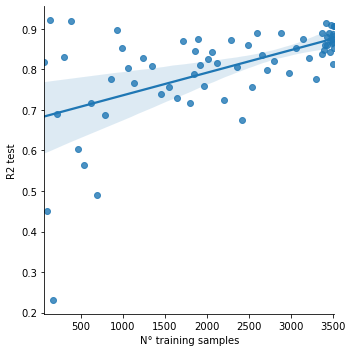

In [467]:
sns.lmplot('N° training samples', 'R2 test', data = r4[0])

In [ ]:
# Te get more interpretable results, and because the performance of 4th model is good enough (75% of the models
# get test r2 score of more than 77%) the fouth model will be used to get interpretation on the effects of 
# the different variables on leverage.

In [54]:
# aux_pct = results_financial_lev.loc[results_financial_lev['R2 test']>0.5,'R2 train'].count()/results_financial_lev.shape[0]
# print('{:.2f}% of the models achieve an R2 test score over 0.5.'.format(aux_pct*100))
# print('Because of this its better to use total leverage models to analyze the impact of different variables.')

In [55]:
#Need visualization of results.

In [56]:
def manual_tune(period, xgb_params):

    remove_cols =['Industry Title',
                  'Growth', 'Total Equity',
                            'Tangibility',
                            'Liquidity',
                            'Profitability',
                            'Firm size',
                            'Total leverage',
                            'Financial leverage',
                            'Total Assets',
                            'Total Liabilities',
                            'Total Current Liabilities',
                            'Total Debt',
                            'Property/Plant/Equipment, Total - Net',
                            'Net Income',
                            'Total Current Assets']




    training_periods = 7

    X_train = data['complete'][4].loc[(slice(None),slice(period, period+training_periods)),:].drop(remove_cols, axis = 1)
    y_train = data['complete'][4].loc[(slice(None),slice(period, period+training_periods)),'Total leverage']

    X_cv, X_test, y_cv, y_test = train_test_split(data['complete'][4].loc[(slice(None),period+training_periods+1),:].drop(remove_cols, axis = 1), 
                                                  data['complete'][4].loc[(slice(None),period+training_periods+1),'Total leverage'], test_size=0.5, random_state=42)

    xgb = XGBRegressor(**xgb_params)
    xgb.fit(X_train,y_train)

    preds_train = xgb.predict(X_train)
    preds_cv = xgb.predict(X_cv)
    preds_test = xgb.predict(X_test)

    r2_train = r2_score(y_train,preds_train)
    r2_cv = r2_score(y_cv,preds_cv)

    print('best grid search cv score: {:.2f}'.format(opt_2y['{} - {}'.format(period, period+training_periods)].best_score))
    print('train score: {:.2f}, cv score: {:.2f}'.format(r2_train, r2_cv))    

    X_train, Z_train, clusters_train, y_train = transform(X_train, y_train)
    X_test, Z_test, clusters_test, y_test = transform(X_test,y_test)
    

Commpute SHAP Values. - Do not delete cell below.

In [57]:
#Compunte and save SHAP Values 

def compute_shap_values(models_list, training_periods = 7, lagged_periods = 4, leverage = 'Total leverage', 
                                 use_non_financial_indicators = True, autoregressive = True):
    
    t0_cols =['Industry Title',
                  'Growth', 'Total Equity',
                            'Tangibility',
                            'Liquidity',
                            'Profitability',
                            'Firm size',
                            'Total leverage',
                            'Financial leverage',
                            'Total Assets',
                            'Total Liabilities',
                            'Total Current Liabilities',
                            'Total Debt',
                            'Property/Plant/Equipment, Total - Net',
                            'Net Income',
                            'Total Current Assets',] #These corresponds to all info in t0.
    

    
    
    if leverage == 'Total leverage':
        other_lev_col = ['Financial leverage']
    else: other_lev_col = ['Total leverage']
        
    if autoregressive == False:
        current_lev_col = [leverage]
    else: current_lev_col = []
        
        
    if use_non_financial_indicators == False:
        nfi_cols = pre_processed_info
    else: nfi_cols = []
    
    lagged_cols = [] 

    for col in  nfi_cols+other_lev_col+current_lev_col:
        for lag in range(1,lagged_periods+1):
            lagged_cols.append('{} - lag{}'.format(col,lag))
            
    remove_cols = t0_cols+lagged_cols
    
    end_period = pd.Period('2018Q4', freq = 'Q')-training_periods-1
    shap_values_train = []
    for period, i in zip(pd.period_range('2000Q1', end = end_period, freq = 'Q'), range(68)):
        X = data['complete'][lagged_periods].loc[(slice(None),slice(period, period+training_periods)),:].drop(remove_cols, axis = 1)
        print('Computing SHAP Values for model adjusted in period {} - {}'.
             format(period,period+training_periods))
        explainer = shap.TreeExplainer(models_list[i].fe_model, X)
        shap_values_train.append(explainer(X))
        
    if use_non_financial_indicators==True: a = 'use'
    else: a = 'dis'
        
    if autoregressive ==True: b = '_AR'
    else: b = ''

    pickle.dump(shap_values_train, open('shap_values_train-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                                       training_periods,
                                                                                       lagged_periods,a,b), 'wb'))

    shap_values_test = []
    for period, i in zip(pd.period_range('2000Q1', end = end_period, freq = 'Q'), range(68)):
        X = data['complete'][lagged_periods].loc[(slice(None), period+training_periods+1),:].drop(remove_cols, axis = 1)
        print('Computing SHAP Values for model adjusted in period {} - {}'.
             format(period,period+training_periods))
        explainer = shap.TreeExplainer(models_list[i].fe_model, X)
        shap_values_test.append(explainer(X))
        


    pickle.dump(shap_values_test, open('shap_values_test-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                                     training_periods,
                                                                                    lagged_periods,a,b), 'wb'))

In [58]:
compute_shap_values(r1[1],**args_1)
compute_shap_values(r2[1],**args_2)
compute_shap_values(r3[1],**args_3)
compute_shap_values(r4[1],**args_4)

Computing SHAP Values for model adjusted in period 2000Q1 - 2001Q4
Computing SHAP Values for model adjusted in period 2000Q2 - 2002Q1
Computing SHAP Values for model adjusted in period 2000Q3 - 2002Q2
Computing SHAP Values for model adjusted in period 2000Q4 - 2002Q3
Computing SHAP Values for model adjusted in period 2001Q1 - 2002Q4
Computing SHAP Values for model adjusted in period 2001Q2 - 2003Q1
Computing SHAP Values for model adjusted in period 2001Q3 - 2003Q2
Computing SHAP Values for model adjusted in period 2001Q4 - 2003Q3
Computing SHAP Values for model adjusted in period 2002Q1 - 2003Q4
Computing SHAP Values for model adjusted in period 2002Q2 - 2004Q1
Computing SHAP Values for model adjusted in period 2002Q3 - 2004Q2
Computing SHAP Values for model adjusted in period 2002Q4 - 2004Q3


 99%|===================| 777/785 [00:17<00:00]        

Computing SHAP Values for model adjusted in period 2003Q1 - 2004Q4
Computing SHAP Values for model adjusted in period 2003Q2 - 2005Q1


100%|===================| 925/929 [00:14<00:00]        

Computing SHAP Values for model adjusted in period 2003Q3 - 2005Q2
Computing SHAP Values for model adjusted in period 2003Q4 - 2005Q3
Computing SHAP Values for model adjusted in period 2004Q1 - 2005Q4
Computing SHAP Values for model adjusted in period 2004Q2 - 2006Q1
Computing SHAP Values for model adjusted in period 2004Q3 - 2006Q2
Computing SHAP Values for model adjusted in period 2004Q4 - 2006Q3
Computing SHAP Values for model adjusted in period 2005Q1 - 2006Q4
Computing SHAP Values for model adjusted in period 2005Q2 - 2007Q1
Computing SHAP Values for model adjusted in period 2005Q3 - 2007Q2
Computing SHAP Values for model adjusted in period 2005Q4 - 2007Q3
Computing SHAP Values for model adjusted in period 2006Q1 - 2007Q4
Computing SHAP Values for model adjusted in period 2006Q2 - 2008Q1
Computing SHAP Values for model adjusted in period 2006Q3 - 2008Q2


 99%|===================| 1872/1891 [00:35<00:00]        

Computing SHAP Values for model adjusted in period 2006Q4 - 2008Q3
Computing SHAP Values for model adjusted in period 2007Q1 - 2008Q4
Computing SHAP Values for model adjusted in period 2007Q2 - 2009Q1
Computing SHAP Values for model adjusted in period 2007Q3 - 2009Q2
Computing SHAP Values for model adjusted in period 2007Q4 - 2009Q3


 99%|===================| 2100/2116 [00:33<00:00]        

Computing SHAP Values for model adjusted in period 2008Q1 - 2009Q4
Computing SHAP Values for model adjusted in period 2008Q2 - 2010Q1


100%|===================| 2282/2291 [00:28<00:00]        

Computing SHAP Values for model adjusted in period 2008Q3 - 2010Q2
Computing SHAP Values for model adjusted in period 2008Q4 - 2010Q3
Computing SHAP Values for model adjusted in period 2009Q1 - 2010Q4
Computing SHAP Values for model adjusted in period 2009Q2 - 2011Q1
Computing SHAP Values for model adjusted in period 2009Q3 - 2011Q2


 98%|===================| 2549/2598 [00:34<00:00]        

Computing SHAP Values for model adjusted in period 2009Q4 - 2011Q3
Computing SHAP Values for model adjusted in period 2010Q1 - 2011Q4


 99%|===================| 2698/2715 [00:36<00:00]        

Computing SHAP Values for model adjusted in period 2010Q2 - 2012Q1


 99%|===================| 2772/2795 [00:31<00:00]        

Computing SHAP Values for model adjusted in period 2010Q3 - 2012Q2
Computing SHAP Values for model adjusted in period 2010Q4 - 2012Q3


 99%|===================| 2939/2974 [00:47<00:00]        

Computing SHAP Values for model adjusted in period 2011Q1 - 2012Q4
Computing SHAP Values for model adjusted in period 2011Q2 - 2013Q1
Computing SHAP Values for model adjusted in period 2011Q3 - 2013Q2
Computing SHAP Values for model adjusted in period 2011Q4 - 2013Q3
Computing SHAP Values for model adjusted in period 2012Q1 - 2013Q4


 98%|===================| 3313/3370 [00:34<00:00]        

Computing SHAP Values for model adjusted in period 2012Q2 - 2014Q1
Computing SHAP Values for model adjusted in period 2012Q3 - 2014Q2


 99%|===================| 3385/3433 [00:26<00:00]        

Computing SHAP Values for model adjusted in period 2012Q4 - 2014Q3
Computing SHAP Values for model adjusted in period 2013Q1 - 2014Q4
Computing SHAP Values for model adjusted in period 2013Q2 - 2015Q1
Computing SHAP Values for model adjusted in period 2013Q3 - 2015Q2
Computing SHAP Values for model adjusted in period 2013Q4 - 2015Q3
Computing SHAP Values for model adjusted in period 2014Q1 - 2015Q4
Computing SHAP Values for model adjusted in period 2014Q2 - 2016Q1
Computing SHAP Values for model adjusted in period 2014Q3 - 2016Q2
Computing SHAP Values for model adjusted in period 2014Q4 - 2016Q3


 98%|===================| 3446/3503 [00:22<00:00]        

Computing SHAP Values for model adjusted in period 2015Q1 - 2016Q4
Computing SHAP Values for model adjusted in period 2015Q2 - 2017Q1


 99%|===================| 3445/3481 [00:45<00:00]        

Computing SHAP Values for model adjusted in period 2015Q3 - 2017Q2


 98%|===================| 3411/3467 [00:45<00:00]        

Computing SHAP Values for model adjusted in period 2015Q4 - 2017Q3
Computing SHAP Values for model adjusted in period 2016Q1 - 2017Q4
Computing SHAP Values for model adjusted in period 2016Q2 - 2018Q1
Computing SHAP Values for model adjusted in period 2016Q3 - 2018Q2


 98%|===================| 3328/3390 [00:42<00:00]        

Computing SHAP Values for model adjusted in period 2016Q4 - 2018Q3
Computing SHAP Values for model adjusted in period 2000Q1 - 2001Q4
Computing SHAP Values for model adjusted in period 2000Q2 - 2002Q1
Computing SHAP Values for model adjusted in period 2000Q3 - 2002Q2
Computing SHAP Values for model adjusted in period 2000Q4 - 2002Q3
Computing SHAP Values for model adjusted in period 2001Q1 - 2002Q4
Computing SHAP Values for model adjusted in period 2001Q2 - 2003Q1
Computing SHAP Values for model adjusted in period 2001Q3 - 2003Q2
Computing SHAP Values for model adjusted in period 2001Q4 - 2003Q3
Computing SHAP Values for model adjusted in period 2002Q1 - 2003Q4
Computing SHAP Values for model adjusted in period 2002Q2 - 2004Q1
Computing SHAP Values for model adjusted in period 2002Q3 - 2004Q2
Computing SHAP Values for model adjusted in period 2002Q4 - 2004Q3
Computing SHAP Values for model adjusted in period 2003Q1 - 2004Q4
Computing SHAP Values for model adjusted in period 2003Q2 - 20

 99%|===================| 917/929 [00:15<00:00]        

Computing SHAP Values for model adjusted in period 2003Q3 - 2005Q2
Computing SHAP Values for model adjusted in period 2003Q4 - 2005Q3


 99%|===================| 1050/1062 [00:24<00:00]        

Computing SHAP Values for model adjusted in period 2004Q1 - 2005Q4
Computing SHAP Values for model adjusted in period 2004Q2 - 2006Q1
Computing SHAP Values for model adjusted in period 2004Q3 - 2006Q2


 98%|===================| 1323/1344 [00:13<00:00]        

Computing SHAP Values for model adjusted in period 2004Q4 - 2006Q3
Computing SHAP Values for model adjusted in period 2005Q1 - 2006Q4
Computing SHAP Values for model adjusted in period 2005Q2 - 2007Q1
Computing SHAP Values for model adjusted in period 2005Q3 - 2007Q2


 95%|=================== | 1640/1720 [00:16<00:00]       

Computing SHAP Values for model adjusted in period 2005Q4 - 2007Q3


 99%|===================| 1786/1798 [00:17<00:00]        

Computing SHAP Values for model adjusted in period 2006Q1 - 2007Q4
Computing SHAP Values for model adjusted in period 2006Q2 - 2008Q1
Computing SHAP Values for model adjusted in period 2006Q3 - 2008Q2
Computing SHAP Values for model adjusted in period 2006Q4 - 2008Q3
Computing SHAP Values for model adjusted in period 2007Q1 - 2008Q4


100%|===================| 1956/1965 [00:11<00:00]       

Computing SHAP Values for model adjusted in period 2007Q2 - 2009Q1
Computing SHAP Values for model adjusted in period 2007Q3 - 2009Q2
Computing SHAP Values for model adjusted in period 2007Q4 - 2009Q3


 98%|===================| 2078/2116 [00:46<00:00]        

Computing SHAP Values for model adjusted in period 2008Q1 - 2009Q4


 97%|=================== | 2143/2205 [00:11<00:00]       

Computing SHAP Values for model adjusted in period 2008Q2 - 2010Q1
Computing SHAP Values for model adjusted in period 2008Q3 - 2010Q2
Computing SHAP Values for model adjusted in period 2008Q4 - 2010Q3
Computing SHAP Values for model adjusted in period 2009Q1 - 2010Q4
Computing SHAP Values for model adjusted in period 2009Q2 - 2011Q1
Computing SHAP Values for model adjusted in period 2009Q3 - 2011Q2


 98%|===================| 2541/2598 [00:23<00:00]        

Computing SHAP Values for model adjusted in period 2009Q4 - 2011Q3
Computing SHAP Values for model adjusted in period 2010Q1 - 2011Q4


 99%|===================| 2697/2715 [00:23<00:00]        

Computing SHAP Values for model adjusted in period 2010Q2 - 2012Q1


 99%|===================| 2767/2795 [00:30<00:00]        

Computing SHAP Values for model adjusted in period 2010Q3 - 2012Q2
Computing SHAP Values for model adjusted in period 2010Q4 - 2012Q3
Computing SHAP Values for model adjusted in period 2011Q1 - 2012Q4
Computing SHAP Values for model adjusted in period 2011Q2 - 2013Q1


 99%|===================| 3108/3138 [01:00<00:00]        

Computing SHAP Values for model adjusted in period 2011Q3 - 2013Q2


 99%|===================| 3184/3215 [00:34<00:00]        

Computing SHAP Values for model adjusted in period 2011Q4 - 2013Q3
Computing SHAP Values for model adjusted in period 2012Q1 - 2013Q4


 95%|=================== | 3192/3370 [00:14<00:00]       

Computing SHAP Values for model adjusted in period 2012Q2 - 2014Q1


 96%|=================== | 3266/3400 [00:17<00:00]       

Computing SHAP Values for model adjusted in period 2012Q3 - 2014Q2


 99%|===================| 3393/3433 [00:32<00:00]        

Computing SHAP Values for model adjusted in period 2012Q4 - 2014Q3


 94%|=================== | 3263/3460 [00:15<00:00]       

Computing SHAP Values for model adjusted in period 2013Q1 - 2014Q4


 99%|===================| 3443/3488 [01:07<00:00]        

Computing SHAP Values for model adjusted in period 2013Q2 - 2015Q1
Computing SHAP Values for model adjusted in period 2013Q3 - 2015Q2


 99%|===================| 3476/3507 [01:12<00:00]        

Computing SHAP Values for model adjusted in period 2013Q4 - 2015Q3


 95%|=================== | 3337/3506 [00:17<00:00]       

Computing SHAP Values for model adjusted in period 2014Q1 - 2015Q4
Computing SHAP Values for model adjusted in period 2014Q2 - 2016Q1
Computing SHAP Values for model adjusted in period 2014Q3 - 2016Q2
Computing SHAP Values for model adjusted in period 2014Q4 - 2016Q3


 98%|===================| 3449/3503 [00:15<00:00]        

Computing SHAP Values for model adjusted in period 2015Q1 - 2016Q4


 99%|===================| 3457/3493 [00:58<00:00]        

Computing SHAP Values for model adjusted in period 2015Q2 - 2017Q1
Computing SHAP Values for model adjusted in period 2015Q3 - 2017Q2
Computing SHAP Values for model adjusted in period 2015Q4 - 2017Q3


 97%|=================== | 3353/3455 [00:11<00:00]       

Computing SHAP Values for model adjusted in period 2016Q1 - 2017Q4


 98%|===================| 3363/3434 [00:30<00:00]        

Computing SHAP Values for model adjusted in period 2016Q2 - 2018Q1


 96%|=================== | 3281/3413 [00:17<00:00]       

Computing SHAP Values for model adjusted in period 2016Q3 - 2018Q2
Computing SHAP Values for model adjusted in period 2016Q4 - 2018Q3
Computing SHAP Values for model adjusted in period 2000Q1 - 2001Q4
Computing SHAP Values for model adjusted in period 2000Q2 - 2002Q1
Computing SHAP Values for model adjusted in period 2000Q3 - 2002Q2
Computing SHAP Values for model adjusted in period 2000Q4 - 2002Q3
Computing SHAP Values for model adjusted in period 2001Q1 - 2002Q4
Computing SHAP Values for model adjusted in period 2001Q2 - 2003Q1
Computing SHAP Values for model adjusted in period 2001Q3 - 2003Q2
Computing SHAP Values for model adjusted in period 2001Q4 - 2003Q3
Computing SHAP Values for model adjusted in period 2002Q1 - 2003Q4
Computing SHAP Values for model adjusted in period 2002Q2 - 2004Q1
Computing SHAP Values for model adjusted in period 2002Q3 - 2004Q2
Computing SHAP Values for model adjusted in period 2002Q4 - 2004Q3
Computing SHAP Values for model adjusted in period 2003Q1 - 20

 97%|=================== | 966/994 [00:14<00:00]       

Computing SHAP Values for model adjusted in period 2003Q4 - 2005Q3
Computing SHAP Values for model adjusted in period 2004Q1 - 2005Q4
Computing SHAP Values for model adjusted in period 2004Q2 - 2006Q1
Computing SHAP Values for model adjusted in period 2004Q3 - 2006Q2
Computing SHAP Values for model adjusted in period 2004Q4 - 2006Q3
Computing SHAP Values for model adjusted in period 2005Q1 - 2006Q4
Computing SHAP Values for model adjusted in period 2005Q2 - 2007Q1
Computing SHAP Values for model adjusted in period 2005Q3 - 2007Q2
Computing SHAP Values for model adjusted in period 2005Q4 - 2007Q3
Computing SHAP Values for model adjusted in period 2006Q1 - 2007Q4


 95%|=================== | 1755/1844 [00:11<00:00]       

Computing SHAP Values for model adjusted in period 2006Q2 - 2008Q1
Computing SHAP Values for model adjusted in period 2006Q3 - 2008Q2
Computing SHAP Values for model adjusted in period 2006Q4 - 2008Q3


 99%|===================| 1906/1923 [00:26<00:00]        

Computing SHAP Values for model adjusted in period 2007Q1 - 2008Q4
Computing SHAP Values for model adjusted in period 2007Q2 - 2009Q1
Computing SHAP Values for model adjusted in period 2007Q3 - 2009Q2
Computing SHAP Values for model adjusted in period 2007Q4 - 2009Q3
Computing SHAP Values for model adjusted in period 2008Q1 - 2009Q4
Computing SHAP Values for model adjusted in period 2008Q2 - 2010Q1
Computing SHAP Values for model adjusted in period 2008Q3 - 2010Q2
Computing SHAP Values for model adjusted in period 2008Q4 - 2010Q3


100%|===================| 2411/2419 [00:22<00:00]        

Computing SHAP Values for model adjusted in period 2009Q1 - 2010Q4


 98%|===================| 2426/2484 [00:39<00:00]        

Computing SHAP Values for model adjusted in period 2009Q2 - 2011Q1


 94%|=================== | 2389/2536 [00:16<00:00]       

Computing SHAP Values for model adjusted in period 2009Q3 - 2011Q2


 99%|===================| 2565/2598 [00:39<00:00]        

Computing SHAP Values for model adjusted in period 2009Q4 - 2011Q3
Computing SHAP Values for model adjusted in period 2010Q1 - 2011Q4
Computing SHAP Values for model adjusted in period 2010Q2 - 2012Q1
Computing SHAP Values for model adjusted in period 2010Q3 - 2012Q2
Computing SHAP Values for model adjusted in period 2010Q4 - 2012Q3


100%|===================| 2964/2974 [00:41<00:00]        

Computing SHAP Values for model adjusted in period 2011Q1 - 2012Q4
Computing SHAP Values for model adjusted in period 2011Q2 - 2013Q1


100%|===================| 3131/3138 [00:57<00:00]        

Computing SHAP Values for model adjusted in period 2011Q3 - 2013Q2


 99%|===================| 3184/3215 [01:10<00:00]        

Computing SHAP Values for model adjusted in period 2011Q4 - 2013Q3
Computing SHAP Values for model adjusted in period 2012Q1 - 2013Q4


100%|===================| 3359/3370 [01:10<00:00]        

Computing SHAP Values for model adjusted in period 2012Q2 - 2014Q1


 98%|===================| 3321/3400 [00:40<00:00]        

Computing SHAP Values for model adjusted in period 2012Q3 - 2014Q2
Computing SHAP Values for model adjusted in period 2012Q4 - 2014Q3
Computing SHAP Values for model adjusted in period 2013Q1 - 2014Q4
Computing SHAP Values for model adjusted in period 2013Q2 - 2015Q1
Computing SHAP Values for model adjusted in period 2013Q3 - 2015Q2
Computing SHAP Values for model adjusted in period 2013Q4 - 2015Q3
Computing SHAP Values for model adjusted in period 2014Q1 - 2015Q4
Computing SHAP Values for model adjusted in period 2014Q2 - 2016Q1
Computing SHAP Values for model adjusted in period 2014Q3 - 2016Q2
Computing SHAP Values for model adjusted in period 2014Q4 - 2016Q3
Computing SHAP Values for model adjusted in period 2015Q1 - 2016Q4
Computing SHAP Values for model adjusted in period 2015Q2 - 2017Q1
Computing SHAP Values for model adjusted in period 2015Q3 - 2017Q2
Computing SHAP Values for model adjusted in period 2015Q4 - 2017Q3


 97%|=================== | 3368/3455 [00:33<00:00]       

Computing SHAP Values for model adjusted in period 2016Q1 - 2017Q4
Computing SHAP Values for model adjusted in period 2016Q2 - 2018Q1


 99%|===================| 3372/3413 [00:12<00:00]        

Computing SHAP Values for model adjusted in period 2016Q3 - 2018Q2


 99%|===================| 3355/3390 [00:52<00:00]        

Computing SHAP Values for model adjusted in period 2016Q4 - 2018Q3


100%|===================| 3364/3369 [00:31<00:00]        

Computing SHAP Values for model adjusted in period 2000Q1 - 2001Q4
Computing SHAP Values for model adjusted in period 2000Q2 - 2002Q1
Computing SHAP Values for model adjusted in period 2000Q3 - 2002Q2
Computing SHAP Values for model adjusted in period 2000Q4 - 2002Q3
Computing SHAP Values for model adjusted in period 2001Q1 - 2002Q4
Computing SHAP Values for model adjusted in period 2001Q2 - 2003Q1
Computing SHAP Values for model adjusted in period 2001Q3 - 2003Q2
Computing SHAP Values for model adjusted in period 2001Q4 - 2003Q3
Computing SHAP Values for model adjusted in period 2002Q1 - 2003Q4
Computing SHAP Values for model adjusted in period 2002Q2 - 2004Q1
Computing SHAP Values for model adjusted in period 2002Q3 - 2004Q2
Computing SHAP Values for model adjusted in period 2002Q4 - 2004Q3
Computing SHAP Values for model adjusted in period 2003Q1 - 2004Q4
Computing SHAP Values for model adjusted in period 2003Q2 - 2005Q1
Computing SHAP Values for model adjusted in period 2003Q3 - 20

 94%|=================== | 740/785 [00:14<00:00]       

Computing SHAP Values for model adjusted in period 2003Q1 - 2004Q4
Computing SHAP Values for model adjusted in period 2003Q2 - 2005Q1
Computing SHAP Values for model adjusted in period 2003Q3 - 2005Q2
Computing SHAP Values for model adjusted in period 2003Q4 - 2005Q3


 99%|===================| 1050/1062 [00:13<00:00]       

Computing SHAP Values for model adjusted in period 2004Q1 - 2005Q4
Computing SHAP Values for model adjusted in period 2004Q2 - 2006Q1


 97%|=================== | 1195/1238 [00:12<00:00]       

Computing SHAP Values for model adjusted in period 2004Q3 - 2006Q2


 94%|=================== | 1269/1344 [00:13<00:00]       

Computing SHAP Values for model adjusted in period 2004Q4 - 2006Q3


100%|===================| 1445/1450 [00:14<00:00]        

Computing SHAP Values for model adjusted in period 2005Q1 - 2006Q4


 99%|===================| 1544/1555 [00:35<00:00]        

Computing SHAP Values for model adjusted in period 2005Q2 - 2007Q1


 98%|===================| 1614/1642 [00:36<00:00]        

Computing SHAP Values for model adjusted in period 2005Q3 - 2007Q2
Computing SHAP Values for model adjusted in period 2005Q4 - 2007Q3


 99%|===================| 1780/1798 [00:39<00:00]        

Computing SHAP Values for model adjusted in period 2006Q1 - 2007Q4
Computing SHAP Values for model adjusted in period 2006Q2 - 2008Q1
Computing SHAP Values for model adjusted in period 2006Q3 - 2008Q2


 95%|=================== | 1793/1891 [00:19<00:01]       

Computing SHAP Values for model adjusted in period 2006Q4 - 2008Q3


100%|===================| 1922/1923 [00:48<00:00]        

Computing SHAP Values for model adjusted in period 2007Q1 - 2008Q4


100%|===================| 1963/1965 [00:34<00:00]        

Computing SHAP Values for model adjusted in period 2007Q2 - 2009Q1


 99%|===================| 2004/2015 [00:49<00:00]        

Computing SHAP Values for model adjusted in period 2007Q3 - 2009Q2


 99%|===================| 2055/2066 [00:43<00:00]        

Computing SHAP Values for model adjusted in period 2007Q4 - 2009Q3


 98%|===================| 2072/2116 [00:30<00:00]        

Computing SHAP Values for model adjusted in period 2008Q1 - 2009Q4


 99%|===================| 2190/2205 [00:31<00:00]        

Computing SHAP Values for model adjusted in period 2008Q2 - 2010Q1


 99%|===================| 2271/2291 [00:22<00:00]        

Computing SHAP Values for model adjusted in period 2008Q3 - 2010Q2


 98%|===================| 2300/2355 [00:43<00:01]        

Computing SHAP Values for model adjusted in period 2008Q4 - 2010Q3


 99%|===================| 2391/2419 [00:56<00:00]        

Computing SHAP Values for model adjusted in period 2009Q1 - 2010Q4


 97%|=================== | 2420/2484 [00:12<00:00]       

Computing SHAP Values for model adjusted in period 2009Q2 - 2011Q1


 97%|=================== | 2468/2536 [00:35<00:00]       

Computing SHAP Values for model adjusted in period 2009Q3 - 2011Q2


 97%|=================== | 2508/2598 [00:24<00:00]       

Computing SHAP Values for model adjusted in period 2009Q4 - 2011Q3


 99%|===================| 2635/2661 [00:25<00:00]        

Computing SHAP Values for model adjusted in period 2010Q1 - 2011Q4


 99%|===================| 2688/2715 [00:38<00:00]        

Computing SHAP Values for model adjusted in period 2010Q2 - 2012Q1


 98%|===================| 2741/2795 [00:13<00:00]        

Computing SHAP Values for model adjusted in period 2010Q3 - 2012Q2


 95%|=================== | 2735/2886 [00:13<00:00]       

Computing SHAP Values for model adjusted in period 2010Q4 - 2012Q3


 98%|===================| 2906/2974 [00:34<00:00]        

Computing SHAP Values for model adjusted in period 2011Q1 - 2012Q4
Computing SHAP Values for model adjusted in period 2011Q2 - 2013Q1


 97%|=================== | 3058/3138 [00:29<00:00]       

Computing SHAP Values for model adjusted in period 2011Q3 - 2013Q2


 98%|===================| 3148/3215 [00:45<00:00]        

Computing SHAP Values for model adjusted in period 2011Q4 - 2013Q3


 99%|===================| 3259/3293 [01:19<00:00]        

Computing SHAP Values for model adjusted in period 2012Q1 - 2013Q4


 99%|===================| 3346/3370 [01:20<00:00]        

Computing SHAP Values for model adjusted in period 2012Q2 - 2014Q1


 98%|===================| 3348/3400 [00:48<00:00]        

Computing SHAP Values for model adjusted in period 2012Q3 - 2014Q2


 99%|===================| 3403/3433 [01:13<00:00]        

Computing SHAP Values for model adjusted in period 2012Q4 - 2014Q3


 99%|===================| 3421/3460 [00:57<00:00]        

Computing SHAP Values for model adjusted in period 2013Q1 - 2014Q4


 98%|===================| 3410/3488 [00:40<00:00]        

Computing SHAP Values for model adjusted in period 2013Q2 - 2015Q1


 99%|===================| 3475/3502 [01:22<00:00]        

Computing SHAP Values for model adjusted in period 2013Q3 - 2015Q2


 95%|=================== | 3336/3507 [00:16<00:00]       

Computing SHAP Values for model adjusted in period 2013Q4 - 2015Q3


 99%|===================| 3469/3506 [00:16<00:00]        

Computing SHAP Values for model adjusted in period 2014Q1 - 2015Q4


 98%|===================| 3427/3509 [00:32<00:00]        

Computing SHAP Values for model adjusted in period 2014Q2 - 2016Q1


 95%|=================== | 3341/3515 [00:16<00:00]       

Computing SHAP Values for model adjusted in period 2014Q3 - 2016Q2


100%|===================| 3500/3511 [00:31<00:00]        

Computing SHAP Values for model adjusted in period 2014Q4 - 2016Q3


 99%|===================| 3474/3503 [00:56<00:00]        

Computing SHAP Values for model adjusted in period 2015Q1 - 2016Q4


 99%|===================| 3461/3493 [01:03<00:00]        

Computing SHAP Values for model adjusted in period 2015Q2 - 2017Q1


100%|===================| 3480/3481 [01:11<00:00]        

Computing SHAP Values for model adjusted in period 2015Q3 - 2017Q2


 99%|===================| 3432/3467 [01:19<00:00]        

Computing SHAP Values for model adjusted in period 2015Q4 - 2017Q3


 98%|===================| 3393/3455 [00:31<00:00]        

Computing SHAP Values for model adjusted in period 2016Q1 - 2017Q4


 98%|===================| 3360/3434 [00:31<00:00]        

Computing SHAP Values for model adjusted in period 2016Q2 - 2018Q1


 99%|===================| 3381/3413 [01:02<00:00]        

Computing SHAP Values for model adjusted in period 2016Q3 - 2018Q2


 99%|===================| 3359/3390 [01:01<00:00]        

Computing SHAP Values for model adjusted in period 2016Q4 - 2018Q3


 98%|===================| 3314/3369 [00:15<00:00]        

Computing SHAP Values for model adjusted in period 2000Q1 - 2001Q4
Computing SHAP Values for model adjusted in period 2000Q2 - 2002Q1
Computing SHAP Values for model adjusted in period 2000Q3 - 2002Q2
Computing SHAP Values for model adjusted in period 2000Q4 - 2002Q3
Computing SHAP Values for model adjusted in period 2001Q1 - 2002Q4
Computing SHAP Values for model adjusted in period 2001Q2 - 2003Q1
Computing SHAP Values for model adjusted in period 2001Q3 - 2003Q2
Computing SHAP Values for model adjusted in period 2001Q4 - 2003Q3
Computing SHAP Values for model adjusted in period 2002Q1 - 2003Q4
Computing SHAP Values for model adjusted in period 2002Q2 - 2004Q1
Computing SHAP Values for model adjusted in period 2002Q3 - 2004Q2
Computing SHAP Values for model adjusted in period 2002Q4 - 2004Q3
Computing SHAP Values for model adjusted in period 2003Q1 - 2004Q4
Computing SHAP Values for model adjusted in period 2003Q2 - 2005Q1
Computing SHAP Values for model adjusted in period 2003Q3 - 20

In [9]:
def load_shap_values_test(training_periods = 7, lagged_periods = 4, leverage = 'Total leverage',
                 use_non_financial_indicators = True, autoregressive = True):

    if use_non_financial_indicators==True: a = 'use'
    else: a = 'dis'
        
    if autoregressive ==True: b = '_AR'
    else: b = ''

    return pickle.load(open('shap_values_test-{}_{}tp_lag{}_{}NFI{}.pkl'.format(leverage,
                                                                                     training_periods,
                                                                                    lagged_periods,a,b), 'rb'))


In [10]:
#Load SHAP values test
s1 = load_shap_values_test(**args_1)
s2 = load_shap_values_test(**args_2)
s3 = load_shap_values_test(**args_3)
s4 = load_shap_values_test(**args_3)

In [11]:
#must create a single array for:
# x: value of the variable
# y: period
# z: shap value
# color: confidence of the shap value. I.e. r2 test
def plot_shap_time(var, shap_values,plot_scatter = True, plot_surface = True, plot_crisis = False,
                   filter_values = 0, max_scatter_points = None, outlier_filter = 0.1, 
                   angles = None, cmap_scatter = 'viridis', bins_surf = 50, keep_pct_surf = 0.9,animate = False, 
                   ax = None,frame = None, alpha_scatter = 0.2, alpha_surface = 0.5, alpha_crisis = 0.2,
                  training_periods = 7, lagged_periods = 4, leverage = 'Total leverage', 
                                 use_non_financial_indicators = True, autoregressive = True):
    '''
    var: variable for which to plot its SHAP values.
    max_scatter_points: to plot in scatter plot. If None, all points will be plotted.
    
    
    angles: corresponds to the view_init() method to handle the degrees at which 
    the plot is rendered.
    oulier filter: is the percentage of the distribution that will be left out while setting the limits for the x and z axis. I.e. the ranges for the specified 
    variable and the SHAP value for that variable. Useful for plotting the scatter points.
    angles: tuple('elev', 'azim').'elev' stores the elevation angle in the z plane (in degrees).
    'azim' stores the azimuth angle in the (x, y) plane (in degrees).
    filter_values: min r2 test score to plot corresponding points.
    Bins: corresponds to the number of bins to partition the variable 'Var' per year to plot the adjusted surface.
    keep_pct_surf: percentage of obsertvations to keep between surfaces per year.
    '''

 



    t0_cols =['Industry Title',
                  'Growth', 'Total Equity',
                            'Tangibility',
                            'Liquidity',
                            'Profitability',
                            'Firm size',
                            'Total leverage',
                            'Financial leverage',
                            'Total Assets',
                            'Total Liabilities',
                            'Total Current Liabilities',
                            'Total Debt',
                            'Property/Plant/Equipment, Total - Net',
                            'Net Income',
                            'Total Current Assets',] #These corresponds to all info in t0.
    

    
    
    if leverage == 'Total leverage':
        other_lev_col = ['Financial leverage']
    else: other_lev_col = ['Total leverage']
        
    if autoregressive == False:
        current_lev_col = [leverage]
    else: current_lev_col = []
        
        
    if use_non_financial_indicators == False:
        nfi_cols = pre_processed_info
    else: nfi_cols = []
    
    lagged_cols = [] 

    for col in  nfi_cols+other_lev_col+current_lev_col:#+ data_leak: 
        for lag in range(1,lagged_periods+1):
            lagged_cols.append('{} - lag{}'.format(col,lag))
            
    remove_cols = t0_cols+lagged_cols


    x_arr = np.array([])
    x_arr_q1 = np.array([])
    x_arr_q2 = np.array([])
    x_arr_q3 = np.array([])
    
    y_arr = np.array([])

    
#     y_arr_d = []
    z_arr = np.array([])
    z_arr_q1 = np.array([])
    z_arr_q2 = np.array([])
    z_arr_q3 = np.array([])
    
    c_arr = np.array([])
        
    var_index = list(data['complete'][4].drop(remove_cols, axis = 1).columns).index(var)
    for i in range(68):#len(merf_models)
        curr_size = shap_values[i].data.shape[0]
        x_arr = np.append(x_arr, shap_values[i].data[:,var_index])
        x_arr_q1 = np.append(x_arr_q1,np.quantile(shap_values[i].data[:,var_index], 0.25))
        x_arr_q2 = np.append(x_arr_q2,np.quantile(shap_values[i].data[:,var_index], 0.50))
        x_arr_q3 = np.append(x_arr_q3,np.quantile(shap_values[i].data[:,var_index], 0.75))
        y_arr = np.append(y_arr, np.full(curr_size,i))
#         for j in range(curr_size):
#             y_arr_d.append(periods[i])
                         
        z_arr = np.append(z_arr, shap_values[i].values[:,var_index])
        z_arr_q1 = np.append(z_arr_q1,np.quantile(shap_values[i].values[:,var_index], 0.25))
        z_arr_q2 = np.append(z_arr_q2,np.quantile(shap_values[i].values[:,var_index], 0.50))
        z_arr_q3 = np.append(z_arr_q3,np.quantile(shap_values[i].values[:,var_index], 0.75))
        
        c_arr = np.append(c_arr, np.full(curr_size, r4[0].loc[i,'R2 test']))
        
        
        
    #conserve 90% of x range to create rhe bins. 3280 dont have an assigned bin. This is done because if all
    #values are kept, we end with many bins with too few observations.
    a = 0.5+keep_pct_surf/2
    b = 0.5-keep_pct_surf/2
    def quantile_a(x):
        return np.quantile(x,a)
    def quantile_b(x):
        return np.quantile(x,b)


    shap_df = pd.DataFrame({'x':x_arr[c_arr>filter_values],'y':y_arr[c_arr>filter_values],'z':z_arr[c_arr>filter_values]})
    dec_1 = np.quantile(shap_df.x, 0.05)#It uses 90% of the central distribution of x_arr to compute the bins.
    dec_9 = np.quantile(shap_df.x, 0.95)
    bins = pd.cut(shap_df[(shap_df.x>dec_1)&(shap_df.x<dec_9)].x,bins = bins_surf)
    bins.name = 'bins'
    aux = pd.merge(shap_df,bins, left_index=True, right_index=True, how = 'left')
    aux = aux.groupby(['y','bins']).agg([quantile_a,quantile_b]).reset_index()
    aux.drop('x', level = 0, axis = 1, inplace = True)
    aux.columns = ['y', 'bins', 'z_quantile_a','z_quantile_b']
    aux['x_mid_bin'] = aux['bins'].apply(lambda x: x.mid)
    aux.drop('bins', axis = 1, inplace = True)


    vmin = aux['z_quantile_b'].min()
    vmax = aux['z_quantile_a'].max()

   

    
    #To remove outliers for setting axis limits.
    alpha = outlier_filter
    x_adj_range = np.quantile(x_arr, [alpha/2,1-alpha/2])
    z_adj_range = np.quantile(z_arr, [alpha/2,1-alpha/2])
    
    
    rand_index = np.random.choice(np.arange(c_arr[c_arr>filter_values].shape[0]), size = max_scatter_points, replace = False)


    
    
    if animate == False:
        fig = plt.figure(figsize = (12,6))
        ax = plt.axes(projection='3d')

    if plot_scatter == True:
        if max_scatter_points == None:
             sc = ax.scatter(x_arr[c_arr>filter_values],y_arr[c_arr>filter_values],z_arr[c_arr>filter_values], c  = c_arr[c_arr>filter_values], 
                             cmap = cmap_scatter, vmin = 0, vmax = 1, alpha = alpha_scatter)

        else: sc = ax.scatter(x_arr[c_arr>filter_values][rand_index],y_arr[c_arr>filter_values][rand_index],
                              z_arr[c_arr>filter_values][rand_index], c = c_arr[c_arr>filter_values][rand_index], 
                         cmap = cmap_scatter, vmin = 0,vmax = 1, alpha = alpha_scatter)
            
        if ((animate == True) & (frame == 0)) | (animate == False):
            plt.colorbar(sc, label = 'Validity of displayed effect (R2 test)')
    
    if plot_surface == True:
        ax.plot_trisurf(aux['x_mid_bin'], aux['y'], aux['z_quantile_a'], alpha = alpha_surface, 
                        cmap = 'cool', vmin = vmin, vmax = vmax)
        ax.plot_trisurf(aux['x_mid_bin'], aux['y'], aux['z_quantile_b'], alpha = alpha_surface, 
                        cmap = 'cool', vmin = vmin, vmax = vmax)
        
    
    if plot_crisis == True:
        xx = np.linspace(aux['x_mid_bin'].min(),aux['x_mid_bin'].max(),5)
        zz = np.linspace(aux['z_quantile_b'].min(),aux['z_quantile_a'].max(),5)

        X, Z = np.meshgrid(xx,zz)
        Y1 = np.full((X.shape[0], X.shape[1]), 24)#24 and 30 are the corresponding y_arr values to the start & end
        Y2 = np.full((X.shape[0], X.shape[1]), 30)#of the financial crisis in thr US.
        ax.plot_surface(X, Y1,Z, color = 'r', alpha = alpha_crisis)
        ax.plot_surface(X, Y2,Z, color = 'r', alpha = alpha_crisis)



    if alpha!=0:
        ax.set_xlim(x_adj_range[0],x_adj_range[1])
        ax.set_zlim(z_adj_range[0],z_adj_range[1])
    plt.xlabel(var)

    ax.set_zlabel('SHAP Value for {}'.format(var))
    if angles == None:
        ax.view_init(35, 35)
    else: ax.view_init(angles[0],angles[1])
    plt.yticks(ticks = np.arange(-1,68,8), labels = np.arange(2001,2020,2))
    

    

In [12]:
# #conserve 90% of x range to create the bins. 3280 dont have an assigned bin. This is done because if all
# #values are kept, we end with many bins with too few observations.
# keep_pct = 0.9
# bins = 50
# a = 0.5+keep_pct/2
# b = 0.5-keep_pct/2
# def quantile_a(x):
#     return np.quantile(x,a)
# def quantile_b(x):
#     return np.quantile(x,b)


# shap_df = pd.DataFrame({'x':x,'y':y,'z':z})
# dec_1 = np.quantile(shap_df.x, 0.05)
# dec_9 = np.quantile(shap_df.x, 0.95)
# bins = pd.cut(shap_df[(shap_df.x>dec_1)&(shap_df.x<dec_9)].x,bins = bins)
# bins.name = 'bins'
# aux = pd.merge(shap_df,bins, left_index=True, right_index=True, how = 'left')
# aux = aux.groupby(['y','bins']).agg([quantile_a,quantile_b]).reset_index()
# aux.drop('x', level = 0, axis = 1, inplace = True)
# aux.columns = ['y', 'bins', 'z_quantile_a','z_quantile_b']
# aux['x_mid_bin'] = aux['bins'].apply(lambda x: x.mid)
# aux.drop('bins', axis = 1, inplace = True)

# fig, ax = plt.subplots(figsize = (12,6))
# ax = plt.axes(projection='3d')

# vmin = aux['z_quantile_b'].min()
# vmax = aux['z_quantile_a'].max()

# ax.plot_trisurf(aux['x_mid_bin'], aux['y'], aux['z_quantile_a'], alpha = 0.5, cmap = 'cool', vmin = vmin, vmax = vmax)
# ax.plot_trisurf(aux['x_mid_bin'], aux['y'], aux['z_quantile_b'], alpha = 0.5, cmap = 'cool', vmin = vmin, vmax = vmax)


# #los planos de crisis se mantienen fijos en valor de y. i.e f(X,Z) = Q_start

# xx = np.arange(aux['x_mid_bin'].min(),aux['x_mid_bin'].max())
# zz = np.arange(aux['z_quantile_b'].min(),aux['z_quantile_a'].max())

# X, Z = np.meshgrid(xx,zz)
# Y1 = np.full((X.shape[0], X.shape[1]), 24)
# Y2 = np.full((X.shape[0], X.shape[1]), 30)
# ax.plot_surface(X, Y1,Z, color = 'r', alpha = 0.3)
# ax.plot_surface(X, Y2,Z, color = 'r', alpha = 0.3)

In [17]:
def compute_shap_values_agg(shap_values, training_periods = 7, lagged_periods = 4, leverage = 'Total leverage', 
                                 use_non_financial_indicators = True, autoregressive = True):
    '''Computes and returns a DataFrame with the SHAP Values of all the models and returns the 5
    mostimportant varianbles. I.e variables with higher mean absolut SHAP Value.'''
    

    t0_cols =['Industry Title',
                  'Growth', 'Total Equity',
                            'Tangibility',
                            'Liquidity',
                            'Profitability',
                            'Firm size',
                            'Total leverage',
                            'Financial leverage',
                            'Total Assets',
                            'Total Liabilities',
                            'Total Current Liabilities',
                            'Total Debt',
                            'Property/Plant/Equipment, Total - Net',
                            'Net Income',
                            'Total Current Assets',] #These corresponds to all info in t0.
    

    pre_processed_info = ['Total Assets',
                      'Total Liabilities',
                      'Total Current Liabilities',
                      'Total Equity',
                      'Total Debt',
                      'Property/Plant/Equipment, Total - Net',
                      'Net Income',
                      'Total Current Assets',]
    
    if leverage == 'Total leverage':
        other_lev_col = ['Financial leverage']
    else: other_lev_col = ['Total leverage']
        
    if autoregressive == False:
        current_lev_col = [leverage]
    else: current_lev_col = []
        
        
    if use_non_financial_indicators == False:
        nfi_cols = pre_processed_info
    else: nfi_cols = []
        

    lagged_cols = [] 

    for col in  nfi_cols+other_lev_col+current_lev_col:#+ data_leak: 
        for lag in range(1,lagged_periods+1):
            lagged_cols.append('{} - lag{}'.format(col,lag))
            
    remove_cols = t0_cols+lagged_cols
    

    X = data['complete'][lagged_periods].drop(remove_cols, axis = 1)
    
    for i in range(len(shap_values)):
        if i == 0: shap_values_agg = shap_values[i].values
        else: shap_values_agg = np.vstack((shap_values_agg, shap_values[i].values))
    shap_values_agg_df = pd.DataFrame(shap_values_agg, columns=X.columns)
    return shap_values_agg_df, shap_values_agg_df.apply(np.abs).mean().sort_values(ascending = False).iloc[:5].index

In [58]:
s4_agg, top_vars_s4 = compute_shap_values_agg(s4, **args_4)
print(top_vars_s4)

Index(['Liquidity - lag3', 'Firm size - lag1', 'Firm size - lag3',
       'Firm size - lag4', 'Firm size - lag2'],
      dtype='object')


In [59]:
# args = {'var':'Liquidity - lag4', 
#         'shap_values':shap_values_test, 
#         'max_scatter_points':None, 
#         'plot_scatter' : False,
#         'angles' : (0,0),
#         'filter_values' : 0, 
#         'outlier_filter' :0, 
#         'keep_pct_surf':0.9,
#         'bins_surf' : 20, 
#         'plot_surface' : True, 
#         'plot_crisis' : True,
#        'animate': True}
#n_frames_step = np.array([60,60,60,60,60,60,60])
n_frames_step = np.array([9,4,4,10,10,24,4,10,10])*10
n_step_end = np.array([])
for i in range(n_frames_step.shape[0]):
    n_step_end = np.append(n_step_end, n_frames_step[:i+1].sum())
print('Frame stop value for each step: {}'.format(n_step_end))
n = n_frames_step.sum()
print('n (stop): {}'.format(n))


def update(frame, var,shap_values, args):
    
    
    # check if animation is at the last frame, and if so, stop the animation a
    if frame >= n:
        a.event_source.stop()
        return
    
    plt.cla()
    
    
    
    
    ################   step 0 : show scatter points.  ###########################
    if frame <= n_step_end[0]:
        step = 0
        print('plotting step {}, frame {}, frame_adj = {}'.format(step,frame,frame))
        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = True, plot_surface = False,
                           frame = frame, **args)
        
    ################   step 1 : fade-in adjusted surface to scatter points.  ###########################
    elif (frame>n_step_end[0]) & (frame<= n_step_end[1]):
        step = 1
        frame_adj = frame - n_step_end[step-1]
        print('plotting step {}, frame {}, frame_adj = {}, surface_alpha {:.2f}'.format(step,frame,frame_adj,
                                                                                   0+0.5/n_frames_step[step]*frame_adj))
        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = True, plot_surface = True,
                           frame = frame, alpha_surface = 0+0.5/n_frames_step[step]*frame_adj,
                      **args)
        
        
    ################   step 2 : fade-out  scatter points & remove colorbar  ###########################
    
    elif (frame>n_step_end[1]) & (frame<= n_step_end[2]):
        step = 2
        frame_adj = frame - n_step_end[step-1]
        if frame == n_step_end[2]:
            plt.gcf().get_children()[2].remove()   #removes colorbar  on the last frame of this step.
        print('plotting step {}, frame {}, frame_adj {}, alpha_scatter {:.2f}'.format(step,frame, frame_adj,
                                                                                      0.2 - 0.2/n_frames_step[step]*frame_adj))

        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = True, plot_surface = True,
                           frame = frame,  alpha_surface = 0.5, alpha_scatter = 0.2 - 0.2/n_frames_step[step]*frame_adj,
                      **args)
                      #outlier_filter = 0.1-0.1/n_frames_step[1]*frame_adj)
            
        ################   step 3: show unscaled surface .  ###########################
    
    elif (frame>n_step_end[2]) & (frame<= n_step_end[3]):
        step = 3
        frame_adj = frame - n_step_end[step-1]
        print('plotting step {}, frame {}, frame_adj {}'.format(step, frame, frame_adj))

        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = False, plot_surface = True,
                           frame = frame,  alpha_surface = 0.5, **args)
        
     ################   step 4: show scaled surface .  ###########################
    
    elif (frame>n_step_end[3]) & (frame<= n_step_end[4]):
        step = 4
        frame_adj = frame - n_step_end[step-1]
        print('plotting step {}, frame {}, frame_adj {}'.format(step, frame, frame_adj))

        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = False, plot_surface = True,
                           frame = frame,  alpha_surface = 0.5, outlier_filter=0, **args)

        
                      
        
        
        
        ################   step 5 : rotate plot. in z- axis  ###########################
    
    elif (frame>n_step_end[4]) & (frame<= n_step_end[5]):
        step = 5
        frame_adj = frame - n_step_end[step-1]
        print('plotting step {}, frame {}, frame_adj {}, angles: {:.2f},{:.2f}'.format(step, frame, frame_adj,
                                                                                     35-35/n_frames_step[step]*frame_adj,
                                                                                       35+(360-35)/n_frames_step[step]*frame_adj))

        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = False, plot_surface = True,
                           frame = frame, angles =(35-35/n_frames_step[step]*frame_adj,35+(360-35)/n_frames_step[step]*frame_adj), alpha_surface = 0.5, 
                       outlier_filter = 0, **args)
      
        

         ###############   step 6 : add crisis surface.  ###########################
    
    elif (frame>n_step_end[5]) & (frame<= n_step_end[6]):
        step = 6
        frame_adj = frame - n_step_end[step-1]
        print('plotting step {}, frame {}, frame_adj {}, angles {:.2f},{:.2f}'.format(step, frame, frame_adj,0,0))
        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = False, plot_surface = True,
                           frame = frame, angles =(0,0), alpha_surface = 0.5, 
                       alpha_crisis = 0.5/n_frames_step[step]*frame_adj, outlier_filter = 0, plot_crisis = True,**args)
        
        
        ################   step 7 : tilt to show 3d crisis period  ###########################
    
    elif (frame>n_step_end[6]) & (frame<= n_step_end[7]):
        step = 7
        frame_adj = frame - n_step_end[step-1]
        print('plotting step {}, frame {}, frame_adj {}, angles {:.2f},{:.2f}'.format(step,frame, frame_adj,
                                                                                    35/n_frames_step[step]*frame_adj,15/n_frames_step[step]*frame_adj))
        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = False, plot_surface = True,
                           frame = frame, angles =(35/n_frames_step[step]*frame_adj,15/n_frames_step[step]*frame_adj), 
                       alpha_surface = 0.5, alpha_crisis = 0.5, outlier_filter = 0, plot_crisis = True, **args)
       
        
        ################   step 8 : tilt back to mild axis alignment   ###########################
    
    else: 
        step = 8
        frame_adj = frame - n_step_end[7]
        print('plotting step {}, frame {}, frame_adj {}, angles {:.2f},{:.2f}'.format(step,frame, frame_adj,
                                                                            35 ,15-(7.5)/n_frames_step[step]*frame_adj))
        plot_shap_time(var,shap_values, animate = True, ax = ax, plot_scatter = False, plot_surface = True,
                           frame = frame, angles =(35 ,15-(7.5)/n_frames_step[step]*frame_adj), 
                       alpha_surface = 0.5, alpha_crisis = 0.5, outlier_filter = 0, plot_crisis = True, **args)
       

    
def init():
    #do nothing
    pass  


Frame stop value for each step: [ 90. 130. 170. 270. 370. 610. 650. 750. 850.]
n (stop): 850


Plotting Liquidity - lag3, var 1/24


INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, frame 23, frame_adj = 23
plotting ste

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Firm size - lag1, var 2/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, f

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Firm size - lag3, var 3/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, f

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Firm size - lag4, var 4/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, f

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Firm size - lag2, var 5/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, f

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Liquidity - lag1, var 6/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, f

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Profitability - lag1, var 7/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Liquidity - lag2, var 8/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, f

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, frame 23, frame_adj = 23
plotting ste

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Profitability - lag2, var 10/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Tangibility - lag1, var 11/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, frame 23, frame_adj = 23
plotting ste

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Growth - lag1, var 13/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, fra

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Growth - lag2, var 14/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, fra

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Tangibility - lag4, var 15/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Tangibility - lag2, var 16/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, frame 23, frame_adj = 23
plotting ste

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Tangibility - lag3, var 18/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Growth - lag4, var 19/24
plotting step 0, frame 0, frame_adj = 0
plotting step 0, frame 1, frame_adj = 1
plotting step 0, frame 2, frame_adj = 2
plotting step 0, frame 3, frame_adj = 3
plotting step 0, frame 4, frame_adj = 4
plotting step 0, frame 5, frame_adj = 5
plotting step 0, frame 6, frame_adj = 6
plotting step 0, frame 7, frame_adj = 7
plotting step 0, frame 8, frame_adj = 8
plotting step 0, frame 9, frame_adj = 9
plotting step 0, frame 10, frame_adj = 10
plotting step 0, frame 11, frame_adj = 11
plotting step 0, frame 12, frame_adj = 12
plotting step 0, frame 13, frame_adj = 13
plotting step 0, frame 14, frame_adj = 14
plotting step 0, frame 15, frame_adj = 15
plotting step 0, frame 16, frame_adj = 16
plotting step 0, frame 17, frame_adj = 17
plotting step 0, frame 18, frame_adj = 18
plotting step 0, frame 19, frame_adj = 19
plotting step 0, frame 20, frame_adj = 20
plotting step 0, frame 21, frame_adj = 21
plotting step 0, frame 22, frame_adj = 22
plotting step 0, fra

plotting step 2, frame 160, frame_adj 30.0, alpha_scatter 0.05
plotting step 2, frame 161, frame_adj 31.0, alpha_scatter 0.05
plotting step 2, frame 162, frame_adj 32.0, alpha_scatter 0.04
plotting step 2, frame 163, frame_adj 33.0, alpha_scatter 0.04
plotting step 2, frame 164, frame_adj 34.0, alpha_scatter 0.03
plotting step 2, frame 165, frame_adj 35.0, alpha_scatter 0.02
plotting step 2, frame 166, frame_adj 36.0, alpha_scatter 0.02
plotting step 2, frame 167, frame_adj 37.0, alpha_scatter 0.02
plotting step 2, frame 168, frame_adj 38.0, alpha_scatter 0.01
plotting step 2, frame 169, frame_adj 39.0, alpha_scatter 0.01
plotting step 2, frame 170, frame_adj 40.0, alpha_scatter 0.00
plotting step 3, frame 171, frame_adj 1.0
plotting step 3, frame 172, frame_adj 2.0
plotting step 3, frame 173, frame_adj 3.0
plotting step 3, frame 174, frame_adj 4.0
plotting step 3, frame 175, frame_adj 5.0
plotting step 3, frame 176, frame_adj 6.0
plotting step 3, frame 177, frame_adj 7.0
plotting step

plotting step 4, frame 346, frame_adj 76.0
plotting step 4, frame 347, frame_adj 77.0
plotting step 4, frame 348, frame_adj 78.0
plotting step 4, frame 349, frame_adj 79.0
plotting step 4, frame 350, frame_adj 80.0
plotting step 4, frame 351, frame_adj 81.0
plotting step 4, frame 352, frame_adj 82.0
plotting step 4, frame 353, frame_adj 83.0
plotting step 4, frame 354, frame_adj 84.0
plotting step 4, frame 355, frame_adj 85.0
plotting step 4, frame 356, frame_adj 86.0
plotting step 4, frame 357, frame_adj 87.0
plotting step 4, frame 358, frame_adj 88.0
plotting step 4, frame 359, frame_adj 89.0
plotting step 4, frame 360, frame_adj 90.0
plotting step 4, frame 361, frame_adj 91.0
plotting step 4, frame 362, frame_adj 92.0
plotting step 4, frame 363, frame_adj 93.0
plotting step 4, frame 364, frame_adj 94.0
plotting step 4, frame 365, frame_adj 95.0
plotting step 4, frame 366, frame_adj 96.0
plotting step 4, frame 367, frame_adj 97.0
plotting step 4, frame 368, frame_adj 98.0
plotting st

plotting step 5, frame 482, frame_adj 112.0, angles: 18.67,186.67
plotting step 5, frame 483, frame_adj 113.0, angles: 18.52,188.02
plotting step 5, frame 484, frame_adj 114.0, angles: 18.38,189.38
plotting step 5, frame 485, frame_adj 115.0, angles: 18.23,190.73
plotting step 5, frame 486, frame_adj 116.0, angles: 18.08,192.08
plotting step 5, frame 487, frame_adj 117.0, angles: 17.94,193.44
plotting step 5, frame 488, frame_adj 118.0, angles: 17.79,194.79
plotting step 5, frame 489, frame_adj 119.0, angles: 17.65,196.15
plotting step 5, frame 490, frame_adj 120.0, angles: 17.50,197.50
plotting step 5, frame 491, frame_adj 121.0, angles: 17.35,198.85
plotting step 5, frame 492, frame_adj 122.0, angles: 17.21,200.21
plotting step 5, frame 493, frame_adj 123.0, angles: 17.06,201.56
plotting step 5, frame 494, frame_adj 124.0, angles: 16.92,202.92
plotting step 5, frame 495, frame_adj 125.0, angles: 16.77,204.27
plotting step 5, frame 496, frame_adj 126.0, angles: 16.62,205.62
plotting s

plotting step 5, frame 608, frame_adj 238.0, angles: 0.29,357.29
plotting step 5, frame 609, frame_adj 239.0, angles: 0.15,358.65
plotting step 5, frame 610, frame_adj 240.0, angles: 0.00,360.00
plotting step 6, frame 611, frame_adj 1.0, angles 0.00,0.00
plotting step 6, frame 612, frame_adj 2.0, angles 0.00,0.00
plotting step 6, frame 613, frame_adj 3.0, angles 0.00,0.00
plotting step 6, frame 614, frame_adj 4.0, angles 0.00,0.00
plotting step 6, frame 615, frame_adj 5.0, angles 0.00,0.00
plotting step 6, frame 616, frame_adj 6.0, angles 0.00,0.00
plotting step 6, frame 617, frame_adj 7.0, angles 0.00,0.00
plotting step 6, frame 618, frame_adj 8.0, angles 0.00,0.00
plotting step 6, frame 619, frame_adj 9.0, angles 0.00,0.00
plotting step 6, frame 620, frame_adj 10.0, angles 0.00,0.00
plotting step 6, frame 621, frame_adj 11.0, angles 0.00,0.00
plotting step 6, frame 622, frame_adj 12.0, angles 0.00,0.00
plotting step 6, frame 623, frame_adj 13.0, angles 0.00,0.00
plotting step 6, fram

plotting step 7, frame 741, frame_adj 91.0, angles 31.85,13.65
plotting step 7, frame 742, frame_adj 92.0, angles 32.20,13.80
plotting step 7, frame 743, frame_adj 93.0, angles 32.55,13.95
plotting step 7, frame 744, frame_adj 94.0, angles 32.90,14.10
plotting step 7, frame 745, frame_adj 95.0, angles 33.25,14.25
plotting step 7, frame 746, frame_adj 96.0, angles 33.60,14.40
plotting step 7, frame 747, frame_adj 97.0, angles 33.95,14.55
plotting step 7, frame 748, frame_adj 98.0, angles 34.30,14.70
plotting step 7, frame 749, frame_adj 99.0, angles 34.65,14.85
plotting step 7, frame 750, frame_adj 100.0, angles 35.00,15.00
plotting step 8, frame 751, frame_adj 1.0, angles 35.00,14.93
plotting step 8, frame 752, frame_adj 2.0, angles 35.00,14.85
plotting step 8, frame 753, frame_adj 3.0, angles 35.00,14.78
plotting step 8, frame 754, frame_adj 4.0, angles 35.00,14.70
plotting step 8, frame 755, frame_adj 5.0, angles 35.00,14.62
plotting step 8, frame 756, frame_adj 6.0, angles 35.00,14.

INFO     [animation.py:1112] Animation.save using <class 'matplotlib.animation.PillowWriter'>


Plotting Country of Headquarters_Brazil, var 20/24
plotting step 0, frame 0, frame_adj = 0


IndexError: list index out of range

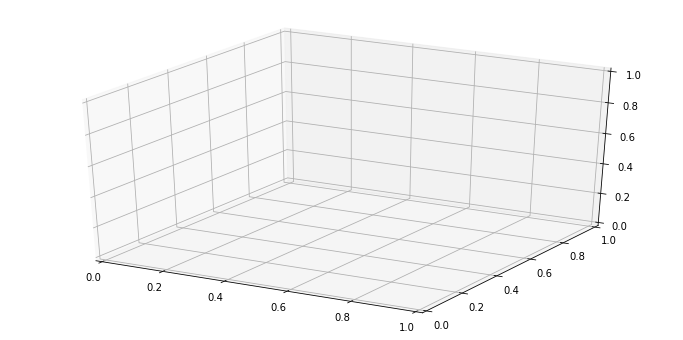

In [60]:
i = 1
for var in s4_agg.abs().mean().sort_values(ascending = False).index[:19]:
    print('Plotting {}, var {}/{}'.format(var, i,s4_agg.shape[1]))
    plt.close()
    fig = plt.figure(figsize=(12,6))
    ax = plt.axes(projection = '3d')
    a = animation.FuncAnimation(fig, update, interval=0.06, fargs=(var, 
                                                                   s4, args_4),init_func = init,
                               frames = range(n))

    writer = PillowWriter(fps=60)  
    a.save('Formulation4 - Total leverage - {}.gif'.format(var), writer=writer)
    i = i+1


In [197]:
#For manual plotting

# %matplotlib 
# args = {'var': 'Profitability - lag1', 
#         'shap_values':s4, 
#         'max_scatter_points':None, 
#         'angles' : (35,7.5),
#         'filter_values' : 0, 
#         'outlier_filter' :0, 
#         'keep_pct_surf':0.9,
#         'bins_surf' : 100, 
#         'plot_scatter': False,
#         'plot_surface' : True, 
#         'plot_crisis' : True,
#        'animate': False}
# plot_shap_time(**args, **args_4)


Using matplotlib backend: Qt5Agg


In [478]:
#Image('Formulation4 - Total leverage - Liquidity - lag3.gif')

In [84]:
#Because the complex nature of our data and the objective of the original problem we can trade-off 
#validity of with interpretability to get another perspective on the effects of the financial crisis on leverage.
#keep in mind to have a relatively accurate model representation we needed to use 68 different 
#mixed effect models.

Second approach for analizing the impact of different variables uppon total leverage

In [221]:
def fit_static_models(leverage):
    #Train test splits should be done by testing with unseen firms.
    best_params = []
    r2_train_second_app = []
    r2_test_second_app = []
    period_second_app = []
    merf_models_second_app = []
    gs_second_app = []
    
    grid = {'n_estimators':[2,5,10,20,30,40,50,100,200,300,500,1000,1250,1500,1750,2000,2250,2500], 
             'max_depth':[3],
              'n_jobs':[-1],
              'learning_rate': np.logspace(0,-4,5)}
    
    
    
    


    
    #print(lpgo.get_n_splits(X, y, groups))
    for period in data.keys():
        print('Fitting model for period {}'.format(period))
        X = data[period][0].iloc[:,9:].drop(['Total leverage', 'Financial leverage'], axis = 1)
        y = data[period][0][leverage]
        
        
        n_total_groups = len(set(X.index.get_level_values(0)))
        lpgo = LeavePGroupsOut(n_groups= int(n_total_groups*0.4)) #leave 40% of firms for cv & testing.
        groups = X.index.droplevel(1)
   #
        for train_index, test_index in lpgo.split(X, y, groups):

            X_train, X_cv_test = X.iloc[train_index], X.iloc[test_index] #X_cv_test: used for CV and posterior testing.
            y_train, y_cv_test = y.iloc[train_index], y.iloc[test_index]
            
            
            n_total_groups_2 = len(set(X_cv_test.index.get_level_values(0)))
            lpgo_2 = LeavePGroupsOut(n_groups= int(n_total_groups_2*0.5)) #leave 40% of firms for cv & testing.
            groups_2 = X_cv_test.index.droplevel(1)
            #print(len(set(groups_2)))
            for train_index_2, test_index_2 in lpgo_2.split(X_cv_test, y_cv_test, groups_2):

                X_cv, X_test = X_cv_test.iloc[train_index_2], X_cv_test.iloc[test_index_2] #X_cv_test: used for CV and posterior testing.
                y_cv, y_test = y_cv_test.iloc[train_index_2], y_cv_test.iloc[test_index_2]


                print('Optimizing model - period {}'.format(period))
                opt = GridSearch(model = XGBRegressor(),param_grid = grid,parallelize = False)

                opt.fit(X_train, y_train, X_cv, y_cv)
                print('Validation R2 Score for Optimized Parameters: {:.2f}'.format(opt.score(X_cv, y_cv)))
                print('Best params: {}'.format(opt.best_params))
                  
        

                X_train, Z_train, clusters_train, y_train = transform(X_train, y_train)
                X_test, Z_test, clusters_test, y_test = transform(X_test,y_test)
               

                merf = MERF(XGBRegressor(**opt.best_params), max_iterations = 20, gll_early_stop_threshold = 0.001)
                merf.fit(X_train,Z_train, clusters_train,y_train)
                preds_train = merf.predict(X_train,Z_train,clusters_train)
                preds_test = merf.predict(X_test,Z_test,clusters_test)
                r2_train_second_app.append(r2_score(y_train,preds_train))
                r2_test_second_app.append(r2_score(y_test, preds_test))
                merf_models_second_app.append(merf)
                gs_second_app.append(opt)
                period_second_app.append(period)

                break #Just one split, no grid search.
            break




    df_results_second_app = pd.DataFrame({'Period': period_second_app,
                                          'R2 train': r2_train_second_app,
                                         'R2 test': r2_test_second_app})    



    #Saving dataframe
    df_results_second_app.to_csv('grid_search_results_second_app - {}.csv'.format(leverage))

    #Saving merf models
    pickle.dump(merf_models_second_app, open('merf_models_second_app - {}.pkl'.format(leverage), 'wb'))

    #Saving grid search objects 
    pickle.dump(gs_second_app, open('grid_search_objects_second_app - {}.pkl'.format(leverage), 'wb')) 

In [222]:
fit_static_models('Total leverage')
fit_static_models('Financial leverage')

Fitting model for period crisis
Optimizing model - period crisis
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 30, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is -3814.7817164773724 at iteration 1.
INFO     [merf.py:307] Training GLL is -7150.577416398723 at iteration 2.
INFO     [merf.py:307] Training GLL is -9057.951455086668 at iteration 3.
INFO     [merf.py:307] Training GLL is -9572.625168793711 at iteration 4.
INFO     [merf.py:307] Training GLL is -9637.777233600491 at iteration 5.
INFO     [merf.py:307] Training GLL is -9637.250615808136 at iteration 6.
INFO     [merf.py:321] Gll -9637.250615808136 less than threshold 5.464100067793541e-05, stopping early ...


Fitting model for period pre-crisis
Optimizing model - period pre-crisis
Validation R2 Score for Optimized Parameters: 0.11
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 2250, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is -9565.434457332367 at iteration 1.
INFO     [merf.py:307] Training GLL is -15127.354406546694 at iteration 2.
INFO     [merf.py:307] Training GLL is -15683.309097081858 at iteration 3.
INFO     [merf.py:307] Training GLL is -15671.639349236673 at iteration 4.
INFO     [merf.py:321] Gll -15671.639349236673 less than threshold 0.0007440870911200494, stopping early ...


Fitting model for period post-crisis
Optimizing model - period post-crisis
Validation R2 Score for Optimized Parameters: 0.10
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is -30297.860906959915 at iteration 1.
INFO     [merf.py:307] Training GLL is -40288.85435155705 at iteration 2.
INFO     [merf.py:307] Training GLL is -40680.01894931293 at iteration 3.
INFO     [merf.py:307] Training GLL is -40689.35915379807 at iteration 4.
INFO     [merf.py:321] Gll -40689.35915379807 less than threshold 0.0002296017732139445, stopping early ...


Fitting model for period complete
Optimizing model - period complete
Validation R2 Score for Optimized Parameters: 0.12
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 50, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is -44952.48258693587 at iteration 1.
INFO     [merf.py:307] Training GLL is -54055.78755104583 at iteration 2.
INFO     [merf.py:307] Training GLL is -54288.19185735115 at iteration 3.
INFO     [merf.py:307] Training GLL is -54214.481186141944 at iteration 4.
INFO     [merf.py:307] Training GLL is -54141.17833719246 at iteration 5.
INFO     [merf.py:307] Training GLL is -54087.99806356034 at iteration 6.
INFO     [merf.py:321] Gll -54087.99806356034 less than threshold 0.0009822518693795477, stopping early ...


Fitting model for period crisis
Optimizing model - period crisis
Validation R2 Score for Optimized Parameters: -0.01
Best params: {'learning_rate': 0.1, 'max_depth': 3, 'n_estimators': 2500, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is -3676.0847119704245 at iteration 1.
INFO     [merf.py:307] Training GLL is -6274.248946720531 at iteration 2.
INFO     [merf.py:307] Training GLL is -7022.631356756204 at iteration 3.
INFO     [merf.py:307] Training GLL is -6880.046290194074 at iteration 4.
INFO     [merf.py:307] Training GLL is -7065.227554207064 at iteration 5.
INFO     [merf.py:307] Training GLL is -7171.062722989387 at iteration 6.
INFO     [merf.py:307] Training GLL is -7074.653013823232 at iteration 7.
INFO     [merf.py:307] Training GLL is -7188.6427496798005 at iteration 8.
INFO     [merf.py:307] Training GLL is -7102.399714780064 at iteration 9.
INFO     [merf.py:307] Training GLL is -7254.905634287408 at iteration 10.
INFO     [merf.py:307] Training GLL is -7408.316312209985 at iteration 11.
INFO     [merf.py:307] Training GLL is -7266.349954244593 at iteration 12.
INFO     [merf.py:307] Training GLL is -7297.693306180407 at iteration 13.
INFO     [merf.py:307] Training 

Fitting model for period pre-crisis
Optimizing model - period pre-crisis
Validation R2 Score for Optimized Parameters: 0.01
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is 23060.88384404803 at iteration 1.
INFO     [merf.py:307] Training GLL is 23226.856537302516 at iteration 2.
INFO     [merf.py:307] Training GLL is 23245.268613272365 at iteration 3.
INFO     [merf.py:321] Gll 23245.268613272365 less than threshold 0.0007927063199567715, stopping early ...


Fitting model for period post-crisis
Optimizing model - period post-crisis
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 0.001, 'max_depth': 3, 'n_estimators': 500, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is 106128.49885547838 at iteration 1.
INFO     [merf.py:307] Training GLL is 106215.45713582111 at iteration 2.
INFO     [merf.py:321] Gll 106215.45713582111 less than threshold 0.0008193678538801277, stopping early ...


Fitting model for period complete
Optimizing model - period complete
Validation R2 Score for Optimized Parameters: 0.00
Best params: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 40, 'n_jobs': -1}


INFO     [merf.py:307] Training GLL is 149269.04793190627 at iteration 1.
INFO     [merf.py:307] Training GLL is 149190.95426418347 at iteration 2.
INFO     [merf.py:321] Gll 149190.95426418347 less than threshold 0.0005231738850402984, stopping early ...


In [223]:
#merf_models_second_app = pickle.load(open('merf_models_second_app.pkl', 'rb'))
#grid_search_objects_second_app = pickle.load(open('grid_search_objects_second_app.pkl', 'rb'))
aux1 = pd.read_csv('grid_search_results_second_app - Financial leverage.csv', index_col = 0)
aux1

,Period,R2 train,R2 test
0,crisis,0.999494,-4.357149
1,pre-crisis,0.334583,-4.484649
2,post-crisis,0.390752,-0.075930
3,complete,0.323677,-29.918146


In [224]:
aux2 = pd.read_csv('grid_search_results_second_app - Total leverage.csv', index_col = 0)
aux2

,Period,R2 train,R2 test
0,crisis,0.960119,0.379335
1,pre-crisis,0.898735,0.215976
2,post-crisis,0.877790,0.351698
3,complete,0.831022,0.334447


In [ ]:
# Because of poor perfomance on testing data of the static models, interpretation on the effects via SHAP values
# should be taken with a grain of salt and were only computed to detect general tendencies.

# Results show that a model that considers the effects of explanatory variables as fixed can't achive
# satisfactory levels of accuracy in the explanation of firm leverage.

# Because temporal models achive sigificantly better fitting to unseen data than the formulation of static models
# it can be inferred that the effects of liquidity, growth, tangibility and firm size have
# variable effects on total leverage which changes with time.

# Even more, because the formulation that includes the raw financial information achives even better performance
# than the temporal models that only inlcudes financial indicators to explain total leverage, its possible to assume
# that there are more charasterictics of firms, given y unseen 'concepts' that determine
# total leverage.

In [424]:
merf_models_second_app = pickle.load(open('merf_models_second_app - Total leverage.pkl', 'rb'))
#because dict keys are not ordered (temporally) the list is ordered manually.
merf_models_second_app = [merf_models_second_app[1], merf_models_second_app[0], merf_models_second_app[2]]

In [425]:
shap_values_second_app = []
for period, i in zip(['pre-crisis', 'crisis', 'post-crisis'], range(3)):

    X = data[period][0].iloc[:,9:].drop(['Total leverage', 'Financial leverage'], axis = 1)
    y = data[period][0]['Total leverage']


    n_total_groups = len(set(X.index.get_level_values(0)))
    lpgo = LeavePGroupsOut(n_groups= int(n_total_groups*0.4)) #leave 40% of firms for cv & testing.
    groups = X.index.droplevel(1)
    #
    for train_index, test_index in lpgo.split(X, y, groups):

        X_train, X_cv_test = X.iloc[train_index], X.iloc[test_index] #X_cv_test: used for CV and posterior testing.
        y_train, y_cv_test = y.iloc[train_index], y.iloc[test_index]


        n_total_groups_2 = len(set(X_cv_test.index.get_level_values(0)))
        lpgo_2 = LeavePGroupsOut(n_groups= int(n_total_groups_2*0.5)) #leave 40% of firms for cv & testing.
        groups_2 = X_cv_test.index.droplevel(1)
        #print(len(set(groups_2)))
        for train_index_2, test_index_2 in lpgo_2.split(X_cv_test, y_cv_test, groups_2):

            X_cv, X_test = X_cv_test.iloc[train_index_2], X_cv_test.iloc[test_index_2] #X_cv_test: used for CV and posterior testing.
            y_cv, y_test = y_cv_test.iloc[train_index_2], y_cv_test.iloc[test_index_2]


            X_train, Z_train, clusters_train, y_train = transform(X_train, y_train)
            X_test, Z_test, clusters_test, y_test = transform(X_test,y_test)


            explainer = shap.TreeExplainer(merf_models_second_app[i].fe_model, X_train)

            break
        break
    shap_values_second_app.append(explainer(X_test))

 95%|=================== | 3433/3597 [00:19<00:00]       

#####################################Growth#####################################
pre-crisis


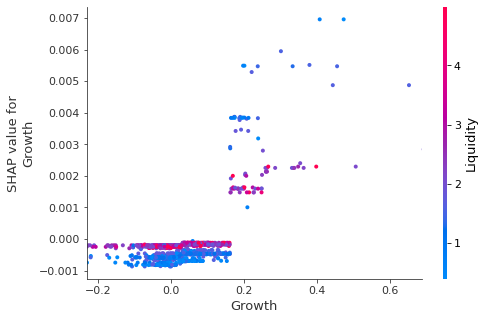

crisis


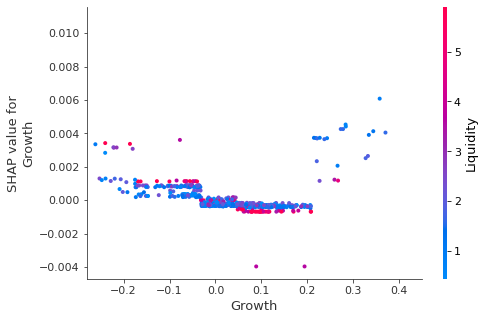

post-crisis


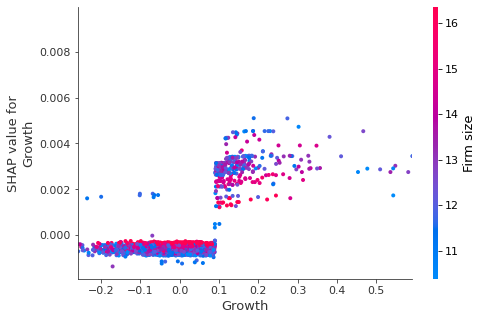

##################################Tangibility###################################
pre-crisis


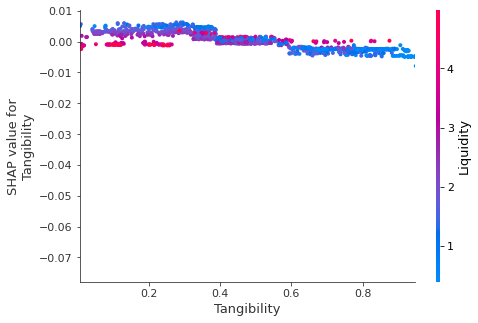

crisis


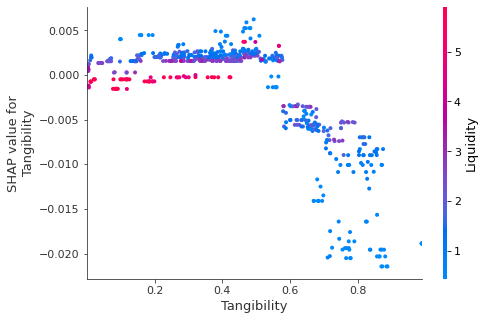

post-crisis


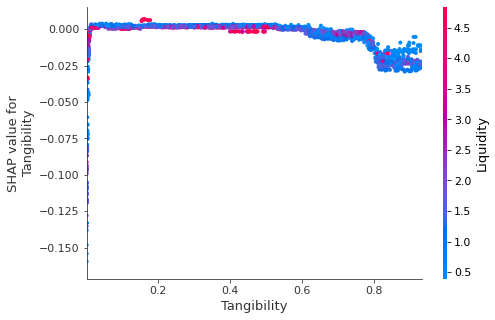

###################################Liquidity####################################
pre-crisis


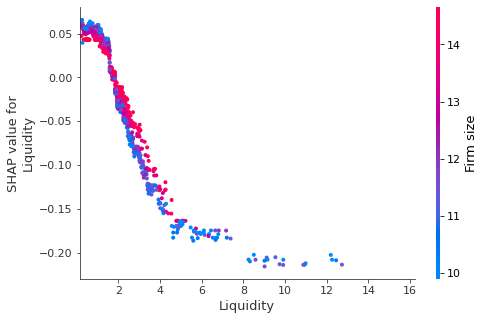

crisis


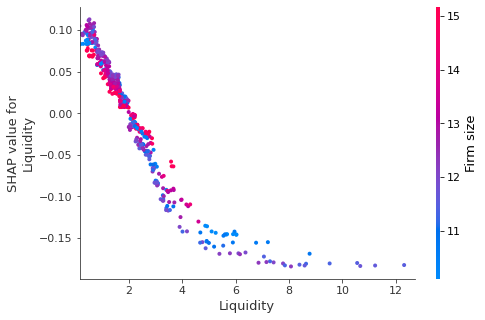

post-crisis


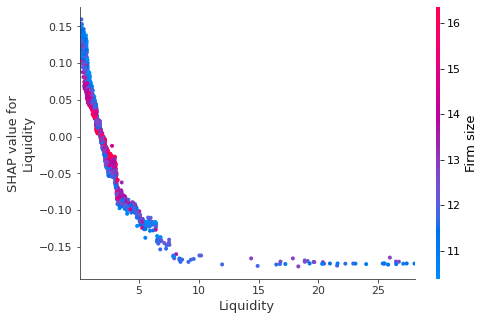

#################################Profitability##################################
pre-crisis


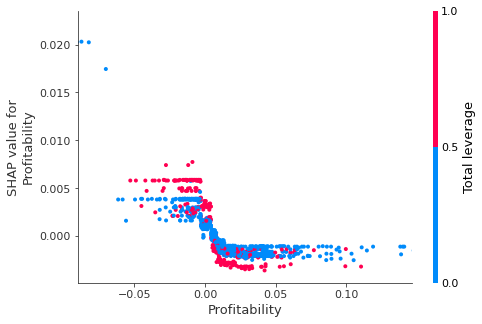

crisis


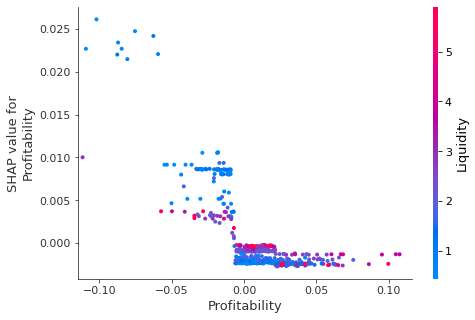

post-crisis


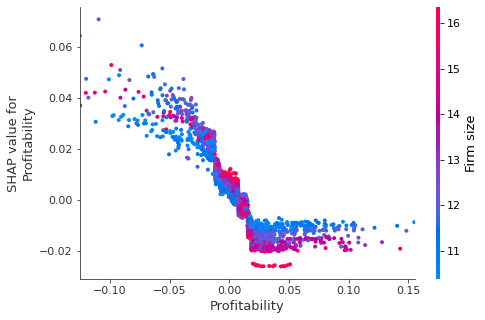

###################################Firm size####################################
pre-crisis


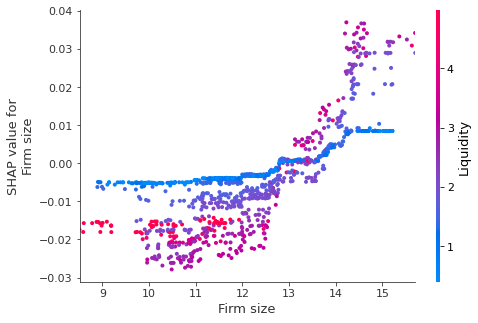

crisis


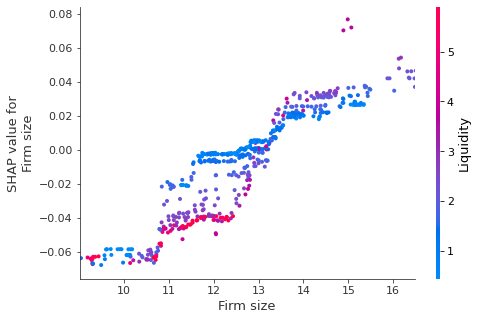

post-crisis


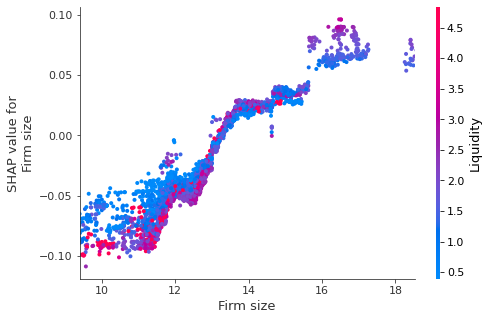

In [430]:
features = ['Growth',
       'Tangibility', 'Liquidity', 'Profitability', 'Firm size',
       'Total leverage', 'Financial leverage',
       'Country of Headquarters_Brazil', 'Country of Headquarters_Chile',
       'Country of Headquarters_Mexico', 'Country of Headquarters_Peru']


period_map = {0: 'pre-crisis',
             1:'crisis',
             2:'post-crisis'}

for j in range(5):
    print(features[j].center(80,'#'))
    for i in range(3):
        print(period_map[i])
        shap.dependence_plot(j, shap_values_second_app[i].values,
                     shap_values_second_app[i].data, feature_names=features, 
                             xmin = "percentile(0.5)", xmax = 'percentile(99.5)')




In [ ]:
# In gereral terms, given the static models, it can be inferred by interpreting the results on SHAP values
# that the determinants of capital structure dont seem to be affected by the financial crisis. However the